In [2]:
%%javascript
IPython.OutputArea.prototype._should_scroll = function(lines) {
    return false;
}

<IPython.core.display.Javascript object>

In [128]:
from PIL import Image
import pytesseract
import argparse
import cv2
import os
import pandas as pd
from tabula import wrapper
import numpy as np
import datetime
import PyPDF2
from matplotlib import pyplot as plt
import re
import datetime

pd.set_option('display.max_rows', 5900)    

pytesseract.pytesseract.tesseract_cmd = r'C:\Program Files (x86)\Tesseract-OCR\tesseract.exe'

In [443]:
def replaceMultiple(mainString, toBeReplaces, newString):
    # Iterate over the strings to be replaced
    for elem in toBeReplaces :
        # Check if string is in the main string
        if elem in mainString :
            # Replace the string
            mainString = mainString.replace(elem, newString)
    
    return  mainString

def convertAmount(item):
    return replaceMultiple(item, ['—', '='] , "")
        
    
def test_repeat(items):
    return all(item == items[-1] for item in items[len(items)-2:len(items)-1])


def does_date_make_sense(date_list):
    if len(date_list)>=2:
        return date_list[-1]-date_list[-2]<datetime.timedelta(32)
    return True

def count_digits(num_string):
    digits = 0
    digits_list = [str(n) for n in range(10)]
    for char in num_string:
        if char in digits_list:
            digits+=1
        if char in [',','.']:
            return digits
    return digits

Image (10).jpg
02/22/2017 VZWRLSS*APOCC VISN 800- -122.45
[datetime.date(2017, 2, 22), -122.45, ' VZWRLSS*APOCC VISN 800- ']


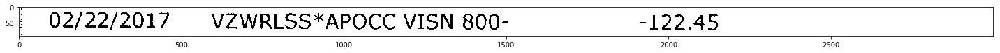


Amount was not detected, re-attempting by removing commas
[None, None, '']


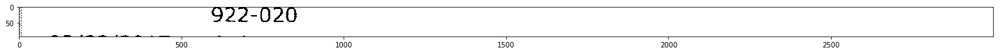

UL/e22/2U1/ CLOUD CHAMBER VAPOR LOU -39.41

ALVICAARAT 1
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'UL/e22/2U1/ CLOUD CHAMBER VAPOR LOU -39.41\n\nALVICAARAT 1']


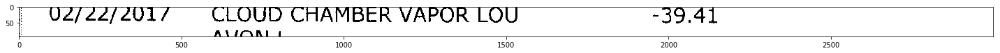

02/22/2017 CLOUD CHAMBER VAPOR LOU -39.41
[datetime.date(2017, 2, 22), -39.41, ' CLOUD CHAMBER VAPOR LOU ']


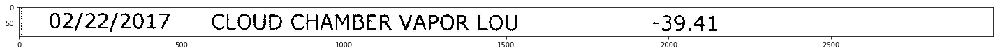


Amount was not detected, re-attempting by removing commas
[None, None, '']


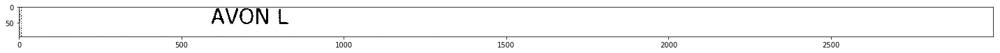

02/22/2017 Online Transfer from SAV ...03
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 2, 22), None, ' Online Transfer from SAV ...03']


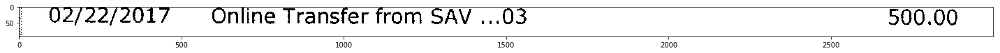

02/22/2017 Online Transfer from SAV ...03 500.00
[datetime.date(2017, 2, 22), 500.0, ' Online Transfer from SAV ...03']


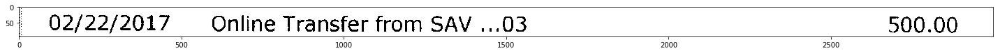


Amount was not detected, re-attempting by removing commas
[None, None, '']


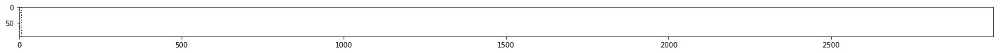

02/21/2017 AMAZON MKTPLACE PMTS -12.12
[datetime.date(2017, 2, 21), -12.12, ' AMAZON MKTPLACE PMTS ']


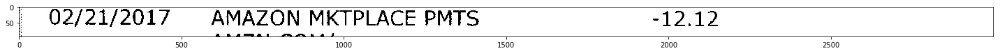


Amount was not detected, re-attempting by removing commas
[None, None, '']


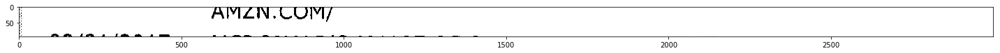

UsZ/Z21/20i/ MCDONALD S M4107 OF OH -13.10

CE VD TA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'UsZ/Z21/20i/ MCDONALD S M4107 OF OH -13.10\n\nCE VD TA']


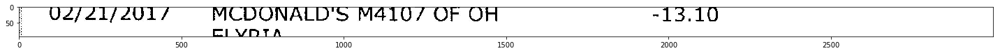

02/21/2017 MCDONALD'S M4107 OF OH -13.10
[datetime.date(2017, 2, 21), -13.1, " MCDONALD'S M4107 OF OH "]


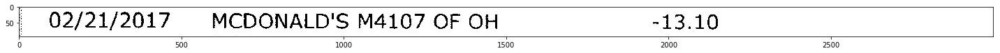

ELYRIA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ELYRIA']


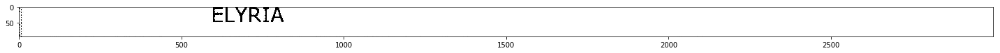

ELYRIA
Amount was not detected, re-attempting by removing commas
[None, None, 'ELYRIA']


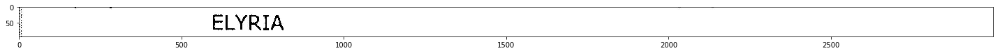

02/21/2017 STEAK-N-SHAKE#0443 Q -10.57
[datetime.date(2017, 2, 21), -10.57, ' STEAK-N-SHAKE#0443 Q ']


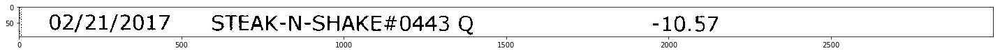

SHEFFIELD
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'SHEFFIELD']


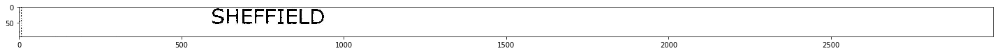

SHEFFIELD I EE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'SHEFFIELD I EE']


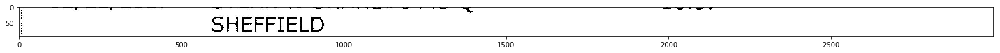

SHEFFIELD
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'SHEFFIELD']


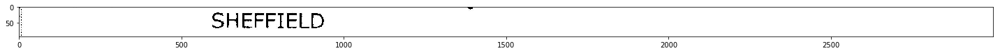

SHEFFIELD
Amount was not detected, re-attempting by removing commas
[None, None, 'SHEFFIELD']


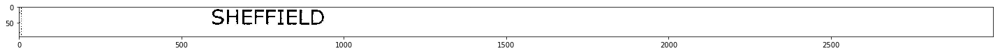

02/17/2017 SPEEDWAY 03528 327 AVON -1.91
[datetime.date(2017, 2, 17), -1.91, ' SPEEDWAY 03528 327 AVON ']


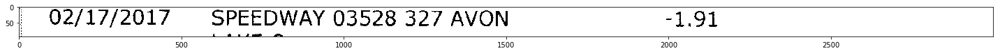

Fao m™! J 4  | OO OU '

cullen: Wie Re ee: 2 Os Re

ene gig: Oe: cae |S eS ee

- cee ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, "Fao m™! J 4  | OO OU '\n\ncullen: Wie Re ee: 2 Os Re\n\nene gig: Oe: cae |S eS ee\n\n- cee ee"]


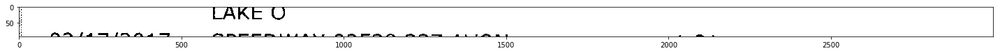

LAKE O
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'LAKE O']


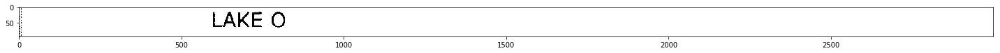


Amount was not detected, re-attempting by removing commas
[None, None, '']


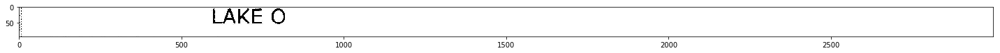

02/17/2017 SPEEDWAY 03528 327 AVON

§ ADS OA hU6cS™
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 2, 17), None, ' SPEEDWAY 03528 327 AVON\n\n§ ADS OA hU6cS™']


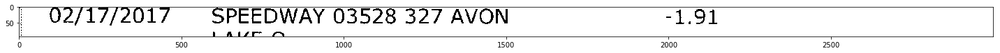

02/17/2017 SPEEDWAY 03528 327 AVON -1.91
[datetime.date(2017, 2, 17), -1.91, ' SPEEDWAY 03528 327 AVON ']


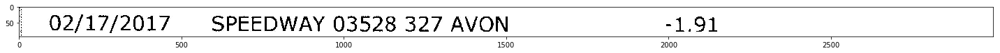


Amount was not detected, re-attempting by removing commas
[None, None, '']


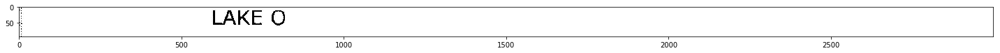

02/15/2017 MONTHLY SERVICE FEE -12.00
[datetime.date(2017, 2, 15), -12.0, ' MONTHLY SERVICE FEE ']


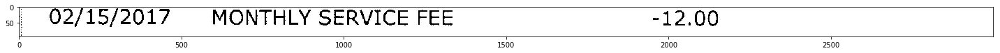

02/14/2017 BURGER KING 11172004 CLYDE -13.98
[datetime.date(2017, 2, 14), -13.98, ' BURGER KING 11172004 CLYDE ']


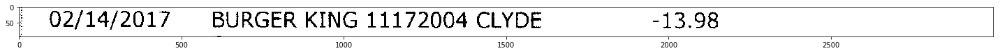


Amount was not detected, re-attempting by removing commas
[None, None, '']


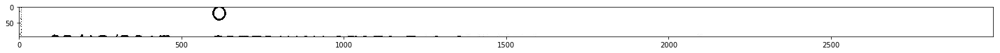

ULZ/La/2ZUl/ DPCEDWAY 07550 549 GURNEE “/.27
Ti
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ULZ/La/2ZUl/ DPCEDWAY 07550 549 GURNEE “/.27\nTi']


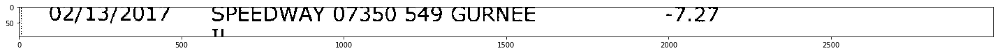

02/13/2017 SPEEDWAY 07350 549 GURNEE -7.27
[datetime.date(2017, 2, 13), -7.27, ' SPEEDWAY 07350 549 GURNEE ']


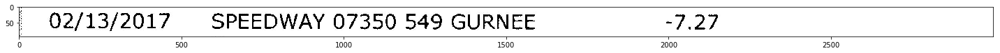

IL
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'IL']


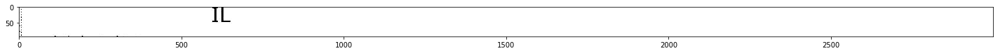

IL
Amount was not detected, re-attempting by removing commas
[None, None, 'IL']


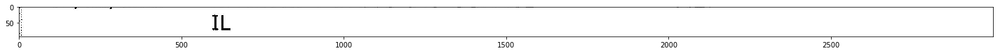

02/13/2017 ©MCDONALD'S F6676 CHICAGO -15.70
[datetime.date(2017, 2, 13), -15.7, " ©MCDONALD'S F6676 CHICAGO "]


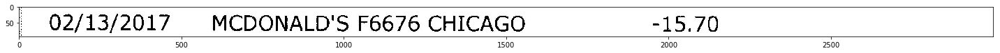

IL
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'IL']


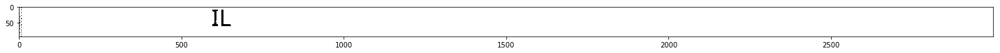

CHEE GBR EER FEN Ee mate  ae os Soa er ae ene Ree: 6 Ae es Coe Oe el: A eee ee ee -_ ee ee

IL
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CHEE GBR EER FEN Ee mate  ae os Soa er ae ene Ree: 6 Ae es Coe Oe el: A eee ee ee -_ ee ee\n\nIL']


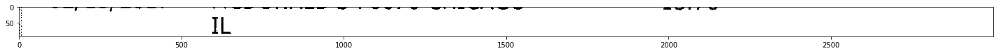


Amount was not detected, re-attempting by removing commas
[None, None, '']


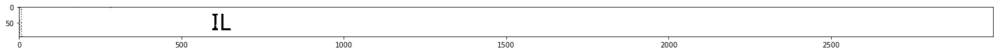

02/13/2017 SUNOCO 0759135700 WEST -7.23
[datetime.date(2017, 2, 13), -7.23, ' SUNOCO 0759135700 WEST ']


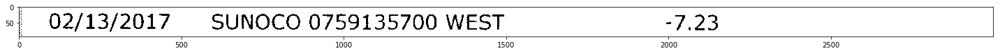

UNITY O
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'UNITY O']


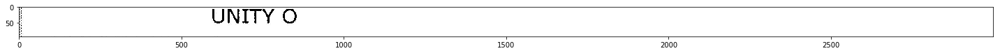

UNITY O
Amount was not detected, re-attempting by removing commas
[None, None, 'UNITY O']


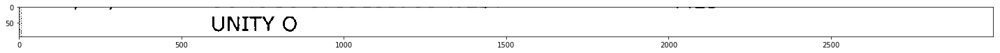

02/13/2017 SPEEDWAY 03528 327 AVON -7.87
[datetime.date(2017, 2, 13), -7.87, ' SPEEDWAY 03528 327 AVON ']


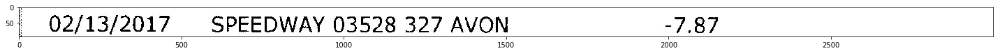

LAKE O
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'LAKE O']


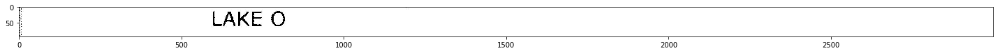

re aero’

LAKE

ewpreat

O

a ie

.

‘Y

ht

aww fF
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 're aero’\n\nLAKE\n\newpreat\n\nO\n\na ie\n\n.\n\n‘Y\n\nht\n\naww fF']


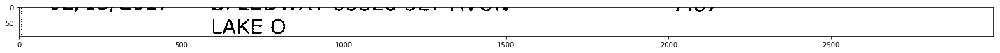

LAKE O
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'LAKE O']


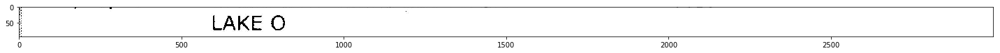

LAKE O
Amount was not detected, re-attempting by removing commas
[None, None, 'LAKE O']


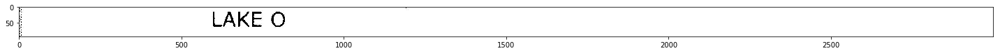

02/09/2017 MCDONALD'S F17076 ROLLING -8.32
[datetime.date(2017, 2, 9), -8.32, " MCDONALD'S F17076 ROLLING "]


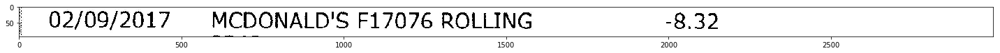

PRAL
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PRAL']


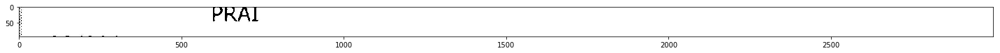

PRAI
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PRAI']


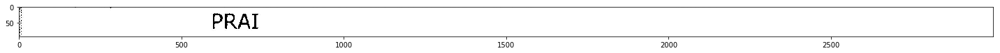

PRAI
Amount was not detected, re-attempting by removing commas
[None, None, 'PRAI']


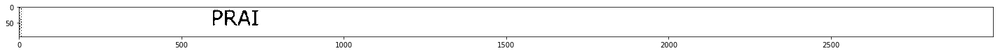

02/08/2017 SUNOCO 00577197 WEST -30.38

ss -mermwna
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 2, 8), None, ' SUNOCO 00577197 WEST -30.38\n\nss -mermwna']


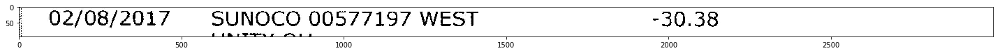

02/08/2017 SUNOCO 00577197 WEST -30.38
[datetime.date(2017, 2, 8), -30.38, ' SUNOCO 00577197 WEST ']


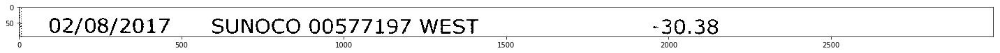

UNITY OH
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'UNITY OH']


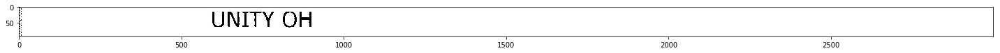

Ne Gee PON NE fe ee ee NI I vvouwi et Nt et

UNITY OH
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Ne Gee PON NE fe ee ee NI I vvouwi et Nt et\n\nUNITY OH']


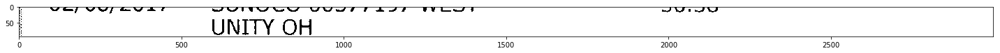

UNITY OH
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'UNITY OH']


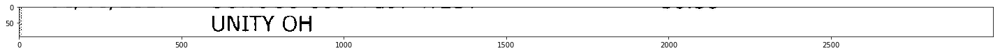

UNITY OH
Amount was not detected, re-attempting by removing commas
[None, None, 'UNITY OH']


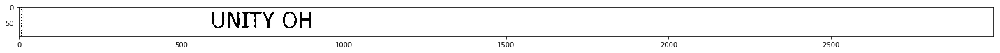

TD cae ee se we a Sg:
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'TD cae ee se we a Sg:']


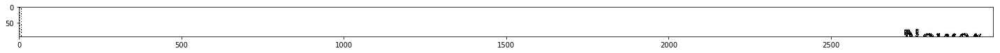


Amount was not detected, re-attempting by removing commas
[None, None, '']


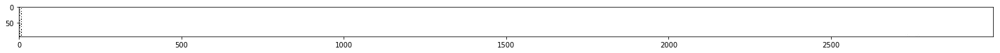

Image (11).jpg
02/08/2017 SUNOCO 00577197 WEST -3.49
[datetime.date(2017, 2, 8), -3.49, ' SUNOCO 00577197 WEST ']


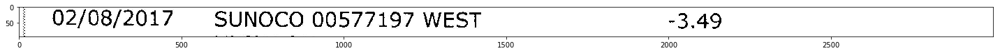

UNLTY On

ini ua a ala a a
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'UNLTY On\n\nini ua a ala a a']


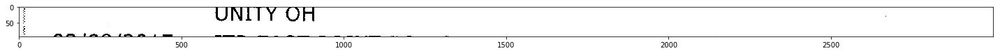

UNITY OH
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'UNITY OH']


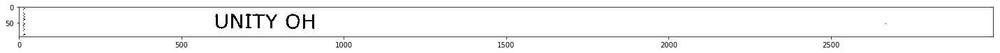

UNITY OH
Amount was not detected, re-attempting by removing commas
[None, None, 'UNITY OH']


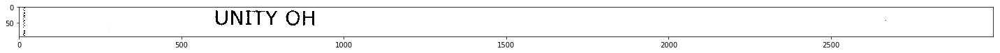

02/08/2017 ITR EAST POINT TOLLS -8.40

ek ee ns
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 2, 8), None, ' ITR EAST POINT TOLLS -8.40\n\nek ee ns']


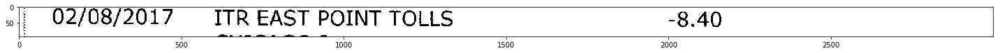

02/08/2017 ITR EAST POINT TOLLS -8.40
[datetime.date(2017, 2, 8), -8.4, ' ITR EAST POINT TOLLS ']


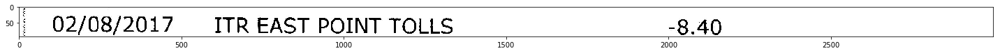

CHICAGO I
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CHICAGO I']


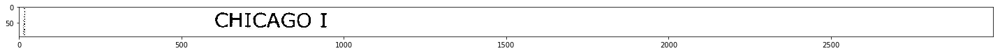

eS ae

ce

me F FN ee FS FC Nw EWE

CHICAGO I

Nea Toe ae te?

Ne FV
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'eS ae\n\nce\n\nme F FN ee FS FC Nw EWE\n\nCHICAGO I\n\nNea Toe ae te?\n\nNe FV']


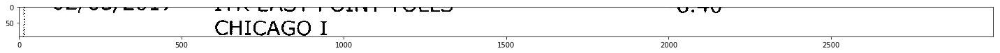

CHICAGO I
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CHICAGO I']


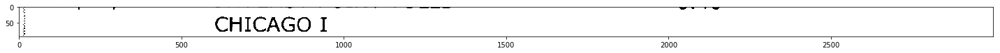

CHICAGO I
Amount was not detected, re-attempting by removing commas
[None, None, 'CHICAGO I']


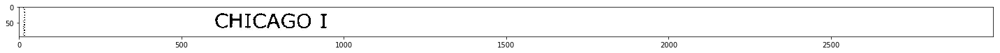

02/08/2017 MCDONALD'S F24462 WEST -3.38
[datetime.date(2017, 2, 8), -3.38, " MCDONALD'S F24462 WEST "]


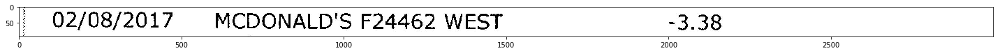

DES MOI
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'DES MOI']


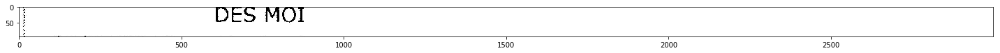

DES MOI
Amount was not detected, re-attempting by removing commas
[None, None, 'DES MOI']


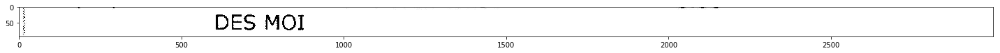

02/07/2017 ADY*JetbrainsUSD -5.90
[datetime.date(2017, 2, 7), -5.9, ' ADY*JetbrainsUSD ']


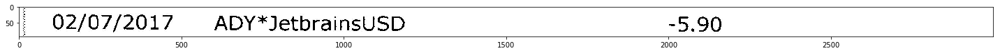

https://www.]j
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'https://www.]j']


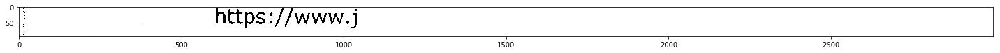

SIRS AAMT eeme oe Oe Were Ieee’

https: //www. j

'’__

e
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, "SIRS AAMT eeme oe Oe Were Ieee’\n\nhttps: //www. j\n\n'’__\n\ne"]


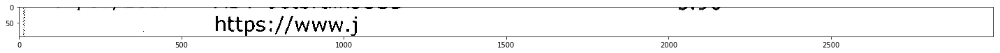

https://www.j
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'https://www.j']


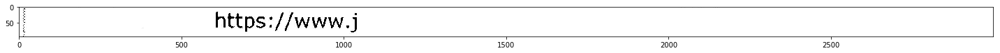

https://www.j
Amount was not detected, re-attempting by removing commas
[None, None, 'https://www.j']


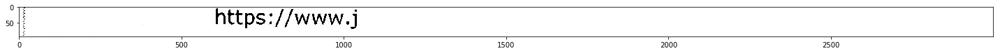

02/07/2017 SHELL Service Station -2.41
[datetime.date(2017, 2, 7), -2.41, ' SHELL Service Station ']


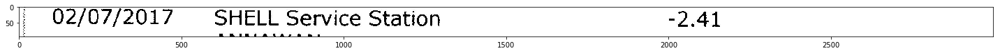

fe mm! iF Fam, I ™!em oO,

WAIN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'fe mm! iF Fam, I ™!em oO,\n\nWAIN']


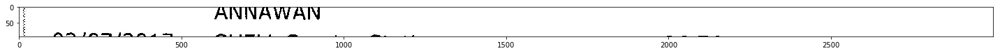

ANNAWAN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ANNAWAN']


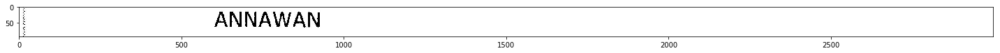

ANNAWAN
Amount was not detected, re-attempting by removing commas
[None, None, 'ANNAWAN']


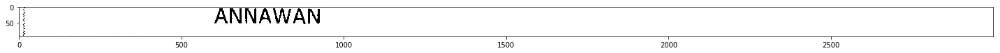

02/07/2017 SHELL Service Station -26.76

AAITIA TL A LAF A RE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 2, 7), None, ' SHELL Service Station -26.76\n\nAAITIA TL A LAF A RE']


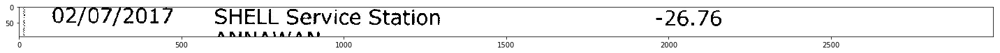

02/07/2017 SHELL Service Station -26.76
[datetime.date(2017, 2, 7), -26.76, ' SHELL Service Station ']


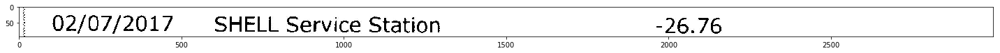

ANNAWAN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ANNAWAN']


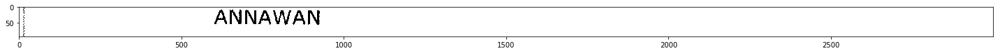

me EO EE es Eee Se ee ee ee FO et ee awit fw

ANNAWAN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'me EO EE es Eee Se ee ee ee FO et ee awit fw\n\nANNAWAN']


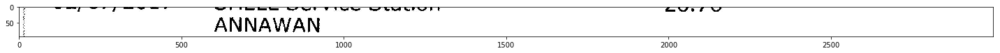

ANNAWAN oe
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ANNAWAN oe']


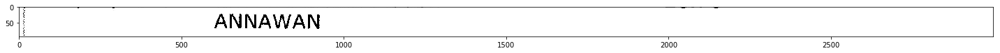

ANNAWAN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ANNAWAN']


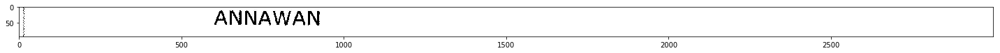

ANNAWAN
Amount was not detected, re-attempting by removing commas
[None, None, 'ANNAWAN']


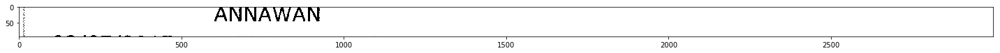

UZ/U//Z01/ SHELL Service Station -5.85

AAITAI A LASARI
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'UZ/U//Z01/ SHELL Service Station -5.85\n\nAAITAI A LASARI']


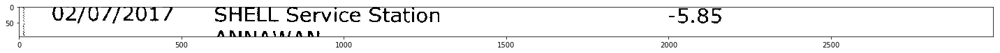

02/07/2017 SHELL Service Station -5.85
[datetime.date(2017, 2, 7), -5.85, ' SHELL Service Station ']


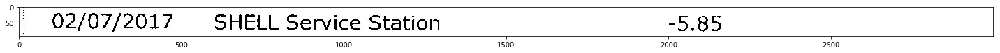

ANNAWAN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ANNAWAN']


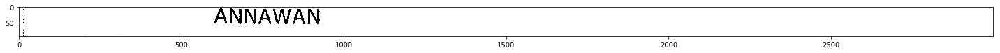

ANNAWAN |
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ANNAWAN |']


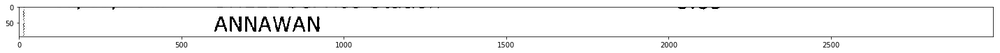

ANNAWAN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ANNAWAN']


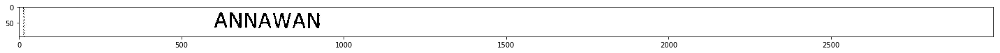

ANNAWAN
Amount was not detected, re-attempting by removing commas
[None, None, 'ANNAWAN']


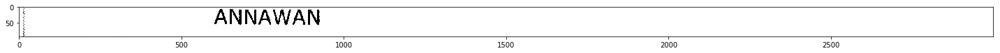

02/07/2017 BROOKE TRAVEL P WEST -6.30

LS se Seen
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 2, 7), None, ' BROOKE TRAVEL P WEST -6.30\n\nLS se Seen']


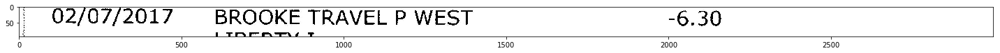

02/07/2017 BROOKE TRAVEL P WEST -6.30
[datetime.date(2017, 2, 7), -6.3, ' BROOKE TRAVEL P WEST ']


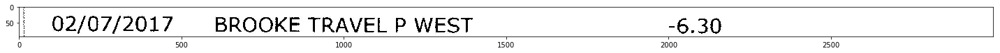

LIBERTY I
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'LIBERTY I']


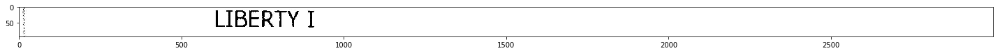

EEE Ear

LIBERTY] © on
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'EEE Ear\n\nLIBERTY] © on']


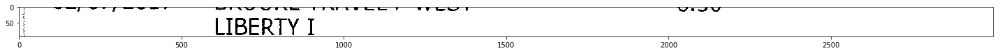

LIBERTY I
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'LIBERTY I']


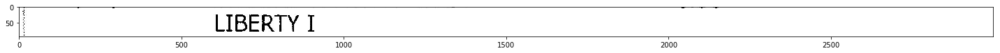

LIBERTY I
Amount was not detected, re-attempting by removing commas
[None, None, 'LIBERTY I']


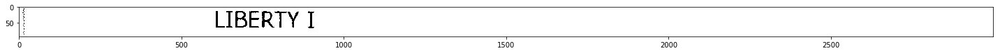

02/07/2017 KUM & GO #443 -1.71
[datetime.date(2017, 2, 7), -1.71, ' KUM & GO #443 ']


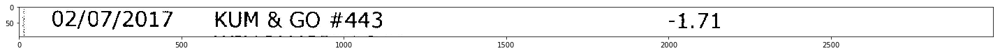

WILLIAMSBURG IA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'WILLIAMSBURG IA']


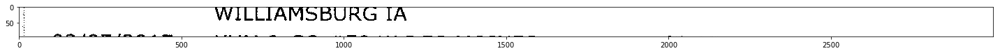

WILLIAMSBURG IA
Amount was not detected, re-attempting by removing commas
[None, None, 'WILLIAMSBURG IA']


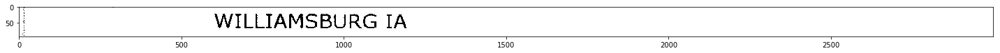

02/07/2017 KUM &GO #50 W DES MOINES -20.12
[datetime.date(2017, 2, 7), -20.12, ' KUM &GO #50 W DES MOINES ']


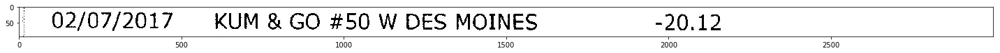

IA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'IA']


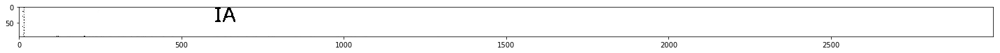

IA
Amount was not detected, re-attempting by removing commas
[None, None, 'IA']


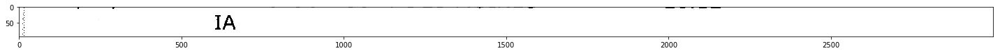

02/07/2017 KUM & GO #50 W DES MOINES -2.90
[datetime.date(2017, 2, 7), -2.9, ' KUM & GO #50 W DES MOINES ']


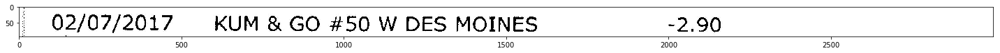

IA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'IA']


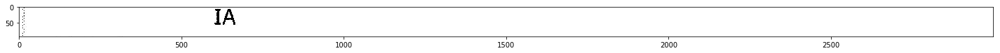

ek 5S GAM Exeee GR Rte NDE Re ae Re Wes Megs: eee EE RMA

IA

 

See am Soe a OR ee: a a a ae ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ek 5S GAM Exeee GR Rte NDE Re ae Re Wes Megs: eee EE RMA\n\nIA\n\n \n\nSee am Soe a OR ee: a a a ae ee']


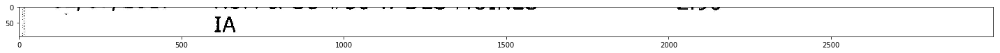

IA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'IA']


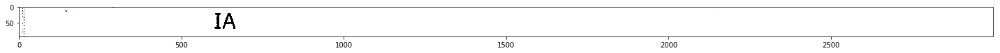

IA
Amount was not detected, re-attempting by removing commas
[None, None, 'IA']


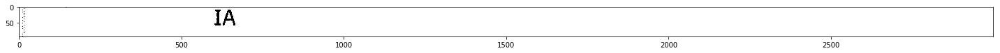

02/07/2017 SUBWAY 00427815 AVOCA I -16.16
[datetime.date(2017, 2, 7), -16.16, ' SUBWAY 00427815 AVOCA I ']


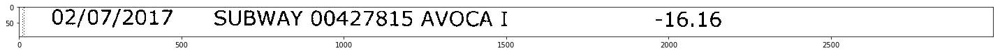

Pe | FF mms TZ ™|, OO ll ss 2 Ps, PO mem 8§ el kklllOe 8 eClCOe otelCUlC et Ue “: a 2: SA A Ce ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Pe | FF mms TZ ™|, OO ll ss 2 Ps, PO mem 8§ el kklllOe 8 eClCOe otelCUlC et Ue “: a 2: SA A Ce ee']


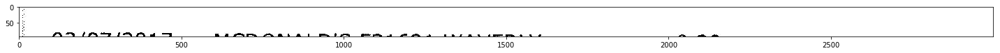


Amount was not detected, re-attempting by removing commas
[None, None, '']


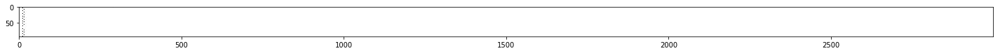

02/07/2017 MCDONALD'S F31691 WAVERLY -8.29
[datetime.date(2017, 2, 7), -8.29, " MCDONALD'S F31691 WAVERLY "]


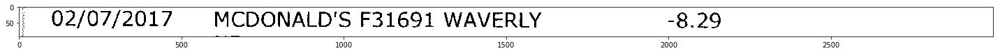


Amount was not detected, re-attempting by removing commas
[None, None, '']


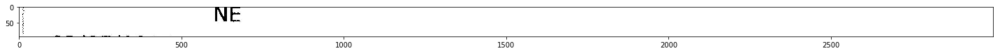

ULZ/O//201/ MCDONALD'S F12500 -7.19

f"LiArrusrv AR LAr tA FIRS
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, "ULZ/O//201/ MCDONALD'S F12500 -7.19\n\nf-LiArrusrv AR LAr tA FIRS"]


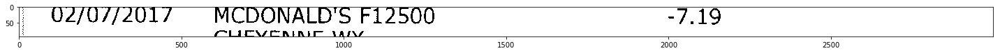

02/07/2017 §©MCDONALD'S F12500 -7.19
[datetime.date(2017, 2, 7), -7.19, " §©MCDONALD'S F12500 "]


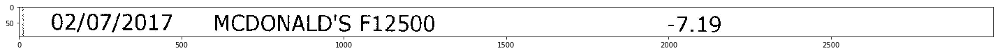

CHEYENNE WY
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CHEYENNE WY']


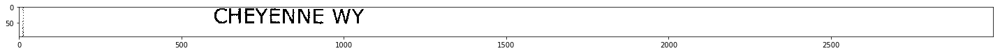

ee ee eee Se tee Ee ee ee ee: ee

CHEYENNE WY
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee ee eee Se tee Ee ee ee ee: ee\n\nCHEYENNE WY']


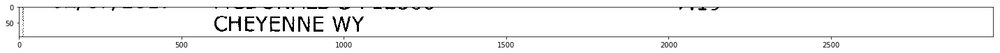

CHEYENNE WY
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CHEYENNE WY']


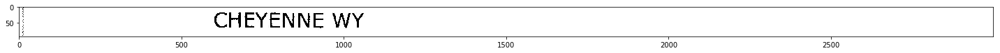

CHEYENNE WY
Amount was not detected, re-attempting by removing commas
[None, None, 'CHEYENNE WY']


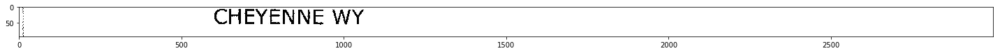

02/07/2017 Online Transfer from SAV ...03 100.00
[datetime.date(2017, 2, 7), 100.0, ' Online Transfer from SAV ...03']


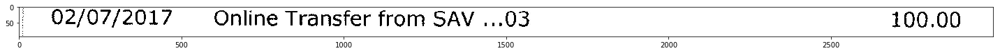

a ™ F mh

a ae es
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'a ™ F mh\n\na ae es']


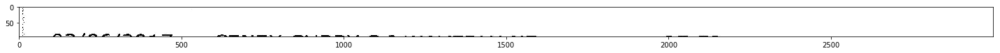


Amount was not detected, re-attempting by removing commas
[None, None, '']


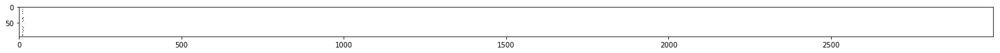

02/06/2017 CENEX CUBBY S I WAVERLY NE -25,52
, istead of . was detected, chainging
[datetime.date(2017, 2, 6), -25.52, ' CENEX CUBBY S I WAVERLY NE ']


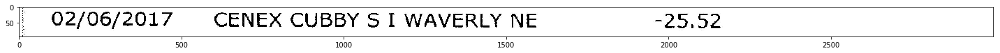


Amount was not detected, re-attempting by removing commas
[None, None, '']


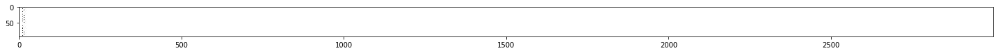

Image (12).jpg
02/06/2017 CENEX CUBBY S I WAVERLY NE -4.98
[datetime.date(2017, 2, 6), -4.98, ' CENEX CUBBY S I WAVERLY NE ']


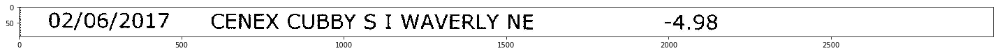


Amount was not detected, re-attempting by removing commas
[None, None, '']


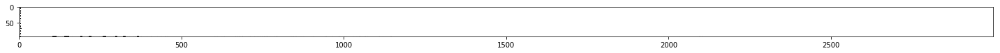

UL/UG6/201/ CENEX CUBBYS II -28.84

f[" fT LIA LOL in 2" Air
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'UL/UG6/201/ CENEX CUBBYS II -28.84\n\nf[- fT LIA LOL in 2- Air']


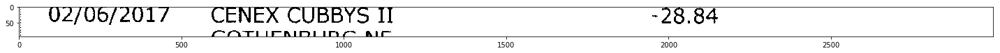

02/06/2017 CENEX CUBBYS II -28.84
[datetime.date(2017, 2, 6), -28.84, ' CENEX CUBBYS II ']


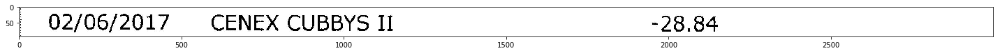

GOTHENBURG NE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'GOTHENBURG NE']


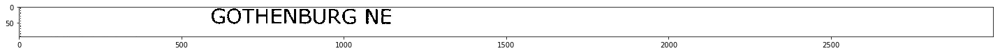

SEM aerar eee | RA eRe aaa ec ce Ei Ea hm

GOTHENBURG NE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'SEM aerar eee | RA eRe aaa ec ce Ei Ea hm\n\nGOTHENBURG NE']


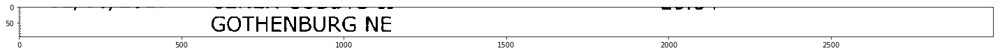

GOTHENBURG NE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'GOTHENBURG NE']


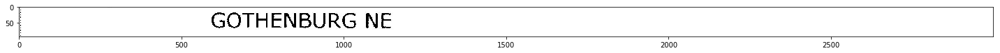

GOTHENBURG NE
Amount was not detected, re-attempting by removing commas
[None, None, 'GOTHENBURG NE']


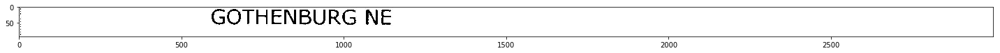

02/06/2017 CENEX CUBBYS II -7.40

Fe ae ee elt lt ee a ee ee ne oe t~_
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 2, 6), None, ' CENEX CUBBYS II -7.40\n\nFe ae ee elt lt ee a ee ee ne oe t~_']


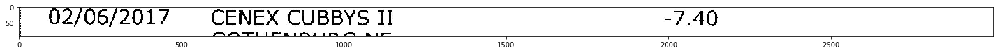

02/06/2017 CENEX CUBBYS II -7.40
[datetime.date(2017, 2, 6), -7.4, ' CENEX CUBBYS II ']


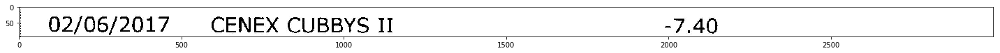

GOTHENBURG NE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'GOTHENBURG NE']


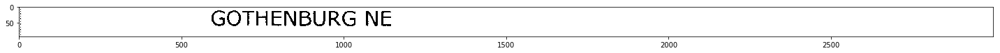

NS SE I Net eZ ee et

GOTH: ENBURG NE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NS SE I Net eZ ee et\n\nGOTH: ENBURG NE']


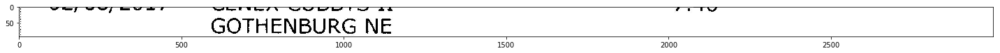

GOTHENBURG NE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'GOTHENBURG NE']


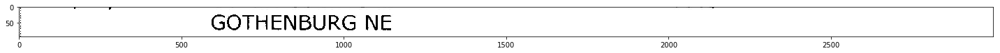

GOTHENBURG NE
Amount was not detected, re-attempting by removing commas
[None, None, 'GOTHENBURG NE']


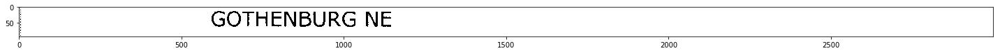

02/06/2017 FLYING J #759 CHEYENNE WY -35.80
[datetime.date(2017, 2, 6), -35.8, ' FLYING J #759 CHEYENNE WY ']


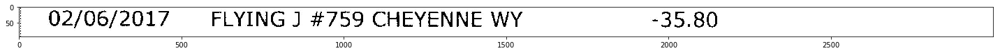

alli scalis,

a
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'alli scalis,\n\na']


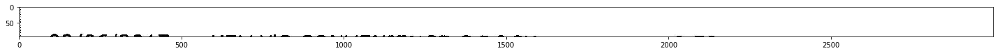


Amount was not detected, re-attempting by removing commas
[None, None, '']


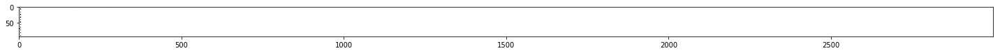

02/06/2017 KELLY'S CONVENIENCE C ROCK -8.72
[datetime.date(2017, 2, 6), -8.72, " KELLY'S CONVENIENCE C ROCK "]


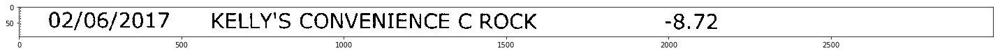

SPR
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'SPR']


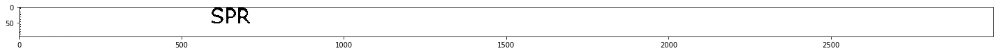

SPR
Amount was not detected, re-attempting by removing commas
[None, None, 'SPR']


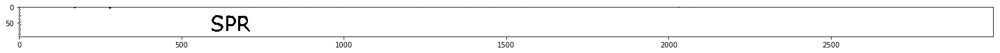

02/06/2017 SHELL Service Station -45.50
[datetime.date(2017, 2, 6), -45.5, ' SHELL Service Station ']


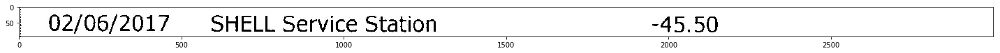

EVANSTON
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'EVANSTON']


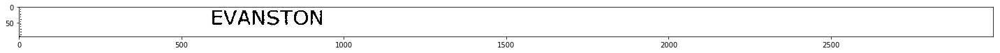

EVANSTON

 wt we

ow Ft
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'EVANSTON\n\n wt we\n\now Ft']


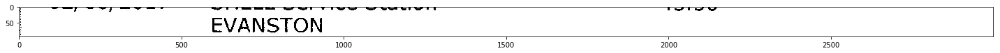

EVANSTON
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'EVANSTON']


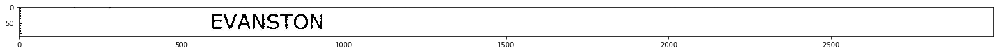

EVANSTON
Amount was not detected, re-attempting by removing commas
[None, None, 'EVANSTON']


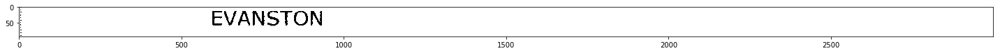

02/06/2017 SHELL Service Station -5.24
[datetime.date(2017, 2, 6), -5.24, ' SHELL Service Station ']


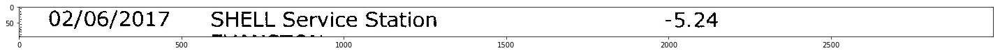

CVANSION
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CVANSION']


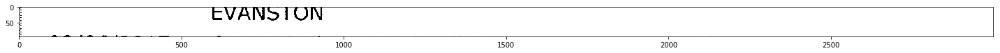

EVANSTON
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'EVANSTON']


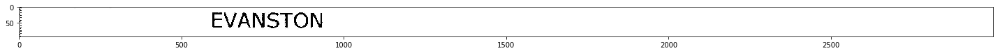

EVANSTON
Amount was not detected, re-attempting by removing commas
[None, None, 'EVANSTON']


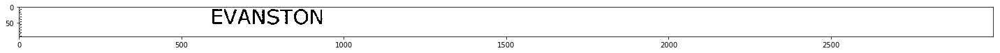

02/06/2017 CHEVRON/PWI #803 - NEP -3.18

Rar rPREL Le?
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 2, 6), None, ' CHEVRON/PWI #803 - NEP -3.18\n\nRar rPREL Le?']


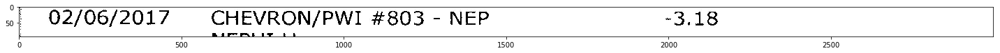

02/06/2017 CHEVRON/PWI #803 - NEP -3.18
[datetime.date(2017, 2, 6), -3.18, ' CHEVRON/PWI #803 - NEP ']


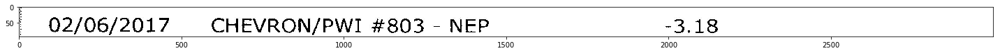

NEPHI U
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NEPHI U']


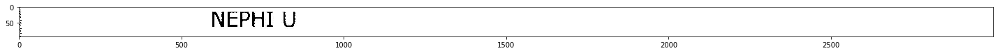

es a a, a ee ee

tT ee SN st 7TrTs Ba et

NEPHI U

eat

. i
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'es a a, a ee ee\n\ntT ee SN st 7TrTs Ba et\n\nNEPHI U\n\neat\n\n. i']


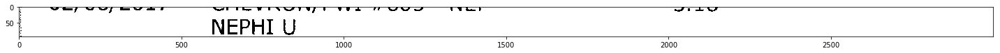

NEPHIU
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NEPHIU']


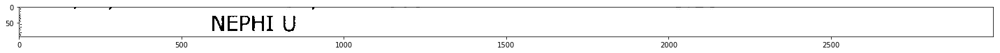

NEPHI U
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NEPHI U']


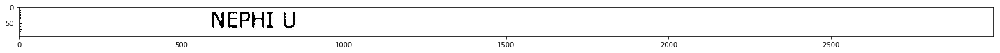

NEPHI U
Amount was not detected, re-attempting by removing commas
[None, None, 'NEPHI U']


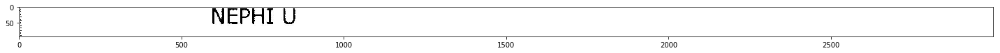

02/06/2017 CHEVRON/PWI #803 - NEP -6.25

Rir™rsaesiwrfto6Umaltla
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 2, 6), None, ' CHEVRON/PWI #803 - NEP -6.25\n\nRir™rsaesiwrfto6Umaltla']


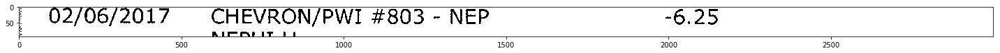

02/06/2017 CHEVRON/PWI #803 - NEP -6.25
[datetime.date(2017, 2, 6), -6.25, ' CHEVRON/PWI #803 - NEP ']


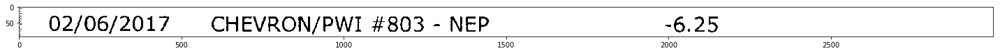

NEPHI U
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NEPHI U']


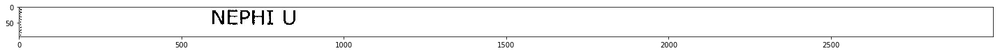

eee Sg eee Sees A ee a a Sa Xe en me oe FP es eee 3 mae 5 ae: Came Rad:

NEPHI U
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'eee Sg eee Sees A ee a a Sa Xe en me oe FP es eee 3 mae 5 ae: Came Rad:\n\nNEPHI U']


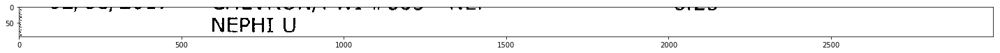

NEPHI U |
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NEPHI U |']


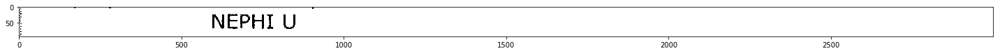

NEPHI U
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NEPHI U']


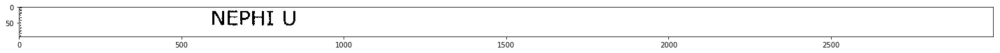

NEPRI U
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NEPRI U']


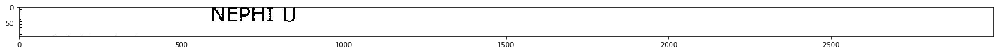

NEL U

fe ™ ££ Fao” Fa. A  w™ Fr) 8 Pt . gp™ a 2. i, ~/~rt we owe
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NEL U\n\nfe ™ ££ Fao” Fa. A  w™ Fr) 8 Pt . gp™ a 2. i, ~/~rt we owe']


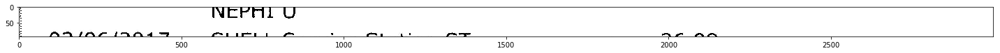

INL beh

 

NAY /AC /97yHA 7 CLEC! | CO wscmpiann Che bt awn COT Nf fNYVCy
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'INL beh\n\n \n\nNAY /AC /97yHA 7 CLEC! | CO wscmpiann Che bt awn COT Nf fNYVCy']


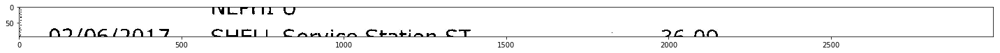

BO Bee FF

0ND/N6B/9N17 CHEI!] Caryvira Ctatinn CT ~2£ NO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'BO Bee FF\n\n0ND/N6B/9N17 CHEI!] Caryvira Ctatinn CT ~2£ NO']


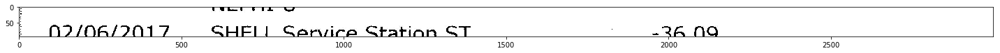

02/06/7017 SHEL! Service Station ST -236.909
Adjusting Window
[None, -236.909, ' SHEL! Service Station ST ']


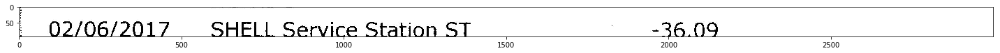

02/06/2017 SHELL Service Station ST -36.09
[datetime.date(2017, 2, 6), -36.09, ' SHELL Service Station ST ']


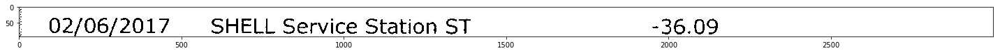

GEORG
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'GEORG']


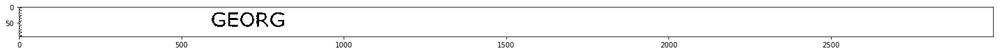

ah: Monn fl ANA aa I

ee EE he Be bee ee Ne FP

GEORG

WON ew EN

wa (iT

wt
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ah: Monn fl ANA aa I\n\nee EE he Be bee ee Ne FP\n\nGEORG\n\nWON ew EN\n\nwa (iT\n\nwt']


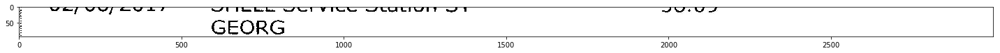

GEORG it*~”
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'GEORG it*~”']


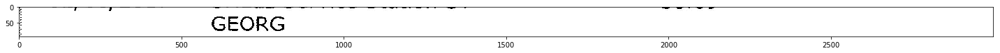

GEORG
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'GEORG']


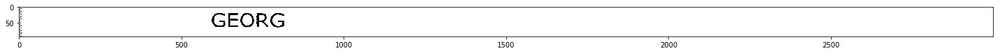


Amount was not detected, re-attempting by removing commas
[None, None, '']


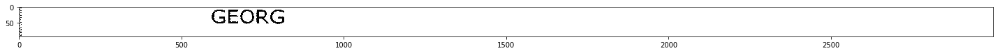

02/06/2017 DENNY'S #6260 ST GEORGE UT -21.97
[datetime.date(2017, 2, 6), -21.97, " DENNY'S #6260 ST GEORGE UT "]


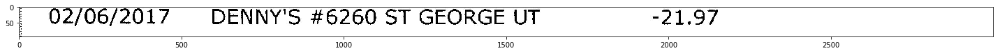

re ™ Fm em Um oO | At |

Armes

ge

a-™|™: arms

mn RAFAR &
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 're ™ Fm em Um oO | At |\n\nArmes\n\nge\n\na-™|™: arms\n\nmn RAFAR &']


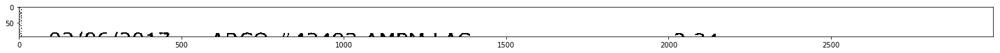


Amount was not detected, re-attempting by removing commas
[None, None, '']


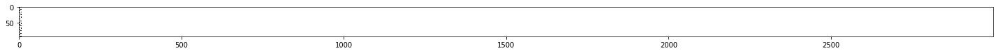

02/06/2017 ARCO #42493 AMPM LAS -2.34
[datetime.date(2017, 2, 6), -2.34, ' ARCO #42493 AMPM LAS ']


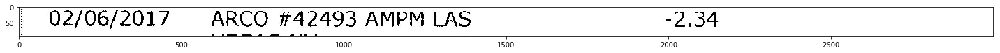

VEGAS NV
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'VEGAS NV']


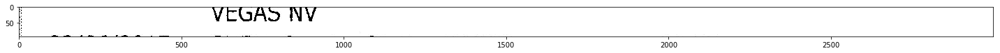

VEGAS NV
Amount was not detected, re-attempting by removing commas
[None, None, 'VEGAS NV']


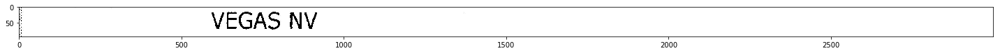

02/06/2017 SHELL Service Station BAKER -38.55
[datetime.date(2017, 2, 6), -38.55, ' SHELL Service Station BAKER ']


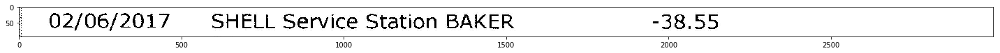


Amount was not detected, re-attempting by removing commas
[None, None, '']


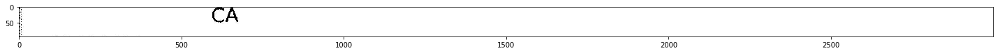

02/06/2017 LOVES COUNTRY TEHACHAPI -6.98
[datetime.date(2017, 2, 6), -6.98, ' LOVES COUNTRY TEHACHAPI ']


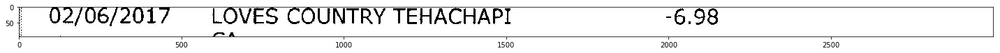

ru ™ FS PO P™* IO rf! st |

P am, Te oll co, EE a, ce, I

pers 4. Oe 1

aa wml

-~™

~~ -
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ru ™ FS PO P™* IO rf! st |\n\nP am, Te oll co, EE a, ce, I\n\npers 4. Oe 1\n\naa wml\n\n--™\n\n-- -']


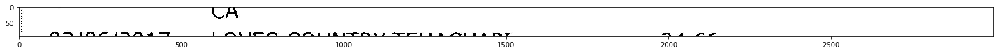

CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CA']


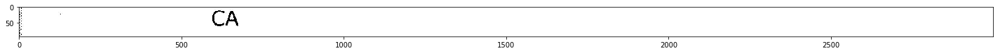


Amount was not detected, re-attempting by removing commas
[None, None, '']


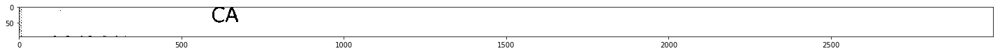

U2Z/U6/Z017/ LOVES COUNTRY TEHACHAPI -24.66
Adjusting Window
[None, -24.66, 'U2Z/U6/Z017/ LOVES COUNTRY TEHACHAPI ']


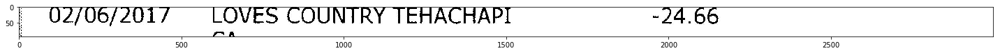

02/06/2017 LOVES COUNTRY TEHACHAPI -24.66
[datetime.date(2017, 2, 6), -24.66, ' LOVES COUNTRY TEHACHAPI ']


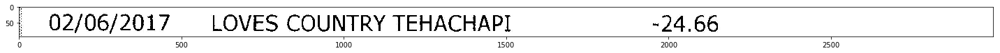


Amount was not detected, re-attempting by removing commas
[None, None, '']


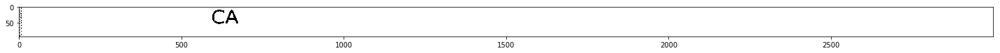

02/06/2017 SHELL Service Station

T™ AIST? Rr f@ FP
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 2, 6), None, ' SHELL Service Station\n\nT™ AIST? Rr f@ FP']


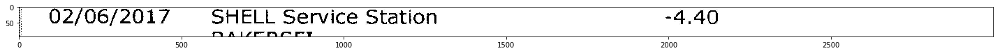

02/06/2017 SHELL Service Station -4.40
[datetime.date(2017, 2, 6), -4.4, ' SHELL Service Station ']


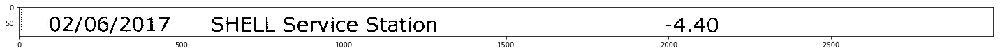

BAKERSFI
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'BAKERSFI']


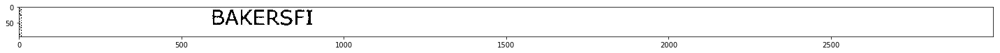

Sa: Se

a a a

BAKERSFI >
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Sa: Se\n\na a a\n\nBAKERSFI >']


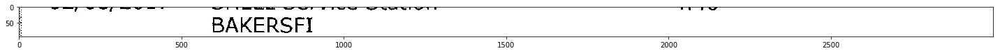

BAKERSFI
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'BAKERSFI']


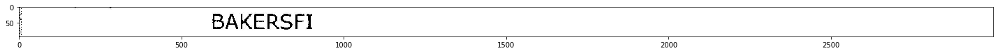

BAKERSFI
Amount was not detected, re-attempting by removing commas
[None, None, 'BAKERSFI']


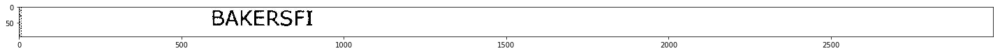

Image (13).jpg
02/06/2017. PETRO #346 SANT SANTA -12.73
[datetime.date(2017, 2, 6), -12.73, '. PETRO #346 SANT SANTA ']


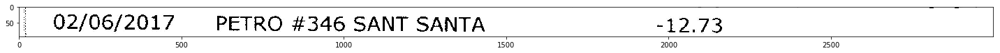

NELLA CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NELLA CA']


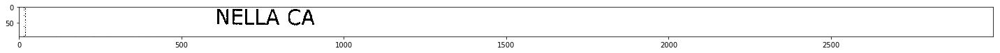

NELLA CA |
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NELLA CA |']


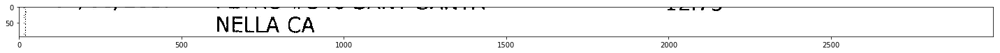

NELLA CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NELLA CA']


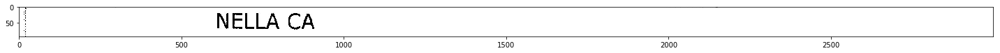

NELLA CA
Amount was not detected, re-attempting by removing commas
[None, None, 'NELLA CA']


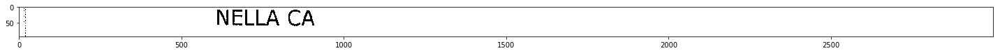

02/06/2017 SHELL Service Station SANTA -37.88
[datetime.date(2017, 2, 6), -37.88, ' SHELL Service Station SANTA ']


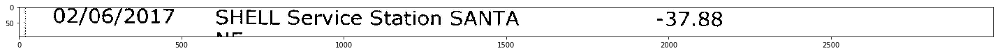

NC

fA NV 1A Mrs ry eee Ss t? ™: 2 Pae-epaARI-™ ™ AR I™ A
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NC\n\nfA NV 1A Mrs ry eee Ss t? ™: 2 Pae-epaARI-™ ™ AR I™ A']


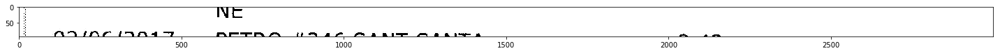


Amount was not detected, re-attempting by removing commas
[None, None, '']


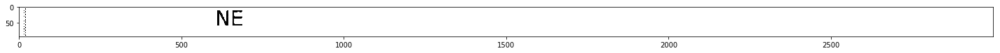

02/06/2017 PETRO #346 SANT SANTA -3.42
[datetime.date(2017, 2, 6), -3.42, ' PETRO #346 SANT SANTA ']


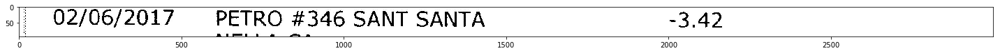

NELLA CA

Pe, |! FF Pm @ £ Oo, Pr OS pa a a i i i a ee Sai amt ee ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NELLA CA\n\nPe, |! FF Pm @ £ Oo, Pr OS pa a a i i i a ee Sai amt ee ee']


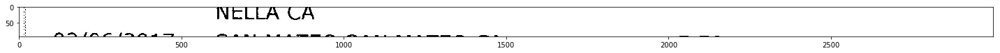

NELLA CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NELLA CA']


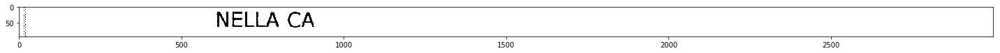

NELLA CA
Amount was not detected, re-attempting by removing commas
[None, None, 'NELLA CA']


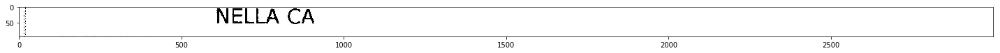

02/06/2017

SAN MATEO SAN MATEO CA

-7.58
[datetime.date(2017, 2, 6), -7.58, '\n\nSAN MATEO SAN MATEO CA\n\n']


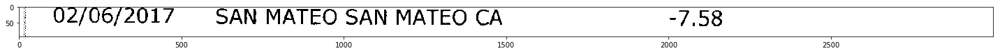

re ™ TPO IO fF Oe eanprm™nm some sem <+ wi ae oe oe a Gk a a sees
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 're ™ TPO IO fF Oe eanprm™nm some sem <+ wi ae oe oe a Gk a a sees']


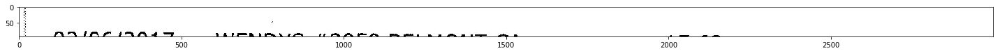


Amount was not detected, re-attempting by removing commas
[None, None, '']


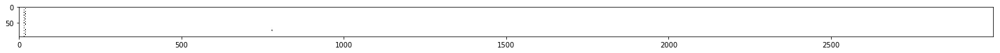

02/06/2017 WENDYS #3959 BELMONT CA -15.63
[datetime.date(2017, 2, 6), -15.63, ' WENDYS #3959 BELMONT CA ']


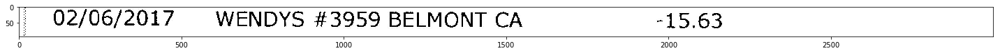

Mo re lhl Or

ce
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Mo re lhl Or\n\nce']


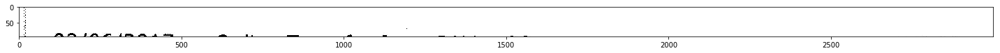


Amount was not detected, re-attempting by removing commas
[None, None, '']


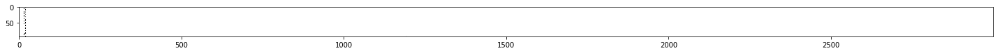

02/06/2017 Online Transfer from SAV ...03 150.00
[datetime.date(2017, 2, 6), 150.0, ' Online Transfer from SAV ...03']


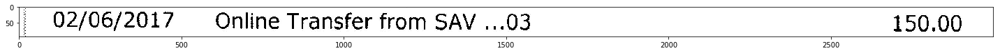


Amount was not detected, re-attempting by removing commas
[None, None, '']


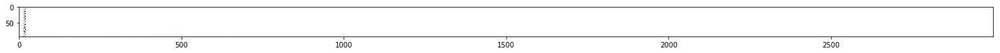

02/06/2017 Online Transfer from SAV ...03
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 2, 6), None, ' Online Transfer from SAV ...03']


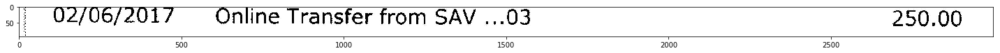

02/06/2017 Online Transfer from SAV ...03 250.00
[datetime.date(2017, 2, 6), 250.0, ' Online Transfer from SAV ...03']


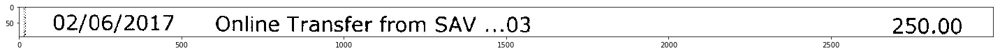


Amount was not detected, re-attempting by removing commas
[None, None, '']


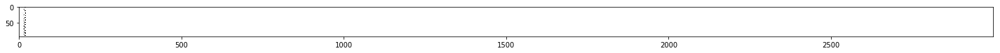

02/03/2017 THE HOME DEPOT #0632 SAN -2.15

nena  --
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 2, 3), None, ' THE HOME DEPOT #0632 SAN -2.15\n\nnena  --']


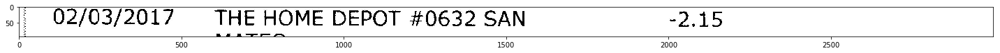

02/03/2017 ©THE HOME DEPOT #0632 SAN -2.15
[datetime.date(2017, 2, 3), -2.15, ' ©THE HOME DEPOT #0632 SAN ']


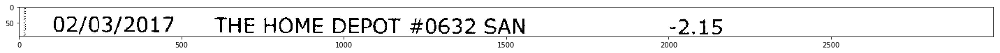

MATEO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MATEO']


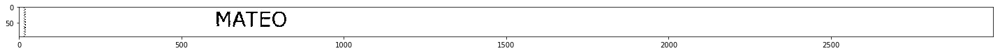

ee Oe Ee SE ee F hee FPN Pe lL EO FEN Net we Ge ee FONE ae ww

MATEO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee Oe Ee SE ee F hee FPN Pe lL EO FEN Net we Ge ee FONE ae ww\n\nMATEO']


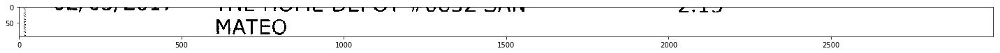

MATEO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MATEO']


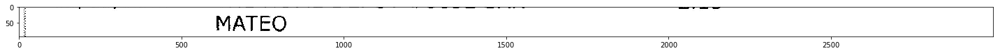

MATEO
Amount was not detected, re-attempting by removing commas
[None, None, 'MATEO']


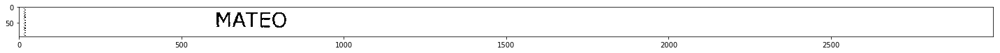

02/03/2017 7-ELEVEN SAN MATEO CA -5.08
[datetime.date(2017, 2, 3), -5.08, ' 7-ELEVEN SAN MATEO CA ']


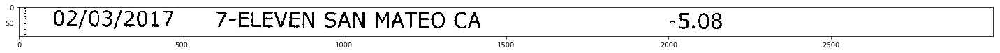


Amount was not detected, re-attempting by removing commas
[None, None, '']


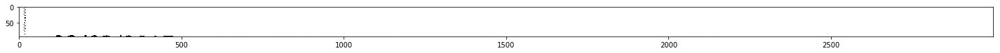

UeZ/OUS5/2£01/ SAN MATEO SAN MATEO CA -16.22
Adjusting Window
[None, -16.22, 'UeZ/OUS5/2£01/ SAN MATEO SAN MATEO CA ']


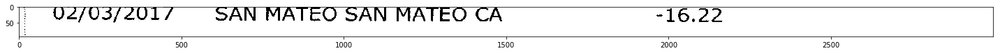

02/03/2017 SAN MATEO SAN MATEO CA -16.22
[datetime.date(2017, 2, 3), -16.22, ' SAN MATEO SAN MATEO CA ']


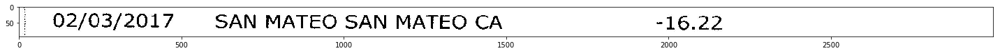

ees es
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ees es']


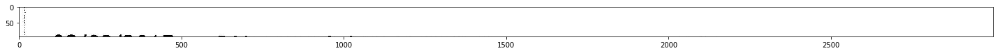


Amount was not detected, re-attempting by removing commas
[None, None, '']


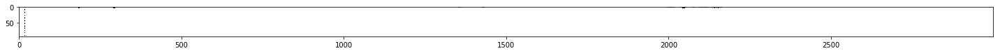

02/03/2017 SAN MATEO SAN MATEO CA -5.91
[datetime.date(2017, 2, 3), -5.91, ' SAN MATEO SAN MATEO CA ']


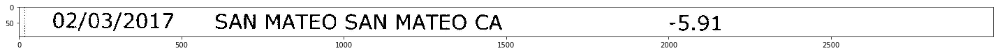


Amount was not detected, re-attempting by removing commas
[None, None, '']


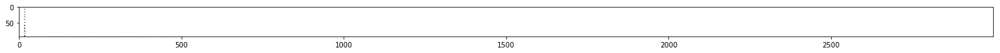

02/03/2017 Amazon web services -12.69
[datetime.date(2017, 2, 3), -12.69, ' Amazon web services ']


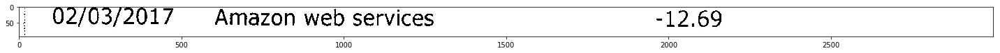

aws.amazon

pe m™® J re ™® FAO aS  a wee Se Cpe gee ee oR: EG “es eee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aws.amazon\n\npe m™® J re ™® FAO aS  a wee Se Cpe gee ee oR: EG “es eee']


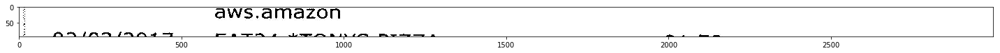

aws.amazon
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aws.amazon']


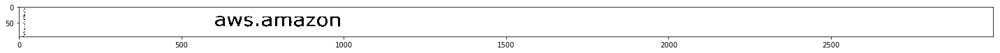

aws.amazon
Amount was not detected, re-attempting by removing commas
[None, None, 'aws.amazon']


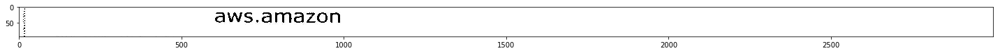

02/03/2017 EAT24 *TONYS PIZZA -21.58

frase ™ ZziieartNtirre
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 2, 3), None, ' EAT24 *TONYS PIZZA -21.58\n\nfrase ™ ZziieartNtirre']


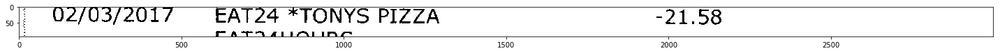

02/03/2017 EAT24 *TONYS PIZZA -21.58
[datetime.date(2017, 2, 3), -21.58, ' EAT24 *TONYS PIZZA ']


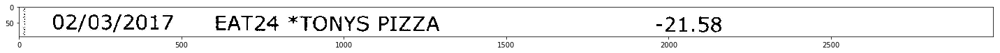

EAT24HOURS.
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'EAT24HOURS.']


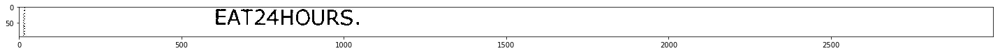

OO EAT24HOURS. _
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'OO EAT24HOURS. _']


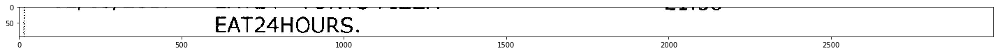

EAT24HOURS.
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'EAT24HOURS.']


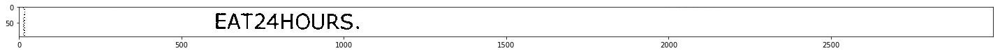

EAT24HOURS.
Amount was not detected, re-attempting by removing commas
[None, None, 'EAT24HOURS.']


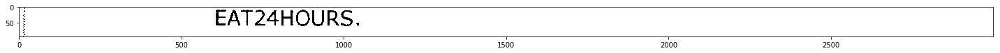

02/03/2017 MCDONALD'S F10660 PALO -11.09

a an
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 2, 3), None, " MCDONALD'S F10660 PALO -11.09\n\na an"]


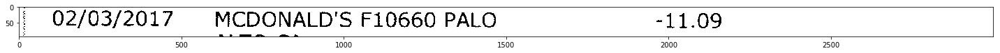

02/03/2017 MCDONALD'S F10660 PALO -11.09
[datetime.date(2017, 2, 3), -11.09, " MCDONALD'S F10660 PALO "]


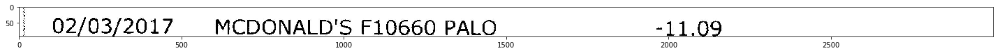

ALTO CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ALTO CA']


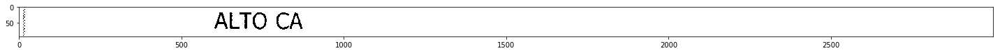

NM Bef Nf me NI POP LN ENN ur RN ONL NY ed

ALTO CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NM Bef Nf me NI POP LN ENN ur RN ONL NY ed\n\nALTO CA']


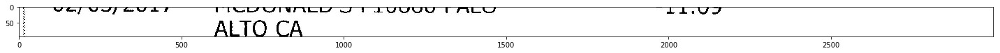

we ee 8
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'we ee 8']


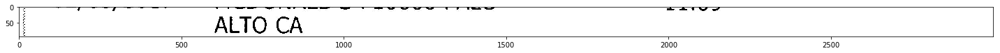

ALTO CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ALTO CA']


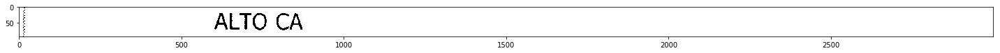

ALTO CA
Amount was not detected, re-attempting by removing commas
[None, None, 'ALTO CA']


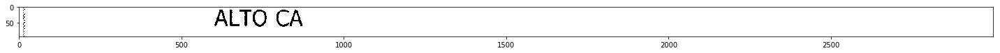

02/02/2017 EAT24 *TONYS PIZZA -21.58
[datetime.date(2017, 2, 2), -21.58, ' EAT24 *TONYS PIZZA ']


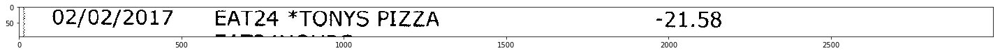

ee eee eee ee ee eee

CAIZ4RHOURS.
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee eee eee ee ee eee\n\nCAIZ4RHOURS.']


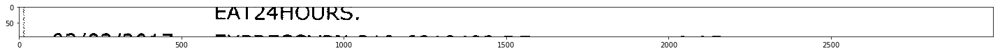

EAT24HOURS.
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'EAT24HOURS.']


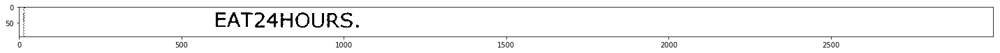

EAT24HOURS.
Amount was not detected, re-attempting by removing commas
[None, None, 'EAT24HOURS.']


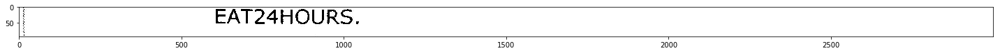

02/02/2017 EXPRESSVPN 310-6018492 DE -12.95
[datetime.date(2017, 2, 2), -12.95, ' EXPRESSVPN 310-6018492 DE ']


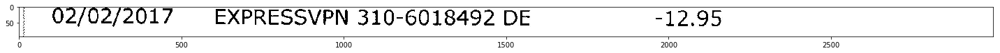

Image (14).jpg
02/01/2017 WILLOW COVE GAS MENLO -6.15
[datetime.date(2017, 2, 1), -6.15, ' WILLOW COVE GAS MENLO ']


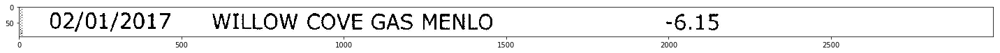

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


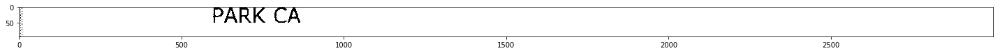

PARK CA 
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA ']


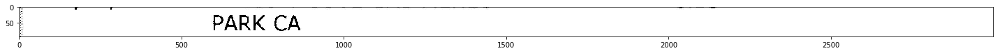

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


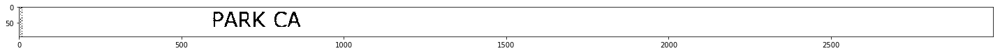

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


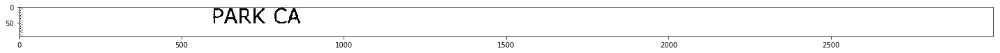

02/01/2017 SAFEWAY STORE 2719 Menlo P -39.62
[datetime.date(2017, 2, 1), -39.62, ' SAFEWAY STORE 2719 Menlo P ']


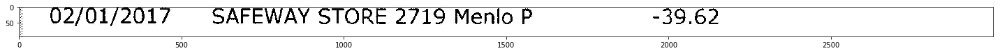

fri ™ Pea IO A. |S PA; PR 8 OP OP Pe ER OR OEE llC™ OA 2a ™ sa
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'fri ™ Pea IO A. |S PA; PR 8 OP OP Pe ER OR OEE llC™ OA 2a ™ sa']


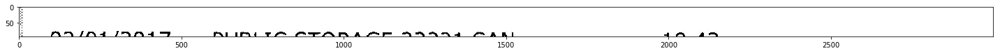


Amount was not detected, re-attempting by removing commas
[None, None, '']


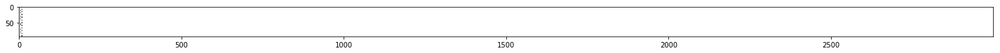

02/01/2017 PUBLIC STORAGE 22321 SAN -10.43

et a a a
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 2, 1), None, ' PUBLIC STORAGE 22321 SAN -10.43\n\net a a a']


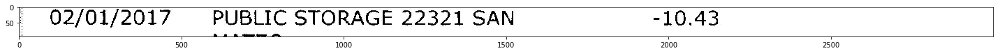

02/01/2017 PUBLIC STORAGE 22321 SAN -10.43
[datetime.date(2017, 2, 1), -10.43, ' PUBLIC STORAGE 22321 SAN ']


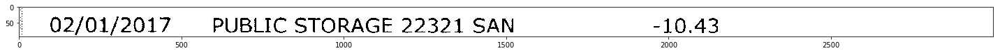

MATEO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MATEO']


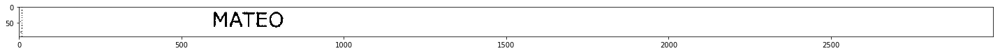

ws  fp Se   oe Ne ee ee ee ee ee ee me Ne FT lw

MATEO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ws  fp Se   oe Ne ee ee ee ee ee ee me Ne FT lw\n\nMATEO']


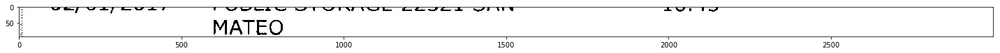

MATEO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MATEO']


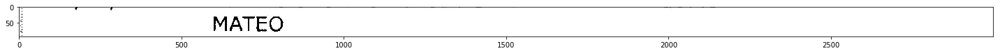

MATEO
Amount was not detected, re-attempting by removing commas
[None, None, 'MATEO']


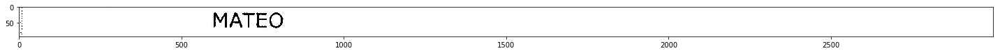

02/01/2017 DONUT DELITE MENLO PARK CA -12.51
[datetime.date(2017, 2, 1), -12.51, ' DONUT DELITE MENLO PARK CA ']


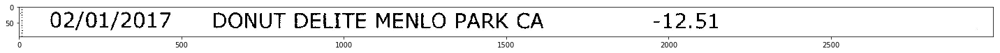


Amount was not detected, re-attempting by removing commas
[None, None, '']


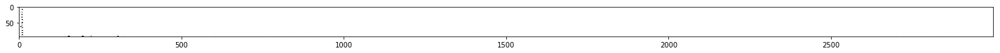

OZ/O1/2Z01/ | FIRSTMERIT BANK TRANSFER
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'OZ/O1/2Z01/ | FIRSTMERIT BANK TRANSFER']


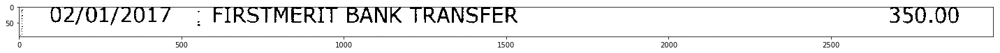

02/01/2017  - FIRSTMERIT BANK TRANSFER 350.00
[datetime.date(2017, 2, 1), 350.0, '  - FIRSTMERIT BANK TRANSFER']


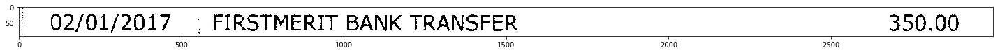

01/31/2017 WILLOW COVE GAS MENLO -4.14
[datetime.date(2017, 1, 31), -4.14, ' WILLOW COVE GAS MENLO ']


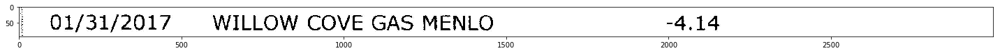

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


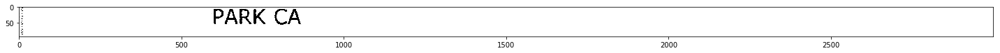

SREB: SORRENTINO Aguas BSR Pe

PARK CA |
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'SREB: SORRENTINO Aguas BSR Pe\n\nPARK CA |']


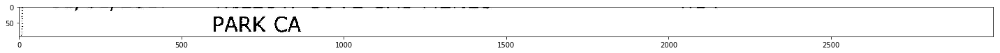

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


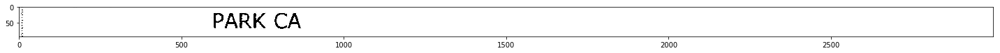

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


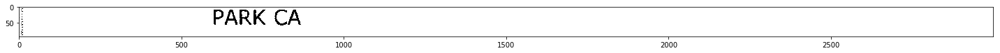

01/31/2017 TONY'S PIZZA MENLO PARK CA -33.00
[datetime.date(2017, 1, 31), -33.0, " TONY'S PIZZA MENLO PARK CA "]


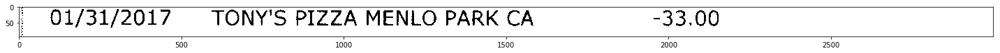

oc ca 2 wet Ges «See ick ee ces ox ees «Se ce ee es el ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'oc ca 2 wet Ges «See ick ee ces ox ees «Se ce ee es el ee']


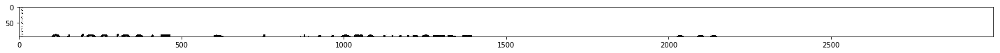


Amount was not detected, re-attempting by removing commas
[None, None, '']


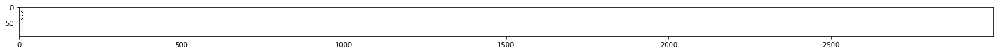

01/30/2017 Dropbox*44C591WJ2TD7 -9.99
[datetime.date(2017, 1, 30), -9.99, ' Dropbox*44C591WJ2TD7 ']


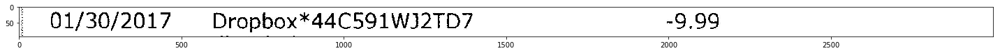

bD.tt/ccn
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'bD.tt/ccn']


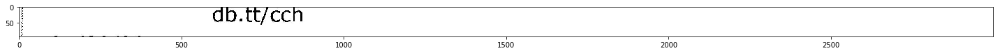

db.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'db.tt/cch']


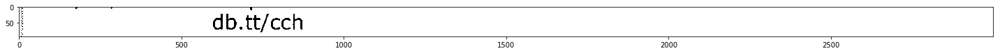

db.tt/cch
Amount was not detected, re-attempting by removing commas
[None, None, 'db.tt/cch']


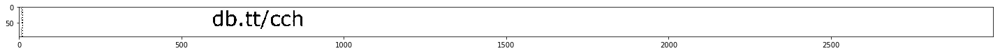

01/30/2017 DOORDASH-JACK IN THE 650- -21.01
[datetime.date(2017, 1, 30), -21.01, ' DOORDASH-JACK IN THE 650- ']


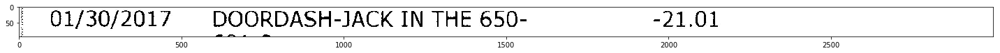


Amount was not detected, re-attempting by removing commas
[None, None, '']


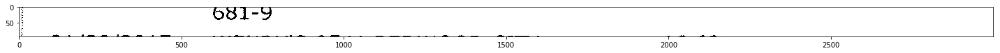

UL/s0/2Z017 WENDY > QVo4l REDWOOD CIIY ~16.62
CAR
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'UL/s0/2Z017 WENDY > QVo4l REDWOOD CIIY ~16.62\nCAR']


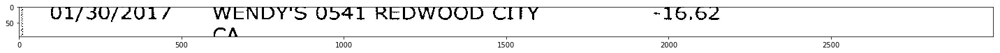

01/30/2017 WENDY'S 0541 REDWOOD CITY -16.62
[datetime.date(2017, 1, 30), -16.62, " WENDY'S 0541 REDWOOD CITY "]


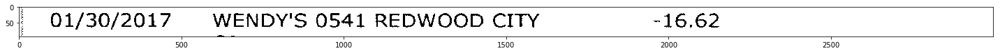


Amount was not detected, re-attempting by removing commas
[None, None, '']


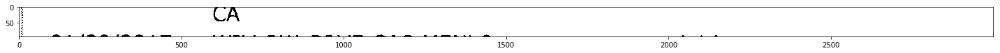

UL/SU/Z01L/ WILLOW COVE GAS MENLO “4.14

DADDY CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'UL/SU/Z01L/ WILLOW COVE GAS MENLO “4.14\n\nDADDY CA']


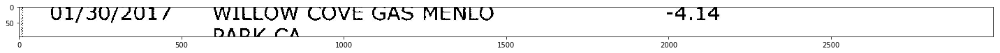

01/30/2017 WILLOW COVE GAS MENLO -4.14
[datetime.date(2017, 1, 30), -4.14, ' WILLOW COVE GAS MENLO ']


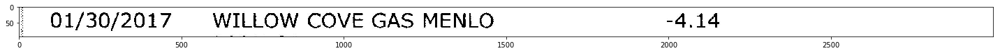

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


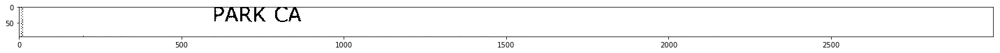

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


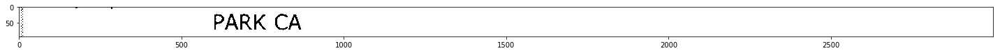

01/30/2017 | HAPPY DONUTS PALO ALTO CA -12.46
[datetime.date(2017, 1, 30), -12.46, ' | HAPPY DONUTS PALO ALTO CA ']


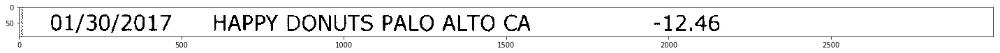


Amount was not detected, re-attempting by removing commas
[None, None, '']


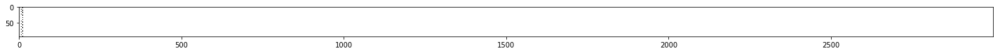

01/30/2017 DONUT DELITE MENLO PARK CA -13.93
[datetime.date(2017, 1, 30), -13.93, ' DONUT DELITE MENLO PARK CA ']


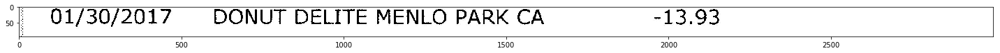


Amount was not detected, re-attempting by removing commas
[None, None, '']


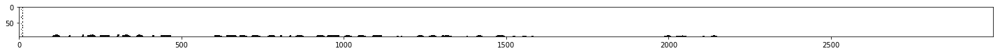

Ul/LZ// £017 PErPDOYS SI1QORE # 62Z/ LU SAN -£/.49

f"AT)
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Ul/LZ// £017 PErPDOYS SI1QORE # 62Z/ LU SAN -£/.49\n\nf-AT)']


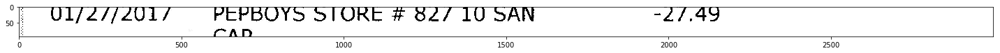

01/27/2017 PEPBOYS STORE # 827 10 SAN -27.49
[datetime.date(2017, 1, 27), -27.49, ' PEPBOYS STORE # 827 10 SAN ']


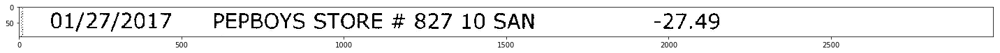

CAR
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CAR']


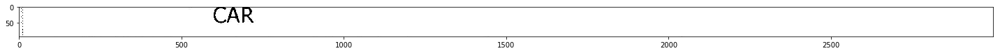

CAR
Amount was not detected, re-attempting by removing commas
[None, None, 'CAR']


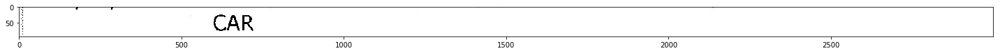

01/27/2017 WILLOW COVE GAS MENLO -8.96
[datetime.date(2017, 1, 27), -8.96, ' WILLOW COVE GAS MENLO ']


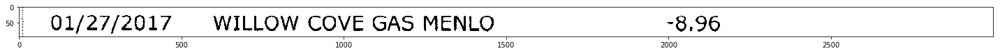

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


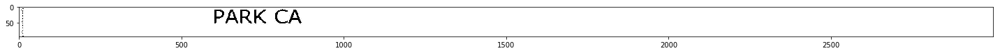

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


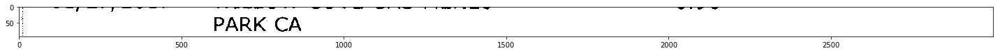

01/27/2017 ARCO PAYPOINT SAN MATEO -20.35
[datetime.date(2017, 1, 27), -20.35, ' ARCO PAYPOINT SAN MATEO ']


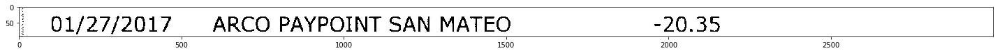


Amount was not detected, re-attempting by removing commas
[None, None, '']


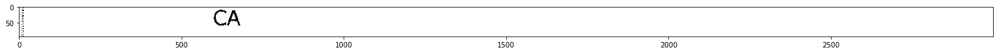

ECP oTe ere
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ECP oTe ere']


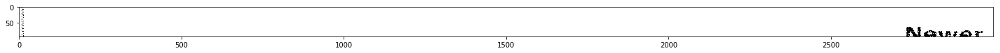


Amount was not detected, re-attempting by removing commas
[None, None, '']


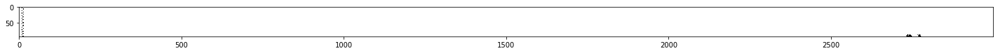

Image (15).jpg
01/27/2017 SQC*LOUIS BARRIS . / CA “9.92
Amount was not detected, re-attempting by removing commas
[datetime.date(2017, 1, 27), None, ' SQC*LOUIS BARRIS . / CA “9.92']


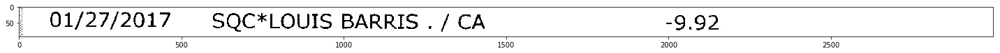


Amount was not detected, re-attempting by removing commas
[None, None, '']


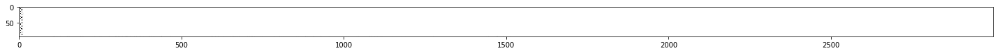

U1/26/2017 DOORDASH-JACK IN THE 650- -21.01

f (54 £*
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'U1/26/2017 DOORDASH-JACK IN THE 650- -21.01\n\nf (54 £*']


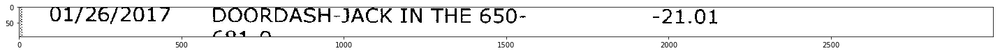

01/26/2017 DOORDASH-JACK IN THE 650- -21.01
[datetime.date(2017, 1, 26), -21.01, ' DOORDASH-JACK IN THE 650- ']


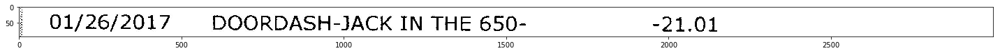

681-9
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '681-9']


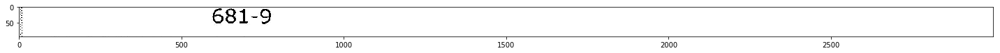

ee

een:

Rr o_o
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee\n\neen:\n\nRr o_o']


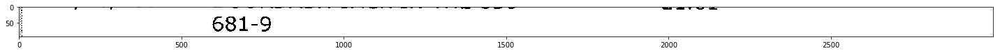

681-9
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '681-9']


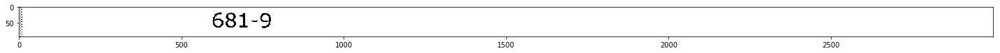

681-9
Amount was not detected, re-attempting by removing commas
[None, None, '681-9']


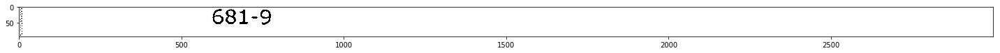

01/26/2017 Online Transfer to CHK ...5312 -13,500.00
Amount was not detected, re-attempting by removing commas
[datetime.date(2017, 1, 26), -13500.0, ' Online Transfer to CHK ...5312 -13,500.00']


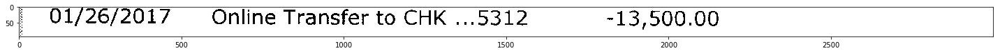

fxn Qh OOO IT rf. 1 | me eam@meina sts BOF mm  om™ lO  om™hUCUcklcele
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'fxn Qh OOO IT rf. 1 | me eam@meina sts BOF mm  om™ lO  om™hUCUcklcele']


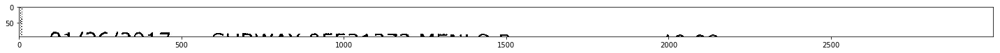


Amount was not detected, re-attempting by removing commas
[None, None, '']


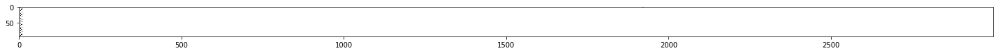

01/26/2017 SUBWAY 05521273 MENLO P -10.98
[datetime.date(2017, 1, 26), -10.98, ' SUBWAY 05521273 MENLO P ']


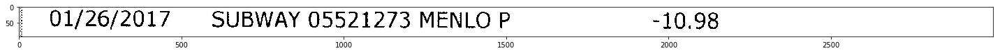

ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee']


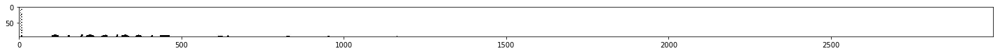


Amount was not detected, re-attempting by removing commas
[None, None, '']


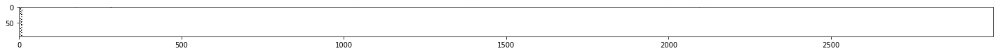

01/26/2017  : Chase QuickPay Electronic Tran 13,500.00
Amount was not detected, re-attempting by removing commas
[datetime.date(2017, 1, 26), 13500.0, '  : Chase QuickPay Electronic Tran 13,500.00']


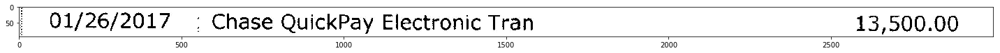

01/25/2017 SUBWAY 05521273 MENLO P -17.14
[datetime.date(2017, 1, 25), -17.14, ' SUBWAY 05521273 MENLO P ']


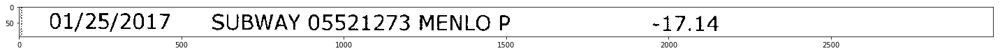


Amount was not detected, re-attempting by removing commas
[None, None, '']


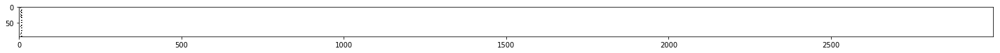

01/24/2017

A &S 76 MENLO PARK CA

-3.49
[datetime.date(2017, 1, 24), -3.49, '\n\nA &S 76 MENLO PARK CA\n\n']


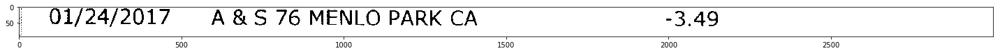

f% 4 I mraealit* rate

gm rm pm sb Et

gna

Tre rT™|™,|J A FT| ma Fr e™
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'f% 4 I mraealit* rate\n\ngm rm pm sb Et\n\ngna\n\nTre rT™|™,|J A FT| ma Fr e™']


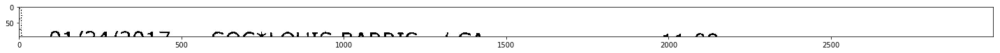


Amount was not detected, re-attempting by removing commas
[None, None, '']


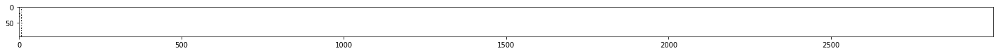

01/24/2017 SQC*LOUIS BARRIS ./ CA -11.09
[datetime.date(2017, 1, 24), -11.09, ' SQC*LOUIS BARRIS ./ CA ']


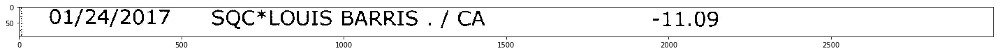

mm a

emis

Sam M™ «1 |

a eed
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'mm a\n\nemis\n\nSam M™ «1 |\n\na eed']


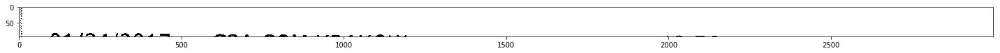


Amount was not detected, re-attempting by removing commas
[None, None, '']


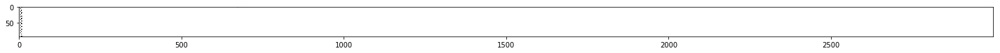

01/24/2017 G2A COM KRAKOW -13.76
[datetime.date(2017, 1, 24), -13.76, ' G2A COM KRAKOW ']


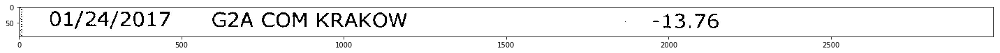


Amount was not detected, re-attempting by removing commas
[None, None, '']


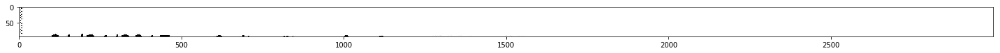

U1L/2Z24/Z01/7 Oniine Transfer from SAV ...03
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'U1L/2Z24/Z01/7 Oniine Transfer from SAV ...03']


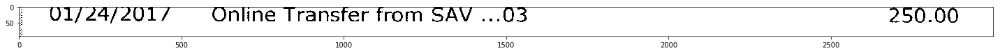

01/24/2017 Online Transfer from SAV ...03 250.00
[datetime.date(2017, 1, 24), 250.0, ' Online Transfer from SAV ...03']


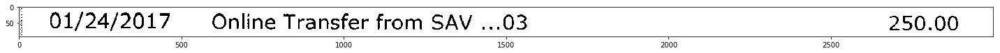


Amount was not detected, re-attempting by removing commas
[None, None, '']


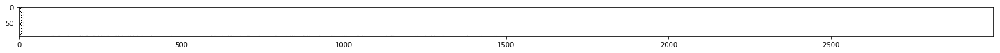

QOI/25/2Z01/ VZWRLSS*APOCC VISN 800- -144.33

rasa maare
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'QOI/25/2Z01/ VZWRLSS*APOCC VISN 800- -144.33\n\nrasa maare']


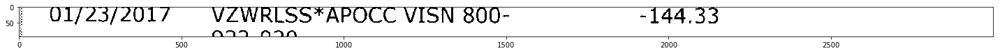

01/23/2017 VZWRLSS*APOCC VISN 800- -144.33
[datetime.date(2017, 1, 23), -144.33, ' VZWRLSS*APOCC VISN 800- ']


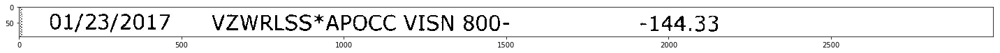

922-020
Adjusting Window
[None, -20.0, '922']


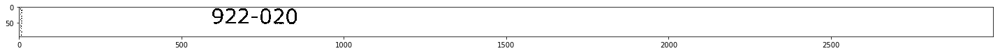

922-020
[None, -20.0, '922']


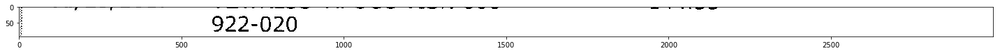

01/23/2017 EL RANCHO MARKE MENLO -10.62
[datetime.date(2017, 1, 23), -10.62, ' EL RANCHO MARKE MENLO ']


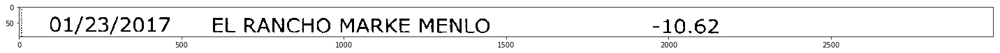

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


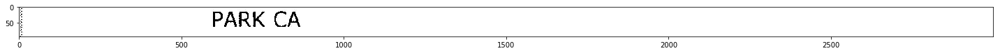

Sa SS Soe ee ES eee Be EN TB Bre FO eee WY NY oe

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Sa SS Soe ee ES eee Be EN TB Bre FO eee WY NY oe\n\nPARK CA']


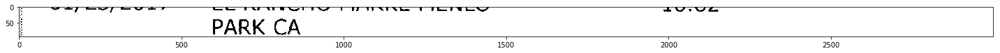

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


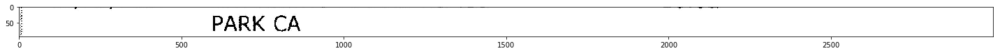

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


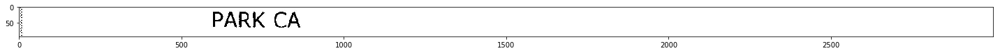

01/23/2017 EL RANCHO MARKE MENLO -12.75
[datetime.date(2017, 1, 23), -12.75, ' EL RANCHO MARKE MENLO ']


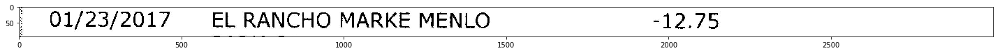

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


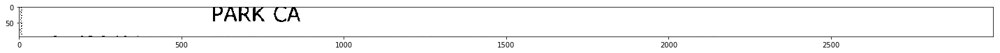

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


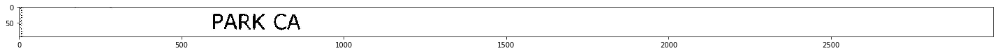

01/23/2017 SUBWAY 05521273 MENLO P -14.38
[datetime.date(2017, 1, 23), -14.38, ' SUBWAY 05521273 MENLO P ']


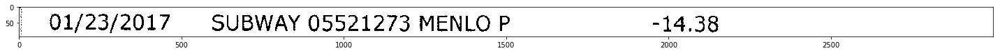


Amount was not detected, re-attempting by removing commas
[None, None, '']


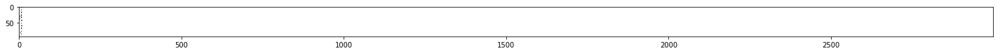

01/23/2017 WENDYS #3959 BELMONT CA -15.63
[datetime.date(2017, 1, 23), -15.63, ' WENDYS #3959 BELMONT CA ']


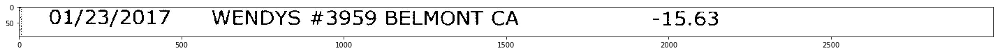

fy 4 f~AT™|!), Uv |, PFA st OS BearTrTerei:seiere™miaskr wm™mr™meirr™ i-™ -ao™ paren aisn *™ ~~ ce, a
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'fy 4 f-AT™|!), Uv |, PFA st OS BearTrTerei:seiere™miaskr wm™mr™meirr™ i-™ -ao™ paren aisn *™ -- ce, a']


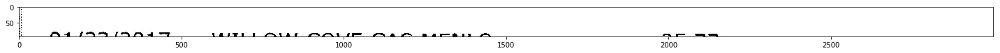


Amount was not detected, re-attempting by removing commas
[None, None, '']


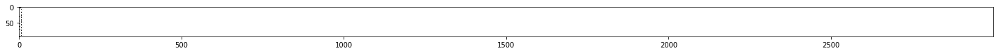

01/23/2017 WILLOW COVE GAS MENLO -35.77
[datetime.date(2017, 1, 23), -35.77, ' WILLOW COVE GAS MENLO ']


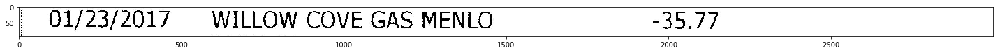

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


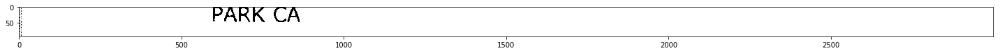

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


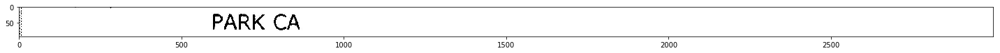


Amount was not detected, re-attempting by removing commas
[None, None, '']


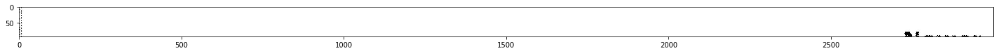

Image (16).jpg
01/23/2017 SKYWOOD TRADING POST -19.21
[datetime.date(2017, 1, 23), -19.21, ' SKYWOOD TRADING POST ']


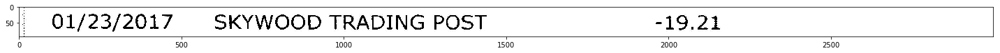

WOODSIDE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'WOODSIDE']


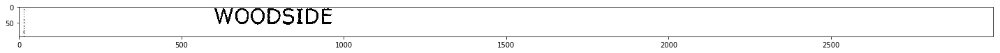

WOODSIDE
Amount was not detected, re-attempting by removing commas
[None, None, 'WOODSIDE']


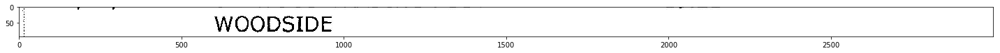

01/23/2017 Online Transfer from SAV ...03 150.00
[datetime.date(2017, 1, 23), 150.0, ' Online Transfer from SAV ...03']


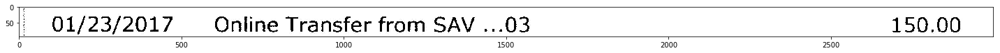


Amount was not detected, re-attempting by removing commas
[None, None, '']


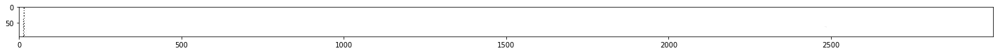

01/20/2017 |©DOORDASH-CURRY UP NOW -22.23
[datetime.date(2017, 1, 20), -22.23, ' |©DOORDASH-CURRY UP NOW ']


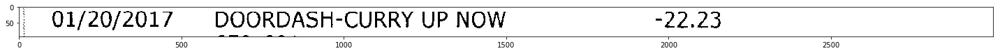

i a i

650-601 -
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'i a i\n\n650-601 -']


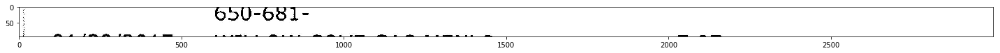

650-681-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '650-681-']


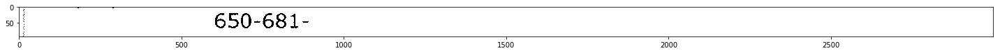

650-681-
Amount was not detected, re-attempting by removing commas
[None, None, '650-681-']


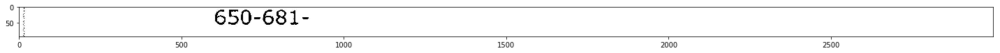

01/20/2017 WILLOW COVE GAS MENLO -7.07
[datetime.date(2017, 1, 20), -7.07, ' WILLOW COVE GAS MENLO ']


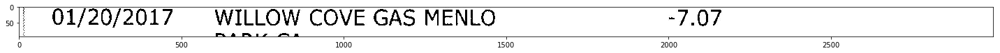

™

a

Pom™ Mm fom Me |

rAKKR CA

fn

a a ea ae

mt re  om lee ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '™\n\na\n\nPom™ Mm fom Me |\n\nrAKKR CA\n\nfn\n\na a ea ae\n\nmt re  om lee ee']


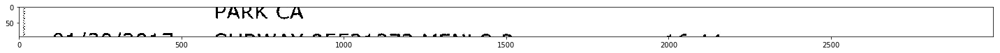

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


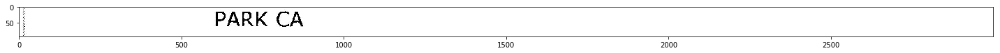

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


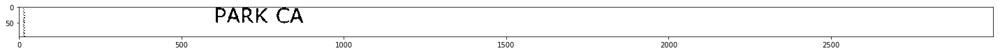

01/20/2017 SUBWAY 05521273 MENLO P -16.44
[datetime.date(2017, 1, 20), -16.44, ' SUBWAY 05521273 MENLO P ']


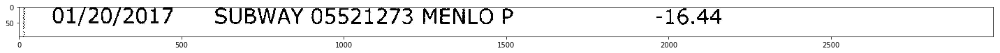

f~%@ir™~rmem iN AA a | em ae if i   yma mMe Ee fy ™ at re rm hurr!
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'f~%@ir™~rmem iN AA a | em ae if i   yma mMe Ee fy ™ at re rm hurr!']


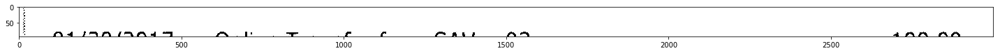


Amount was not detected, re-attempting by removing commas
[None, None, '']


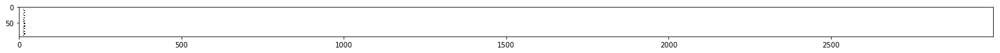

01/20/2017 Online Transfer from SAV ...03
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 1, 20), None, ' Online Transfer from SAV ...03']


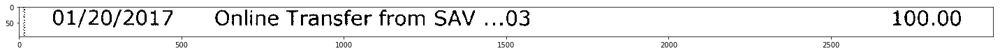

01/20/2017 Online Transfer from SAV ...03 100.00
[datetime.date(2017, 1, 20), 100.0, ' Online Transfer from SAV ...03']


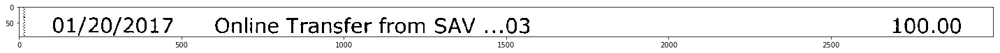


Amount was not detected, re-attempting by removing commas
[None, None, '']


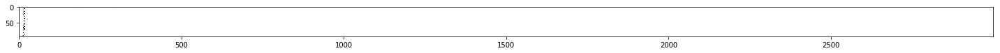

01/19/2017 SHELL Service Station MENLO -5.21
[datetime.date(2017, 1, 19), -5.21, ' SHELL Service Station MENLO ']


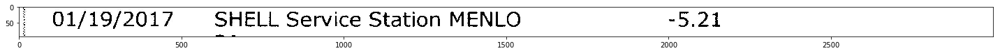


Amount was not detected, re-attempting by removing commas
[None, None, '']


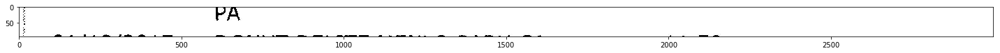

UL/LS/2U01/ VONUT DELITE MENLO FARK CA -L1.50
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'UL/LS/2U01/ VONUT DELITE MENLO FARK CA -L1.50']


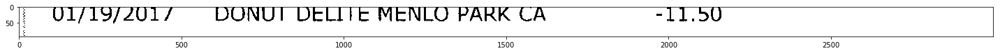

01/19/2017 DONUT DELITE MENLO PARK CA -11.50
[datetime.date(2017, 1, 19), -11.5, ' DONUT DELITE MENLO PARK CA ']


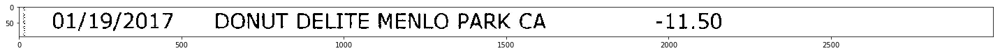


Amount was not detected, re-attempting by removing commas
[None, None, '']


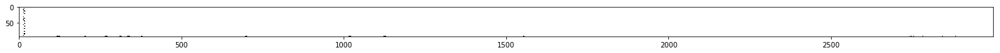

UI/1L9/2017/ Online Transfer from SAV ...Q5 20.00
Adjusting Window
[None, 20.0, 'UI/1L9/2017/ Online Transfer from SAV ...Q5']


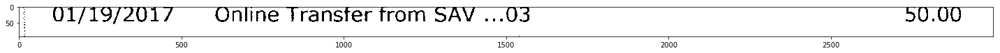

01/19/2017 Online Transfer from SAV ...03 50.00
[datetime.date(2017, 1, 19), 50.0, ' Online Transfer from SAV ...03']


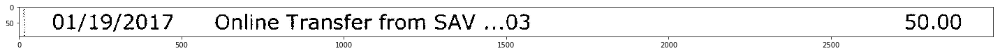


Amount was not detected, re-attempting by removing commas
[None, None, '']


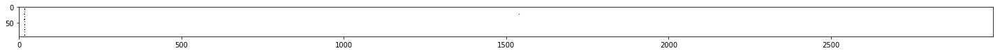

01/18/2017 MONTHLY SERVICE FEE -12.00
[datetime.date(2017, 1, 18), -12.0, ' MONTHLY SERVICE FEE ']


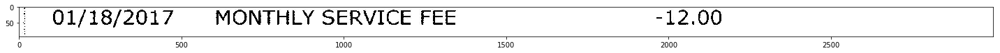

01/18/2017 SUBWAY 05521273 MENLO P -11.74
[datetime.date(2017, 1, 18), -11.74, ' SUBWAY 05521273 MENLO P ']


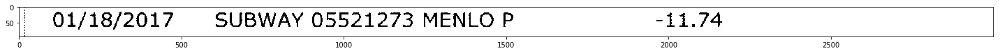


Amount was not detected, re-attempting by removing commas
[None, None, '']


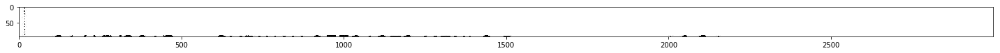

VIs/1//Z01/ SUBWAY Q59212/5 MENLO PF -10.54
Adjusting Window
[None, -10.54, 'VIs/1//Z01/ SUBWAY Q59212/5 MENLO PF ']


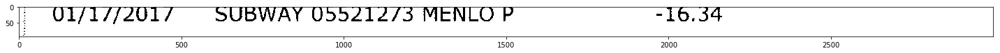

01/17/2017 SUBWAY 05521273 MENLO P -16.34
[datetime.date(2017, 1, 17), -16.34, ' SUBWAY 05521273 MENLO P ']


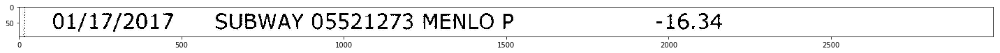


Amount was not detected, re-attempting by removing commas
[None, None, '']


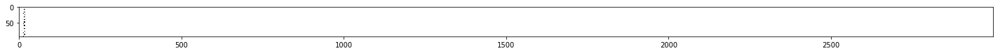

01/17/2017 7-ELEVEN EAST PALO ALT CA -2.11
[datetime.date(2017, 1, 17), -2.11, ' 7-ELEVEN EAST PALO ALT CA ']


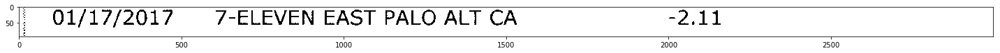

my @ Of kt  UL |, rT St 

r por 7. oc ep ny Of OPER eS elm, SO lCUr™!UCUCR CU

i ou™),

a

~~
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'my @ Of kt  UL |, rT St \n\nr por 7. oc ep ny Of OPER eS elm, SO lCUr™!UCUCR CU\n\ni ou™),\n\na\n\n--']


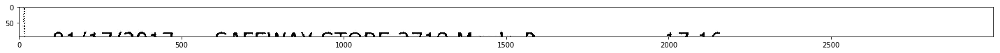


Amount was not detected, re-attempting by removing commas
[None, None, '']


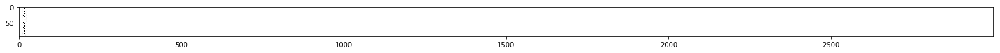

01/17/2017 SAFEWAY STORE 2719 Menlo P -17.16
[datetime.date(2017, 1, 17), -17.16, ' SAFEWAY STORE 2719 Menlo P ']


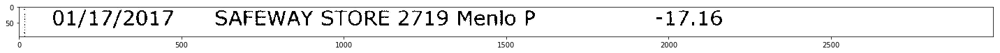


Amount was not detected, re-attempting by removing commas
[None, None, '']


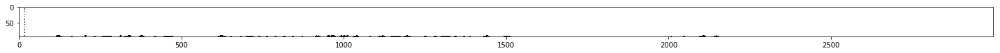

UL/L/S/2U1/ SUBWAY YooZlZ/o MENLO P “Ll.
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'UL/L/S/2U1/ SUBWAY YooZlZ/o MENLO P “Ll.']


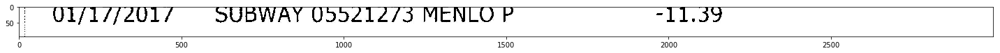

01/17/2017 SUBWAY 05521273 MENLO P -11.39
[datetime.date(2017, 1, 17), -11.39, ' SUBWAY 05521273 MENLO P ']


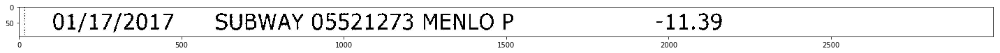


Amount was not detected, re-attempting by removing commas
[None, None, '']


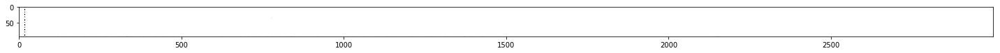

01/13/2017 STANFORD UNIV BKST #670 -1.49

CT ARICI,
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 1, 13), None, ' STANFORD UNIV BKST #670 -1.49\n\nCT ARICI,']


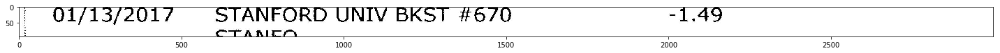

01/13/2017 STANFORD UNIV BKST #670 -1.49
[datetime.date(2017, 1, 13), -1.49, ' STANFORD UNIV BKST #670 ']


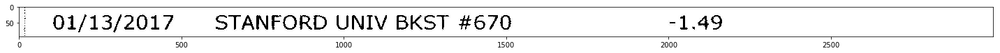

STANFO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'STANFO']


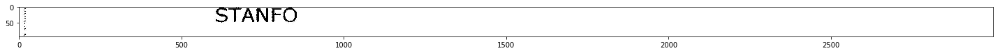

STANFO
Amount was not detected, re-attempting by removing commas
[None, None, 'STANFO']


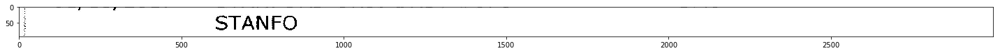

Rm Biwew ewe ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Rm Biwew ewe ee']


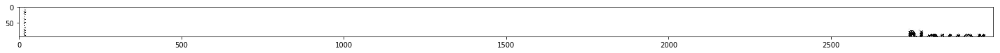


Amount was not detected, re-attempting by removing commas
[None, None, '']


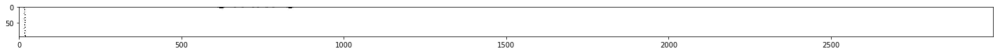

Image (17).jpg
01/12/2017 CHEVRON/JOHN CONWAY -1.99
[datetime.date(2017, 1, 12), -1.99, ' CHEVRON/JOHN CONWAY ']


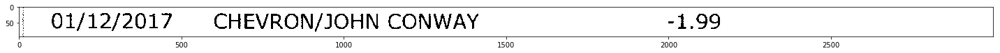

MENLO PARK
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MENLO PARK']


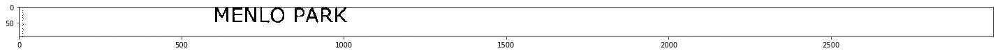

MENLO PARK
Amount was not detected, re-attempting by removing commas
[None, None, 'MENLO PARK']


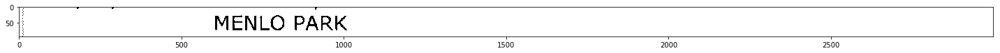

01/11/2017 Amazon Video On Dema -3.99
[datetime.date(2017, 1, 11), -3.99, ' Amazon Video On Dema ']


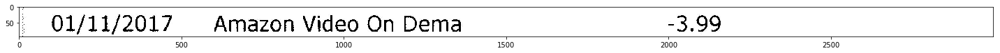

AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/']


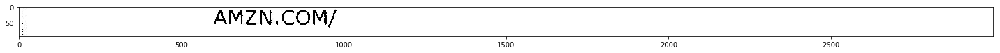

 eee se ee see ror see oon FU Fee eae

AMZN. COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, ' eee se ee see ror see oon FU Fee eae\n\nAMZN. COM/']


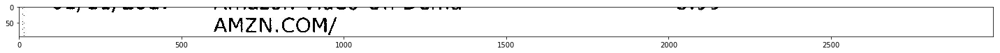

AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/']


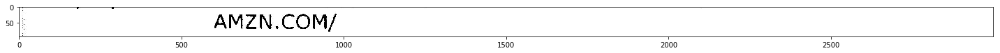

AMZN.COM/
Amount was not detected, re-attempting by removing commas
[None, None, 'AMZN.COM/']


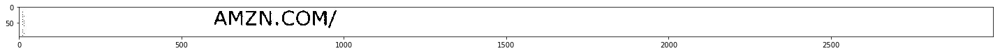

01/11/2017 SUBWAY 05521273 MENLO P -22.12
[datetime.date(2017, 1, 11), -22.12, ' SUBWAY 05521273 MENLO P ']


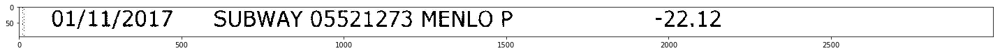


Amount was not detected, re-attempting by removing commas
[None, None, '']


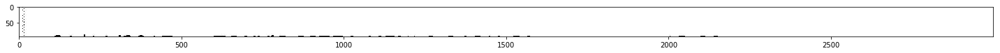

Ul/ill/2ul/ TONY > PIZZA MENLO PARK CA ~1Z.UU0
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Ul/ill/2ul/ TONY > PIZZA MENLO PARK CA ~1Z.UU0']


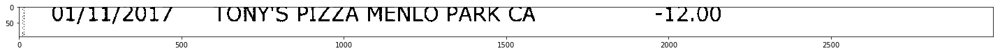

01/11/2017 TONY'S PIZZA MENLO PARK CA -12.00
[datetime.date(2017, 1, 11), -12.0, " TONY'S PIZZA MENLO PARK CA "]


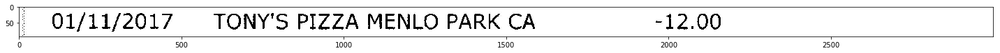


Amount was not detected, re-attempting by removing commas
[None, None, '']


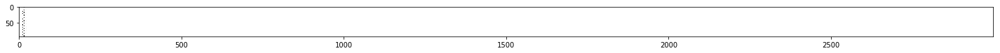

01/10/2017 THE WILLOWS MAR MENLO -13.28

rmAMmIZ 7" A
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 1, 10), None, ' THE WILLOWS MAR MENLO -13.28\n\nrmAMmIZ 7- A']


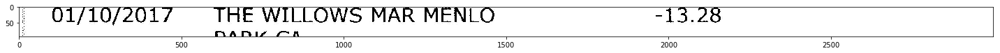

01/10/2017 THE WILLOWS MAR MENLO -13.28
[datetime.date(2017, 1, 10), -13.28, ' THE WILLOWS MAR MENLO ']


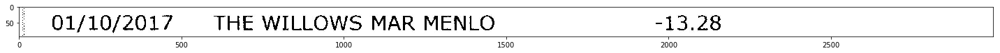

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


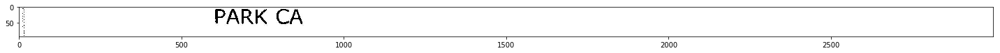

se SSE SR cee ee mel ote ek 00 Rete ee ee Ge fae Sey i

PARK CA _
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'se SSE SR cee ee mel ote ek 00 Rete ee ee Ge fae Sey i\n\nPARK CA _']


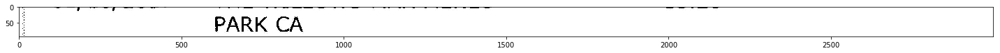

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


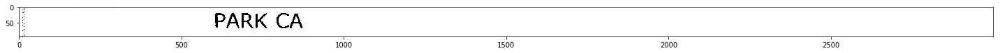

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


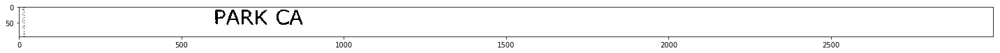

01/10/2017 SUBWAY 05521273 MENLO P -11.34
[datetime.date(2017, 1, 10), -11.34, ' SUBWAY 05521273 MENLO P ']


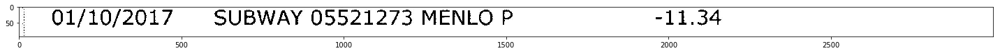

Pe ee ee ee ae ae ae ee ae be me ar _ pn moar ~~ AE ~~ Frm
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Pe ee ee ee ae ae ae ee ae be me ar _ pn moar -- AE -- Frm']


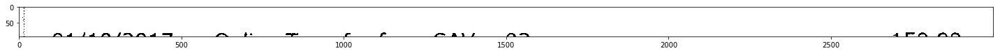


Amount was not detected, re-attempting by removing commas
[None, None, '']


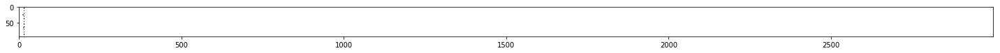

01/10/2017 Online Transfer from SAV ...03 150.00
[datetime.date(2017, 1, 10), 150.0, ' Online Transfer from SAV ...03']


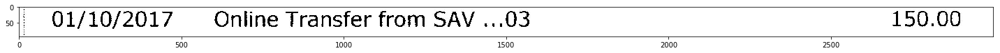

mh ow

smn Mm fF o™~e Mm 

a ae

oan
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'mh ow\n\nsmn Mm fF o™~e Mm \n\na ae\n\noan']


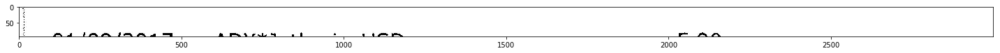


Amount was not detected, re-attempting by removing commas
[None, None, '']


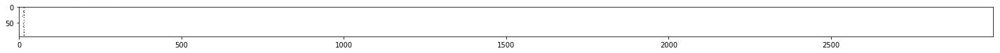

01/09/2017 ADY*JetbrainsUSD -5.90
[datetime.date(2017, 1, 9), -5.9, ' ADY*JetbrainsUSD ']


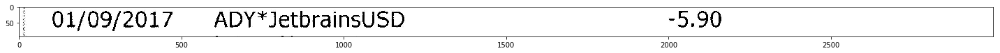

nttps://www.]
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'nttps://www.]']


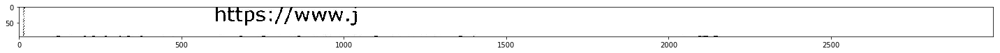

https://www.j
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'https://www.j']


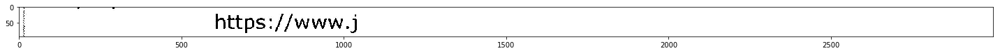

https://www.j
Amount was not detected, re-attempting by removing commas
[None, None, 'https://www.j']


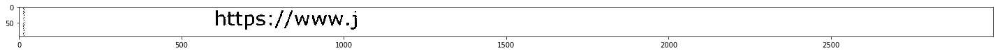

01/09/2017, A&S 76 MENLO PARK CA -4.78
[datetime.date(2017, 1, 9), -4.78, ', A&S 76 MENLO PARK CA ']


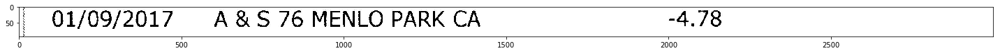


Amount was not detected, re-attempting by removing commas
[None, None, '']


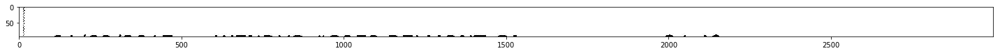

UL/UD/Z017 WENDYS #53959 DELMONT CA ~£4.40
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'UL/UD/Z017 WENDYS #53959 DELMONT CA ~£4.40']


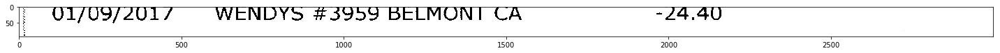

01/09/2017 WENDYS #3959 BELMONT CA -24.40
[datetime.date(2017, 1, 9), -24.4, ' WENDYS #3959 BELMONT CA ']


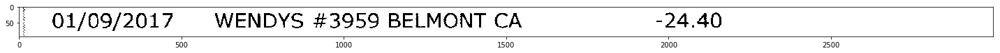


Amount was not detected, re-attempting by removing commas
[None, None, '']


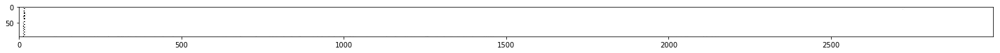

01/09/2017 WILLOW COVE GAS MENLO -3.49

™ ArTri1f jf" A
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 1, 9), None, ' WILLOW COVE GAS MENLO -3.49\n\n™ ArTri1f jf- A']


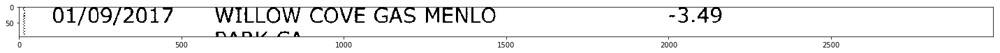

01/09/2017 WILLOW COVE GAS MENLO -3.49
[datetime.date(2017, 1, 9), -3.49, ' WILLOW COVE GAS MENLO ']


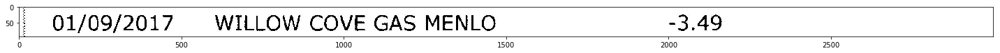

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


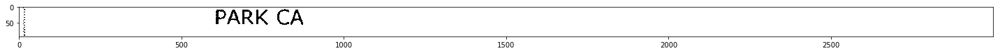

cater: eA meres rani Tm
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'cater: eA meres rani Tm']


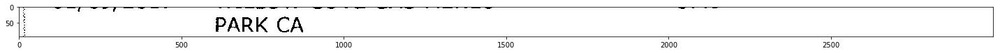

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


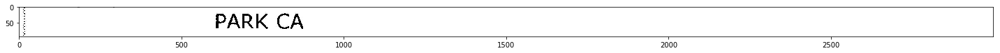

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


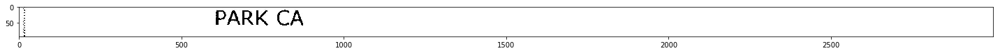

01/09/2017 SQC*LOUIS BARRIS . / CA -27.90
[datetime.date(2017, 1, 9), -27.9, ' SQC*LOUIS BARRIS . / CA ']


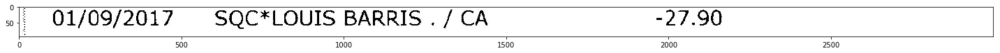

wm ws Frm mm Fm ~!  lU “ ree ww eszye™en 1 ™ ARtnpsaasA™r ~™ ™ A
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'wm ws Frm mm Fm ~!  lU “ ree ww eszye™en 1 ™ ARtnpsaasA™r ~™ ™ A']


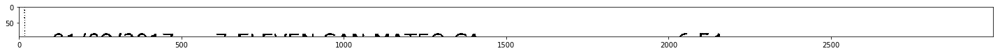


Amount was not detected, re-attempting by removing commas
[None, None, '']


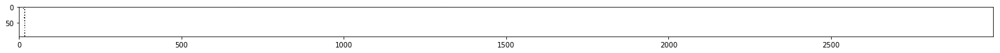

01/09/2017 7-ELEVEN SAN MATEO CA -6.54
[datetime.date(2017, 1, 9), -6.54, ' 7-ELEVEN SAN MATEO CA ']


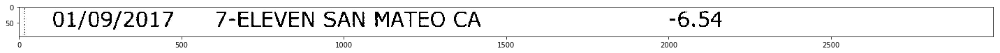


Amount was not detected, re-attempting by removing commas
[None, None, '']


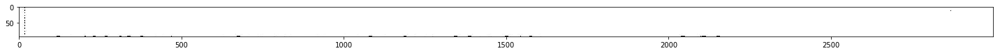

QOL/O9/2017 DOLLAR TR 1121 OLD COU SAN -3.20

frARr
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'QOL/O9/2017 DOLLAR TR 1121 OLD COU SAN -3.20\n\nfrARr']


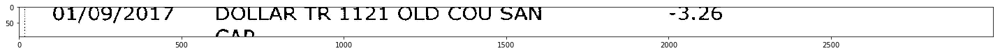

01/09/2017 DOLLAR TR 1121 OLD COU SAN -3.26
[datetime.date(2017, 1, 9), -3.26, ' DOLLAR TR 1121 OLD COU SAN ']


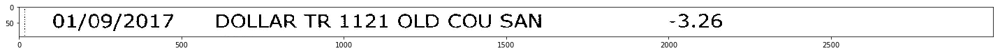

CAR
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CAR']


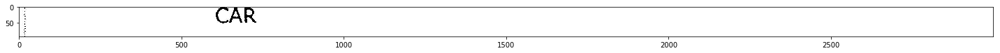

CAR
Amount was not detected, re-attempting by removing commas
[None, None, 'CAR']


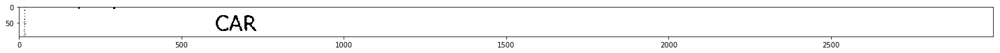

01/09/2017 WILLOW COVE GAS MENLO -23.01
[datetime.date(2017, 1, 9), -23.01, ' WILLOW COVE GAS MENLO ']


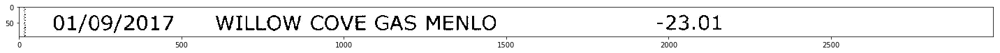

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


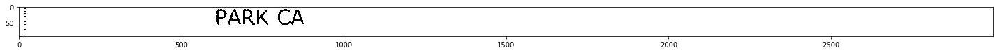

Se see Re Eee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Se see Re Eee']


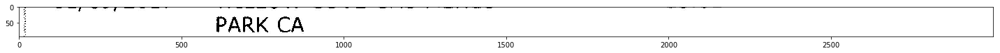

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


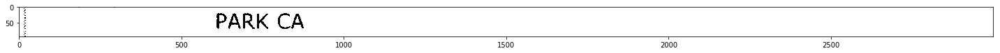

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


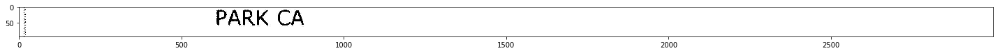

01/09/2017 MCDONALD'S F380 BELMONT -14.79
[datetime.date(2017, 1, 9), -14.79, " MCDONALD'S F380 BELMONT "]


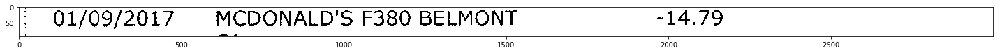


Amount was not detected, re-attempting by removing commas
[None, None, '']


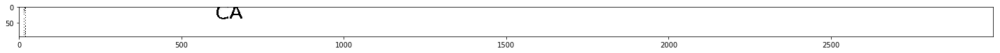

Image (18).jpg
01/09/2017 Online Transfer from SAV ...03 50.00
[datetime.date(2017, 1, 9), 50.0, ' Online Transfer from SAV ...03']


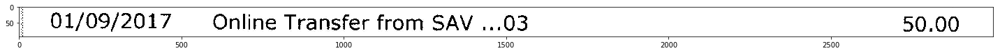


Amount was not detected, re-attempting by removing commas
[None, None, '']


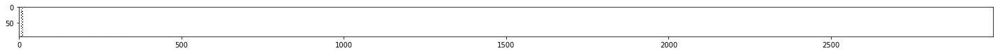

01/06/2017 TARGET T- 2220 Bridgep San -37.73
[datetime.date(2017, 1, 6), -37.73, ' TARGET T- 2220 Bridgep San ']


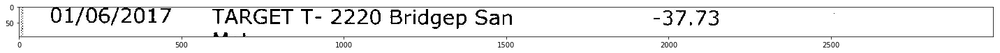

fy 4 FA 1a ri 61 SS ee ae a ee ee ee ee eee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'fy 4 FA 1a ri 61 SS ee ae a ee ee ee ee eee']


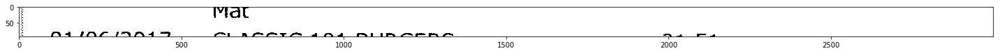

Mat
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Mat']


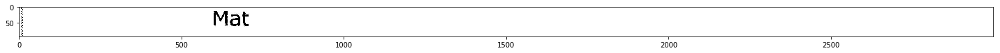

Mat
Amount was not detected, re-attempting by removing commas
[None, None, 'Mat']


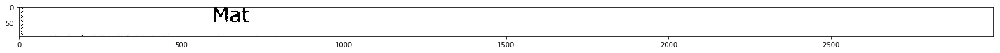

Ul/VG/2Z01/ CLASSIC 101 BURGERS -21.51

Prarm™”i:i AACR ALES" “ A
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Ul/VG/2Z01/ CLASSIC 101 BURGERS -21.51\n\nPrarm™”i:i AACR ALES- “ A']


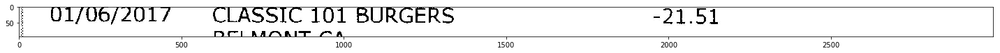

01/06/2017 CLASSIC 101 BURGERS -21.51
[datetime.date(2017, 1, 6), -21.51, ' CLASSIC 101 BURGERS ']


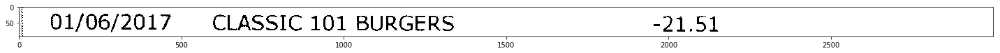

BELMONT CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'BELMONT CA']


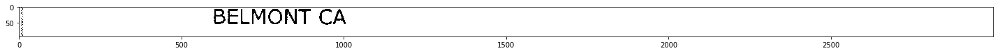

BELMONT CA |

a ae
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'BELMONT CA |\n\na ae']


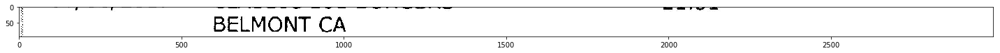

BELMONT CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'BELMONT CA']


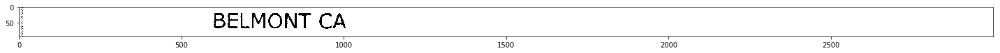

BELMONT CA
Amount was not detected, re-attempting by removing commas
[None, None, 'BELMONT CA']


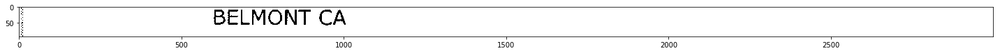

01/06/2017 WILLOW COVE GAS MENLO

rFmaArRSN1/f @/™ A
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 1, 6), None, ' WILLOW COVE GAS MENLO\n\nrFmaArRSN1/f @/™ A']


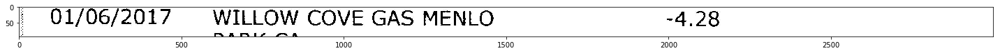

01/06/2017 WILLOW COVE GAS MENLO -4.28
[datetime.date(2017, 1, 6), -4.28, ' WILLOW COVE GAS MENLO ']


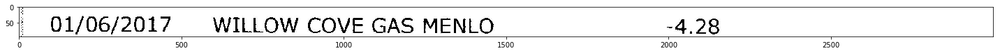

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


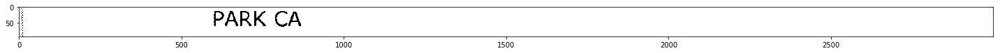

_- OS SE ee a wv eee Ne eZ ee Oe wr FUEL OE hf! Un hee

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '_- OS SE ee a wv eee Ne eZ ee Oe wr FUEL OE hf! Un hee\n\nPARK CA']


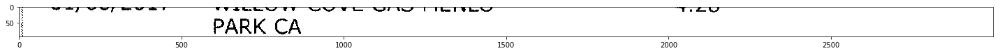

PARK CA 
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA ']


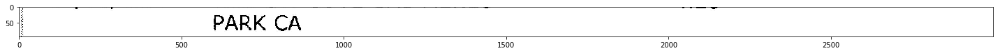

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


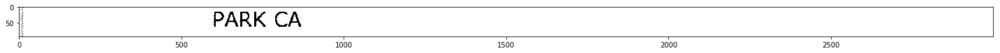

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


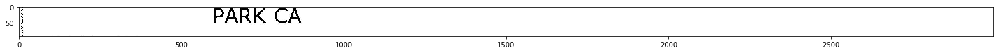

01/06/2017 SAN MATEO SAN MATEO CA -6.38
[datetime.date(2017, 1, 6), -6.38, ' SAN MATEO SAN MATEO CA ']


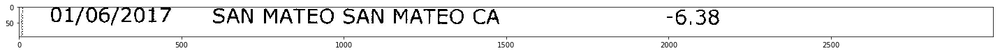

fr4 I(r /IOanNsAt SS LO LR KE 1 SRI IT: PRA rTM Teo | fF™A a ae
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'fr4 I(r /IOanNsAt SS LO LR KE 1 SRI IT: PRA rTM Teo | fF™A a ae']


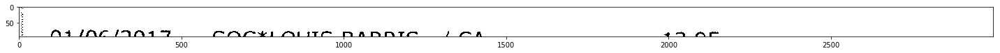


Amount was not detected, re-attempting by removing commas
[None, None, '']


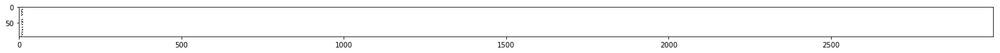

01/06/2017 SQC*LOUIS BARRIS ./ CA “12.95
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 1, 6), None, ' SQC*LOUIS BARRIS ./ CA “12.95']


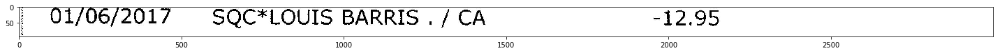

01/06/2017 SQC*LOUIS BARRIS . / CA -12.95
[datetime.date(2017, 1, 6), -12.95, ' SQC*LOUIS BARRIS . / CA ']


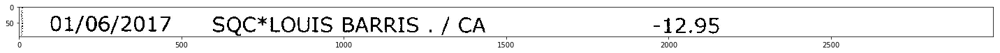


Amount was not detected, re-attempting by removing commas
[None, None, '']


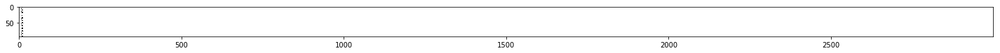

01/06/2017 SQ *CAKE CREATIONS BAKE -15.68
[datetime.date(2017, 1, 6), -15.68, ' SQ *CAKE CREATIONS BAKE ']


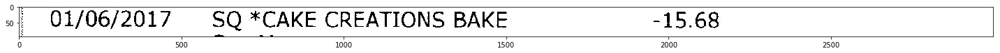

ee ae a ee ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee ae a ee ee']


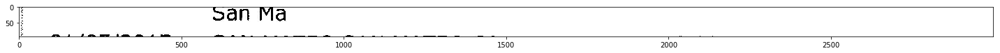

San Ma
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'San Ma']


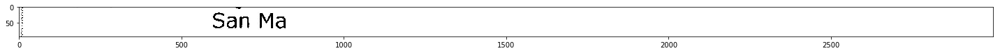

San Ma
Amount was not detected, re-attempting by removing commas
[None, None, 'San Ma']


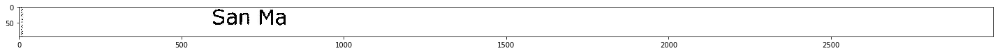

01/05/2017

SAN MATEO SAN MATEO CA

-9.09
[datetime.date(2017, 1, 5), -9.09, '\n\nSAN MATEO SAN MATEO CA\n\n']


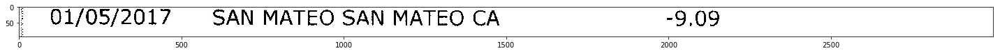

ee ee ee ee ee ee ae oe 32d, meee lc lee eae eekle
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee ee ee ee ee ee ae oe 32d, meee lc lee eae eekle']


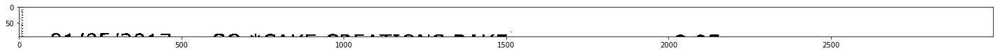


Amount was not detected, re-attempting by removing commas
[None, None, '']


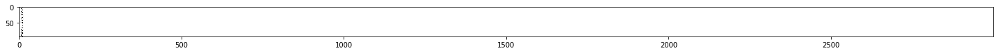

01/05/2017 SQ *CAKE CREATIONS BAKE -3.95
[datetime.date(2017, 1, 5), -3.95, ' SQ *CAKE CREATIONS BAKE ']


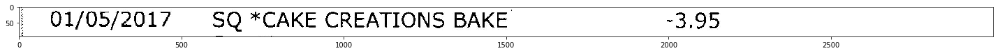


Amount was not detected, re-attempting by removing commas
[None, None, '']


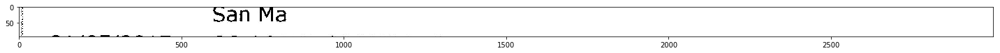

UL/Q5/2Z01/ SQ *CAKE CREATIONS BAKE -17.84

C™ ame aw ARAM
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'UL/Q5/2Z01/ SQ *CAKE CREATIONS BAKE -17.84\n\nC™ ame aw ARAM']


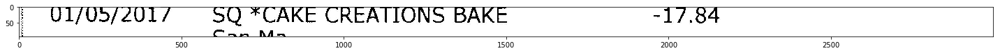

01/05/2017 SQ *CAKE CREATIONS BAKE -17.84
[datetime.date(2017, 1, 5), -17.84, ' SQ *CAKE CREATIONS BAKE ']


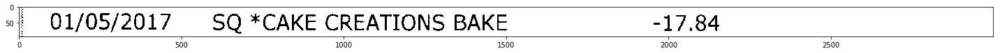

San Ma
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'San Ma']


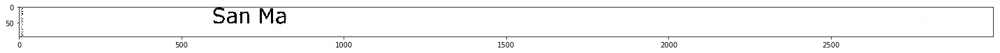


Amount was not detected, re-attempting by removing commas
[None, None, '']


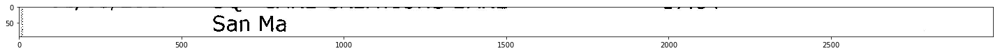

01/04/2017 CARLS JR 706 REDWOOD CITY -15.01
[datetime.date(2017, 1, 4), -15.01, ' CARLS JR 706 REDWOOD CITY ']


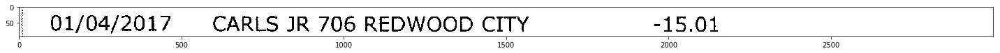


Amount was not detected, re-attempting by removing commas
[None, None, '']


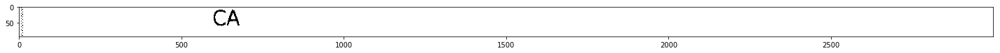

01/04/2017 Amazon web services -12.73
[datetime.date(2017, 1, 4), -12.73, ' Amazon web services ']


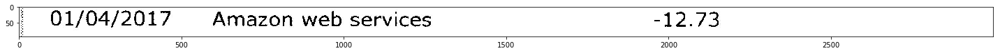

ee

aws.amazon

meme
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee\n\naws.amazon\n\nmeme']


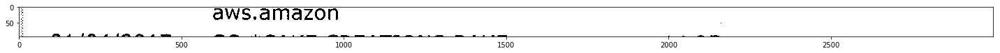

aws.amazon
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aws.amazon']


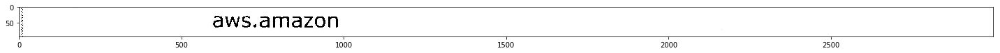

aws.amazon
Amount was not detected, re-attempting by removing commas
[None, None, 'aws.amazon']


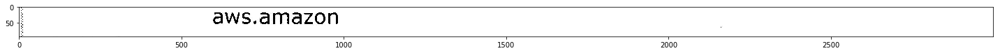

01/04/2017 SQ *CAKE CREATIONS BAKE -14.25
[datetime.date(2017, 1, 4), -14.25, ' SQ *CAKE CREATIONS BAKE ']


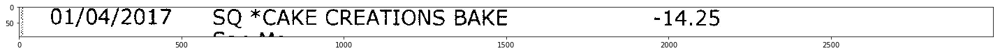

fu a

sfme™ FAR Fa “>

Lall Mid

mIs™™AE

Pe ae ae ae ed

n“n A


Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'fu a\n\nsfme™ FAR Fa “>\n\nLall Mid\n\nmIs™™AE\n\nPe ae ae ae ed\n\nn“n A\n\n']


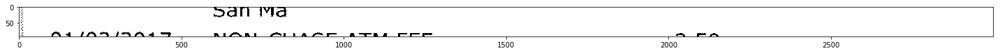

San Ma
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'San Ma']


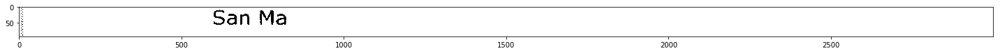


Amount was not detected, re-attempting by removing commas
[None, None, '']


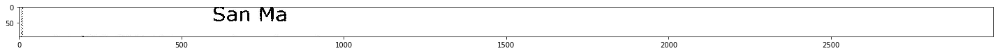

01/03/2017 NON-CHASE ATM FEE- -2.50

SAT "T"'! RE" TPR AE. UPA TT.
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 1, 3), None, " NON-CHASE ATM FEE- -2.50\n\nSAT -T-'! RE- TPR AE. UPA TT."]


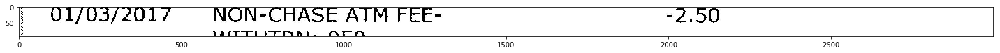

01/03/2017 NON-CHASE ATM FEE- -2.50
[datetime.date(2017, 1, 3), -2.5, ' NON-CHASE ATM FEE- ']


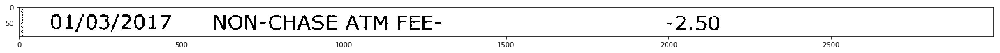

WITHTRN: 050
Adjusting Window
[None, 50.0, 'WITHTRN:']


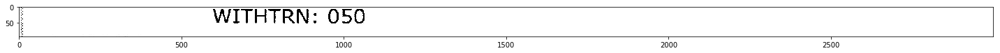

WITHTRN: 050
[None, 50.0, 'WITHTRN:']


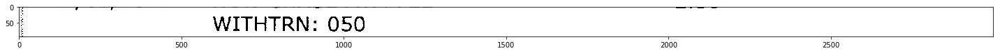

01/03/2017 DOORDASH-CURRY UP NOW -22.28
[datetime.date(2017, 1, 3), -22.28, ' DOORDASH-CURRY UP NOW ']


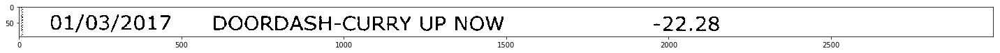

650-681-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '650-681-']


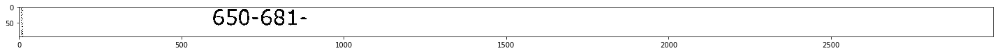

Oe EE ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Oe EE ee']


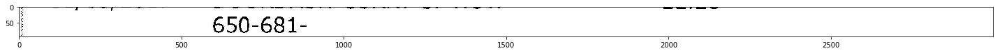

650-681-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '650-681-']


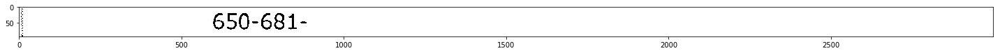

650-681-
Amount was not detected, re-attempting by removing commas
[None, None, '650-681-']


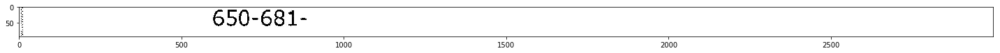

01/03/2017 SAN MATEO SAN MATEO CA -6.17
[datetime.date(2017, 1, 3), -6.17, ' SAN MATEO SAN MATEO CA ']


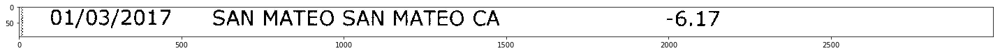


Amount was not detected, re-attempting by removing commas
[None, None, '']


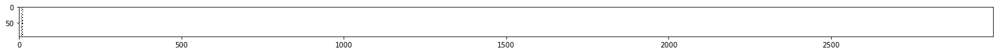

Image (19).jpg
01/03/2017 A &S 76 MENLO PARK CA -2.00
[datetime.date(2017, 1, 3), -2.0, ' A &S 76 MENLO PARK CA ']


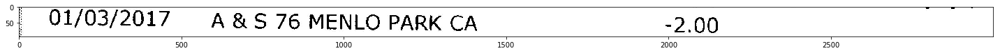

Pe ee ee ee eed
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Pe ee ee ee eed']


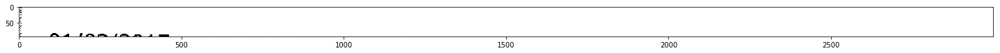

a. SSO See Re ee. 6 See oO SEE OER ORE mea Pe an tt
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'a. SSO See Re ee. 6 See oO SEE OER ORE mea Pe an tt']


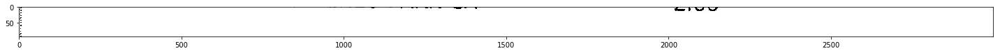


Amount was not detected, re-attempting by removing commas
[None, None, '']


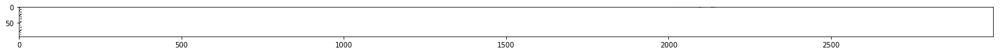

01/03/2017 WILLOW COVE GAS MENLO -3.44
[datetime.date(2017, 1, 3), -3.44, ' WILLOW COVE GAS MENLO ']


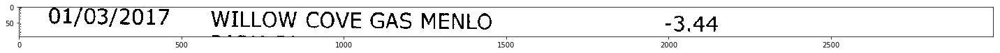

FARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'FARK CA']


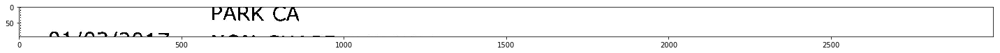

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


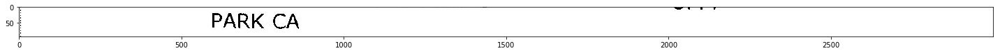

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


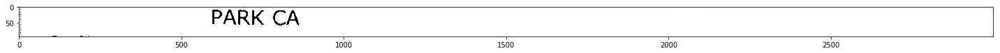

UO1/05/2017 NON-CHASE ATM WITHDRAW -43.00
Adjusting Window
[None, -43.0, 'UO1/05/2017 NON-CHASE ATM WITHDRAW ']


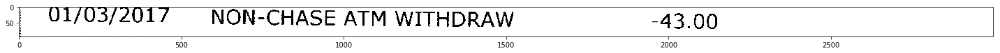

01/03/2017 NON-CHASE ATM WITHDRAW -43 00
[datetime.date(2017, 1, 3), -43.0, ' NON-CHASE ATM WITHDRAW ']


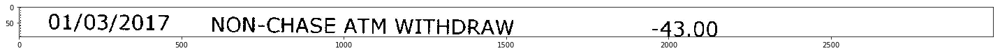

01/03/2017 Amazon Video On Dema -3.99
[datetime.date(2017, 1, 3), -3.99, ' Amazon Video On Dema ']


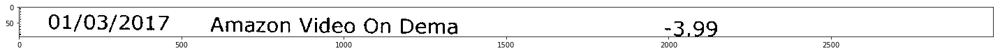

AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/']


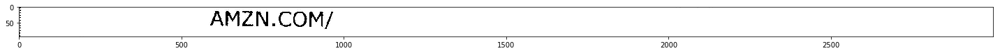

Bt Gon ee E Pe ee ON

AMZN. COM/

de AS
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Bt Gon ee E Pe ee ON\n\nAMZN. COM/\n\nde AS']


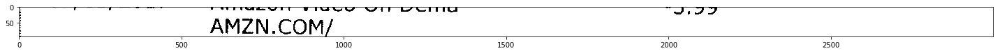

AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/']


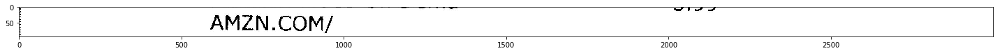

AMZN.COM/
Amount was not detected, re-attempting by removing commas
[None, None, 'AMZN.COM/']


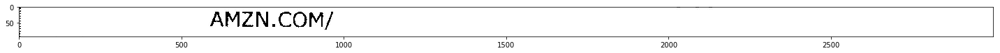

01/03/2017 SAN MATEO SAN MATEO CA -20.00
[datetime.date(2017, 1, 3), -20.0, ' SAN MATEO SAN MATEO CA ']


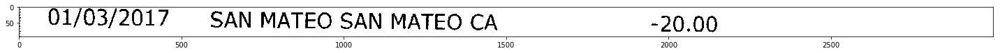

g™! A

sm ™!| fF -™ Mma s
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'g™! A\n\nsm ™!| fF -™ Mma s']


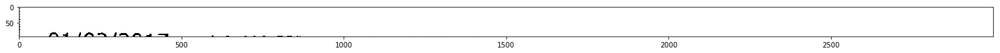

a ee Tae w ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'a ee Tae w ee']


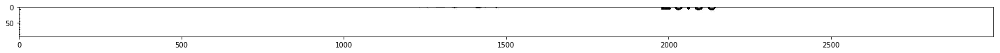


Amount was not detected, re-attempting by removing commas
[None, None, '']


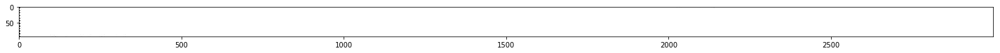

01/03/2017 LA HACIENDA MAR MENLO -11.71
[datetime.date(2017, 1, 3), -11.71, ' LA HACIENDA MAR MENLO ']


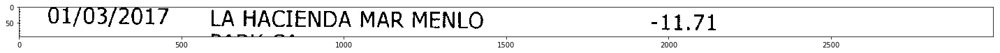

fr.4 (KAO ITA ed?

FARK CA

rms a ee ae
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'fr.4 (KAO ITA ed?\n\nFARK CA\n\nrms a ee ae']


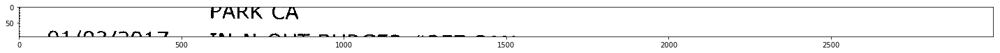

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


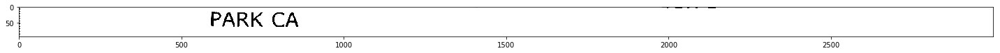

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


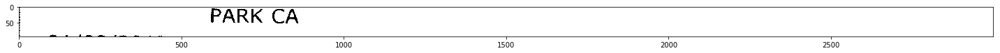

UL/YS/201/ IN-N- OUT BURGER #257 SAN -12.40

fm- A FAI
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'UL/YS/201/ IN-N- OUT BURGER #257 SAN -12.40\n\nfm- A FAI']


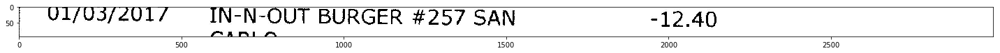

01/03/2017 IN-N-OUT BURGER #257 SAN -12.40
[datetime.date(2017, 1, 3), -12.4, ' IN-N-OUT BURGER #257 SAN ']


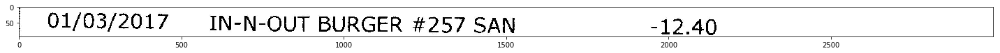


Amount was not detected, re-attempting by removing commas
[None, None, '']


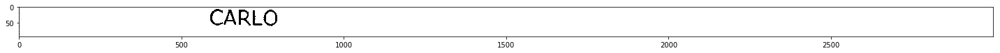

01/03/2017 PANDA EXPRESS #1923 -20.76

i a i iia it
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 1, 3), None, ' PANDA EXPRESS #1923 -20.76\n\ni a i iia it']


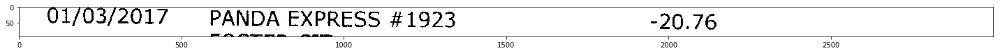

01/03/2017 PANDA EXPRESS #1923 -20.76
[datetime.date(2017, 1, 3), -20.76, ' PANDA EXPRESS #1923 ']


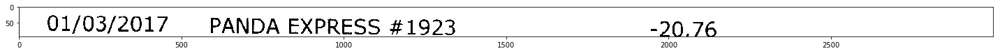

FOSTER CIT
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'FOSTER CIT']


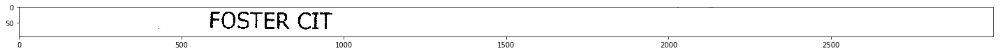

ee

_

Le i ee ee ee ae a ee

FOSTER CIT

~ Ga\Se

iN)
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee\n\n_\n\nLe i ee ee ee ae a ee\n\nFOSTER CIT\n\n~ Ga\\Se\n\niN)']


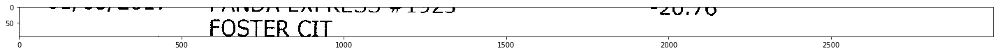

FOSTER CIT |
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'FOSTER CIT |']


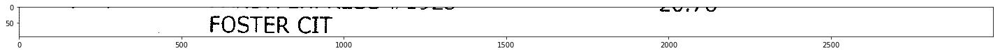

FOSTER CIT
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'FOSTER CIT']


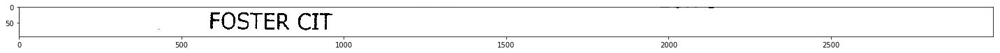

FOSTER CIT
Amount was not detected, re-attempting by removing commas
[None, None, 'FOSTER CIT']


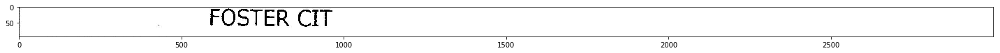

01/03/2017 A &S 76 MENLO PARK CA -2.78
[datetime.date(2017, 1, 3), -2.78, ' A &S 76 MENLO PARK CA ']


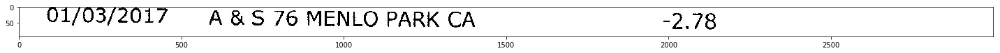

fra 1/fXV MM IAM 4 |

ree Fe ee Oe, ek tle

eee eae
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'fra 1/fXV MM IAM 4 |\n\nree Fe ee Oe, ek tle\n\neee eae']


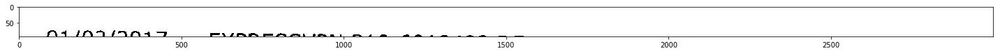


Amount was not detected, re-attempting by removing commas
[None, None, '']


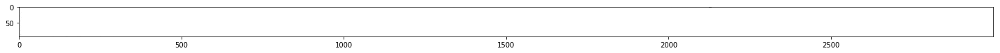

01/03/2017 EXPRESSVPN 310-6018492 DE -12.95
[datetime.date(2017, 1, 3), -12.95, ' EXPRESSVPN 310-6018492 DE ']


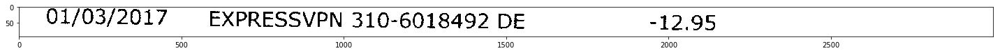

fr. aA

ij ™~

sm:

”

ane
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'fr. aA\n\nij ™~\n\nsm:\n\n”\n\nane']


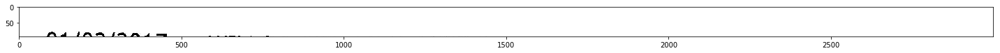


Amount was not detected, re-attempting by removing commas
[None, None, '']


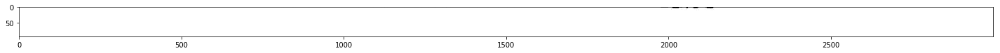

01/03/2017 WILLOW COVE GAS MENLO -8.48
[datetime.date(2017, 1, 3), -8.48, ' WILLOW COVE GAS MENLO ']


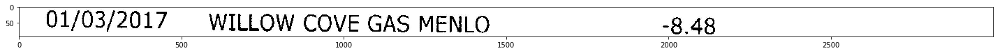

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


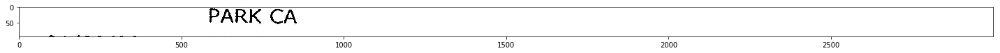

PARK CA |
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA |']


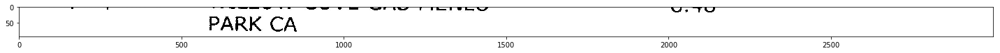

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


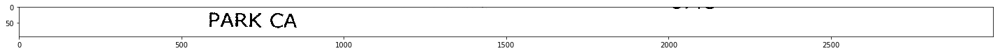

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


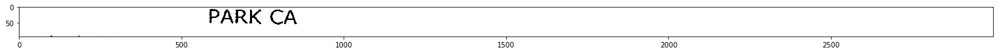

Q1/03/2017 FIRSTMERIT BANK TRANSFER 350.00
Adjusting Window
[None, 350.0, 'Q1/03/2017 FIRSTMERIT BANK TRANSFER']


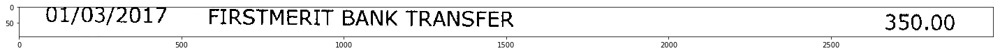

01/03/2017 FIRSTMERIT BANK TRANSFER 2590 00
Adjusting Window
[datetime.date(2017, 1, 3), None, ' FIRSTMERIT BANK TRANSFER']


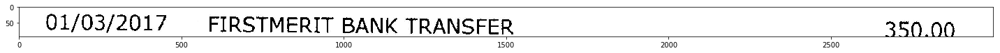

01/03/2017 FIRSTMERIT BANK TRANSFER 350.00
[datetime.date(2017, 1, 3), 350.0, ' FIRSTMERIT BANK TRANSFER']


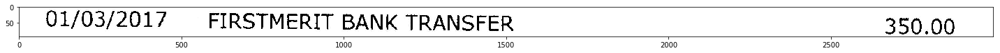

12/30/2016 Online Transfer from SAV ...03 50.00
[datetime.date(2016, 12, 30), 50.0, ' Online Transfer from SAV ...03']


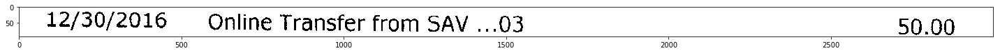


Amount was not detected, re-attempting by removing commas
[None, None, '']


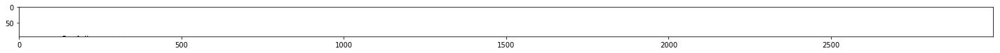

12/29/2016 WILLOW COVE GAS MENLO -3.49

™ APS1f f/™ A
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 29), None, ' WILLOW COVE GAS MENLO -3.49\n\n™ APS1f f/™ A']


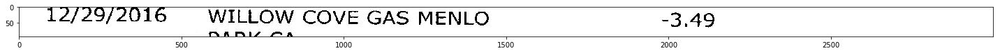

12/29/2016 WILLOW COVE GAS MENLO -3.49
[datetime.date(2016, 12, 29), -3.49, ' WILLOW COVE GAS MENLO ']


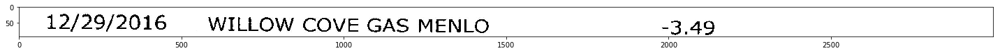

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


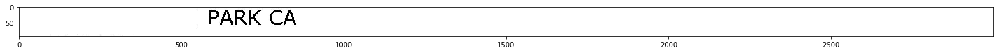

 FS ee

oS be ee

Tes
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, ' FS ee\n\noS be ee\n\nTes']


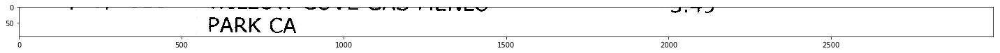

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


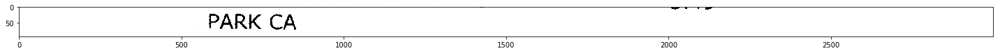

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


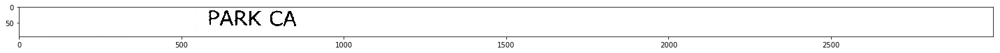

12/28/2016 Dropbox*TCTP46HT4PG5 “9 99
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 28), None, ' Dropbox*TCTP46HT4PG5 “9 99']


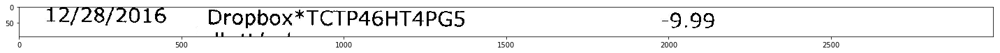

12/28/2016 Dropbox*TCTP46HT4PG5 -9§ 99
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 28), None, ' Dropbox*TCTP46HT4PG5 -9§ 99']


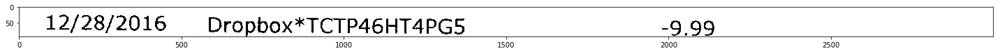

12/28/2016 Dropbox*TCTP46HT4PG5 -9.99
[datetime.date(2016, 12, 28), -9.99, ' Dropbox*TCTP46HT4PG5 ']


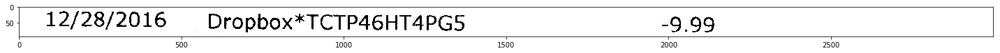

ab.tt/

cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ab.tt/\n\ncch']


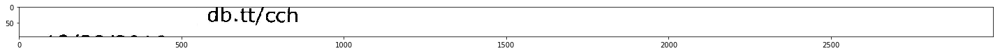

db.tt/cch -
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'db.tt/cch -']


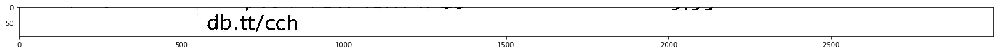

db.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'db.tt/cch']


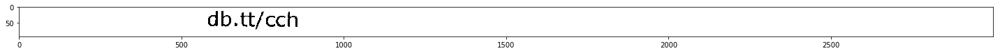

db.tt/

cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'db.tt/\n\ncch']


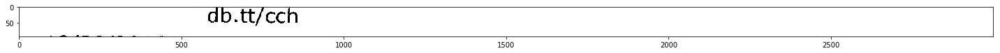

ct/ccn

qge~™, Farm inmr era - ork Uk |2|[lUlh  a we
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ct/ccn\n\nqge~™, Farm inmr era - ork Uk |2|[lUlh  a we']


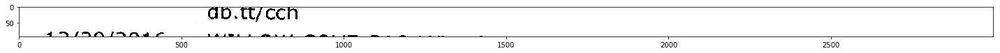

UU.UL/ CUE!

qn (MNO /InwA Cc VAITEO LL AAUAL P™PA\A Tm arm RAR) ft
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'UU.UL/ CUE!\n\nqn (MNO /InwA Cc VAITEO LL AAUAL P™PA\\A Tm arm RAR) ft']


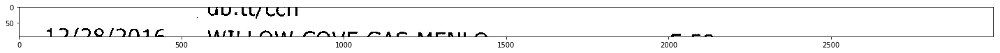

190/JR/IN1EG

MMS sey SWE

VAJTL E CNVAL CCNA /JEL PCAC RACAL
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '190/JR/IN1EG\n\nMMS sey SWE\n\nVAJTL E CNVAL CCNA /JEL PCAC RACAL']


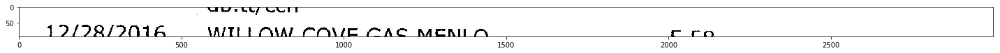

EXnmet Suan | 3) TEESE! © eran, Sen

17/78/7016 \TLL OW COVE MAC MENID eco
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'EXnmet Suan | 3) TEESE! © eran, Sen\n\n \\TLL OW COVE MAC MENID eco']


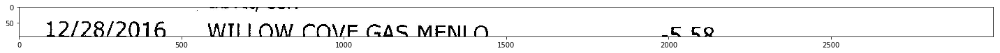

12/28/2016 WILLOW COVE GAS MENIO 5 £Q
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 28), None, ' WILLOW COVE GAS MENIO 5 £Q']


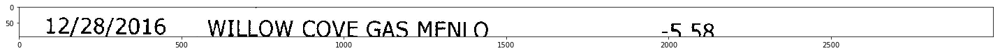

12/28/2016  WILLOW COVE GAS MENLO -5 58
[datetime.date(2016, 12, 28), -5.58, '  WILLOW COVE GAS MENLO ']


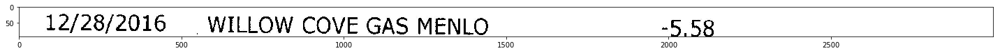

~ PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '~ PARK CA']


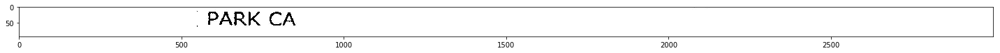

rr Ss see iene enti

SF & bebe tw’ TO

PARK CA

fet

Wee Nt Ne Fee ON

Fe FU
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'rr Ss see iene enti\n\nSF & bebe tw’ TO\n\nPARK CA\n\nfet\n\nWee Nt Ne Fee ON\n\nFe FU']


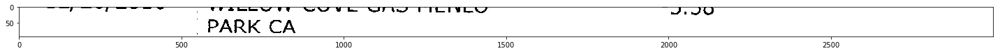

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


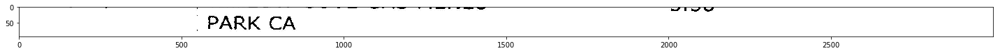

~ PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '~ PARK CA']


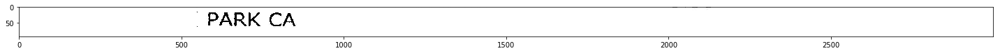

~ PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, '~ PARK CA']


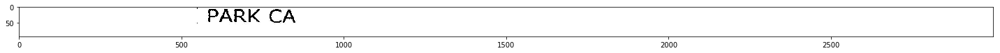

WE euear eh oe
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'WE euear eh oe']


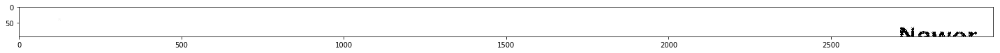


Amount was not detected, re-attempting by removing commas
[None, None, '']


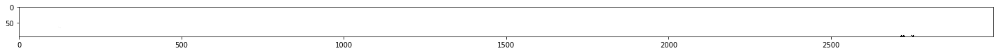

Newer
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Newer']


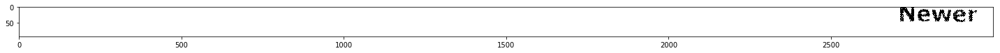

Newer
Amount was not detected, re-attempting by removing commas
[None, None, 'Newer']


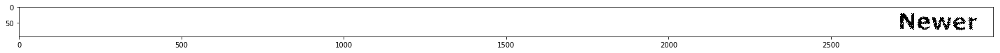

Image (2).jpg
08/16/2017 PAYPAL *PUMPINGSTAT 402- -40.00
[datetime.date(2017, 8, 16), -40.0, ' PAYPAL *PUMPINGSTAT 402- ']


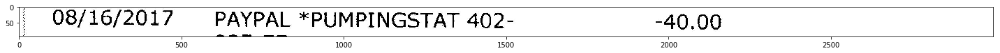

~~ Mm §£ is mm to ma at

J5I-S/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '-- Mm §£ is mm to ma at\n\nJ5I-S/']


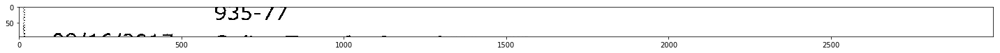

935-77
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '935-77']


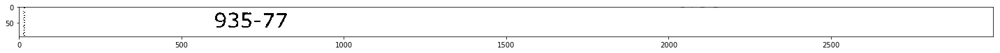

935-77
Amount was not detected, re-attempting by removing commas
[None, None, '935-77']


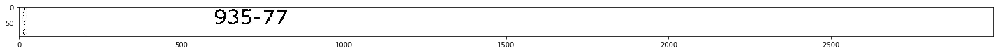

08/16/2017 Online Transfer from SAV ...03 100.00
[datetime.date(2017, 8, 16), 100.0, ' Online Transfer from SAV ...03']


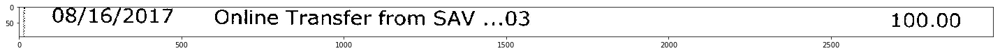

ts oy (4 TT 1A A SS nhs PK oh cms 262i jie if rh ha ee eee et
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ts oy (4 TT 1A A SS nhs PK oh cms 262i jie if rh ha ee eee et']


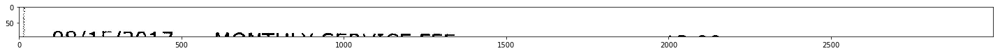


Amount was not detected, re-attempting by removing commas
[None, None, '']


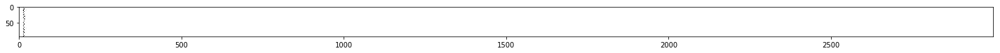

08/15/2017 MONTHLY SERVICE FEE -12.00
[datetime.date(2017, 8, 15), -12.0, ' MONTHLY SERVICE FEE ']


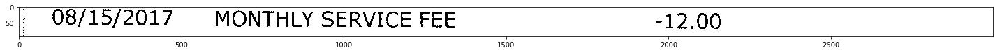

08/14/2017 Online Transfer from SAV ...03 50.00
[datetime.date(2017, 8, 14), 50.0, ' Online Transfer from SAV ...03']


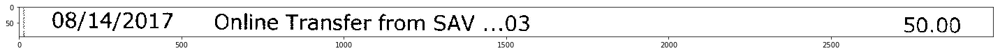


Amount was not detected, re-attempting by removing commas
[None, None, '']


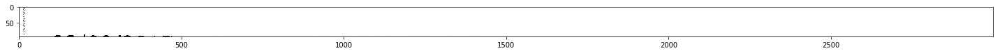

Uo/U6/Z01/ EXPRESSVPN 310-6018492 DE -12.95
Adjusting Window
[None, -12.95, 'Uo/U6/Z01/ EXPRESSVPN 310-6018492 DE ']


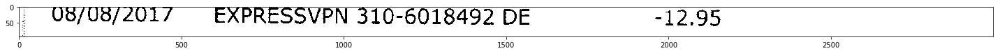

08/08/2017 EXPRESSVPN 310-6018492 DE -12.95
[datetime.date(2017, 8, 8), -12.95, ' EXPRESSVPN 310-6018492 DE ']


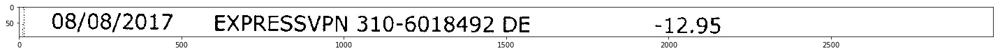


Amount was not detected, re-attempting by removing commas
[None, None, '']


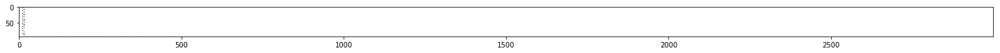

08/07/2017 JetBrains Americas IN 165-0577 -4.70
[datetime.date(2017, 8, 7), -4.7, ' JetBrains Americas IN 165-0577 ']


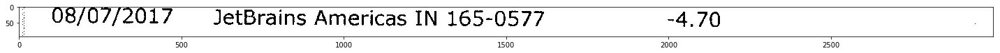

wu mu Umi. mhUurhlULrTl fF hoo
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'wu mu Umi. mhUurhlULrTl fF hoo']


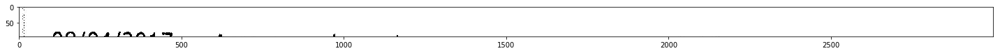


Amount was not detected, re-attempting by removing commas
[None, None, '']


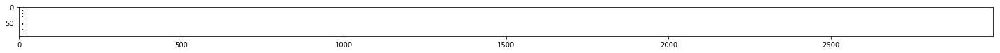

08/04/2017 Amazon web services -2.12
[datetime.date(2017, 8, 4), -2.12, ' Amazon web services ']


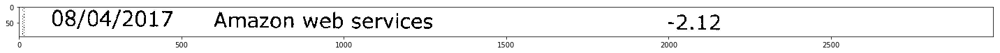

aws.amazon

Va ie ee ko Kees Ge  he ae re
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aws.amazon\n\nVa ie ee ko Kees Ge  he ae re']


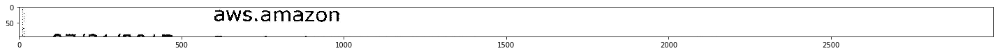

aws.amazon
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aws.amazon']


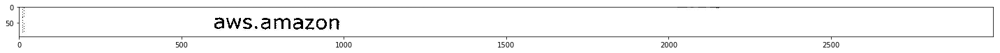

aws.amazon
Amount was not detected, re-attempting by removing commas
[None, None, 'aws.amazon']


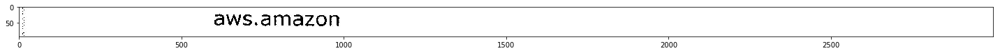

07/31/2017 Dropbox* 7FD4HL8QR8NF -9.99
[datetime.date(2017, 7, 31), -9.99, ' Dropbox* 7FD4HL8QR8NF ']


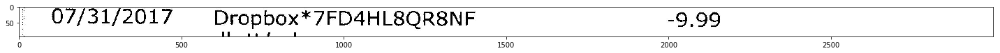

~~.  j¢, -™|

a™ ~~ «~~?

D.T/ CCN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '--.  j¢, -™|\n\na™ -- «--?\n\nD.T/ CCN']


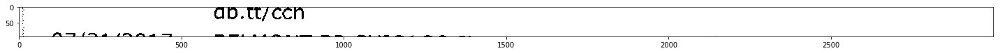

db.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'db.tt/cch']


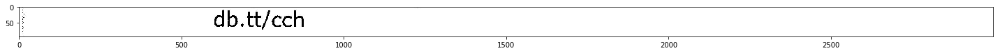

ab.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ab.tt/cch']


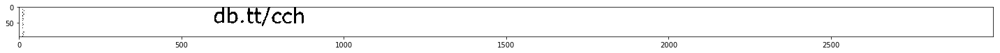

__g wee ce of oe ae a

GbD.T eyecn
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '__g wee ce of oe ae a\n\nGbD.T eyecn']


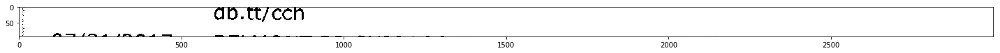

GD. CCT

fr7r,(7/PD4 /Orn4to PAVUrPm1 oR ACN R OU PAO CUP™ I OO OA ef hum
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'GD. CCT\n\nfr7r,(7/PD4 /Orn4to PAVUrPm1 oR ACN R OU PAO CUP™ I OO OA ef hum']


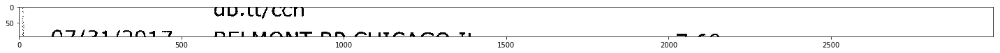

0N7/21/91N17

Mb A NL!

DCI AACAAIT DY CLITMm ASSL TI
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '0N7/21/91N17\n\nMb A NL!\n\nDCI AACAAIT DY CLITMm ASSL TI']


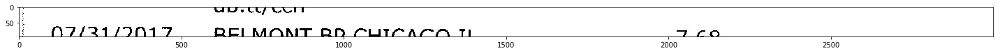

eee

07/31/9017 REI MONT RD CHICACGMO TI ~7 £2
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'eee\n\n REI MONT RD CHICACGMO TI ~7 £2']


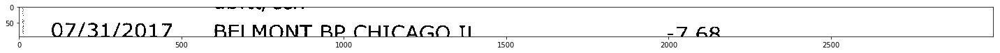

07/31/2017 BELMONT BP CHICAGO IL -7 68
[datetime.date(2017, 7, 31), -7.68, ' BELMONT BP CHICAGO IL ']


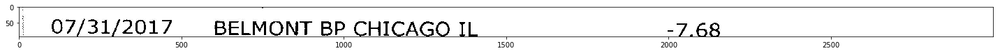


Amount was not detected, re-attempting by removing commas
[None, None, '']


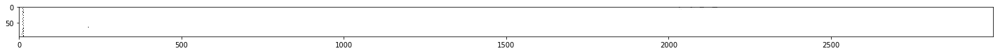

07/25/2017 ADOBE *PHOTOGPHY PLAN -9,99
, istead of . was detected, chainging
[datetime.date(2017, 7, 25), -9.99, ' ADOBE *PHOTOGPHY PLAN ']


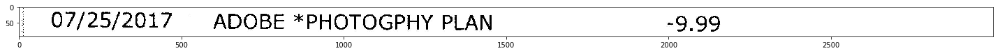

800-833-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '800-833-']


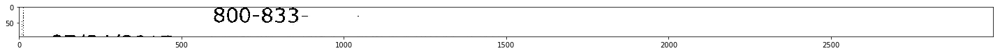

800-833-_
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '800-833-_']


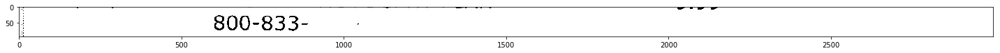

800-833-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '800-833-']


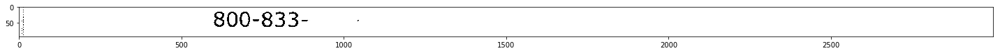

800-833-
Amount was not detected, re-attempting by removing commas
[None, None, '800-833-']


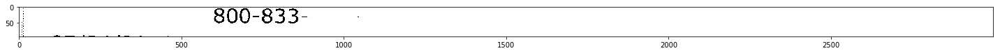

US/ 24/2017  VZWRLSS*APOCC VISN 800- -104.47

7. ;, ms! fo. ~~, ~~
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'US/ 24/2017  VZWRLSS*APOCC VISN 800- -104.47\n\n7. ;, ms! fo. --, --']


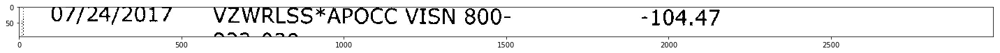

07/24/2017 VZWRLSS*APOCC VISN 800- -104.47
[datetime.date(2017, 7, 24), -104.47, ' VZWRLSS*APOCC VISN 800- ']


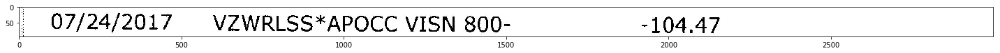

922-020
Adjusting Window
[None, -20.0, '922']


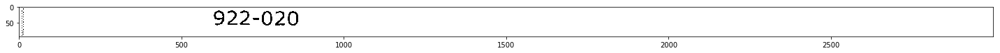


Amount was not detected, re-attempting by removing commas
[None, None, '']


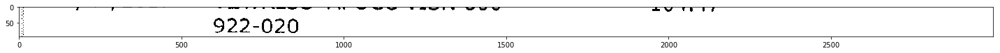

07/20/2017 Online Transfer from SAV ...03 100.00
[datetime.date(2017, 7, 20), 100.0, ' Online Transfer from SAV ...03']


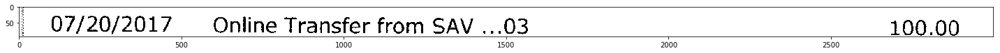


Amount was not detected, re-attempting by removing commas
[None, None, '']


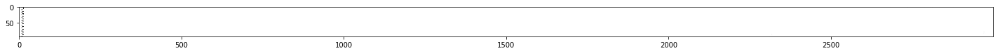

07/18/2017 MONTHLY SERVICE FEE -12.00
[datetime.date(2017, 7, 18), -12.0, ' MONTHLY SERVICE FEE ']


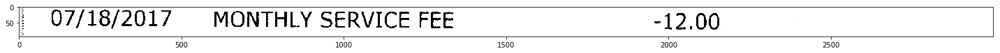

07/17/2017 PAYPAL *PUMPINGSTAT 402- -40,.00
Amount was not detected, re-attempting by removing commas
[datetime.date(2017, 7, 17), -40.0, ' PAYPAL *PUMPINGSTAT 402- -40,.00']


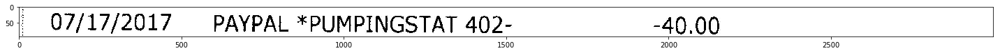

935-77
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '935-77']


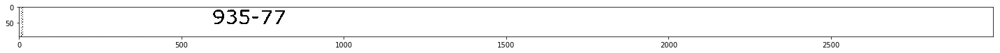

_ ce See Fw oe TNs es
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '_ ce See Fw oe TNs es']


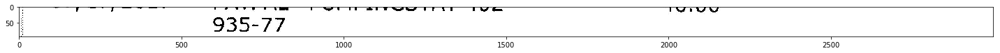

935-77
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '935-77']


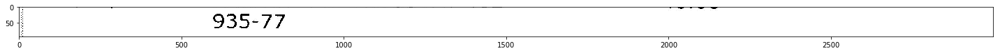

935-77
Amount was not detected, re-attempting by removing commas
[None, None, '935-77']


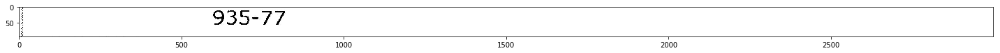

07/07/2017 JetBrains Americas IN 165-0577 5.90
[datetime.date(2017, 7, 7), 5.9, ' JetBrains Americas IN 165-0577']


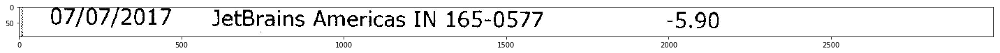

, a eo. ae ee a. a iii a a ue kh
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, ', a eo. ae ee a. a iii a a ue kh']


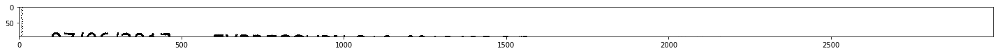


Amount was not detected, re-attempting by removing commas
[None, None, '']


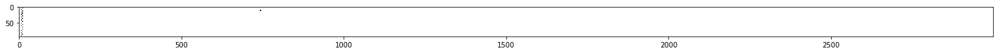

07/06/2017 EXPRESSVPN 310-6018492 DE -12.95
[datetime.date(2017, 7, 6), -12.95, ' EXPRESSVPN 310-6018492 DE ']


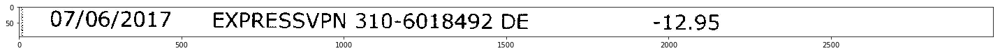


Amount was not detected, re-attempting by removing commas
[None, None, '']


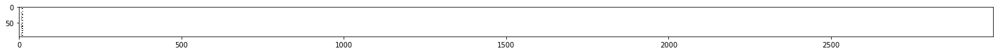

AG eas ag ce
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AG eas ag ce']


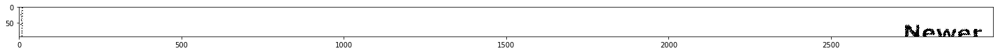


Amount was not detected, re-attempting by removing commas
[None, None, '']


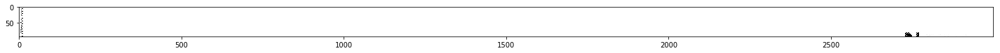

Image (3).jpg
07/03/2017 Amazon web services -2.12
[datetime.date(2017, 7, 3), -2.12, ' Amazon web services ']


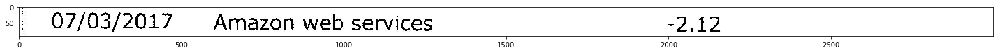

aws.amazon
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aws.amazon']


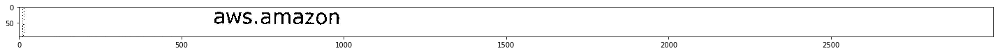

aws.amazon
Amount was not detected, re-attempting by removing commas
[None, None, 'aws.amazon']


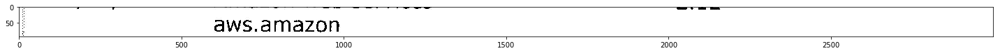

06/29/2017 Dropbox*Y1GNPLMDLY2S -9.99
[datetime.date(2017, 6, 29), -9.99, ' Dropbox*Y1GNPLMDLY2S ']


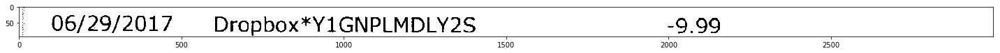

db.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'db.tt/cch']


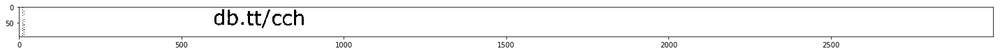

meme memes EE E>e reer ee ee ee SS eee OS ee ee ee Fe
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'meme memes EE E>e reer ee ee ee SS eee OS ee ee ee Fe']


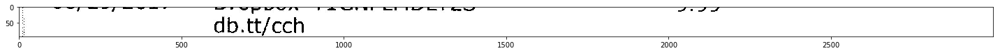

db.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'db.tt/cch']


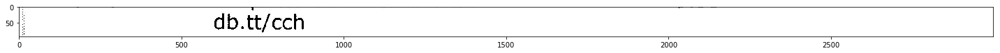

db.tt/cch
Amount was not detected, re-attempting by removing commas
[None, None, 'db.tt/cch']


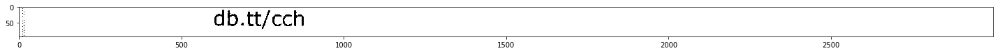

06/26/2017 ADOBE *PHOTOGPHY PLAN

ima. citi met ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 6, 26), None, ' ADOBE *PHOTOGPHY PLAN\n\nima. citi met ee']


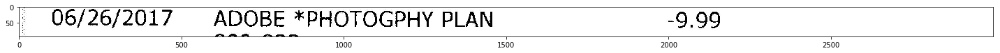

06/26/2017 ADOBE *PHOTOGPHY PLAN -9 99
[datetime.date(2017, 6, 26), -9.99, ' ADOBE *PHOTOGPHY PLAN ']


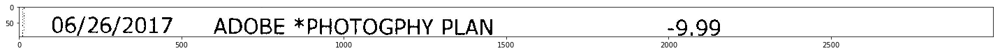

800-833-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '800-833-']


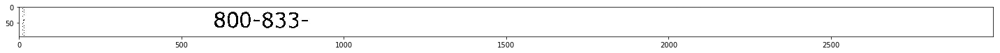

Mf a Fe NH wt Le POE ENA PNA NSP PE 8 NN  At IS

800-833-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Mf a Fe NH wt Le POE ENA PNA NSP PE 8 NN  At IS\n\n800-833-']


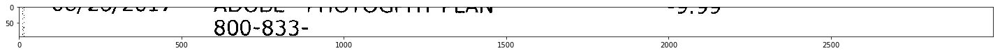

800-833-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '800-833-']


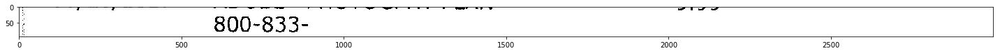

800-833-
Amount was not detected, re-attempting by removing commas
[None, None, '800-833-']


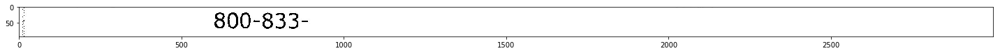

06/22/2017 VZWRLSS*APOCC VISN 800- -104.45
[datetime.date(2017, 6, 22), -104.45, ' VZWRLSS*APOCC VISN 800- ']


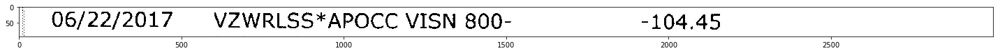

922-020
Adjusting Window
[None, -20.0, '922']


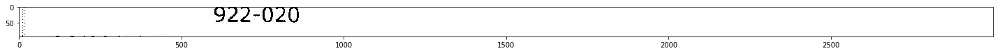

922-020
[None, -20.0, '922']


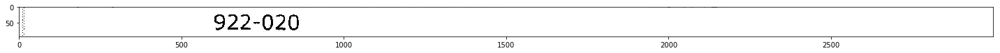

06/22/2017 Online Transfer from SAV ...03 150.00
[datetime.date(2017, 6, 22), 150.0, ' Online Transfer from SAV ...03']


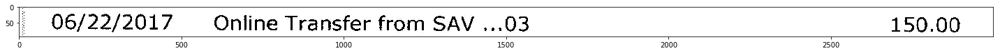


Amount was not detected, re-attempting by removing commas
[None, None, '']


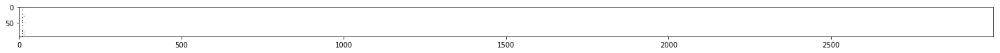

06/19/2017 MCDONALD'S M4849 CHICAGO -17.77
[datetime.date(2017, 6, 19), -17.77, " MCDONALD'S M4849 CHICAGO "]


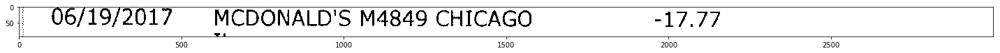

rm 4 et mm i ome Of hl me mermmas ssf Summ me ce ten ot: ct
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'rm 4 et mm i ome Of hl me mermmas ssf Summ me ce ten ot: ct']


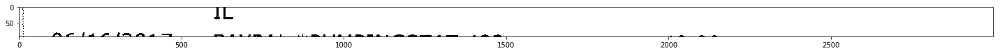

IL
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'IL']


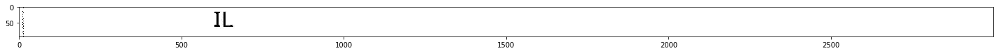

IL
Amount was not detected, re-attempting by removing commas
[None, None, 'IL']


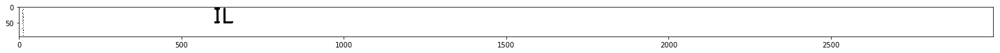

06/16/2017 PAYPAL *PUMPINGSTAT 402- -40.00

RA -
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 6, 16), None, ' PAYPAL *PUMPINGSTAT 402- -40.00\n\nRA -']


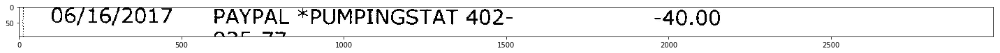

06/16/2017 PAYPAL *PUMPINGSTAT 402- -40.00
[datetime.date(2017, 6, 16), -40.0, ' PAYPAL *PUMPINGSTAT 402- ']


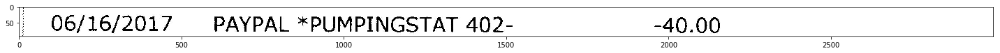

935-77
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '935-77']


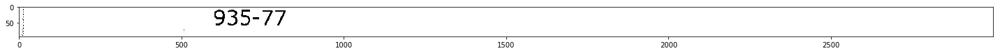

cae Nae ee es me Eien, 7. _ se Eee ee ee 5 Nt Gm Mw et Nw
f f

935-77
Adjusting Window
[None, None, 'cae Nae ee es me Eien, 7. _ se Eee ee ee 5 Nt Gm Mw et Nw\nf f\n']


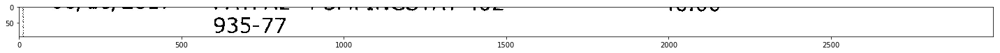

935-77
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '935-77']


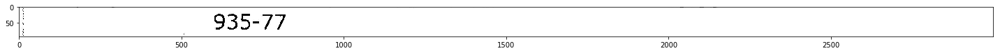

935-77
Amount was not detected, re-attempting by removing commas
[None, None, '935-77']


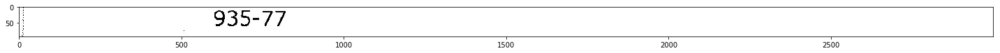

06/15/2017 MONTHLY SERVICE FEE -12.00
[datetime.date(2017, 6, 15), -12.0, ' MONTHLY SERVICE FEE ']


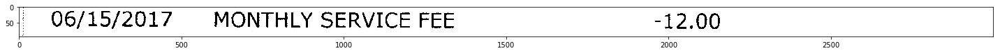

06/12/2017 NAME-CHEAP.COM NAME-C -10.87
[datetime.date(2017, 6, 12), -10.87, ' NAME-CHEAP.COM NAME-C ']


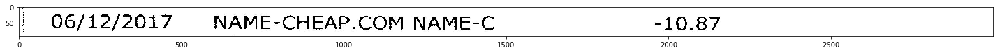

325-3/9-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '325-3/9-']


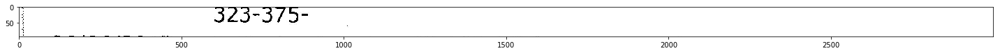

323-375-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '323-375-']


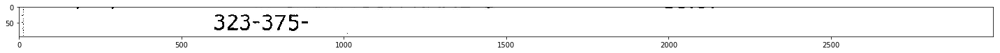

323-375-
Amount was not detected, re-attempting by removing commas
[None, None, '323-375-']


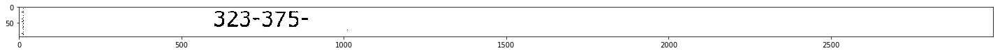

06/06/2017

JetBrains Americas IN 165-0577

-5.90
[datetime.date(2017, 6, 6), -5.9, '\n\nJetBrains Americas IN 165-0577\n\n']


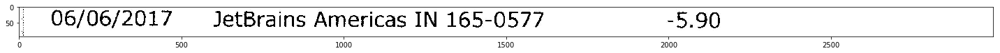

PP tm re hale, ee ll

gti; hice: comin aime a

_-n
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PP tm re hale, ee ll\n\ngti; hice: comin aime a\n\n_-n']


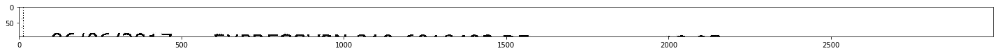


Amount was not detected, re-attempting by removing commas
[None, None, '']


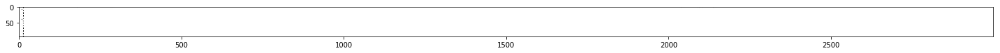

06/06/2017 EXPRESSVPN 310-6018492 DE -12.95
[datetime.date(2017, 6, 6), -12.95, ' EXPRESSVPN 310-6018492 DE ']


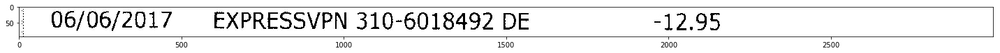

on

a a.

~_ 
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'on\n\na a.\n\n~_ ']


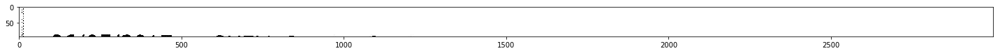


Amount was not detected, re-attempting by removing commas
[None, None, '']


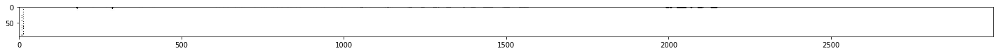

06/05/2017 SHELL Service Station -6.25
[datetime.date(2017, 6, 5), -6.25, ' SHELL Service Station ']


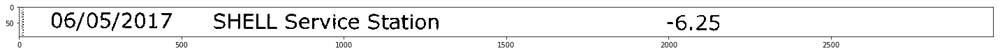

CHICAGO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CHICAGO']


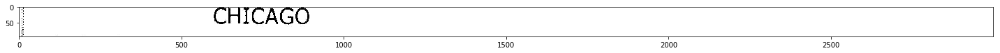

CHICAGO
Amount was not detected, re-attempting by removing commas
[None, None, 'CHICAGO']


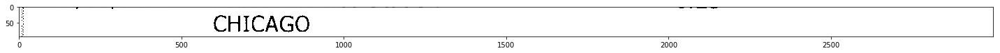

06/05/2017 Amazon web services -4,.46
Amount was not detected, re-attempting by removing commas
[datetime.date(2017, 6, 5), -4.46, ' Amazon web services -4,.46']


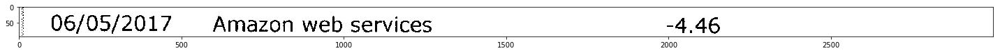

aws.amazon
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aws.amazon']


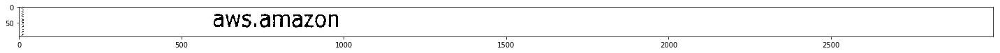

Esl

eee ee OD Nee ee ee

aWs, amazon
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Esl\n\neee ee OD Nee ee ee\n\naWs, amazon']


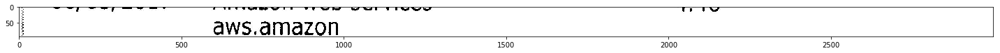

aws.amazon
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aws.amazon']


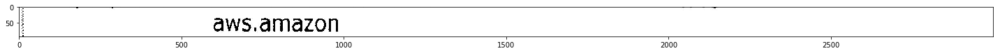

aws.amazon
Amount was not detected, re-attempting by removing commas
[None, None, 'aws.amazon']


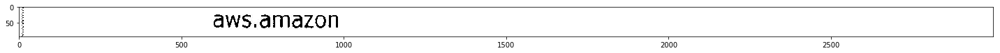

06/05/2017 MCDONALD'S M4849 CHICAGO -9.27
[datetime.date(2017, 6, 5), -9.27, " MCDONALD'S M4849 CHICAGO "]


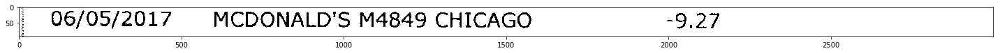

IL
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'IL']


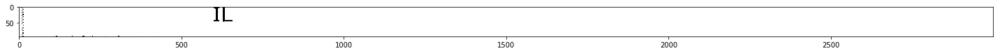

IL
Amount was not detected, re-attempting by removing commas
[None, None, 'IL']


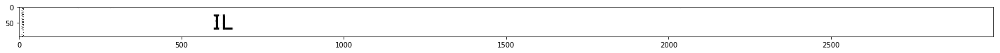

06/01/2017 BELMONT BP CHICAGO IL -6.58
[datetime.date(2017, 6, 1), -6.58, ' BELMONT BP CHICAGO IL ']


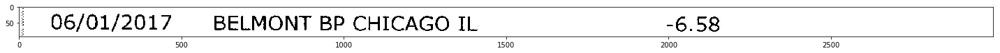


Amount was not detected, re-attempting by removing commas
[None, None, '']


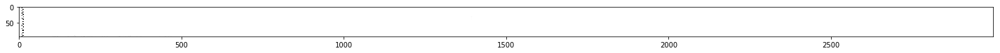

05/30/2017 Dropbox*Q4YRXR4YBG94 -9.99
[datetime.date(2017, 5, 30), -9.99, ' Dropbox*Q4YRXR4YBG94 ']


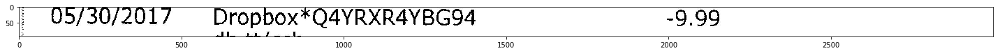

QU.UL/ CCT
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'QU.UL/ CCT']


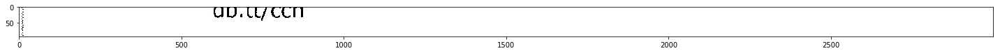

db.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'db.tt/cch']


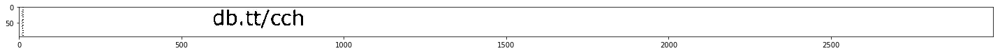


Amount was not detected, re-attempting by removing commas
[None, None, '']


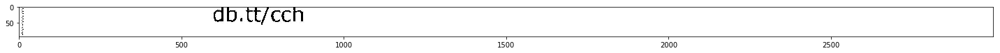

Image (39).jpg
12/05/2016 CHIPOTLE 2028 SAN MATEO CA -13.55
[datetime.date(2016, 12, 5), -13.55, ' CHIPOTLE 2028 SAN MATEO CA ']


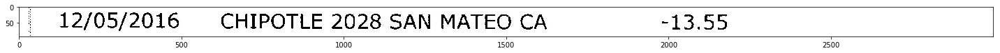


Amount was not detected, re-attempting by removing commas
[None, None, '']


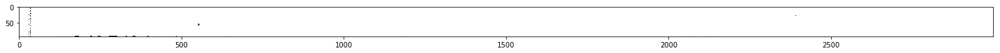

12/05/2016 Amazon web services -13.21

mS Se. OK. Bi i ei we:
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 5), None, ' Amazon web services -13.21\n\nmS Se. OK. Bi i ei we:']


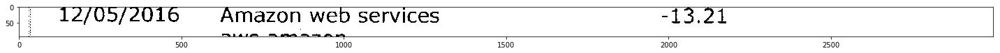

12/05/2016 Amazon web services -13.21
[datetime.date(2016, 12, 5), -13.21, ' Amazon web services ']


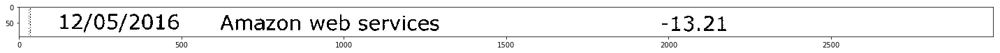

aws.amazon
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aws.amazon']


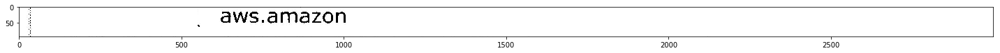

aws.amazon
Amount was not detected, re-attempting by removing commas
[None, None, 'aws.amazon']


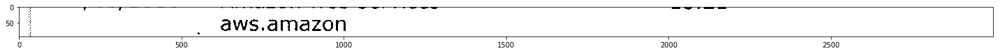

12/05/2016 CHIPOTLE 2028 SAN MATEO CA -11.31
[datetime.date(2016, 12, 5), -11.31, ' CHIPOTLE 2028 SAN MATEO CA ']


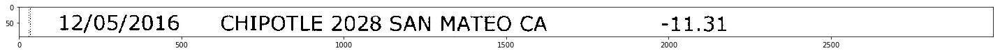


Amount was not detected, re-attempting by removing commas
[None, None, '']


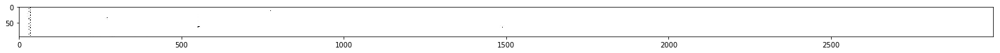

12/02/2016 EXPRESSVPN 310-6018492 DE -12.95
[datetime.date(2016, 12, 2), -12.95, ' EXPRESSVPN 310-6018492 DE ']


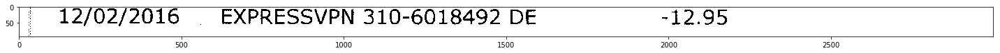

a2! ff @

s-m™ MM 2
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'a2! ff @\n\ns-m™ MM 2']


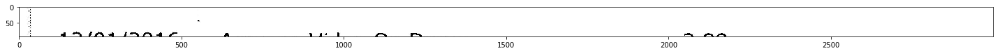


Amount was not detected, re-attempting by removing commas
[None, None, '']


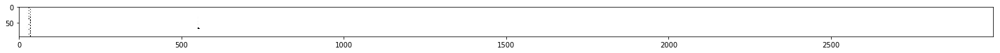

12/01/2016 Amazon Video On Dema -3.99
[datetime.date(2016, 12, 1), -3.99, ' Amazon Video On Dema ']


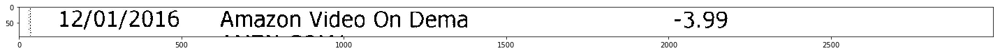

AMZN. ie
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN. ie']


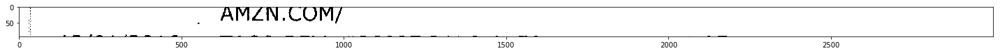

| AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| AMZN.COM/']


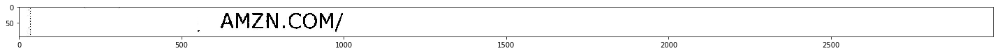

| AMZN.COM/
Amount was not detected, re-attempting by removing commas
[None, None, '| AMZN.COM/']


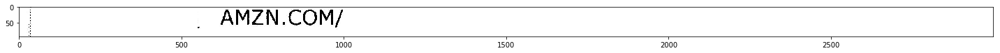

12/01/2016 TACO BELL #28837 PALO ALTO -4.35
[datetime.date(2016, 12, 1), -4.35, ' TACO BELL #28837 PALO ALTO ']


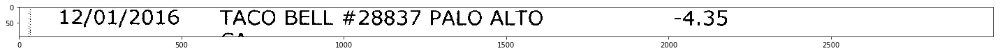

2 om Ulm hull Ol be i ee i ce: ci ol ee es
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '2 om Ulm hull Ol be i ee i ce: ci ol ee es']


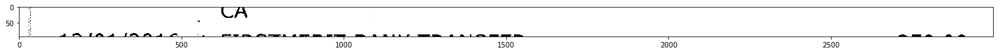

CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CA']


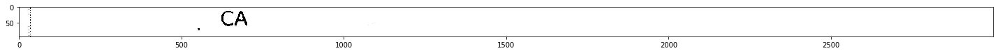


Amount was not detected, re-attempting by removing commas
[None, None, '']


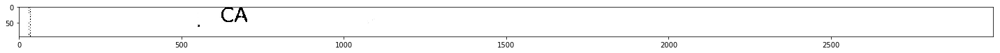

12/01/2016 it FIRSTMERIT BANK TRANSFER
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 1), None, ' it FIRSTMERIT BANK TRANSFER']


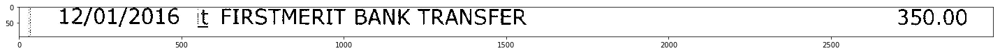

12/01/2016 * FIRSTMERIT BANK TRANSFER 350.00
[datetime.date(2016, 12, 1), 350.0, ' * FIRSTMERIT BANK TRANSFER']


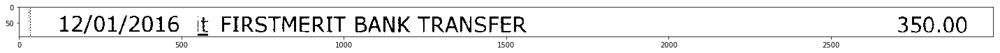

11/29/2016 STEAMGAMES.COM42595229 -15.95
[datetime.date(2016, 11, 29), -15.95, ' STEAMGAMES.COM42595229 ']


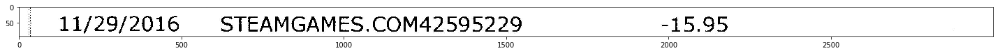

425-952
Adjusting Window
[None, -952.0, '425']


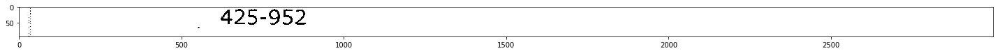

ae eee CE eee Eee 2. So ee fee Se ee 2 UE ee ee ee _aw Fo oe

- 425-952
Adjusting Window
[None, None, 'ae eee CE eee Eee 2. So ee fee Se ee 2 UE ee ee ee _aw Fo oe\n\n-']


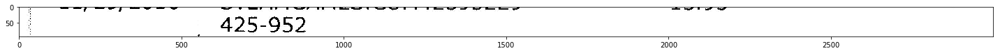

425-952
Adjusting Window
[None, -952.0, '425']


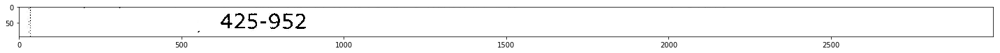

425-952
[None, -952.0, '425']


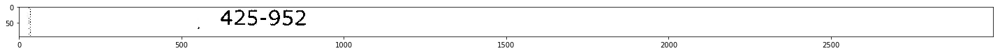

11/28/2016 Dropbox*Q5GR2MHYZ532Z -9.99
[datetime.date(2016, 11, 28), -9.99, ' Dropbox*Q5GR2MHYZ532Z ']


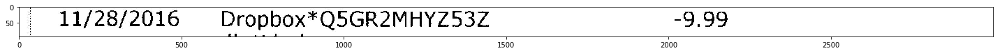

eee eee te

aod.tt/ccn
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'eee eee te\n\naod.tt/ccn']


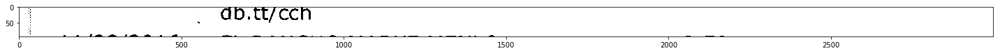

_ db.tt/cch ©
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '_ db.tt/cch ©']


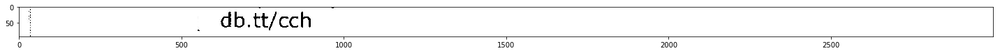

| db.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| db.tt/cch']


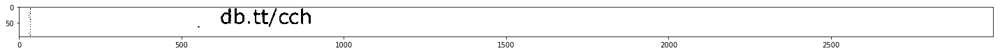

tt/ccn
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'tt/ccn']


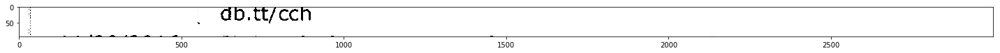

QA ge ii A T™|T TS! rf 4

Qo. CCT)

Ps m™ A PRerm™me) pr™|, 882A TRI SEF™” BAF BRIE

fn

a om ~*~
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'QA ge ii A T™|T TS! rf 4\n\nQo. CCT)\n\nPs m™ A PRerm™me) pr™|, 882A TRI SEF™” BAF BRIE\n\nfn\n\na om ~*~']


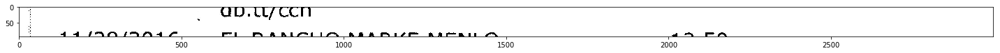

MYA ESTEE

44/970 /9ni1c Mr NM ARISTLICY AAAMIYUVO AAC AIT SN an Cr
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MYA ESTEE\n\n44/970 /9ni1c Mr NM ARISTLICY AAAMIYUVO AAC AIT SN an Cr']


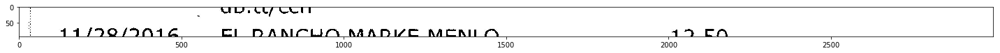

_ee ee ee

11/9DR/IDNI1EG Cy) RNRANICHO MARKE MENIN ~19 Gn
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '_ee ee ee\n\n11/9DR/IDNI1EG Cy) RNRANICHO MARKE MENIN ~19 Gn']


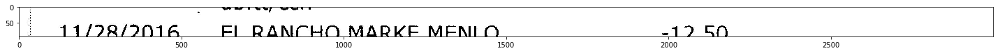

11/28/2016 FIL RANCHO MARKE MENLO -17? 50
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 11, 28), None, ' FIL RANCHO MARKE MENLO -17? 50']


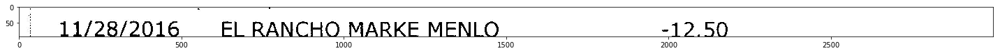

11/28/2016 EL RANCHO MARKE MENLO -12.50
[datetime.date(2016, 11, 28), -12.5, ' EL RANCHO MARKE MENLO ']


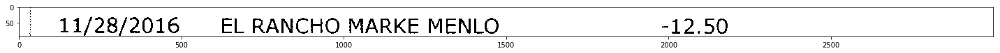

. PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '. PARK CA']


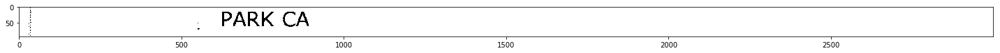

_ ff oe MO fom or ERP LE Ee EU NE Ne FO ee OD Bee ae Cues ew

| PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '_ ff oe MO fom or ERP LE Ee EU NE Ne FO ee OD Bee ae Cues ew\n\n| PARK CA']


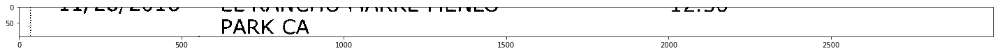

-PARKCA  ™”
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '-PARKCA  ™”']


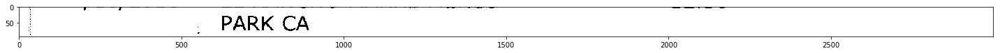

_ PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '_ PARK CA']


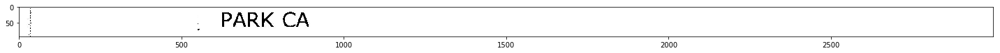

| PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| PARK CA']


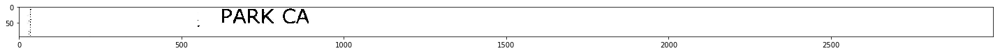

~: /™

.

me oa

|

FARK CA

am ee ele el lll
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '~: /™\n\n.\n\nme oa\n\n|\n\nFARK CA\n\nam ee ele el lll']


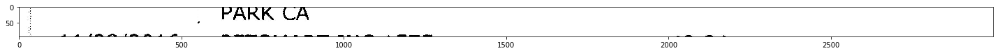

f FARR CA

qq {JA ITA 4A oe rarer om RA A PS” OUT AIS. le Oo se 4Arf~ CA A
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'f FARR CA\n\nqq {JA ITA 4A oe rarer om RA A PS” OUT AIS. le Oo se 4Arf~ CA A']


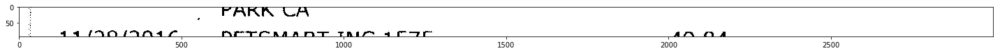

PPNININ NON

4742 /9Q /JN171LQ HMO TCAAA DT TAM 41707  AOY OA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PPNININ NON\n\n4742 /9Q /JN171LQ HMO TCAAA DT TAM 41707  AOY OA']


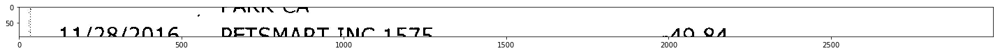

11/92/9N16 PDETCMART INC 15765 -AQ QA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '11/92/9N16 PDETCMART INC 15765 -AQ QA']


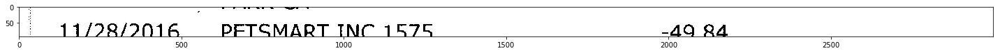

11/28/2016 PETSMART INC 1575 -A49Q 84
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 11, 28), None, ' PETSMART INC 1575 -A49Q 84']


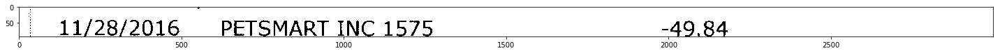

11/28/2016 PETSMART INC 1575 -49,.84
Amount was not detected, re-attempting by removing commas
[datetime.date(2016, 11, 28), -49.84, ' PETSMART INC 1575 -49,.84']


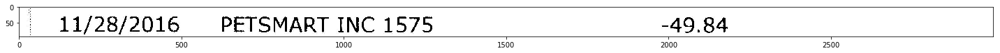

| MOUNTAIN VIE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| MOUNTAIN VIE']


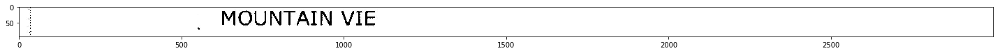

_

eE_

SE EES eee

| MOUNTAIN VIE

 £
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '_\n\neE_\n\nSE EES eee\n\n| MOUNTAIN VIE\n\n £']


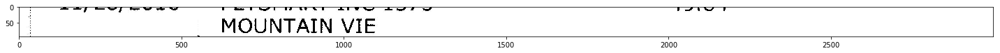

| MOUNTAIN VIE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| MOUNTAIN VIE']


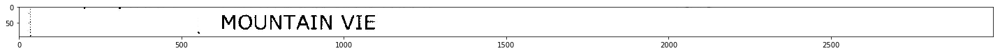

| MOUNTAIN VIE
Amount was not detected, re-attempting by removing commas
[None, None, '| MOUNTAIN VIE']


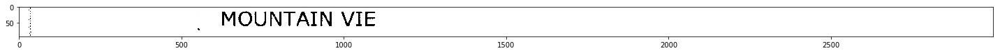

11/28/2016 EL RANCHO MARKE MENLO -24.70
[datetime.date(2016, 11, 28), -24.7, ' EL RANCHO MARKE MENLO ']


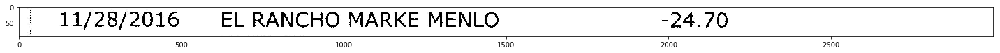

ay x) SGRIR: SQ: «GSS OS Gs: se

| PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ay x) SGRIR: SQ: «GSS OS Gs: se\n\n| PARK CA']


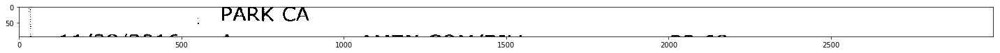

| PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| PARK CA']


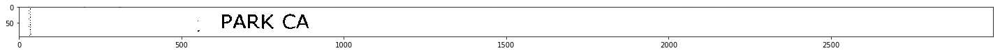

| PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, '| PARK CA']


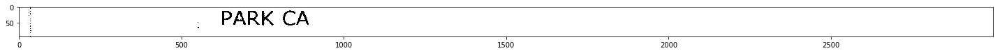

11/28/2016 Amazon.com AMZN.COM/BILL -32.68
[datetime.date(2016, 11, 28), -32.68, ' Amazon.com AMZN.COM/BILL ']


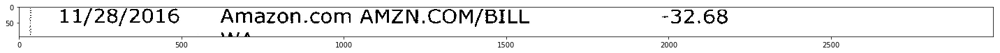

L VA

ee ee a ee ae ae oa ee ee ee ee eee ee ee eee | eee eee ee 2 ae 2 ~ m™ me mm
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'L VA\n\nee ee a ee ae ae oa ee ee ee ee eee ee ee eee | eee eee ee 2 ae 2 ~ m™ me mm']


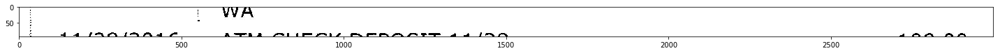

WA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'WA']


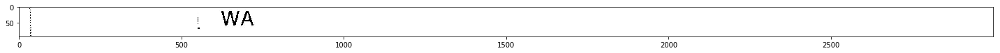


Amount was not detected, re-attempting by removing commas
[None, None, '']


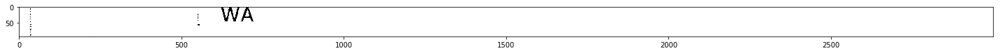

11/28/2016 ATM CHECK DEPOSIT 11/28

™! sie ep™% LEAT T
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 11, 28), None, ' ATM CHECK DEPOSIT 11/28\n\n™! sie ep™% LEAT T']


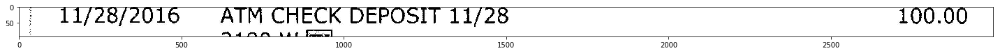

11/28/2016 © ATM CHECK DEPOSIT 11/28 100.00
[datetime.date(2016, 11, 28), 100.0, ' © ATM CHECK DEPOSIT 11/28']


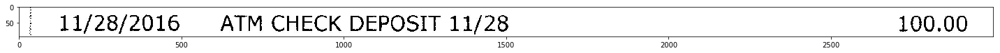

2180 W
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '2180 W']


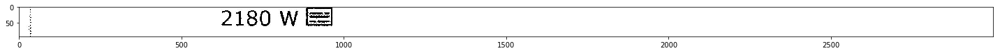

Bs fo me foe wer ere fe Samed Mee ee Se eee See ot ete ee eee oe, SUMS

21830 WE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Bs fo me foe wer ere fe Samed Mee ee Se eee See ot ete ee eee oe, SUMS\n\n21830 WE']


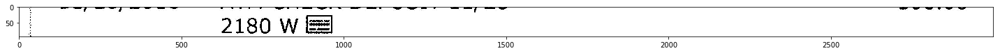

2180 W
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '2180 W']


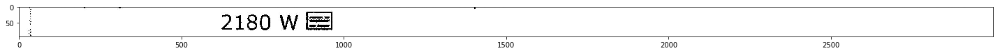

2180 W
Amount was not detected, re-attempting by removing commas
[None, None, '2180 W']


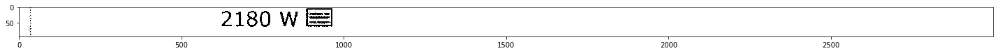

11/25/2016 SQC*LOUIS BARRIS ./ CA -32.00
[datetime.date(2016, 11, 25), -32.0, ' SQC*LOUIS BARRIS ./ CA ']


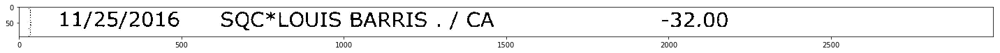


Amount was not detected, re-attempting by removing commas
[None, None, '']


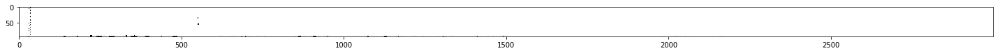

L1if/2é2z/2016 VZWRLOS*APOCC VISN SO0- -107.42

Lra7v7r70 NON
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'L1if/2é2z/2016 VZWRLOS*APOCC VISN SO0- -107.42\n\nLra7v7r70 NON']


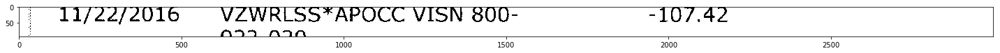

11/22/2016 VZWRLSS*APOCC VISN 800- -107.42
[datetime.date(2016, 11, 22), -107.42, ' VZWRLSS*APOCC VISN 800- ']


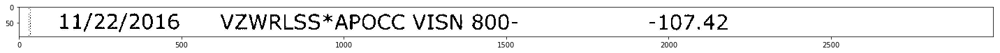

| 922-020
Adjusting Window
[None, None, '|']


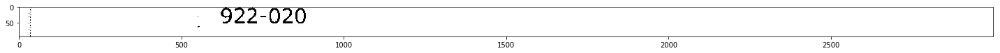

922-020
Adjusting Window
[None, -20.0, '922']


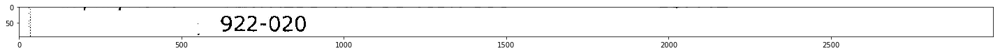

_ 922-020
Adjusting Window
[None, None, '_']


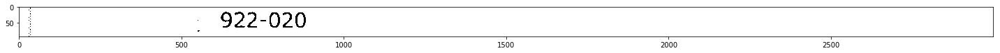

| 922-020
Adjusting Window
[None, None, '|']


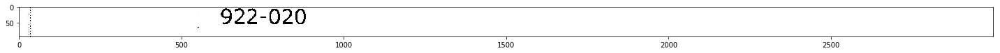

| B22-ULU
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| B22-ULU']


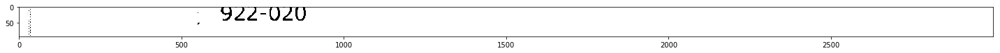

| P#ee-yucyu
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| P#ee-yucyu']


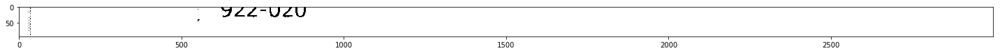

foo VEU
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'foo VEU']


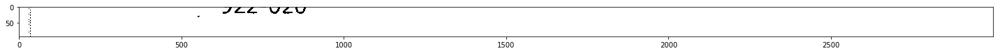


Amount was not detected, re-attempting by removing commas
[None, None, '']


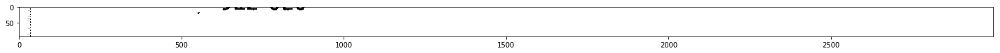

Image (4).jpg
05/30/2017 MCDONALD'S M4849 CHICAGO -9,27
, istead of . was detected, chainging
[datetime.date(2017, 5, 30), -9.27, " MCDONALD'S M4849 CHICAGO "]


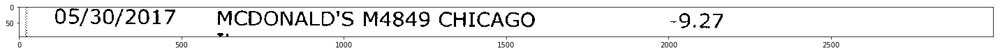

fr F- ea rimrarr~r 4“

gum

ma
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'fr F- ea rimrarr~r 4“\n\ngum\n\nma']


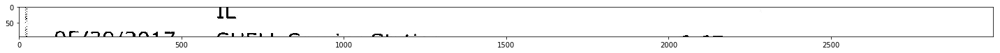

IL
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'IL']


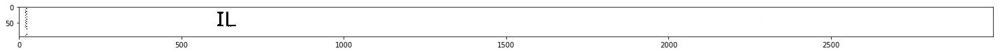

IL
Amount was not detected, re-attempting by removing commas
[None, None, 'IL']


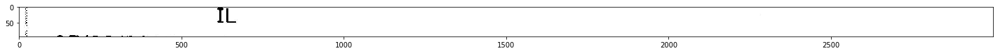

VYo/oU/2Z01/7 SHELL Service Station -6.67
Adjusting Window
[None, -6.67, 'VYo/oU/2Z01/7 SHELL Service Station ']


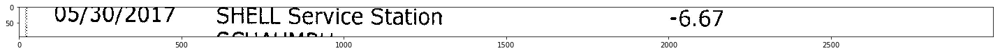

05/30/2017 SHELL Service Station -6.67
[datetime.date(2017, 5, 30), -6.67, ' SHELL Service Station ']


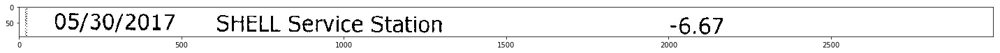

SCHAUMBU
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'SCHAUMBU']


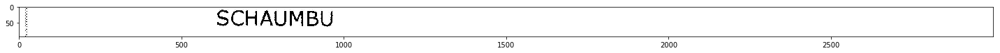

me FD eee ee ee SF Nee ee ee Pw F

SCHAUMBU
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'me FD eee ee ee SF Nee ee ee Pw F\n\nSCHAUMBU']


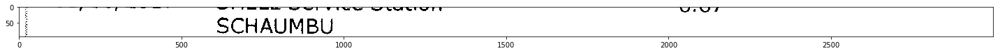

SCHAUMBU
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'SCHAUMBU']


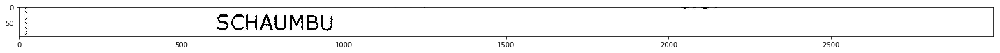

SCHAUMBU
Amount was not detected, re-attempting by removing commas
[None, None, 'SCHAUMBU']


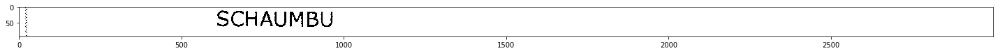

05/30/2017 MCDONALD'S M4849 CHICAGO -9.27
[datetime.date(2017, 5, 30), -9.27, " MCDONALD'S M4849 CHICAGO "]


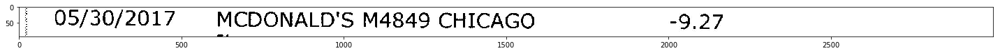

ame: met Sa a ae
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ame: met Sa a ae']


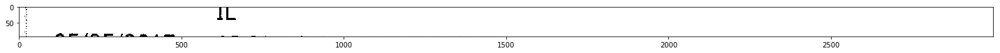

IL
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'IL']


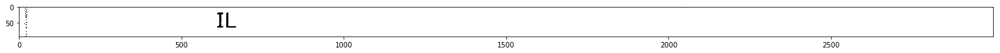

IL
Amount was not detected, re-attempting by removing commas
[None, None, 'IL']


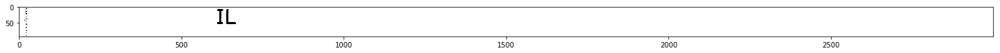

05/25/2017 ADOBE *PHOTOGPHY PLAN

ee ee ee eee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 5, 25), None, ' ADOBE *PHOTOGPHY PLAN\n\nee ee ee eee']


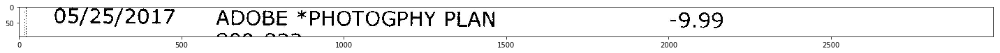

05/25/2017 ADOBE *PHOTOGPHY PLAN -9,99
, istead of . was detected, chainging
[datetime.date(2017, 5, 25), -9.99, ' ADOBE *PHOTOGPHY PLAN ']


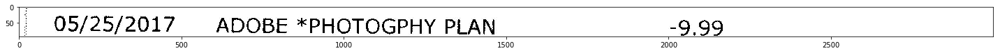

800-833-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '800-833-']


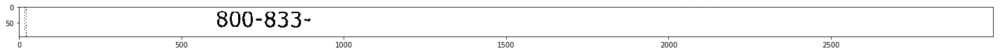

Se ee eg em ae, ee ee CN et et fet Gow SPT Nt DN et FOE ee LE ad

800-833-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Se ee eg em ae, ee ee CN et et fet Gow SPT Nt DN et FOE ee LE ad\n\n800-833-']


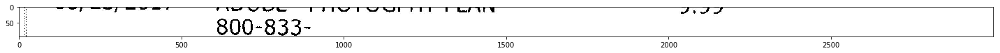

800-833-_
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '800-833-_']


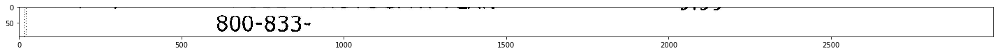

800-833-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '800-833-']


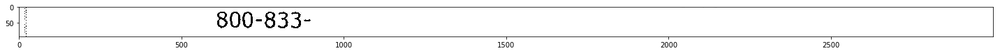

800-833-
Amount was not detected, re-attempting by removing commas
[None, None, '800-833-']


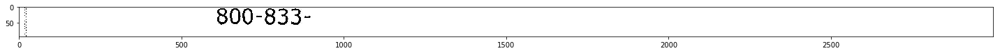

05/24/2017 Online Transfer from SAV ...03 250.00
[datetime.date(2017, 5, 24), 250.0, ' Online Transfer from SAV ...03']


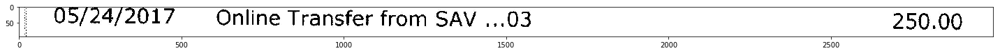

rr FN ™ TN US

na awe aa 

an
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'rr FN ™ TN US\n\nna awe aa \n\nan']


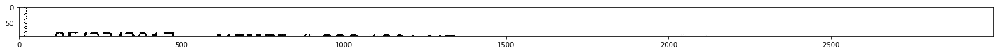


Amount was not detected, re-attempting by removing commas
[None, None, '']


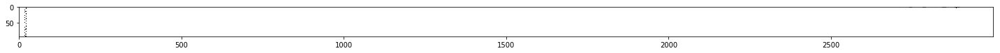

05/23/2017 MEIJER # 228 1301 ME -2.41
[datetime.date(2017, 5, 23), -2.41, ' MEIJER # 228 1301 ME ']


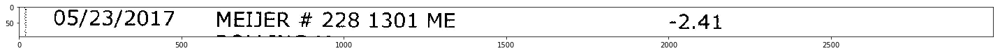

ROLLS NG Mm

for" fru r™O UmLhCU r™!|:|,lUr UU - Ses sats Se dee ee:
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ROLLS NG Mm\n\nfor- fru r™O UmLhCU r™!|:|,lUr UU - Ses sats Se dee ee:']


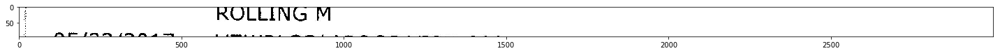

ROLLING M
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ROLLING M']


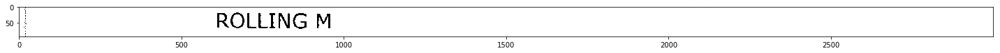

ROLLING M
Amount was not detected, re-attempting by removing commas
[None, None, 'ROLLING M']


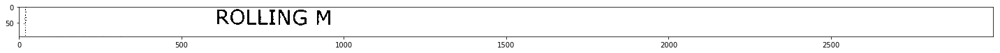

Q5/22/2017 VZWRLSS*APOCC VISN 800- -104.45

rf ™ ™~ ~~ mH
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Q5/22/2017 VZWRLSS*APOCC VISN 800- -104.45\n\nrf ™ ™- -- mH']


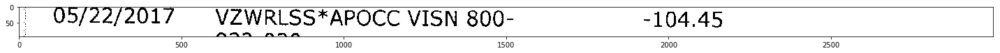

05/22/2017 VZWRLSS*APOCC VISN 800- -104.45
[datetime.date(2017, 5, 22), -104.45, ' VZWRLSS*APOCC VISN 800- ']


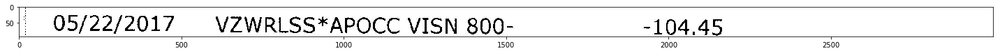

922-020
Adjusting Window
[None, -20.0, '922']


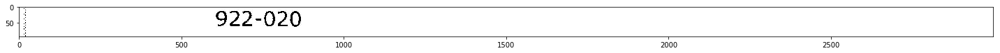

ed: mee Se  FN Ee el NEN Ne ee WO EEO #uVU TAT

922- 020
Adjusting Window
[None, 20.0, 'ed: mee Se  FN Ee el NEN Ne ee WO EEO #uVU TAT\n\n922-']


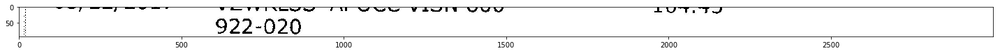

922-020
Adjusting Window
[None, -20.0, '922']


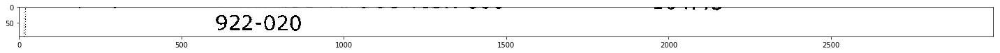

922-020
[None, -20.0, '922']


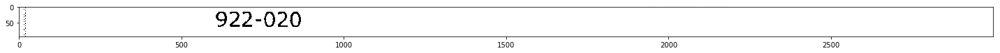

05/22/2017 PARKINGMETERI 877242790 -0.25
[datetime.date(2017, 5, 22), -0.25, ' PARKINGMETERI 877242790 ']


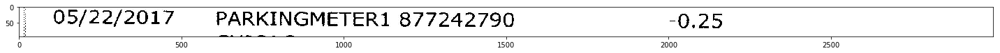

CAICAG
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CAICAG']


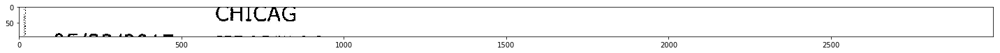

CHICAG
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CHICAG']


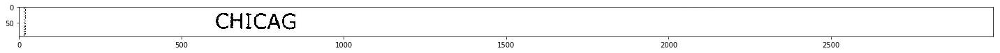

CHICAG
Amount was not detected, re-attempting by removing commas
[None, None, 'CHICAG']


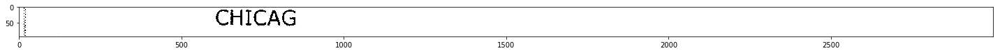

05/22/2017 JIBARITOS Y MAS CHICAGO IL -23.21
[datetime.date(2017, 5, 22), -23.21, ' JIBARITOS Y MAS CHICAGO IL ']


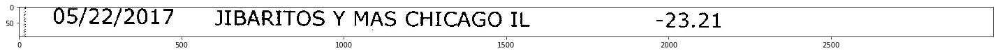

fy F~ ££ @A re Im ™O .
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'fy F~ ££ @A re Im ™O .']


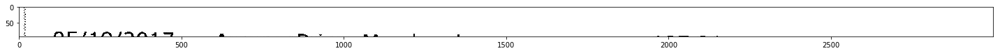


Amount was not detected, re-attempting by removing commas
[None, None, '']


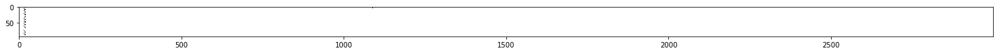

05/19/2017 AmazonPrime Membersh -107.91
[datetime.date(2017, 5, 19), -107.91, ' AmazonPrime Membersh ']


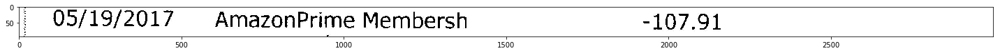

mzn

com/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'mzn\n\ncom/']


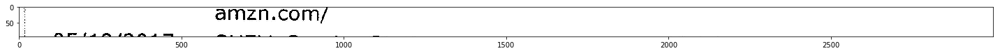

amzn.com/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'amzn.com/']


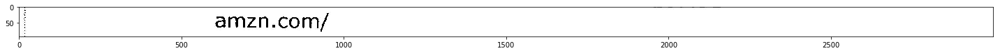

amzn.com/
Amount was not detected, re-attempting by removing commas
[None, None, 'amzn.com/']


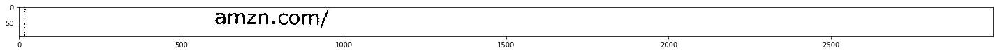

05/19/2017 SHELL Service Station -10.20

Pe ee eee ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 5, 19), None, ' SHELL Service Station -10.20\n\nPe ee eee ee']


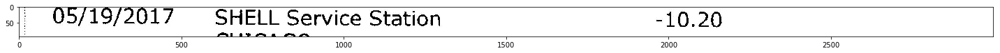

05/19/2017 SHELL Service Station -10.20
[datetime.date(2017, 5, 19), -10.2, ' SHELL Service Station ']


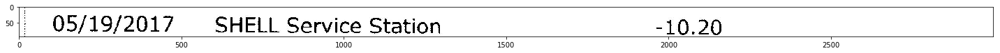

CHICAGO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CHICAGO']


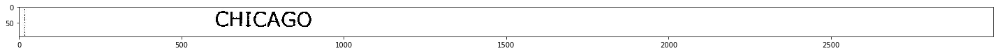

ee eee ee A a we SE See ee Se te ee FO ee ON ee ed

CHICAGO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee eee ee A a we SE See ee Se te ee FO ee ON ee ed\n\nCHICAGO']


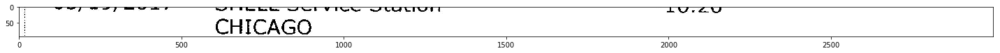

en © e ESE RS AEE: ARS 6 SEER. Aime Shed ape a a

CHICAGO 
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'en © e ESE RS AEE: ARS 6 SEER. Aime Shed ape a a\n\nCHICAGO ']


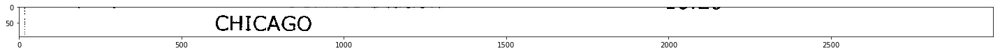

CHICAGO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CHICAGO']


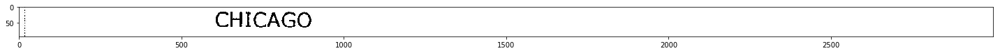

CHICAGO
Amount was not detected, re-attempting by removing commas
[None, None, 'CHICAGO']


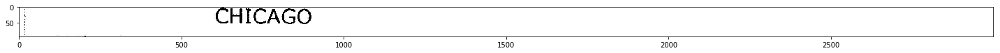

Q5/19/2017 SHELL Service Station -5.38

Pm ires" A wm eX
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Q5/19/2017 SHELL Service Station -5.38\n\nPm ires- A wm eX']


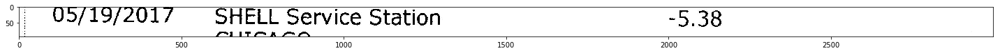

05/19/2017 SHELL Service Station -5.38
[datetime.date(2017, 5, 19), -5.38, ' SHELL Service Station ']


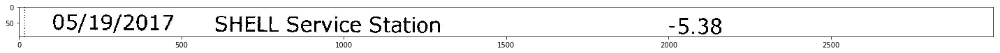

CHICAGO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CHICAGO']


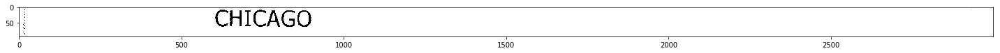

Oe CHICAGO ~

eet ee Se
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Oe CHICAGO ~\n\neet ee Se']


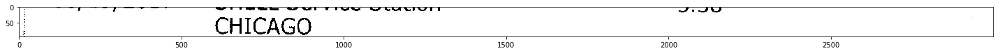

CHICAGO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CHICAGO']


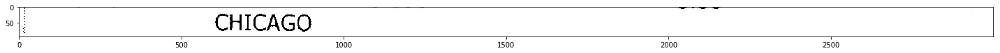

CHICAGO
Amount was not detected, re-attempting by removing commas
[None, None, 'CHICAGO']


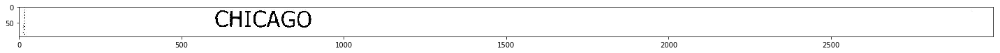

05/17/2017 PAYPAL *PUMPINGSTAT 402- -40.00
[datetime.date(2017, 5, 17), -40.0, ' PAYPAL *PUMPINGSTAT 402- ']


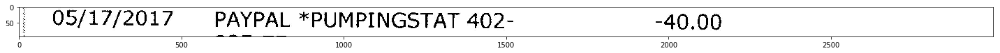

JII-S/

ipl, Simi
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'JII-S/\n\nipl, Simi']


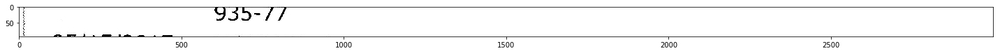

935-77
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '935-77']


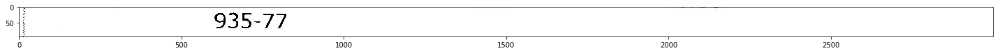

935-77
Amount was not detected, re-attempting by removing commas
[None, None, '935-77']


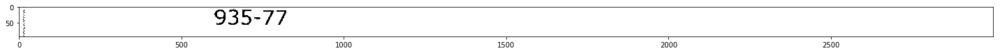

05/15/2017 MONTHLY SERVICE FEE -12.00
[datetime.date(2017, 5, 15), -12.0, ' MONTHLY SERVICE FEE ']


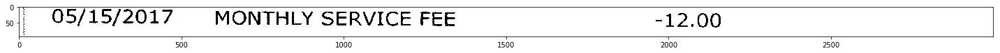

05/15/2017 Online Transfer from SAV ...03 300.00
[datetime.date(2017, 5, 15), 300.0, ' Online Transfer from SAV ...03']


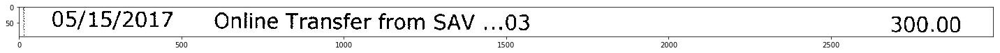


Amount was not detected, re-attempting by removing commas
[None, None, '']


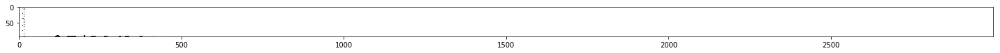

UD/06/201/ JetBrains Americas IN 165-0577 -5.90
Adjusting Window
[None, -5.9, 'UD/06/201/ JetBrains Americas IN 165-0577 ']


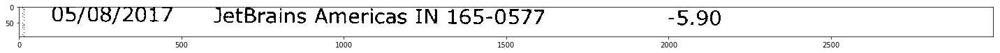

05/08/2017 JetBrains Americas IN 165-0577 -5.90
[datetime.date(2017, 5, 8), -5.9, ' JetBrains Americas IN 165-0577 ']


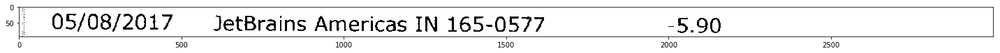


Amount was not detected, re-attempting by removing commas
[None, None, '']


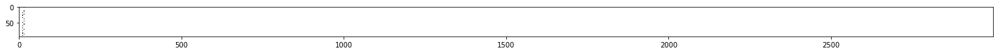

Image (40).jpg
11/04/2016 | EXPRESSVPN 310-6018492 DE -12.95
[datetime.date(2016, 11, 4), -12.95, ' | EXPRESSVPN 310-6018492 DE ']


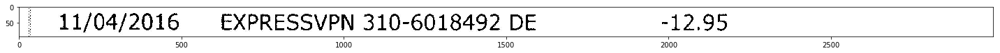


Amount was not detected, re-attempting by removing commas
[None, None, '']


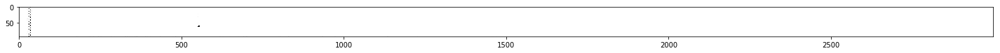

11/01/2016 WILLOW COVE GAS MENLO -6.28

rns A rF™% 1FlCUPh™ CAM
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 11, 1), None, ' WILLOW COVE GAS MENLO -6.28\n\nrns A rF™% 1FlCUPh™ CAM']


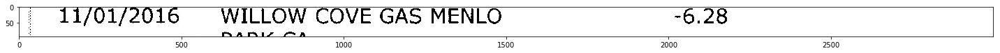

11/01/2016 WILLOW COVE GAS MENLO -6.28
[datetime.date(2016, 11, 1), -6.28, ' WILLOW COVE GAS MENLO ']


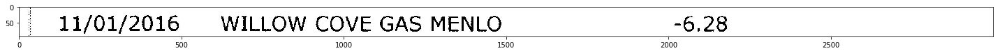

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


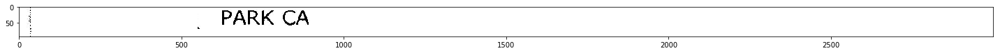


Amount was not detected, re-attempting by removing commas
[None, None, '']


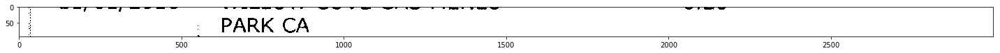

11/01/2016 it FIRSTMERIT BANK TRANSFER 350.00
[datetime.date(2016, 11, 1), 350.0, ' it FIRSTMERIT BANK TRANSFER']


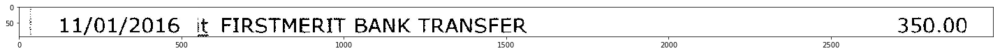

10/31/2016 Dropbox* XGKDCHL5NS67 -9.99
[datetime.date(2016, 10, 31), -9.99, ' Dropbox* XGKDCHL5NS67 ']


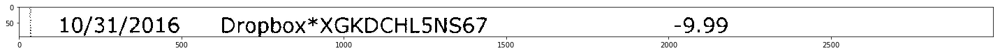

| db.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| db.tt/cch']


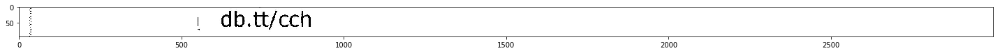

ee ee ee a _m twee ee FON Nee TON ee Net FO ee et EO ee er tt

| db.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee ee ee a _m twee ee FON Nee TON ee Net FO ee et EO ee er tt\n\n| db.tt/cch']


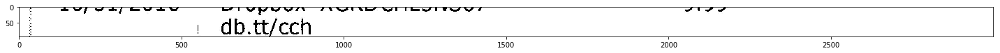

. db.tt/cech
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '. db.tt/cech']


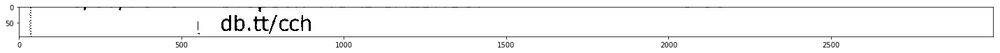

| db.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| db.tt/cch']


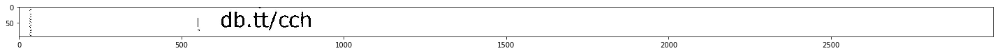

| db.tt/cch
Amount was not detected, re-attempting by removing commas
[None, None, '| db.tt/cch']


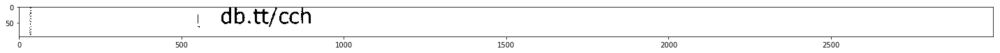

10/31/2016 EL RANCHO MARKE MENLO -7.74

AT™1F O7™ A
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 10, 31), None, ' EL RANCHO MARKE MENLO -7.74\n\nAT™1F O7™ A']


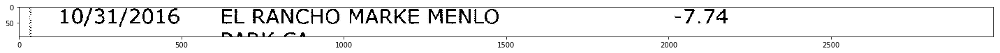

10/31/2016 EL RANCHO MARKE MENLO -7.74
[datetime.date(2016, 10, 31), -7.74, ' EL RANCHO MARKE MENLO ']


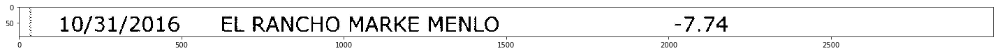

| PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| PARK CA']


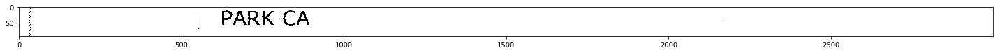

co ee Oe ee ae Se Oe ees ee US ES ee eee RO

 

| PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'co ee Oe ee ae Se Oe ees ee US ES ee eee RO\n\n \n\n| PARK CA']


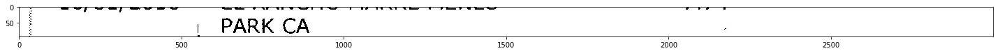

| PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| PARK CA']


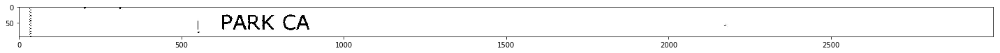

| PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, '| PARK CA']


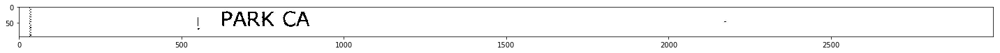

10/31/2016 ARCO PAYPOINT SAN MATEO -2.44
[datetime.date(2016, 10, 31), -2.44, ' ARCO PAYPOINT SAN MATEO ']


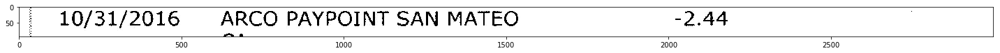

os me Poe we iO Me ll eS Ee ee a ee a. oe po a "ae
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'os me Poe we iO Me ll eS Ee ee a ee a. oe po a -ae']


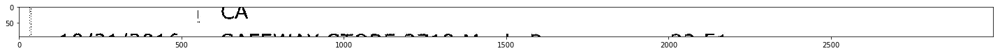

CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CA']


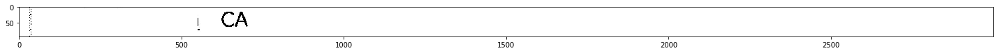


Amount was not detected, re-attempting by removing commas
[None, None, '']


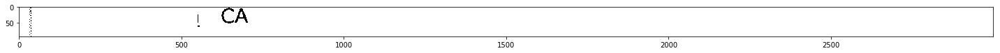

10/31/2016 SAFEWAY STORE 2719 Menlo P -22.51
[datetime.date(2016, 10, 31), -22.51, ' SAFEWAY STORE 2719 Menlo P ']


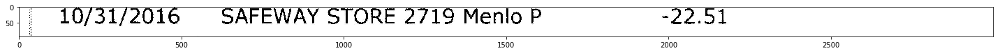

2 2am h6ihromm™mehuehUCUm TT LUO Om Uhl rs sp gpa meazes™ m™ BRB SPWMWait 4. fo m™m™ mm
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '2 2am h6ihromm™mehuehUCUm TT LUO Om Uhl rs sp gpa meazes™ m™ BRB SPWMWait 4. fo m™m™ mm']


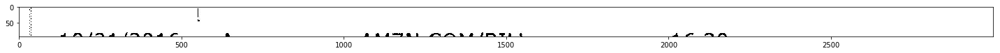


Amount was not detected, re-attempting by removing commas
[None, None, '']


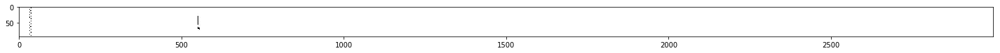

10/31/2016 Amazon.com AMZN.COM/BILL -16.30
[datetime.date(2016, 10, 31), -16.3, ' Amazon.com AMZN.COM/BILL ']


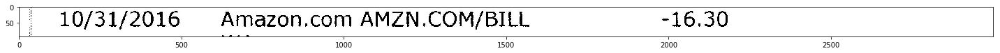


Amount was not detected, re-attempting by removing commas
[None, None, '']


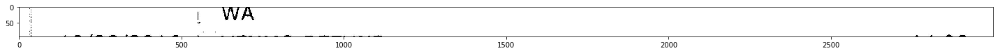

10/20/2010 I VENMO REFUND L14.UU
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2010, 10, 20), None, ' I VENMO REFUND L14.UU']


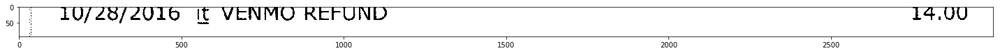

10/28/2016 it VENMO REFUND 14.00
Adjusting Window
[None, 14.0, ' it VENMO REFUND']


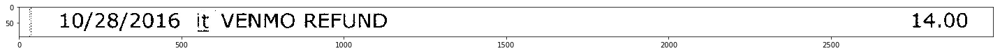

10/28/2016 it VENMO REFUND 14.00
[datetime.date(2016, 10, 28), 14.0, ' it VENMO REFUND']


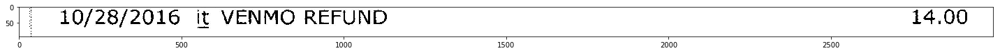

10/24/2016

NON-CHASE ATM FEE-

-2.50
[datetime.date(2016, 10, 24), -2.5, '\n\nNON-CHASE ATM FEE-\n\n']


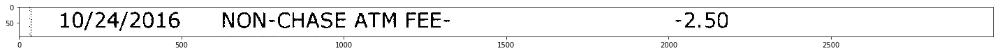

WITHAIERN: O71
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'WITHAIERN: O71']


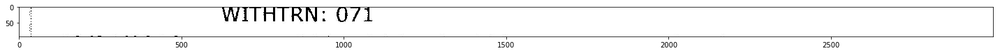

WITHTRN: O71
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'WITHTRN: O71']


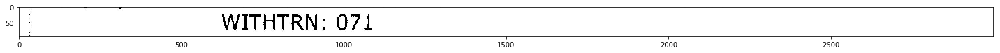

WITHTRN: O71
Amount was not detected, re-attempting by removing commas
[None, None, 'WITHTRN: O71']


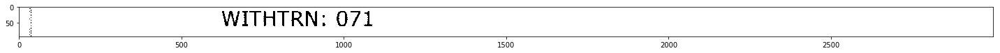

10/24/2016 VZWRLSS*APOCC VISN 800- -107.42
[datetime.date(2016, 10, 24), -107.42, ' VZWRLSS*APOCC VISN 800- ']


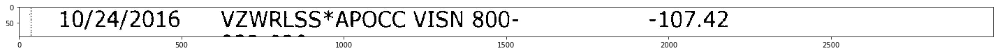

| DeézZ-UZLZ0
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| DeézZ-UZLZ0']


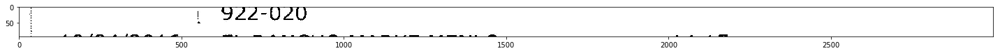

| 922-020
Adjusting Window
[None, None, '|']


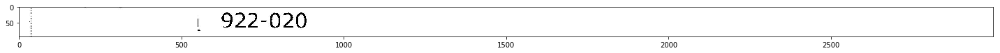

| 922-020
[None, None, '|']


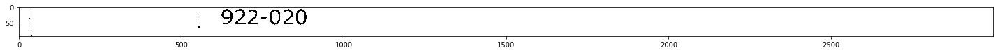

10/24/2016 EL RANCHO MARKE MENLO -14.15

ARF 1fF 6F™ A
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 10, 24), None, ' EL RANCHO MARKE MENLO -14.15\n\nARF 1fF 6F™ A']


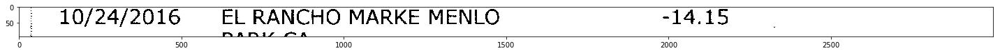

10/24/2016 EL RANCHO MARKE MENLO -14.15
[datetime.date(2016, 10, 24), -14.15, ' EL RANCHO MARKE MENLO ']


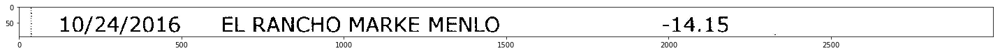

i PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'i PARK CA']


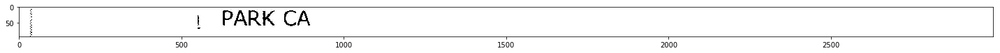

-





Sue 645

PARK CA

_

 

of 22

a te:

i

>

>

_
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '-\n\n\n\n\n\nSue 645\n\nPARK CA\n\n_\n\n \n\nof 22\n\na te:\n\ni\n\n>\n\n>\n\n_']


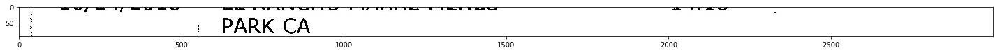

| PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| PARK CA']


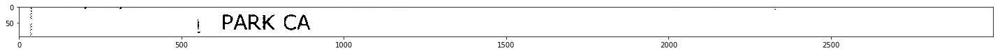

| PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, '| PARK CA']


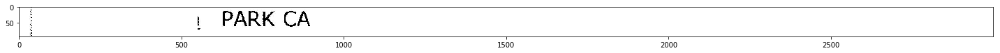

10/24/2016 NON-CHASE ATM WITHDRAW -162.99
[datetime.date(2016, 10, 24), -162.99, ' NON-CHASE ATM WITHDRAW ']


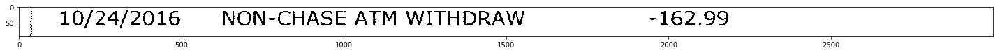

10/24/2016 WILLOW COVE GAS MENLO -7.19

a ae
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 10, 24), None, ' WILLOW COVE GAS MENLO -7.19\n\na ae']


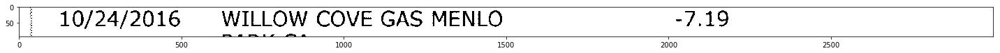

10/24/2016 WILLOW COVE GAS MENLO -7.19
[datetime.date(2016, 10, 24), -7.19, ' WILLOW COVE GAS MENLO ']


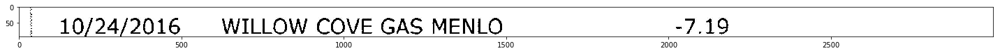

| PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| PARK CA']


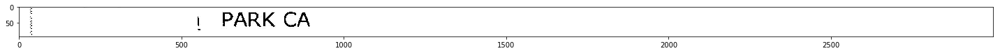

ef me TE

eV saw

I

PARK CA

ee

Be
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ef me TE\n\neV saw\n\nI\n\nPARK CA\n\nee\n\nBe']


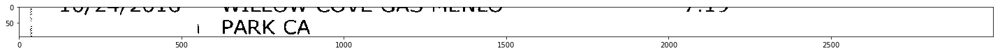

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


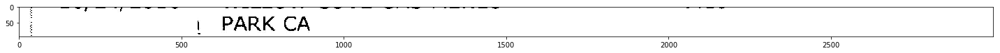

1 PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '1 PARK CA']


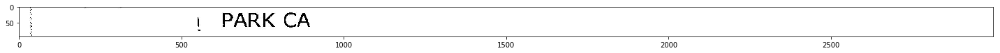

1 PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, '1 PARK CA']


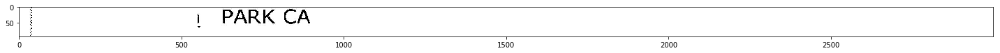

10/24/2016 AMAZON MKTPLACE PMTS -17.91

nRa“»n it s/™ 7% BB
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 10, 24), None, ' AMAZON MKTPLACE PMTS -17.91\n\nnRa“»n it s/™ 7% BB']


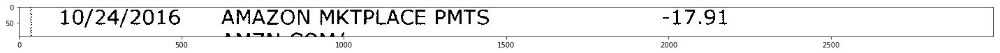

10/24/2016 AMAZON MKTPLACE PMTS -17.91
[datetime.date(2016, 10, 24), -17.91, ' AMAZON MKTPLACE PMTS ']


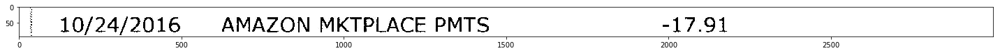

| AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| AMZN.COM/']


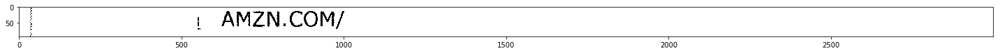

 ~~ SS 37 Se Se UU Ee ee eee UU

1 AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, ' -- SS 37 Se Se UU Ee ee eee UU\n\n1 AMZN.COM/']


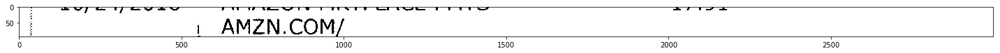

| AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| AMZN.COM/']


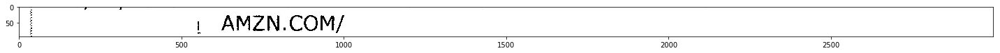

| AMZN.COM/
Amount was not detected, re-attempting by removing commas
[None, None, '| AMZN.COM/']


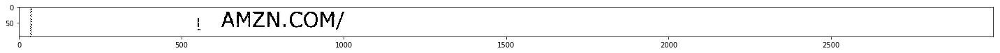

10/24/2016 Online Transfer from SAV ...03 100.00
[datetime.date(2016, 10, 24), 100.0, ' Online Transfer from SAV ...03']


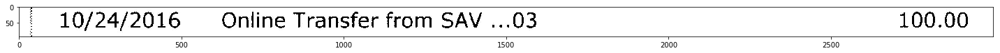


Amount was not detected, re-attempting by removing commas
[None, None, '']


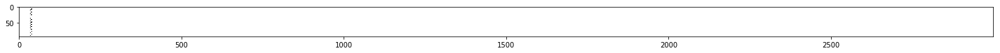

Almiusear
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Almiusear']


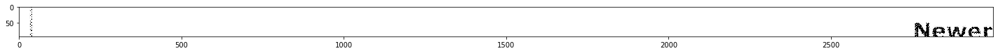


Amount was not detected, re-attempting by removing commas
[None, None, '']


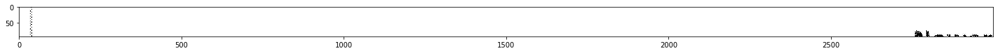

ea V¥ EE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ea V¥ EE']


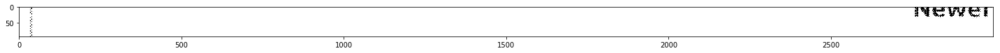

Newer
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Newer']


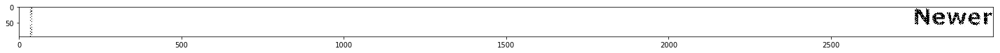

New
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'New']


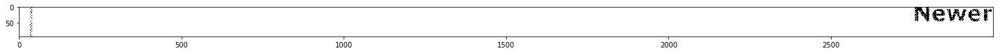

Pak vv
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Pak vv']


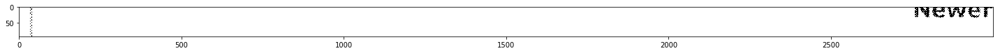

BOR ae BS Nx F
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'BOR ae BS Nx F']


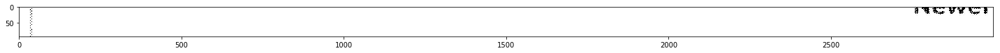


Amount was not detected, re-attempting by removing commas
[None, None, '']


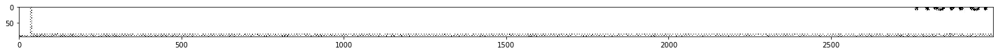

Image (41).jpg
10/24/2016 Online Transfer from SAV ...03 350.00
[datetime.date(2016, 10, 24), 350.0, ' Online Transfer from SAV ...03']


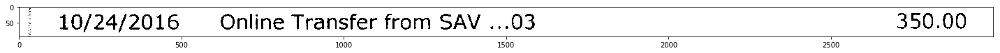


Amount was not detected, re-attempting by removing commas
[None, None, '']


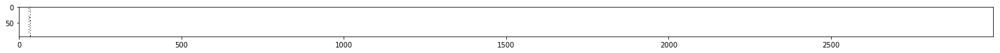

10/21/2016 EL RANCHO MARKE MENLO -27.06

m™ A FRNIZFT OS™ A
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 10, 21), None, ' EL RANCHO MARKE MENLO -27.06\n\nm™ A FRNIZFT OS™ A']


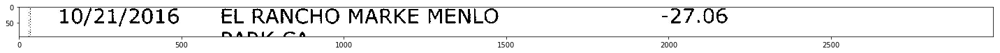

10/21/2016 EL RANCHO MARKE MENLO -27.06
[datetime.date(2016, 10, 21), -27.06, ' EL RANCHO MARKE MENLO ']


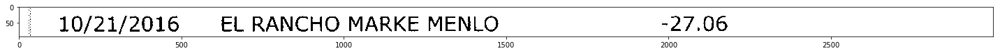

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


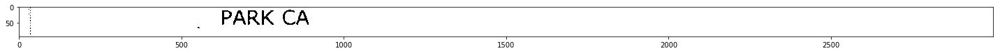

 eS

_
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, ' eS\n\n_']


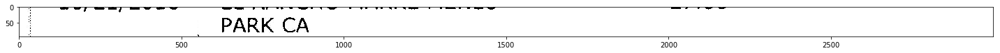

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


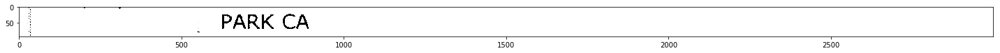

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


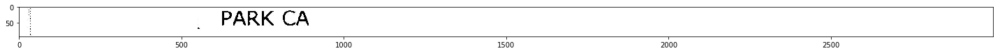

10/21/2016 WILLOW COVE GAS MENLO -20.02
[datetime.date(2016, 10, 21), -20.02, ' WILLOW COVE GAS MENLO ']


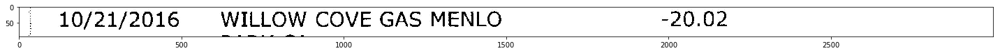

PAKK CA

meet ome Ge ae scones a one
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PAKK CA\n\nmeet ome Ge ae scones a one']


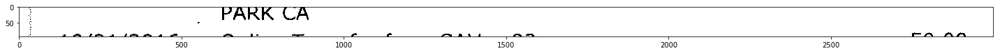

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


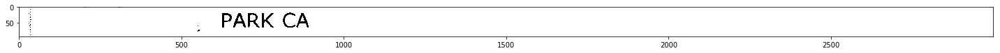

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


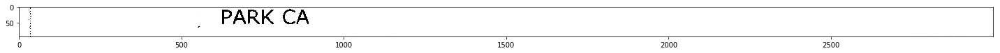

10/21/2016 Online Transfer from SAV ...03 50.00
[datetime.date(2016, 10, 21), 50.0, ' Online Transfer from SAV ...03']


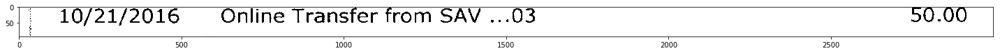

@q@ fa £4 ft ITO rT. 4a Of fr rm AAT SOW) EeG.![LCUCUCRR ALC ACL ZS O.hUrRL APT AEE UOT 7~™,
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '@q@ fa £4 ft ITO rT. 4a Of fr rm AAT SOW) EeG.![LCUCUCRR ALC ACL ZS O.hUrRL APT AEE UOT 7~™,']


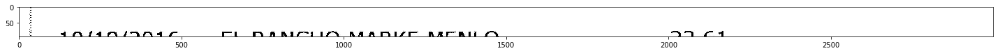


Amount was not detected, re-attempting by removing commas
[None, None, '']


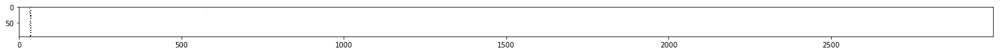

10/19/2016 EL RANCHO MARKE MENLO -22.61

-mrPmesasrlUrP™ A
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 10, 19), None, ' EL RANCHO MARKE MENLO -22.61\n\n-mrPmesasrlUrP™ A']


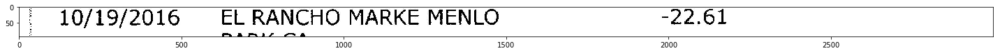

10/19/2016 EL RANCHO MARKE MENLO -22.61
[datetime.date(2016, 10, 19), -22.61, ' EL RANCHO MARKE MENLO ']


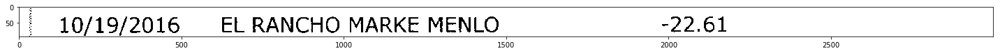

. PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '. PARK CA']


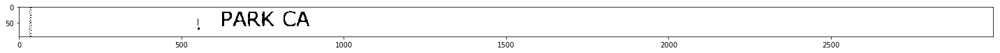

GNF FE ee F

PARK CA

[_

AS S Ses

‘ue t

_T

ane

-_
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'GNF FE ee F\n\nPARK CA\n\n[_\n\nAS S Ses\n\n‘ue t\n\n_T\n\nane\n\n-_']


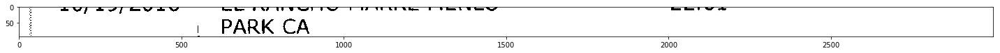

PARK CA |
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA |']


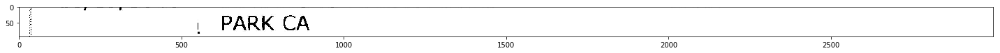

| PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| PARK CA']


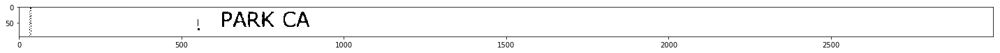

| PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, '| PARK CA']


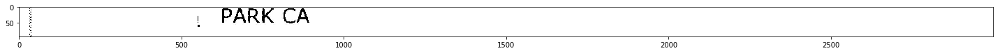

10/19/2016 A &S 76 MENLO PARK CA “4.11
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 10, 19), None, ' A &S 76 MENLO PARK CA “4.11']


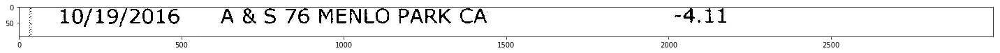

10/19/2016 A&S 76 MENLO PARK CA -4.11
[datetime.date(2016, 10, 19), -4.11, ' A&S 76 MENLO PARK CA ']


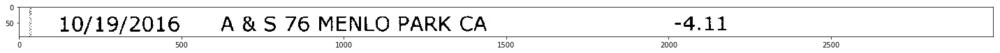


Amount was not detected, re-attempting by removing commas
[None, None, '']


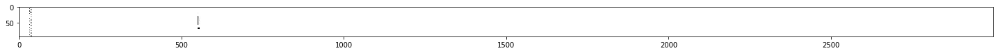

10/19/2016 TARGET T- 2485 El Cam -10.48
[datetime.date(2016, 10, 19), -10.48, ' TARGET T- 2485 El Cam ']


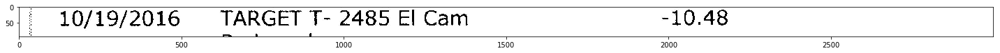

a ee OS ae 4k Se Ce

Keadwood

ko a ee

sa em np . 2 OP Pe
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'a ee OS ae 4k Se Ce\n\nKeadwood\n\nko a ee\n\nsa em np . 2 OP Pe']


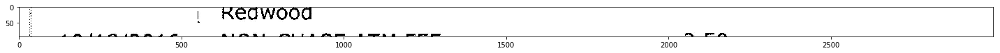

| Redwood
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| Redwood']


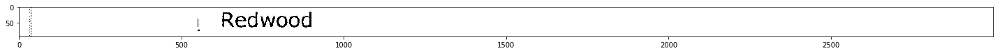

| Redwood
Amount was not detected, re-attempting by removing commas
[None, None, '| Redwood']


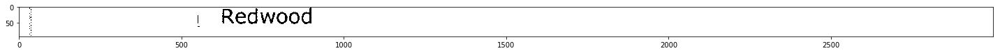

10/18/2016 NON- CHASE ATM FEE- -2,50

~_ rr mm
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 10, 18), None, ' NON- CHASE ATM FEE- -2,50\n\n~_ rr mm']


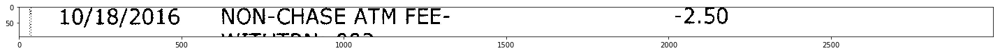

10/18/2016 © NON-CHASE ATM FEE- -2.50
[datetime.date(2016, 10, 18), -2.5, ' © NON-CHASE ATM FEE- ']


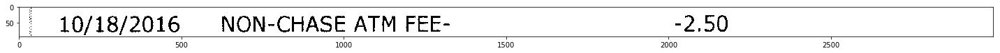

WITHTRN: 003
Adjusting Window
[None, 3.0, 'WITHTRN:']


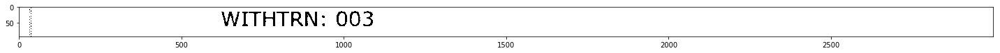

ee NEE EEE ae

WITHTRN: 003
Adjusting Window
[None, 3.0, 'ee NEE EEE ae\n\nWITHTRN:']


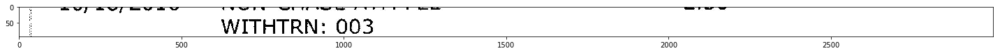

WITHTRN: 003
Adjusting Window
[None, 3.0, 'WITHTRN:']


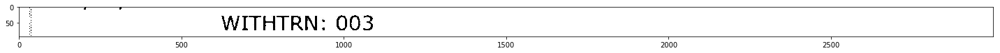

WITHTRN: 003
[None, 3.0, 'WITHTRN:']


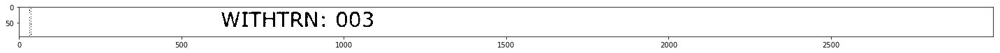

10/18/2016 A&S 76 MENLO PARK CA -4.31
[datetime.date(2016, 10, 18), -4.31, ' A&S 76 MENLO PARK CA ']


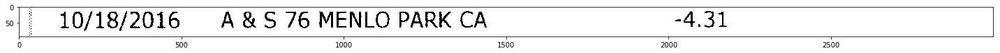


Amount was not detected, re-attempting by removing commas
[None, None, '']


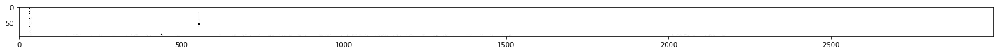

10/18/2016 JAE UPS STORE#O105 PALO ~ Loo w2 db

A’ TOY. ~
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 10, 18), None, ' JAE UPS STORE#O105 PALO ~ Loo w2 db\n\nA’ TOY. ~']


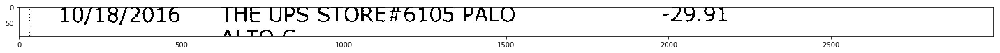

10/18/2016 THE UPS STORE#6105 PALO -29.91
[datetime.date(2016, 10, 18), -29.91, ' THE UPS STORE#6105 PALO ']


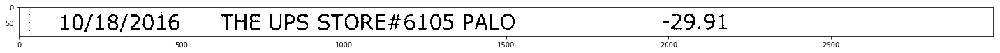


Amount was not detected, re-attempting by removing commas
[None, None, '']


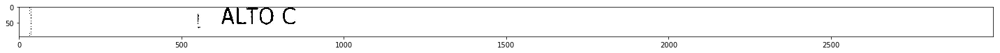

10/18/2016 NON-CHASE ATM WITHDRAW ~43.00
[datetime.date(2016, 10, 18), -43.0, ' NON-CHASE ATM WITHDRAW ~43.00']


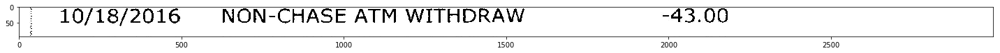

10/17/2016 EL RANCHO MARKE MENLO -61.59

MmaArii17 /™ A
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 10, 17), None, ' EL RANCHO MARKE MENLO -61.59\n\nMmaArii17 /™ A']


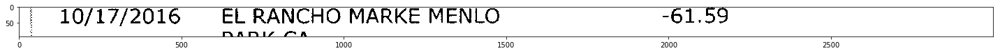

10/17/2016 EL RANCHO MARKE MENLO -61.59
[datetime.date(2016, 10, 17), -61.59, ' EL RANCHO MARKE MENLO ']


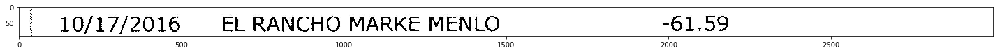

1 PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '1 PARK CA']


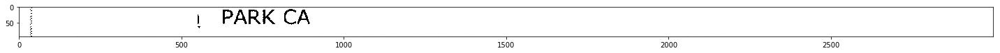

ee em  IESE Ee Te: SSeS See: Sees: | Es ee REY RR eS Rees ER nenscers Hane ea aes Re Cae Me

. PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee em  IESE Ee Te: SSeS See: Sees: | Es ee REY RR eS Rees ER nenscers Hane ea aes Re Cae Me\n\n. PARK CA']


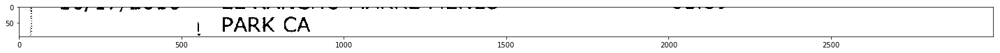

1 PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '1 PARK CA']


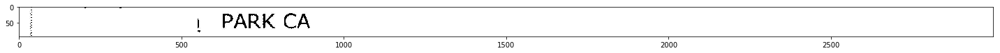

1 PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, '1 PARK CA']


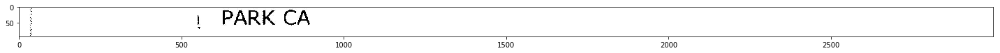

10/17/2016 SQ *CAKE CREATIONS BAKE -12.02
[datetime.date(2016, 10, 17), -12.02, ' SQ *CAKE CREATIONS BAKE ']


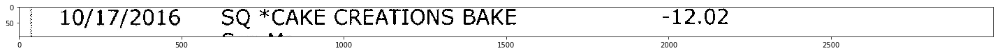

: 1 oan

en ~~ nm m™ opnmiss m@™m maepmpntxneans wee Fe sel el lUlUrel “~~~ ~~ mm
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, ': 1 oan\n\nen -- nm m™ opnmiss m@™m maepmpntxneans wee Fe sel el lUlUrel “--- -- mm']


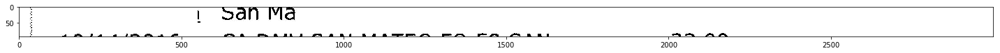

San Ma
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'San Ma']


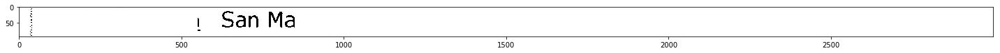

San Ma
Amount was not detected, re-attempting by removing commas
[None, None, 'San Ma']


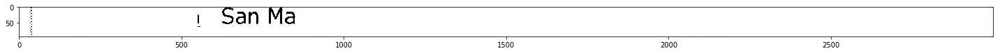

10/14/2016 CA DMV SAN MATEO FO 59 SAN -33.00

RAAT”
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 10, 14), None, ' CA DMV SAN MATEO FO 59 SAN -33.00\n\nRAAT”']


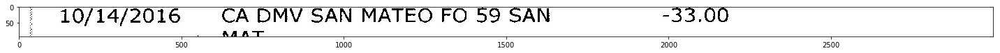

10/14/2016 CA DMV SAN MATEO FO 59 SAN -33.00
[datetime.date(2016, 10, 14), -33.0, ' CA DMV SAN MATEO FO 59 SAN ']


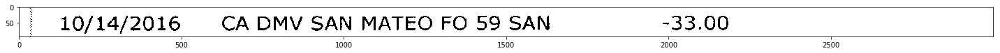

MAT
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MAT']


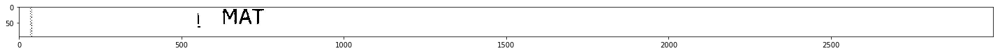


Amount was not detected, re-attempting by removing commas
[None, None, '']


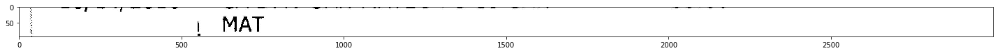

10/13/2016 Amazon.com AMZN.COM/BILL -16.35
[datetime.date(2016, 10, 13), -16.35, ' Amazon.com AMZN.COM/BILL ']


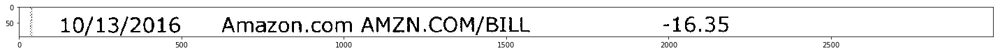

WA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'WA']


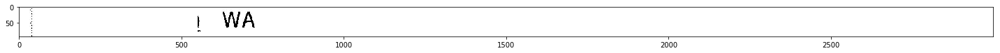

; eS ee Se PRE Se ae ee eee eee _ ere a ee

i WA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '; eS ee Se PRE Se ae ee eee eee _ ere a ee\n\ni WA']


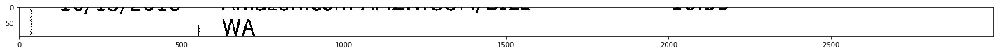

WA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'WA']


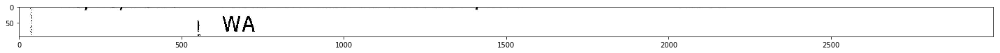

WA
Amount was not detected, re-attempting by removing commas
[None, None, 'WA']


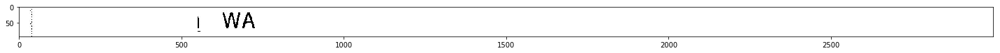

10/11/2016 TARGET T- 2220 Bridgep San -59.40
[datetime.date(2016, 10, 11), -59.4, ' TARGET T- 2220 Bridgep San ']


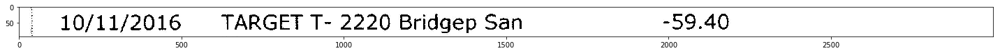

Mat
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Mat']


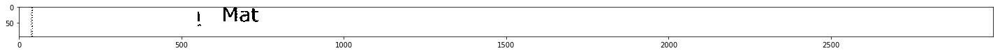


Amount was not detected, re-attempting by removing commas
[None, None, '']


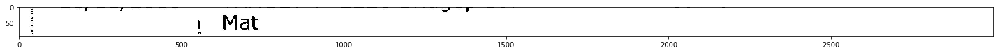

BS wee ees we we
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'BS wee ees we we']


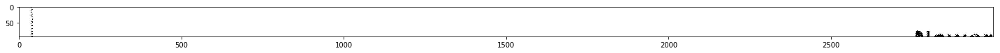


Amount was not detected, re-attempting by removing commas
[None, None, '']


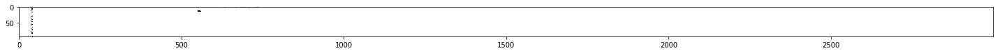

Image (42).jpg
10/07/2016 ADY*JetbrainsUSD -5.90
[datetime.date(2016, 10, 7), -5.9, ' ADY*JetbrainsUSD ']


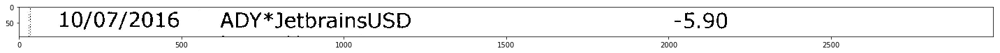

nttps://www.j
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'nttps://www.j']


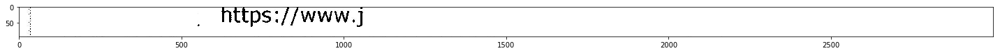

https://www.]j
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'https://www.]j']


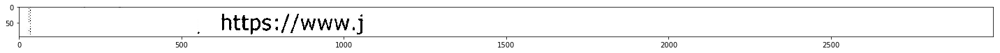

https ://www.]j
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'https ://www.]j']


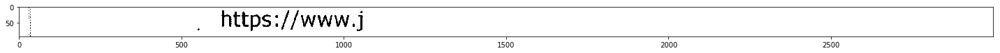

nttps://www.j
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'nttps://www.j']


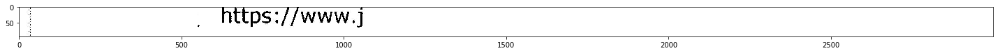

2s a co a eo a ue

PEEPS / WWW.)

eS se ae
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '2s a co a eo a ue\n\nPEEPS / WWW.)\n\neS se ae']


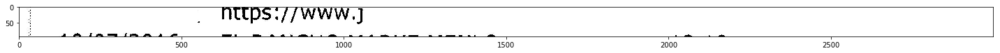

fF FUL. 7 WV. J

4 nina fara T“r PA ARDS IL ISO. CURA A PRI ZO OR APTA OST any 4a
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'fF FUL. 7 WV. J\n\n4 nina fara T“r PA ARDS IL ISO. CURA A PRI ZO OR APTA OST any 4a']


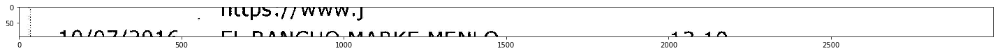

PEM i VY YV VY J

£N /OA7/9J0AIE Cl DANISLUC, MADIUVE MEANII SY 49 4fh
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PEM i VY YV VY J\n\n£N /OA7/9J0AIE Cl DANISLUC, MADIUVE MEANII SY 49 4fh']


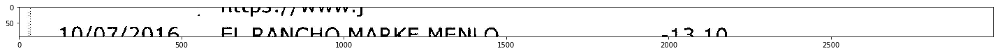

ee eh

10/07/7016 FL RANCHO MARKF MENI(N -12 10
Adjusting Window
[None, -12.1, 'ee eh\n\n FL RANCHO MARKF MENI(N ']


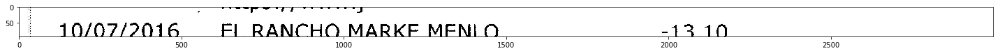

10/07/2016 EL RANCHO MARKE MENLO -13.10
[datetime.date(2016, 10, 7), -13.1, ' EL RANCHO MARKE MENLO ']


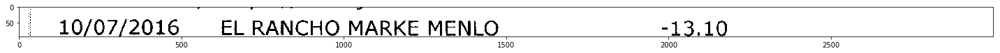

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


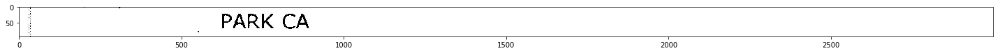

mew WES eV AY ewe hee ENN NE EN OLA NVUNENG Ff PLL LAY a ed

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'mew WES eV AY ewe hee ENN NE EN OLA NVUNENG Ff PLL LAY a ed\n\nPARK CA']


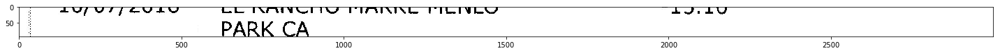

OE

ee ee EE eee ee UR Ee ee

PARK CA

s © Geet

a

 a

1 -
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'OE\n\nee ee EE eee ee UR Ee ee\n\nPARK CA\n\ns © Geet\n\na\n\n a\n\n1 -']


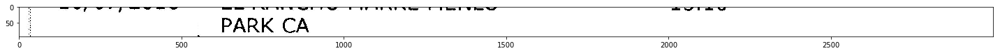

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


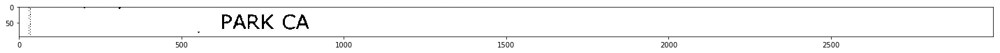

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


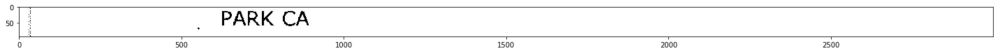

10/06/2016 PENINSULA FAMILY YMCA 650- -32.00

~:~ ™ ~
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 10, 6), None, ' PENINSULA FAMILY YMCA 650- -32.00\n\n~:~ ™ ~']


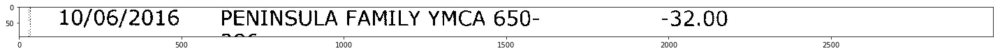

10/06/2016 | PENINSULA FAMILY YMCA 650- -32.00
[datetime.date(2016, 10, 6), -32.0, ' | PENINSULA FAMILY YMCA 650- ']


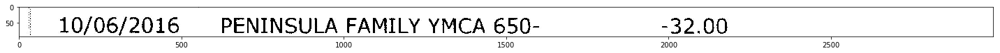

286-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '286-']


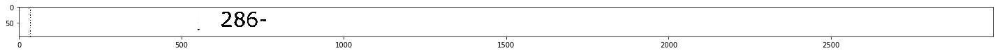

at fT ow NS ee oe FD er A Ee AOE UP AE Et BOD Ne ed ww Get AY
I -
286
Adjusting Window
[None, 286.0, 'at fT ow NS ee oe FD er A Ee AOE UP AE Et BOD Ne ed ww Get AY\nI -']


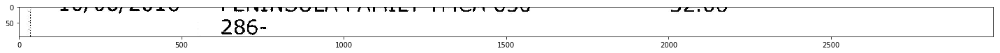


Amount was not detected, re-attempting by removing commas
[None, None, '']


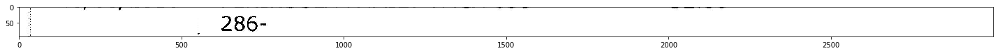

10/05/2016 UBER *US OCT04 65ST 866- -9,.99
Amount was not detected, re-attempting by removing commas
[datetime.date(2016, 10, 5), -9.99, ' UBER *US OCT04 65ST 866- -9,.99']


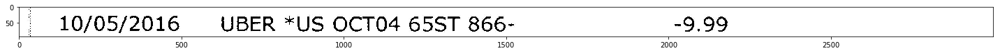

576-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '576-']


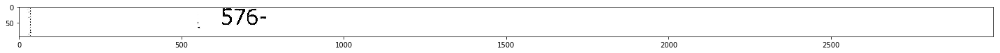

ee Me caer Se romiees peers Berd Sameer ee ee oe eS ee TO SOO a a CU  ee See me

576-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee Me caer Se romiees peers Berd Sameer ee ee oe eS ee TO SOO a a CU  ee See me\n\n576-']


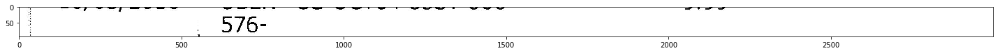

|

576-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '|\n\n576-']


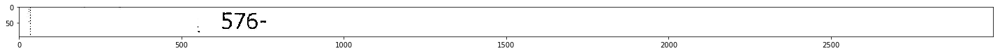

576-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '576-']


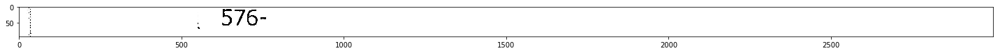

2/0-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '2/0-']


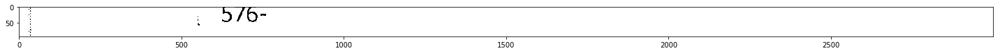

ee ee ee ne el

J/0-

manna  s mo sf

hms nein sp

aged

ama spe
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee ee ee ne el\n\nJ/0-\n\nmanna  s mo sf\n\nhms nein sp\n\naged\n\nama spe']


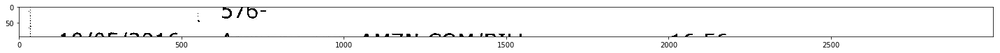

5 A PN

NV (AC (Onto DA omer we lem. A RAMTZTAL STMSCANAA /TOTE I gf Tre
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '5 A PN\n\nNV (AC (Onto DA omer we lem. A RAMTZTAL STMSCANAA /TOTE I gf Tre']


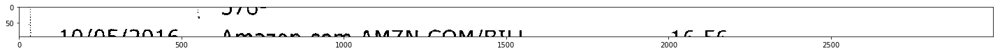

A

TON/NE/INIVTE Amasznn rnm AMTAI COM/RTI ! _1jea4 RQ
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'A\n\nTON/NE/INIVTE Amasznn rnm AMTAI COM/RTI ! _1jea4 RQ']


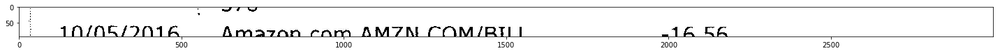

1N/N05/0016 Amazon com AMZN COM/RITI! -16 56
Adjusting Window
[None, -16.56, '1N/N05/0016 Amazon com AMZN COM/RITI! ']


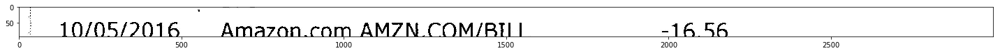

10/05/2016 | Amazon.com AMZN.COM/BILL -16.56
[datetime.date(2016, 10, 5), -16.56, ' | Amazon.com AMZN.COM/BILL ']


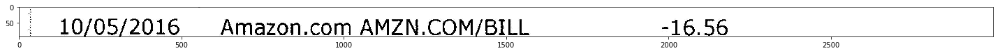

WA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'WA']


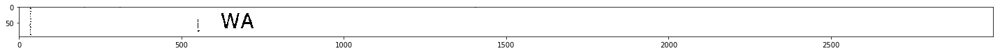

eV Vw fp COWL FANTETQRAP eI FN TALE e AYE TG LLL oh Ne

| WA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'eV Vw fp COWL FANTETQRAP eI FN TALE e AYE TG LLL oh Ne\n\n| WA']


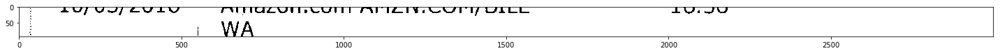

ee ee ee ee, ee ee ee eee oe eS a ee oe ae ee ee: el ee a ee: _ ee ee ee

WA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee ee ee ee, ee ee ee eee oe eS a ee oe ae ee ee: el ee a ee: _ ee ee ee\n\nWA']


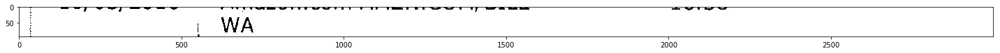

WA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'WA']


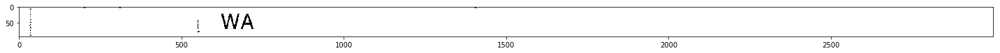


Amount was not detected, re-attempting by removing commas
[None, None, '']


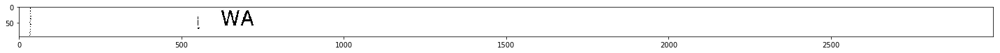

10/04/2016 EL RANCHO MARKE MENLO -14.92

a ‘eet Se || a:
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 10, 4), None, ' EL RANCHO MARKE MENLO -14.92\n\na ‘eet Se || a:']


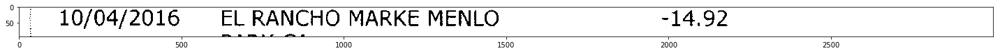

10/04/2016 | EL RANCHO MARKE MENLO -14,92
, istead of . was detected, chainging
[datetime.date(2016, 10, 4), -14.92, ' | EL RANCHO MARKE MENLO ']


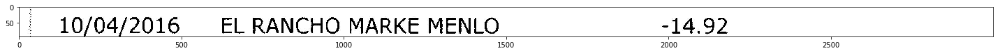

| PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| PARK CA']


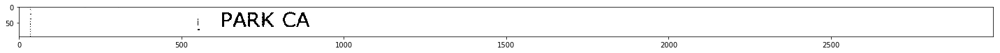

ON a Nt le Pe ee ENE OZ UE NN FU Oe a 8 ew hee

i PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ON a Nt le Pe ee ENE OZ UE NN FU Oe a 8 ew hee\n\ni PARK CA']


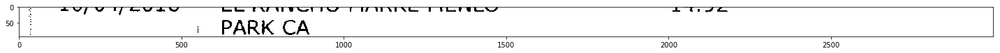

| PARKCA  ”
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| PARKCA  ”']


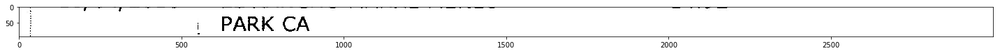

| PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| PARK CA']


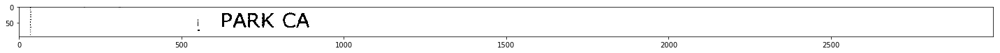

| PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, '| PARK CA']


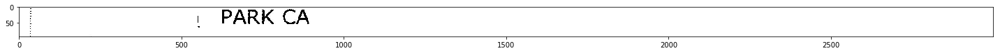

10/04/2016 Amazon.com AMZN.COM/BILL -14.12
[datetime.date(2016, 10, 4), -14.12, ' Amazon.com AMZN.COM/BILL ']


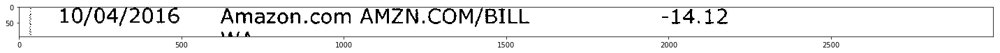

| VVA

qr irl AOI Tr + Of” rRFRiAscrarre fm rm@ 4 TPR A) US| Ut COTO!!ULCUr™ PFO UT COATS! OURS gg ~*~ T
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| VVA\n\nqr irl AOI Tr + Of” rRFRiAscrarre fm rm@ 4 TPR A) US| Ut COTO!!ULCUr™ PFO UT COATS! OURS gg ~*~ T']


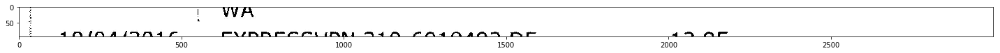


Amount was not detected, re-attempting by removing commas
[None, None, '']


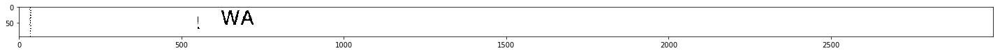

10/04/2016 EXPRESSVPN 310-6018492 DE -12.95
[datetime.date(2016, 10, 4), -12.95, ' EXPRESSVPN 310-6018492 DE ']


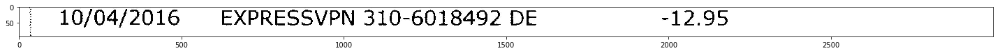

a a a a rs
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'a a a a rs']


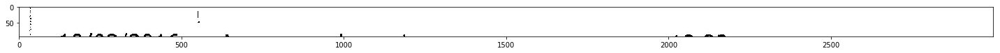


Amount was not detected, re-attempting by removing commas
[None, None, '']


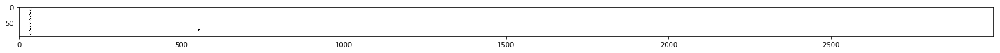

10/03/2016 Amazon web services -13.32
[datetime.date(2016, 10, 3), -13.32, ' Amazon web services ']


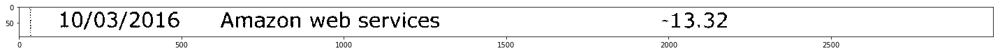

| aws.amazon
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| aws.amazon']


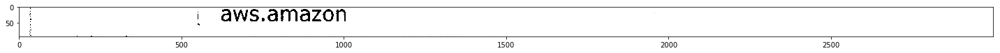

| aws.amazon
Amount was not detected, re-attempting by removing commas
[None, None, '| aws.amazon']


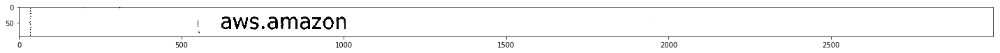

10/03/2016 EL RANCHO MARKE MENLO -11.26
[datetime.date(2016, 10, 3), -11.26, ' EL RANCHO MARKE MENLO ']


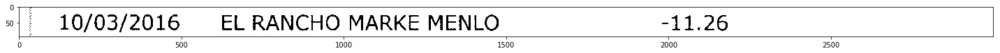

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


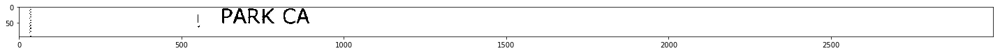

RR EEE ERIE ERO n tie

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'RR EEE ERIE ERO n tie\n\nPARK CA']


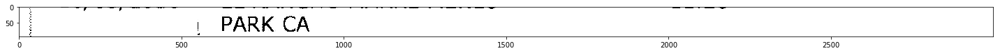

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


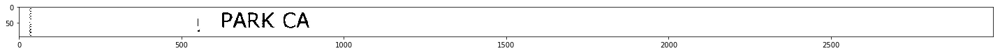

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


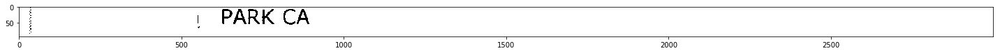

10/03/2016 SQ *CHARLES SANDMAN 877- -18.00
[datetime.date(2016, 10, 3), -18.0, ' SQ *CHARLES SANDMAN 877- ']


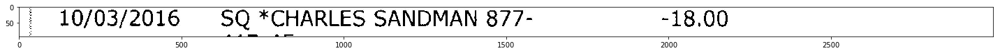

ee ee ee ee a as
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee ee ee ee a as']


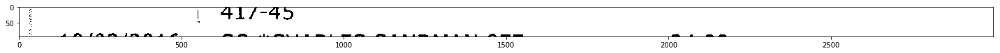

|

417-45
Adjusting Window
[None, None, '|\n']


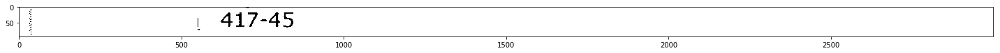

|

417-45
[None, None, '|\n']


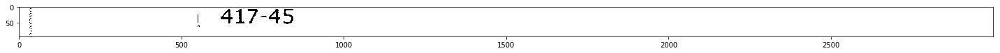

10/03/2016 SQ “CHARLES SANDMAN 877- -24.00

Aw rs A
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 10, 3), None, ' SQ “CHARLES SANDMAN 877- -24.00\n\nAw rs A']


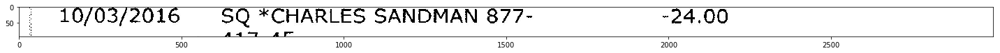

10/03/2016 SQ *CHARLES SANDMAN 877- -24.00
[datetime.date(2016, 10, 3), -24.0, ' SQ *CHARLES SANDMAN 877- ']


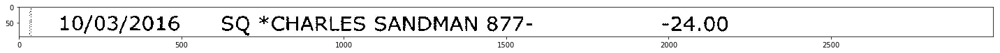

417-45
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '417-45']


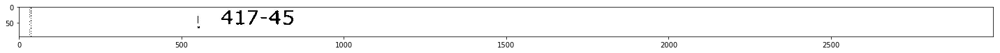

tei ee See
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'tei ee See']


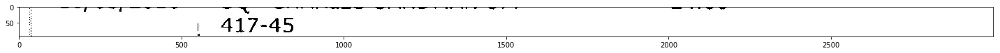

417-45
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '417-45']


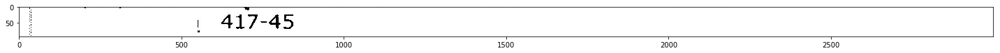

417-45
Amount was not detected, re-attempting by removing commas
[None, None, '417-45']


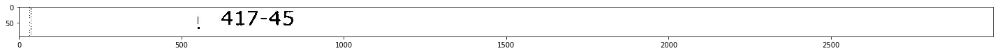

10/03/2016 it FIRSTMERIT BANK TRANSFER
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 10, 3), None, ' it FIRSTMERIT BANK TRANSFER']


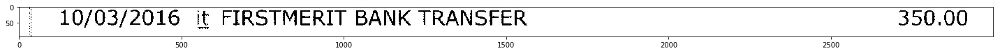

10/03/2016 it FIRSTMERIT BANK TRANSFER 350.00
[datetime.date(2016, 10, 3), 350.0, ' it FIRSTMERIT BANK TRANSFER']


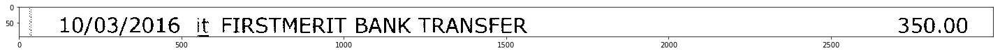

09/29/2016 Dropbox*WM714GXHCSVG -9.99
[datetime.date(2016, 9, 29), -9.99, ' Dropbox*WM714GXHCSVG ']


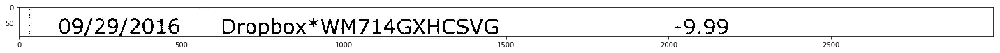

| db.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| db.tt/cch']


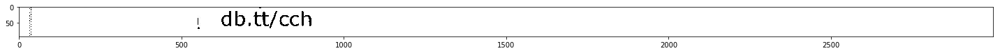

Nf tf ho Af eS NW wee ew WV tf Bf PNA Pee WY NY wD tt et

1 db.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Nf tf ho Af eS NW wee ew WV tf Bf PNA Pee WY NY wD tt et\n\n1 db.tt/cch']


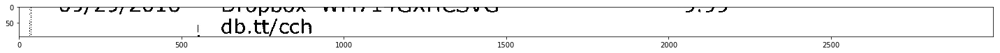

EEE IE EO ee

] db. tt/cch -
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'EEE IE EO ee\n\n] db. tt/cch -']


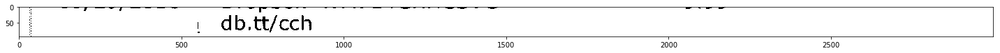

| db.tt/ech
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| db.tt/ech']


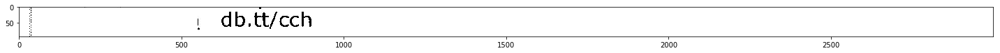

| db.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| db.tt/cch']


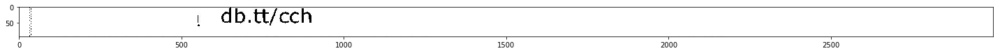

Simi cies gpa rc

ab.tt/ccn

ee ee tea

Pe ee ee ee ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Simi cies gpa rc\n\nab.tt/ccn\n\nee ee tea\n\nPe ee ee ee ee']


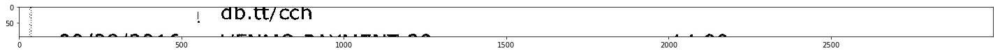

Pf Ob. CO

fr AO 1A KnKAs VLsIOAmR IA ASR PSLRA NSA ATTRA Ie OCT 4a frrfTr
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Pf Ob. CO\n\nfr AO 1A KnKAs VLsIOAmR IA ASR PSLRA NSA ATTRA Ie OCT 4a frrfTr']


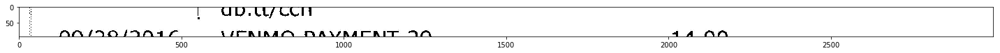

' Mb Ay ww

NoO/9eQ/9InNAkK \/EZAIANAC\Y DAVMENAIT JO 4A Vn
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, "' Mb Ay ww\n\nNoO/9eQ/9InNAkK \\/EZAIANAC\\Y DAVMENAIT JO 4A Vn"]


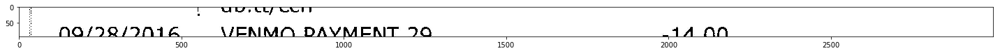

ee

NO/JIRIINIG VENMYQA PAYMENT 2329 -14 00
Adjusting Window
[None, -14.0, 'ee\n\nNO/JIRIINIG VENMYQA PAYMENT 2329 ']


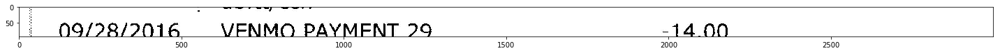

09/28/2016 VENMO PAYMENT 29 -14.00
[datetime.date(2016, 9, 28), -14.0, ' VENMO PAYMENT 29 ']


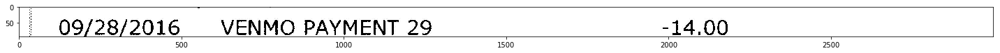

09/97/7016 STFAMGAMES CQOM4275952799 -5 JA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, ' STFAMGAMES CQOM4275952799 -5 JA']


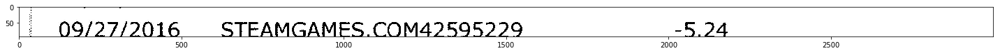

WAf eV] eV AY WheENP IN FPN TE TLE a an ee a

HAV (a7 /Or4a se CC" Tr” AAAS™ ARAL C™ S"™SCRAAADYDQOHO COD lm “A
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'WAf eV] eV AY WheENP IN FPN TE TLE a an ee a\n\nHAV (a7 /Or4a se CC- Tr” AAAS™ ARAL C™ S-™SCRAAADYDQOHO COD lm “A']


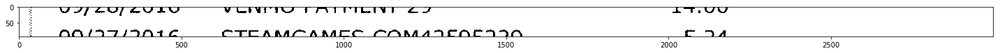

NO/IT7/INWGA

SS ee RR OE aE a

QCTEAMMlAMEC COHMADRQRIIO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NO/IT7/INWGA\n\nSS ee RR OE aE a\n\nQCTEAMMlAMEC COHMADRQRIIO']


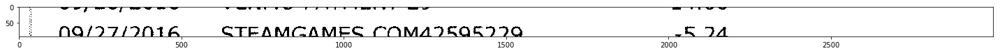

QO/IT/IN16 STFAMGAMES CQM4)595799 ~S JA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'QO/IT/IN16 STFAMGAMES CQM4)595799 ~S JA']


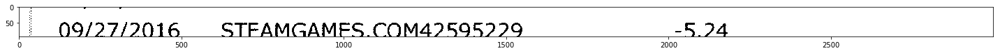

09/27/2016 STEAMGAMES.COM42595229 -5,24
, istead of . was detected, chainging
[datetime.date(2016, 9, 27), -5.24, ' STEAMGAMES.COM42595229 ']


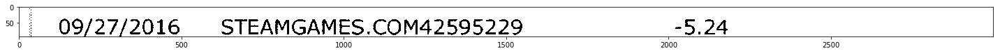

| 425-952
Adjusting Window
[None, None, '|']


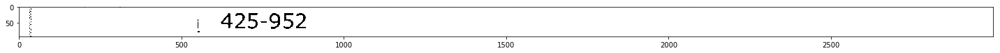

NF Af elf aL wet Eee OE ENON Db NET bee ed oe ee Gee ee

, 475-952
Adjusting Window
[None, None, 'NF Af elf aL wet Eee OE ENON Db NET bee ed oe ee Gee ee\n\n,']


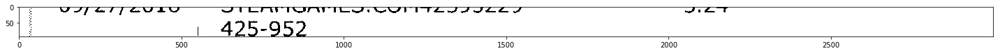

eee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'eee']


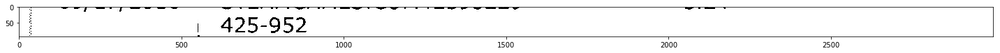

| 425-952
Adjusting Window
[None, None, '|']


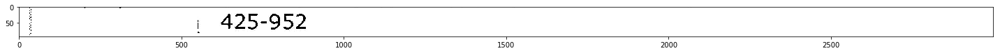

| 425-952
[None, None, '|']


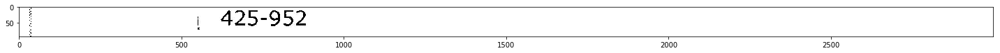

WG wus ke eo Be
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'WG wus ke eo Be']


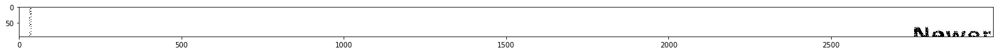


Amount was not detected, re-attempting by removing commas
[None, None, '']


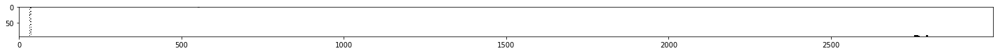

NOW
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NOW']


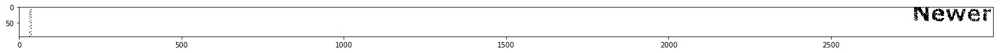

Newer
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Newer']


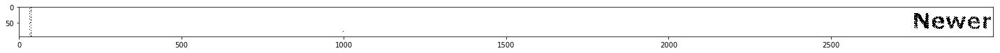

Newer
Amount was not detected, re-attempting by removing commas
[None, None, 'Newer']


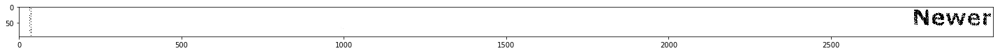

Image (43).jpg
09/07/2016 ADY*JetbrainsUSD -5.90
[datetime.date(2016, 9, 7), -5.9, ' ADY*JetbrainsUSD ']


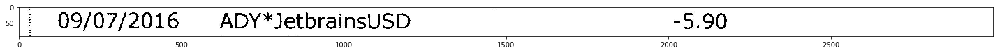

nttps://www.]
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'nttps://www.]']


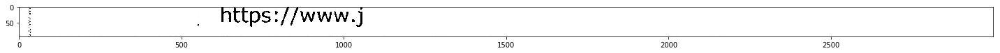

https://www.]j
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'https://www.]j']


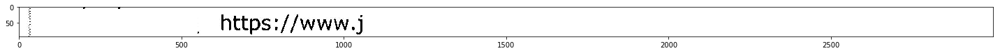

https://www.]j
Amount was not detected, re-attempting by removing commas
[None, None, 'https://www.]j']


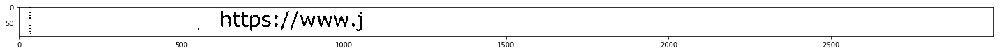

09/07/2016 SAFEWAY STORE 0970 SAN “29.93
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 9, 7), None, ' SAFEWAY STORE 0970 SAN “29.93']


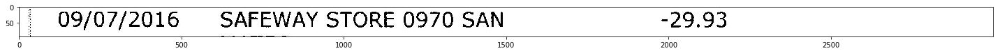

09/07/2016 SAFEWAY STORE 0970 SAN -29,93
, istead of . was detected, chainging
[datetime.date(2016, 9, 7), -29.93, ' SAFEWAY STORE 0970 SAN ']


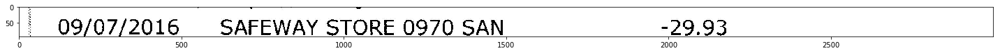

MATEO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MATEO']


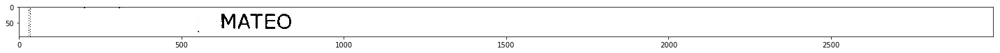

NP NE fF Ge Nd Ne ww EN bee VEE er ENN Ww EO NIN ee ad

MATEO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NP NE fF Ge Nd Ne ww EN bee VEE er ENN Ww EO NIN ee ad\n\nMATEO']


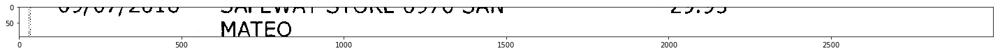

IPR Oe ae aa eM RRS SS ES

MATEO |
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'IPR Oe ae aa eM RRS SS ES\n\nMATEO |']


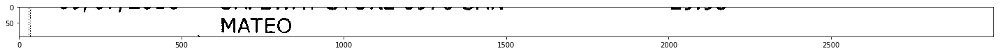

MATEO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MATEO']


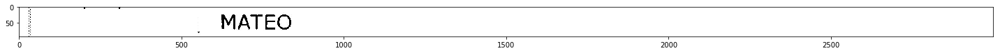

MATEO
Amount was not detected, re-attempting by removing commas
[None, None, 'MATEO']


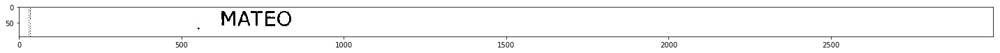

09/07/2016 Amazon.com AMZN.COM/BILL -13.08
[datetime.date(2016, 9, 7), -13.08, ' Amazon.com AMZN.COM/BILL ']


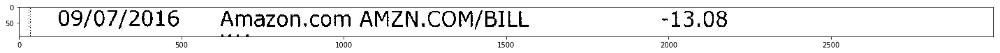

me ta me: ae ta
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'me ta me: ae ta']


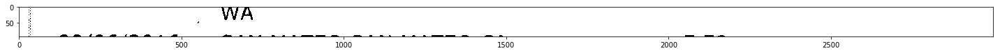

WA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'WA']


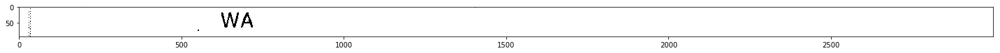


Amount was not detected, re-attempting by removing commas
[None, None, '']


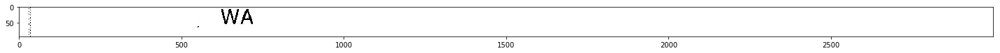

09/06/2016 SAN MATEO SAN MATEO CA -5.53
[datetime.date(2016, 9, 6), -5.53, ' SAN MATEO SAN MATEO CA ']


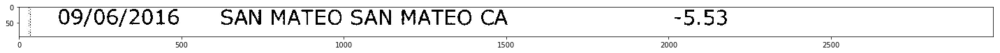

a ae a ee a a mmPrnanpwmam™ 3b 2h : «. w/e aa Ek | ee Ge cme ~ - ~ ~:~, reo me
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'a ae a ee a a mmPrnanpwmam™ 3b 2h : «. w/e aa Ek | ee Ge cme ~ - ~ ~:~, reo me']


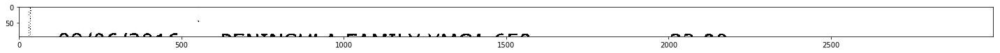


Amount was not detected, re-attempting by removing commas
[None, None, '']


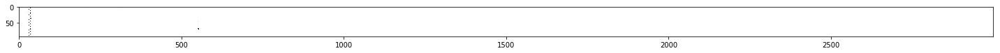

09/06/2016 PENINSULA FAMILY YMCA 650- -32.00

wi aii, ce
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 9, 6), None, ' PENINSULA FAMILY YMCA 650- -32.00\n\nwi aii, ce']


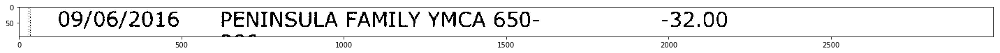

09/06/2016 PENINSULA FAMILY YMCA 650- -32.00
[datetime.date(2016, 9, 6), -32.0, ' PENINSULA FAMILY YMCA 650- ']


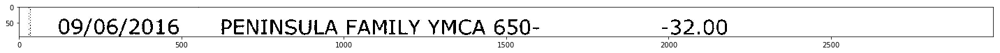

286-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '286-']


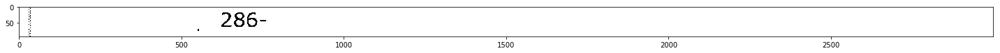

NA Af NINA f Ge NY ee ee ee oe Te ee TT ee ed

286-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NA Af NINA f Ge NY ee ee ee oe Te ee TT ee ed\n\n286-']


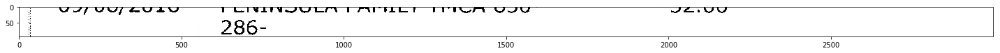

ee   < Eee i _e See eee “ee

 286-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee   < Eee i _e See eee “ee\n\n 286-']


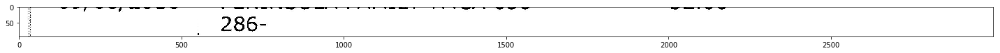

286-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '286-']


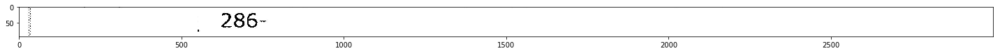

286-
Amount was not detected, re-attempting by removing commas
[None, None, '286-']


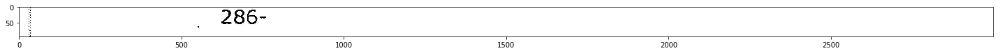

09/06/2016 CHIPOTLE 1617 PALO ALTO CA -10.06
[datetime.date(2016, 9, 6), -10.06, ' CHIPOTLE 1617 PALO ALTO CA ']


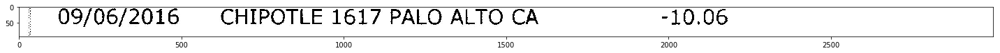

gre em FOP MO Tm, Mm AO , a a Ve a ee ae ae a de eee ee ae ee ee ae oe oe eee se ~!?,_ , ,
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'gre em FOP MO Tm, Mm AO , a a Ve a ee ae ae a de eee ee ae ee ee ae oe oe eee se ~!?,_ , ,']


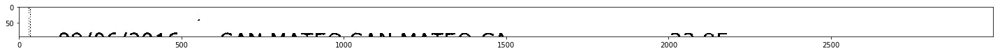


Amount was not detected, re-attempting by removing commas
[None, None, '']


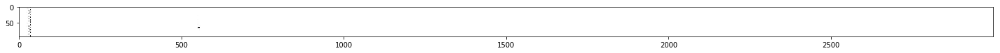

09/06/2016 SAN MATEO SAN MATEO CA -23.85
[datetime.date(2016, 9, 6), -23.85, ' SAN MATEO SAN MATEO CA ']


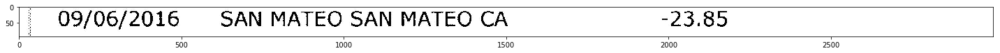

me mM FM ™ tome Mm LC ~~ en cK ki - < hee Ga see an kK a ze eC
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'me mM FM ™ tome Mm LC -- en cK ki - < hee Ga see an kK a ze eC']


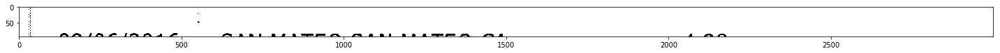


Amount was not detected, re-attempting by removing commas
[None, None, '']


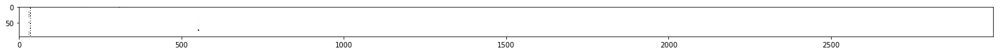

09/06/2016 SAN MATEO SAN MATEO CA -4,.98
Amount was not detected, re-attempting by removing commas
[datetime.date(2016, 9, 6), -4.98, ' SAN MATEO SAN MATEO CA -4,.98']


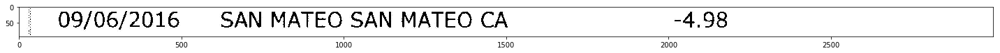


Amount was not detected, re-attempting by removing commas
[None, None, '']


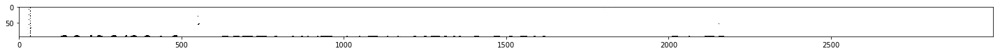

UI/UG/ZU16 PIZZA HUT 11/41 MENLO PARK -Z21.995
fA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'UI/UG/ZU16 PIZZA HUT 11/41 MENLO PARK -Z21.995\nfA']


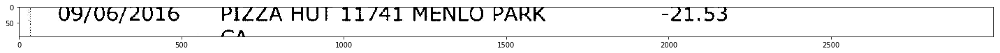

09/06/2016 PIZZA HUT 11741 MENLO PARK -21.53
[datetime.date(2016, 9, 6), -21.53, ' PIZZA HUT 11741 MENLO PARK ']


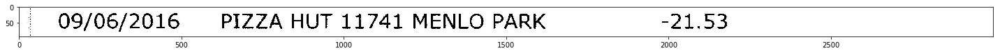


Amount was not detected, re-attempting by removing commas
[None, None, '']


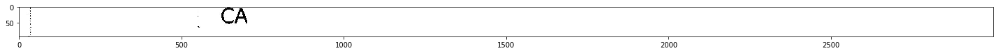

09/06/2016 Amazon web services -13.57
[datetime.date(2016, 9, 6), -13.57, ' Amazon web services ']


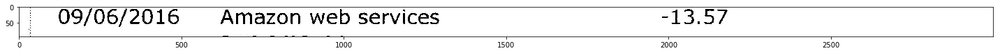

Pe Pe UEC Om OO CO

aws.dinlazor

r4 7 Oe es POL PRO LL

™/, 42 g™ ge ~™ 62 ™, fem -_-!, __

ee ee EE ed
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Pe Pe UEC Om OO CO\n\naws.dinlazor\n\nr4 7 Oe es POL PRO LL\n\n™/, 42 g™ ge ~™ 62 ™, fem -_-!, __\n\nee ee EE ed']


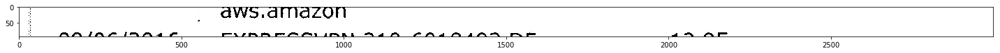

| aws.amazon
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| aws.amazon']


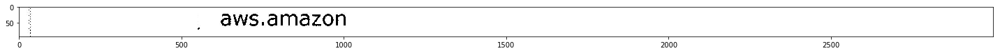

| aws.amazon
Amount was not detected, re-attempting by removing commas
[None, None, '| aws.amazon']


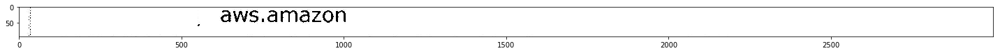

Q9/06/2016 EXPRESSVPN 310-6018492 DE -12.95
Adjusting Window
[None, -12.95, 'Q9/06/2016 EXPRESSVPN 310-6018492 DE ']


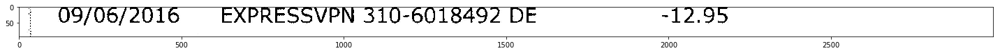

09/06/2016 EXPRESSVPN 310-6018492 DE -12.95
[datetime.date(2016, 9, 6), -12.95, ' EXPRESSVPN 310-6018492 DE ']


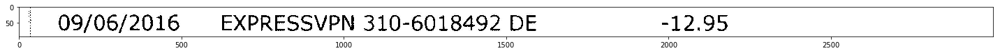


Amount was not detected, re-attempting by removing commas
[None, None, '']


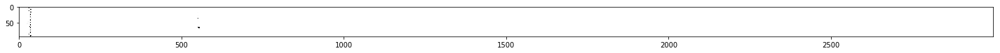

09/02/2016 SAN MATEO SAN MATEO CA -5.53
[datetime.date(2016, 9, 2), -5.53, ' SAN MATEO SAN MATEO CA ']


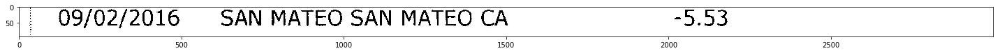

fr fan ft rpre ea It st fe te Peer rm -"FF a 2 Pa T PR ABW) FS Te O.UlUKRlCU RK CI CO ee eeEeS A UK Or!
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'fr fan ft rpre ea It st fe te Peer rm --FF a 2 Pa T PR ABW) FS Te O.UlUKRlCU RK CI CO ee eeEeS A UK Or!']


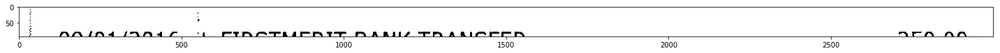


Amount was not detected, re-attempting by removing commas
[None, None, '']


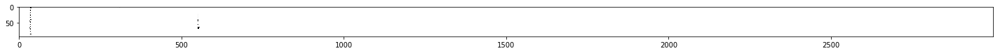

09/01/2016 it FIRSTMERIT BANK TRANSFER
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 9, 1), None, ' it FIRSTMERIT BANK TRANSFER']


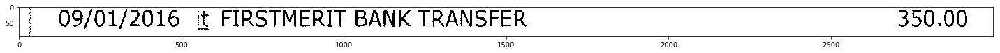

09/01/2016 it FIRSTMERIT BANK TRANSFER 350.00
[datetime.date(2016, 9, 1), 350.0, ' it FIRSTMERIT BANK TRANSFER']


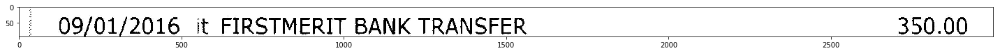

08/31/2016 AMAZON MKTPLACE PMTS -18.91
[datetime.date(2016, 8, 31), -18.91, ' AMAZON MKTPLACE PMTS ']


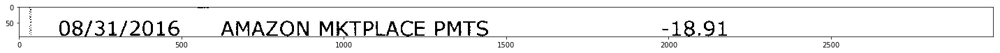

| AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| AMZN.COM/']


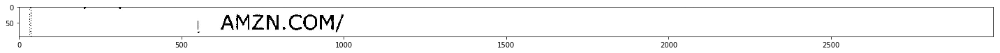

VU Y4f CVV FAUUTIPAELWIN PEN EP LANL Fb  ftOe~F7t

| AMZN COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'VU Y4f CVV FAUUTIPAELWIN PEN EP LANL Fb  ftOe~F7t\n\n| AMZN COM/']


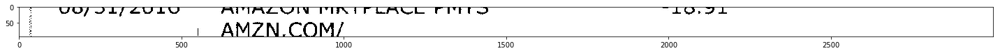

ee eS ee



e 8G Fe Gee FSU ee et ee OC

AMZN.COM/

Zt
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee eS ee\n\n\n\ne 8G Fe Gee FSU ee et ee OC\n\nAMZN.COM/\n\nZt']


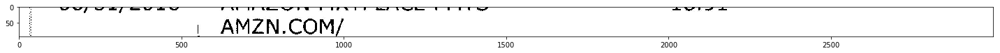

| AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| AMZN.COM/']


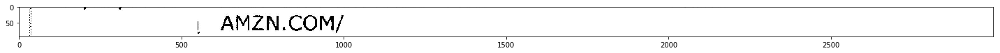

| AMZN.COM/
Amount was not detected, re-attempting by removing commas
[None, None, '| AMZN.COM/']


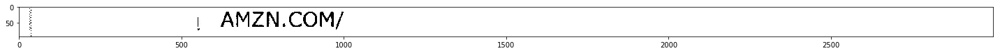

08/30/2016 ATM WITHDRAWAL -160.00
[datetime.date(2016, 8, 30), -160.0, ' ATM WITHDRAWAL ']


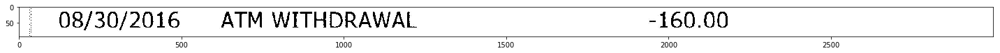

08/30/2016

IMR BATTERIES 713-781-9400

-5,50
, istead of . was detected, chainging
[datetime.date(2016, 8, 30), -5.5, '\n\nIMR BATTERIES 713-781-9400\n\n']


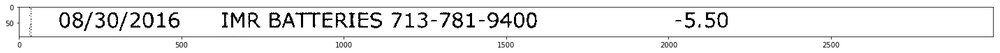


Amount was not detected, re-attempting by removing commas
[None, None, '']


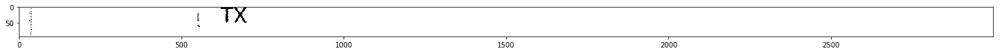

Al eniaArer
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Al eniaArer']


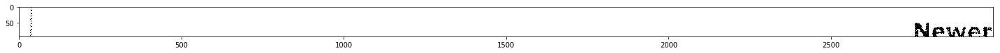


Amount was not detected, re-attempting by removing commas
[None, None, '']


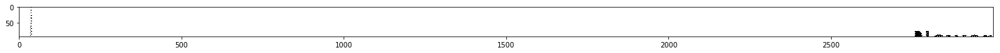

Image (44).jpg
08/18/2016  SQC*ART PERKITNY ./ CA -10.00
[datetime.date(2016, 8, 18), -10.0, '  SQC*ART PERKITNY ./ CA ']


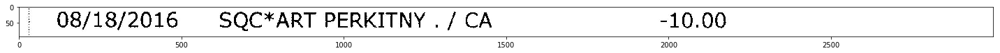


Amount was not detected, re-attempting by removing commas
[None, None, '']


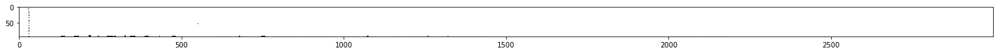

U6/1//2£016 PEISMART INC 1416 SAN -27.Q00

AA ATO” LNT. STA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'U6/1//2£016 PEISMART INC 1416 SAN -27.Q00\n\nAA ATO” LNT. STA']


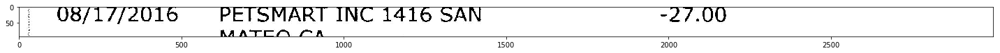

08/17/2016 PETSMART INC 1416 SAN -27.00
[datetime.date(2016, 8, 17), -27.0, ' PETSMART INC 1416 SAN ']


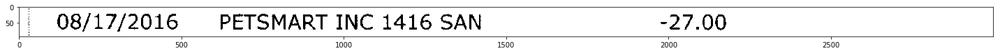

MATEO CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MATEO CA']


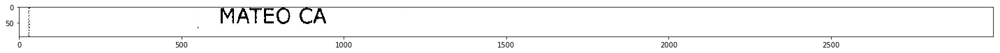

MATEO CA |
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MATEO CA |']


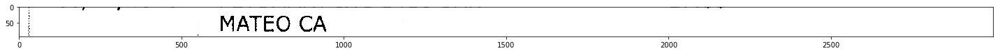

MATEO CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MATEO CA']


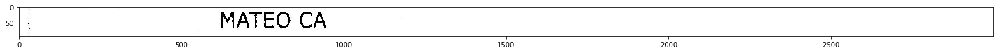

MATEO CA
Amount was not detected, re-attempting by removing commas
[None, None, 'MATEO CA']


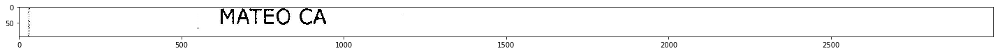

08/17/2016 PETSMART INC 1416 SAN -16.83

a ee ts
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 8, 17), None, ' PETSMART INC 1416 SAN -16.83\n\na ee ts']


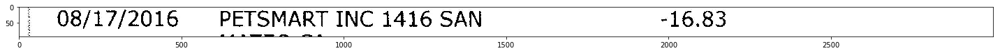

08/17/2016 #PETSMART INC 1416 SAN -16.83
[datetime.date(2016, 8, 17), -16.83, ' #PETSMART INC 1416 SAN ']


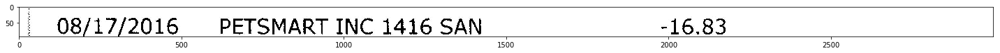

MATEO CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MATEO CA']


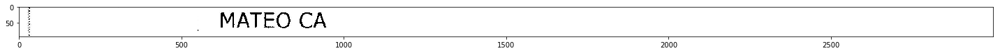

NINA fe Ff Ga Ns LN bo be Eure Pe NENT REN oO RN AN ae NI 8 OY

MATEO CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NINA fe Ff Ga Ns LN bo be Eure Pe NENT REN oO RN AN ae NI 8 OY\n\nMATEO CA']


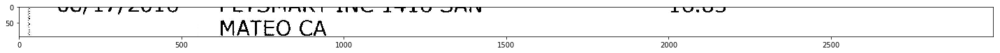

MATEOCA <“_isOsOSOSS
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MATEOCA <“_isOsOSOSS']


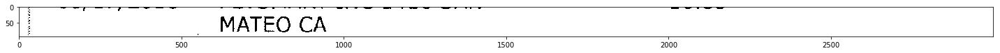

MATEO CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MATEO CA']


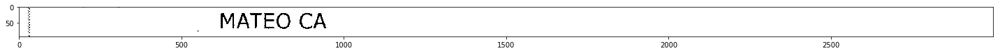

MATEO CA
Amount was not detected, re-attempting by removing commas
[None, None, 'MATEO CA']


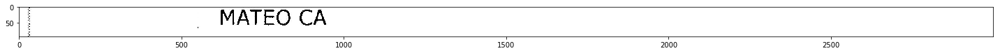

08/17/2016 §SAN MATEO SAN MATEO CA -12.64
[datetime.date(2016, 8, 17), -12.64, ' §SAN MATEO SAN MATEO CA ']


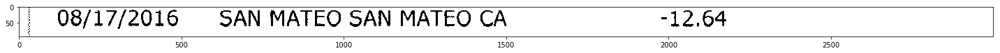

fare. hU6FlCUUKlCUO ULC Oe OS UCC ~~ -_ sm mse F - kt ree: “* pe -?P ~~ mw hitnrkaAasAa r: ~~
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'fare. hU6FlCUUKlCUO ULC Oe OS UCC -- -_ sm mse F - kt ree: “* pe -?P -- mw hitnrkaAasAa r: --']


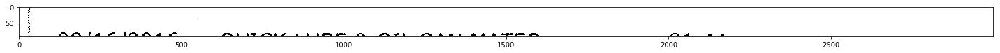


Amount was not detected, re-attempting by removing commas
[None, None, '']


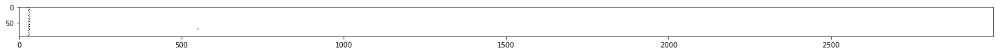

08/16/2016 QUICK LUBE & OIL SAN MATEO -81.44
[datetime.date(2016, 8, 16), -81.44, ' QUICK LUBE & OIL SAN MATEO ']


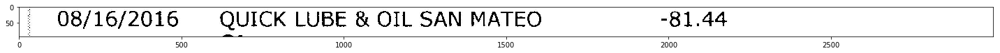

‘coat? veaee

a

emai’ tees tags
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '‘coat? veaee\n\na\n\nemai’ tees tags']


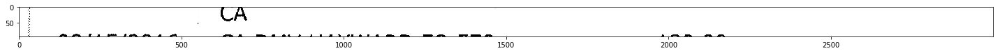


Amount was not detected, re-attempting by removing commas
[None, None, '']


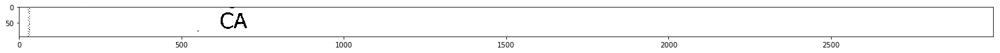

08/15/2016 CA DMV HAYWARD FO 579 -189.00
[datetime.date(2016, 8, 15), -189.0, ' CA DMV HAYWARD FO 579 ']


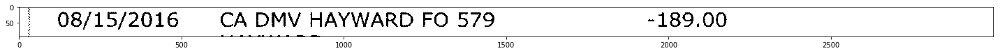

HAYWARD
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'HAYWARD']


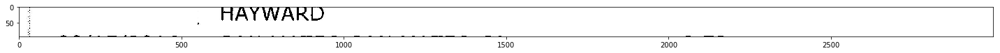

HAYWARD
Amount was not detected, re-attempting by removing commas
[None, None, 'HAYWARD']


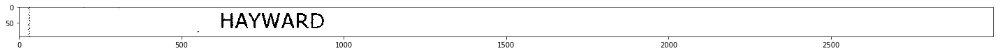

08/15/2016 SAN MATEO SAN MATEO CA -8.73
[datetime.date(2016, 8, 15), -8.73, ' SAN MATEO SAN MATEO CA ']


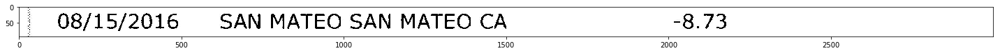


Amount was not detected, re-attempting by removing commas
[None, None, '']


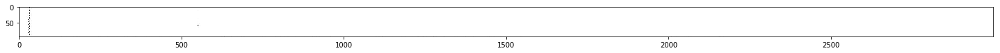

08/15/2016 SQ *CHARLES SANDMAN 877- -30.00

Aa~4~ > At”
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 8, 15), None, ' SQ *CHARLES SANDMAN 877- -30.00\n\nAa~4~ > At”']


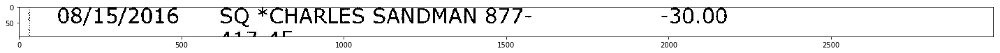

08/15/2016 SQ *CHARLES SANDMAN 877- -30.00
[datetime.date(2016, 8, 15), -30.0, ' SQ *CHARLES SANDMAN 877- ']


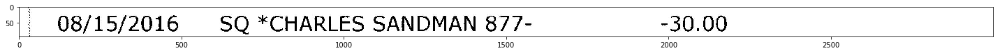

417-45
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '417-45']


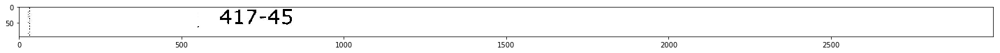

 ae

aR Ts ESS: SSS
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, ' ae\n\naR Ts ESS: SSS']


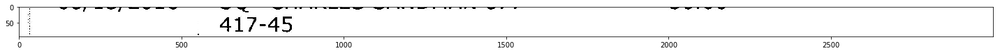

417-45
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '417-45']


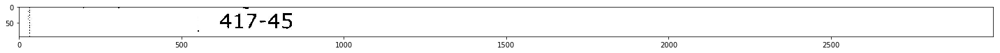

417-45
Amount was not detected, re-attempting by removing commas
[None, None, '417-45']


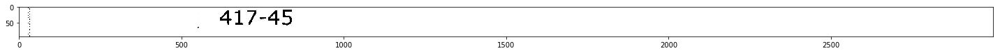

08/12/2016 SQC*ART PERKITNY . / CA -55.00
[datetime.date(2016, 8, 12), -55.0, ' SQC*ART PERKITNY . / CA ']


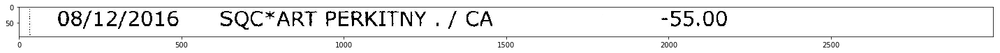


Amount was not detected, re-attempting by removing commas
[None, None, '']


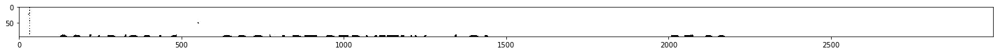

Uo/l2f/2£U16 PQCTART FERKITNY . / CA -29.U0
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Uo/l2f/2£U16 PQCTART FERKITNY . / CA -29.U0']


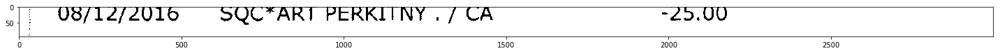

08/12/2016 SQC*ART PERKITNY ./ CA -25.00
[datetime.date(2016, 8, 12), -25.0, ' SQC*ART PERKITNY ./ CA ']


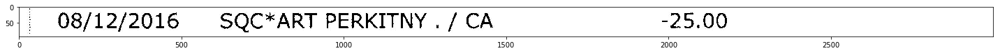


Amount was not detected, re-attempting by removing commas
[None, None, '']


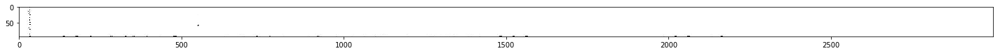

08/12/2016 UBC*BLICK ART MATERIA SOO- -150.49

A A"?
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 8, 12), None, ' UBC*BLICK ART MATERIA SOO- -150.49\n\nA A-?']


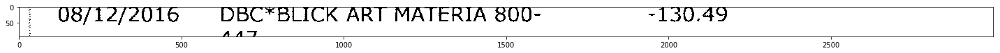

08/12/2016 DBC*BLICK ART MATERIA 800- -130.49
[datetime.date(2016, 8, 12), -130.49, ' DBC*BLICK ART MATERIA 800- ']


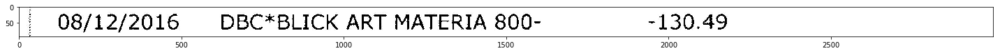

447-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '447-']


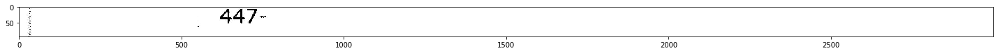


Amount was not detected, re-attempting by removing commas
[None, None, '']


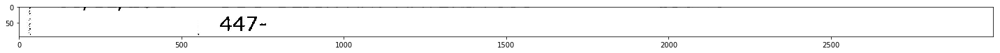

08/11/2016 SQC*ART PERKITNY . / CA -2,112.00
Amount was not detected, re-attempting by removing commas
[datetime.date(2016, 8, 11), -2112.0, ' SQC*ART PERKITNY . / CA -2,112.00']


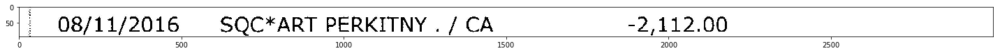


Amount was not detected, re-attempting by removing commas
[None, None, '']


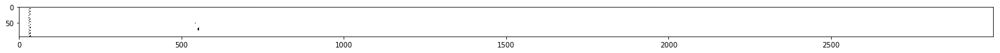

08/11/2016 AMAZON MKTPLACE PMTS -43.77
[datetime.date(2016, 8, 11), -43.77, ' AMAZON MKTPLACE PMTS ']


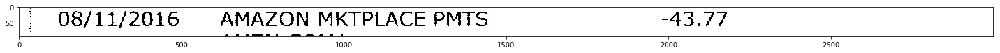

AMZN.COM/

a eee eee le

tn

el . om
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/\n\na eee eee le\n\ntn\n\nel . om']


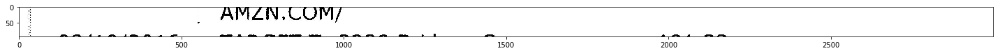

AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/']


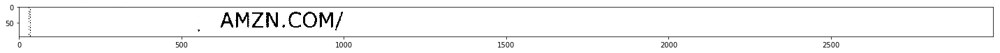

ZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ZN.COM/']


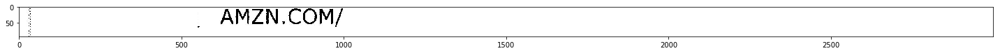

M/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'M/']


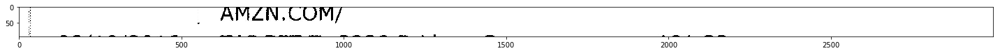

fr ty £4 fe OTT! 4 Oo

AMLIN.OUPT/

“Fa me ( eer” “~~

~~ Yen re FS  * J. |

re

fy @

“sy
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'fr ty £4 fe OTT! 4 Oo\n\nAMLIN.OUPT/\n\n“Fa me ( eer” “--\n\n-- Yen re FS  * J. |\n\nre\n\nfy @\n\n“sy']


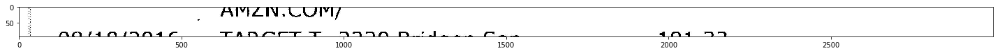

FAT TINNY

No l/71n/»AxnItco TAOM CT T DJYDNA Reridaanan Can 1fN)41 272
Adjusting Window
[None, 272.0, 'FAT TINNY\n\nNo l/71n/»AxnItco TAOM CT T DJYDNA Reridaanan Can 1fN)41']


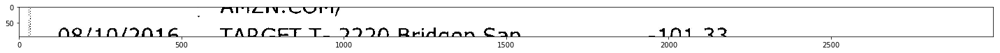

a  oe SS

ONR/10N/9N16 TARGET T- JD00 Rridnan San -10N1 22
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'a  oe SS\n\nONR/10N/9N16 TARGET T- JD00 Rridnan San -10N1 22']


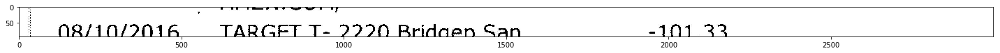

08/10/2016 TARGET T- 2220 Bridaep San -101.33
[datetime.date(2016, 8, 10), -101.33, ' TARGET T- 2220 Bridaep San ']


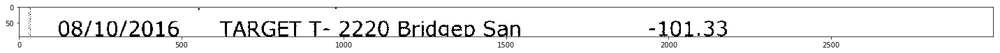

Mat
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Mat']


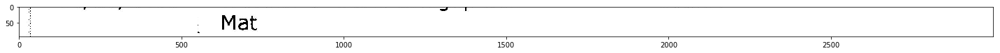

VO AV eV PPMINMR PF L264 MIIMYGO PP VOT oh SF ID

1 Mat
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'VO AV eV PPMINMR PF L264 MIIMYGO PP VOT oh SF ID\n\n1 Mat']


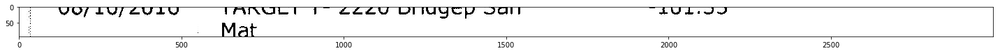

NN a Geee ee te ee oF RE Net Bee F ' ae Ge he eee ee eA we Ne ee oe

| Mat
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, "NN a Geee ee te ee oF RE Net Bee F ' ae Ge he eee ee eA we Ne ee oe\n\n| Mat"]


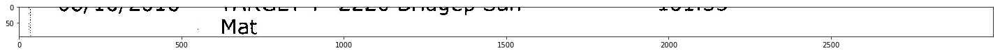

wr
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'wr']


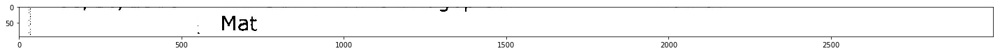

Mat
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Mat']


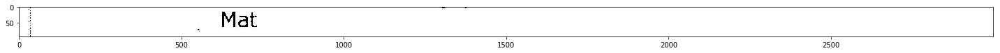

Mat
Amount was not detected, re-attempting by removing commas
[None, None, 'Mat']


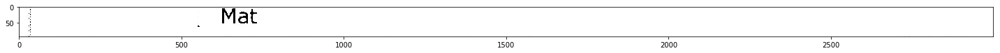

08/10/2016 Online Transfer from SAV ...03
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 8, 10), None, ' Online Transfer from SAV ...03']


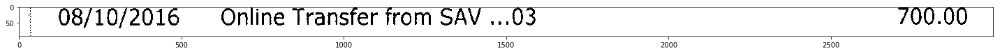

08/10/2016 Online Transfer from SAV ...03 700.00
[datetime.date(2016, 8, 10), 700.0, ' Online Transfer from SAV ...03']


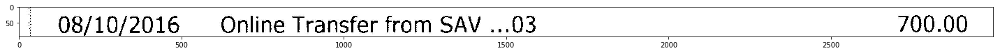


Amount was not detected, re-attempting by removing commas
[None, None, '']


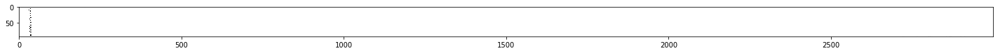

08/10/2016 © ATM CHECK DEPOSIT 08/10

um wii elie dle tle
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 8, 10), None, ' © ATM CHECK DEPOSIT 08/10\n\num wii elie dle tle']


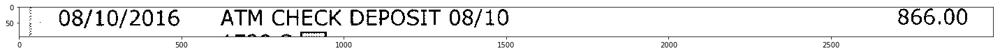

08/10/2016 © ATM CHECK DEPOSIT 08/10 866.00
[datetime.date(2016, 8, 10), 866.0, ' © ATM CHECK DEPOSIT 08/10']


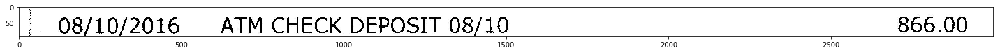

1730S
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '1730S']


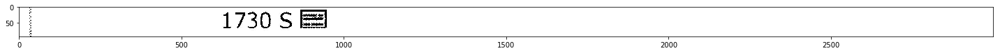

tf ew ew SL ae OE ee OOS oe ON ee ee a

1730S 
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'tf ew ew SL ae OE ee OOS oe ON ee ee a\n\n1730S ']


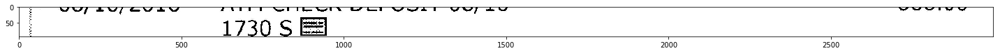

1730S
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '1730S']


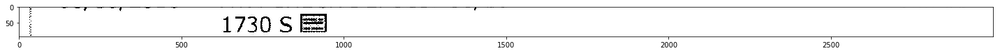

1730S
Amount was not detected, re-attempting by removing commas
[None, None, '1730S']


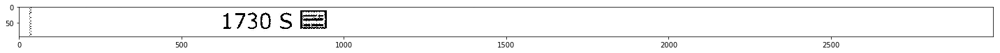

Image (45).jpg
08/03/2016 Amazon web services -13.52
[datetime.date(2016, 8, 3), -13.52, ' Amazon web services ']


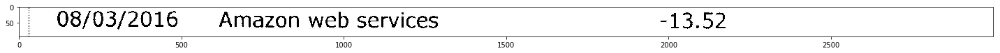

aws.amazon

 

ae meats aa ee sta ae ae ee ce
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aws.amazon\n\n \n\nae meats aa ee sta ae ae ee ce']


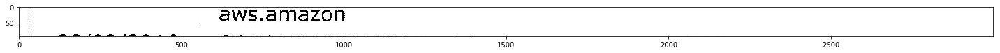

aws.amazon
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aws.amazon']


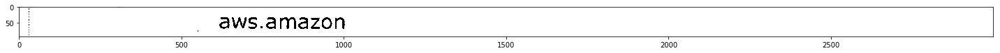

aws.amazon
Amount was not detected, re-attempting by removing commas
[None, None, 'aws.amazon']


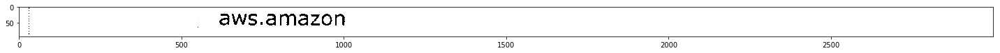

08/03/2016 SQC*ART PERKITNY . / CA -45.00
[datetime.date(2016, 8, 3), -45.0, ' SQC*ART PERKITNY . / CA ']


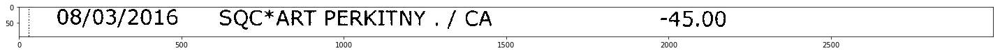

ma mM fi mt ie

ee ge es
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ma mM fi mt ie\n\nee ge es']


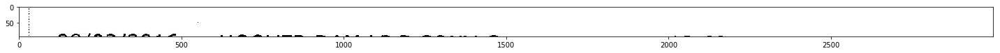


Amount was not detected, re-attempting by removing commas
[None, None, '']


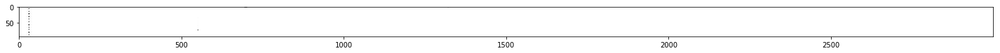

08/03/2016 HOOVER DAM LDG CONV G -13.68
[datetime.date(2016, 8, 3), -13.68, ' HOOVER DAM LDG CONV G ']


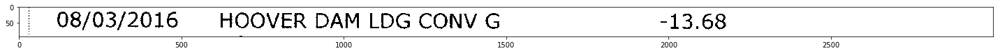

BOULDER
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'BOULDER']


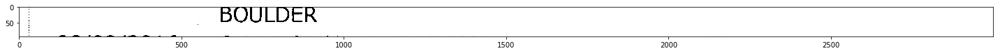

BOULDER
Amount was not detected, re-attempting by removing commas
[None, None, 'BOULDER']


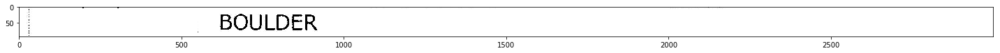

08/02/2016 CHEVRON/OAK HILLS MARK -1.63
[datetime.date(2016, 8, 2), -1.63, ' CHEVRON/OAK HILLS MARK ']


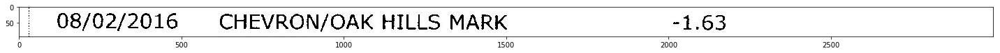

HESPERI
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'HESPERI']


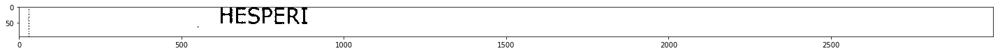

HESPERI
Amount was not detected, re-attempting by removing commas
[None, None, 'HESPERI']


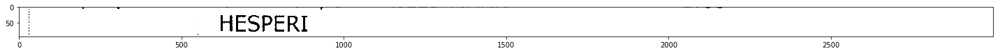

08/02/2016 CHEVRON/OAK HILLS MARK -9,93
, istead of . was detected, chainging
[datetime.date(2016, 8, 2), -9.93, ' CHEVRON/OAK HILLS MARK ']


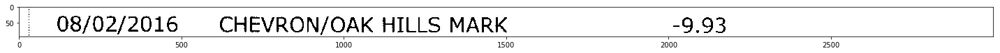

HESPERI
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'HESPERI']


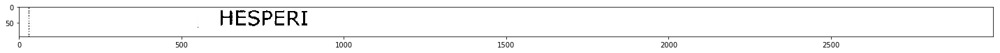

hs ll

oe

a



es 2 See se ee ee Pe

HESPERI

ta be



fF sr uP NS

[tl i atleast
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'hs ll\n\noe\n\na\n\n\n\nes 2 See se ee ee Pe\n\nHESPERI\n\nta be\n\n\n\nfF sr uP NS\n\n[tl i atleast']


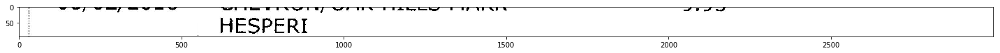

HESPERI |
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'HESPERI |']


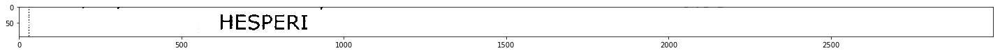

HESPERI
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'HESPERI']


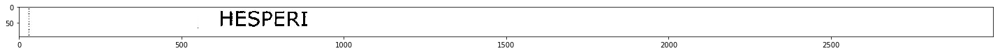

HESPERI
Amount was not detected, re-attempting by removing commas
[None, None, 'HESPERI']


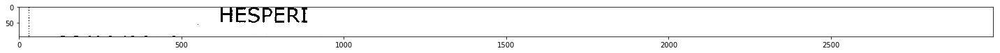

Ud/02/2Z016 ARCO #42214 AMPM YERMO CA -5,.52
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, -5.52, 'Ud/02/2Z016 ARCO #42214 AMPM YERMO CA -5,.52']


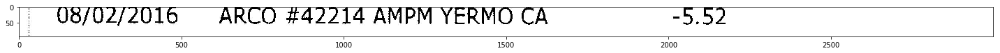

08/02/2016 ARCO #42214 AMPM YERMO CA -5.52
[datetime.date(2016, 8, 2), -5.52, ' ARCO #42214 AMPM YERMO CA ']


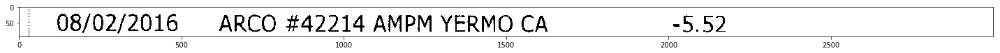


Amount was not detected, re-attempting by removing commas
[None, None, '']


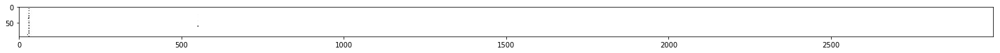

08/02/2016 DALES SINCLAIR BOULDER -7.47

Pp. 2
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 8, 2), None, ' DALES SINCLAIR BOULDER -7.47\n\nPp. 2']


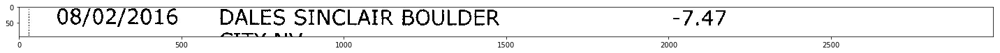

08/02/2016 DALES SINCLAIR BOULDER -7.47
[datetime.date(2016, 8, 2), -7.47, ' DALES SINCLAIR BOULDER ']


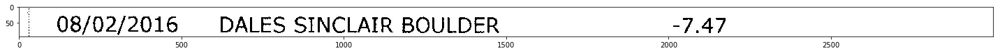

CITY NV
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CITY NV']


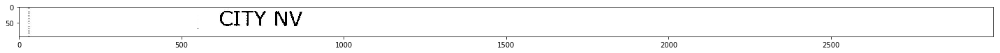

SS a a a: a eee Ree Sete Me le et ee Se Ne ee ee bee FO

CITY NV
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'SS a a a: a eee Ree Sete Me le et ee Se Ne ee ee bee FO\n\nCITY NV']


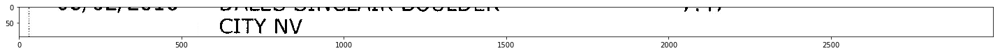

CITY NV |
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CITY NV |']


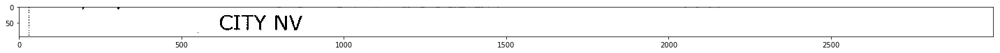

CITY NV
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CITY NV']


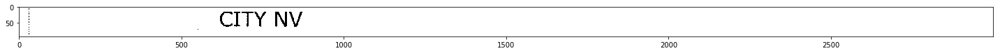

CITY NV
Amount was not detected, re-attempting by removing commas
[None, None, 'CITY NV']


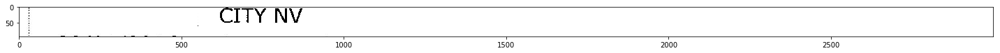

U6/U1/2016 CHEVRON/BIG SLICK PETR -4.22

tTATUEUarTr"rr™ iit
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'U6/U1/2016 CHEVRON/BIG SLICK PETR -4.22\n\ntTATUEUarTr-rr™ iit']


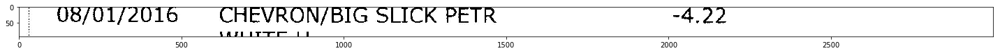

08/01/2016  CHEVRON/BIG SLICK PETR -4.22
[datetime.date(2016, 8, 1), -4.22, '  CHEVRON/BIG SLICK PETR ']


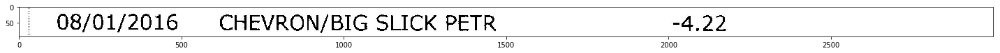

WHITE H
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'WHITE H']


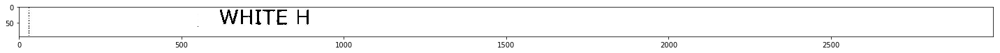

WHITEH
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'WHITEH']


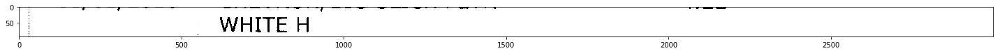

WHITE H>
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'WHITE H>']


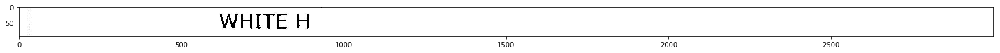

WHITE H
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'WHITE H']


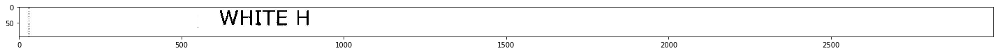

WHITE A
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'WHITE A']


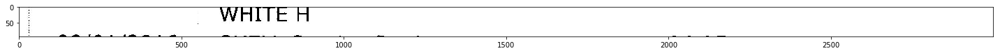

Write nw

Lr oy, irra rs paar i 4 Fn Ee ee ee ee ~ - are
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Write nw\n\nLr oy, irra rs paar i 4 Fn Ee ee ee ee ~ - are']


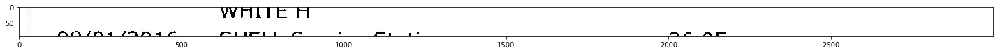

V¥Viiltiu fl
NYO /fi4d /9NALK CLC i Cn; wrinn CERN AK AC HNC
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'V¥Viiltiu fl\nNYO /fi4d /9NALK CLC i Cn; wrinn CERN AK AC HNC']


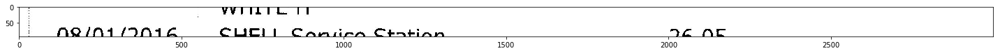

wes te F tee 6

OR/N1/9D016 CHEI I Caryicoa Cratian ~JE NS
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'wes te F tee 6\n\nOR/N1/9D016 CHEI I Caryicoa Cratian ~JE NS']


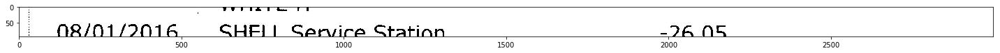

08/01/2016 | SHELL Service Station -26.05
[datetime.date(2016, 8, 1), -26.05, ' | SHELL Service Station ']


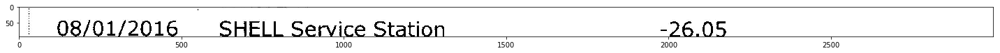

SELIGMAN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'SELIGMAN']


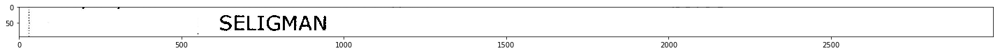

WOfVf CVV WILL, VOI VileE YGLUALIVI! eID

SEI TGMAN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'WOfVf CVV WILL, VOI VileE YGLUALIVI! eID\n\nSEI TGMAN']


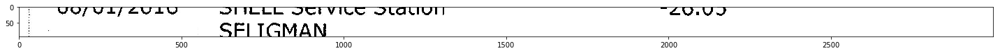

Nee OOF Bowe Ree Bee ee ee FOO ee ee

SELIGMAN

Coe Ne

st
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Nee OOF Bowe Ree Bee ee ee FOO ee ee\n\nSELIGMAN\n\nCoe Ne\n\nst']


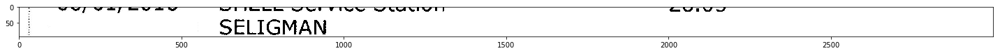

SELIGMAN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'SELIGMAN']


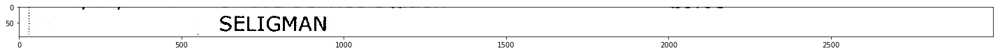

SELIGMAN
Amount was not detected, re-attempting by removing commas
[None, None, 'SELIGMAN']


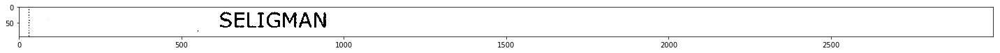

08/01/2016 SHELL Service Station -8.66
[datetime.date(2016, 8, 1), -8.66, ' SHELL Service Station ']


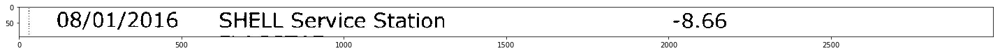

FLAGS TAF
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'FLAGS TAF']


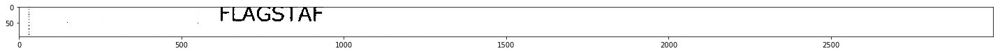

FLAGSTAF
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'FLAGSTAF']


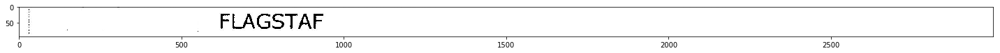

FLAGSTAF
Amount was not detected, re-attempting by removing commas
[None, None, 'FLAGSTAF']


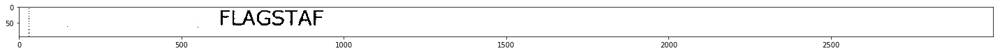

08/01/2016 SQC*ART PERKITNY ./ CA -50.50
[datetime.date(2016, 8, 1), -50.5, ' SQC*ART PERKITNY ./ CA ']


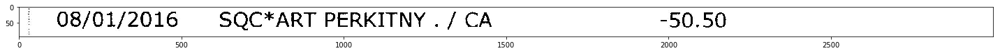


Amount was not detected, re-attempting by removing commas
[None, None, '']


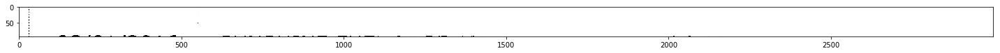

Uo/UL/ZU16 SUNSAINE FUEL PAGE AZ “20.41
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Uo/UL/ZU16 SUNSAINE FUEL PAGE AZ “20.41']


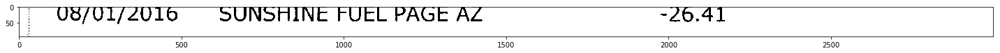

08/01/2016 SUNSHINE FUEL PAGE AZ -26.41
[datetime.date(2016, 8, 1), -26.41, ' SUNSHINE FUEL PAGE AZ ']


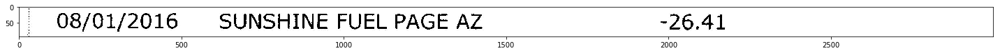


Amount was not detected, re-attempting by removing commas
[None, None, '']


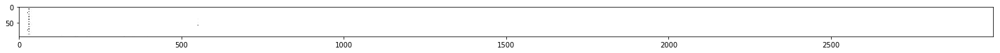

08/01/2016 ©K AND CSTORE AND KOKO, -3.69
[datetime.date(2016, 8, 1), -3.69, ' ©K AND CSTORE AND KOKO, ']


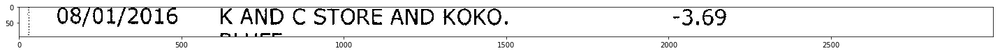

DLUFr

fa fe FPR A OTA! SA wus ber: on get . a a mrs ee flo 2. hh hlUuhr /?
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'DLUFr\n\nfa fe FPR A OTA! SA wus ber: on get . a a mrs ee flo 2. hh hlUuhr /?']


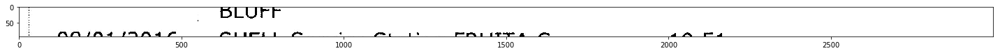

BLUFF
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'BLUFF']


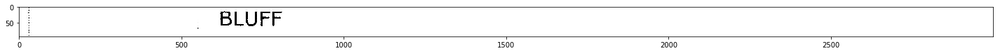


Amount was not detected, re-attempting by removing commas
[None, None, '']


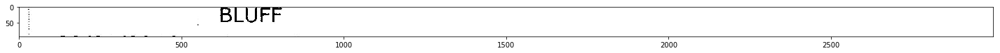

US6/U1/2016 SHELL Service Station FRUITA C -19.51
Adjusting Window
[None, -19.51, 'US6/U1/2016 SHELL Service Station FRUITA C ']


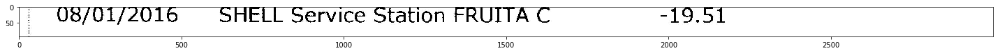

08/01/2016 SHELL Service Station FRUITA C -19.51
[datetime.date(2016, 8, 1), -19.51, ' SHELL Service Station FRUITA C ']


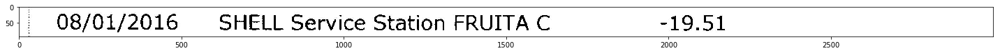


Amount was not detected, re-attempting by removing commas
[None, None, '']


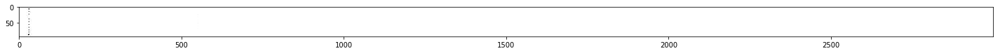

08/01/2016 THUNDER RIVER MA -2.48

f™ FE FP™ A ria re™ OM P™ OU F™ SS, OF
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 8, 1), None, ' THUNDER RIVER MA -2.48\n\nf™ FE FP™ A ria re™ OM P™ OU F™ SS, OF']


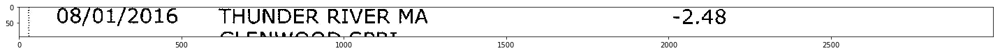

08/01/2016 THUNDER RIVER MA -2.48
[datetime.date(2016, 8, 1), -2.48, ' THUNDER RIVER MA ']


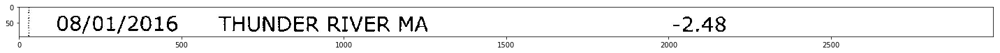

GLENWOOD SPRI
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'GLENWOOD SPRI']


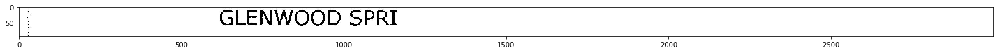



aS eee

GLENWOOD SPRI
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '\n\naS eee\n\nGLENWOOD SPRI']


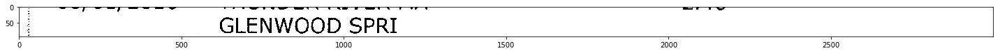

GLENWOOD SPRI
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'GLENWOOD SPRI']


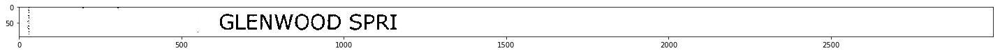

GLENWOOD SPRI
Amount was not detected, re-attempting by removing commas
[None, None, 'GLENWOOD SPRI']


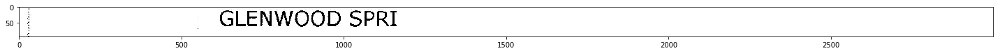

08/01/2016 IN *JEFFERSON PONY ESP 719-

ce ~*~!
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 8, 1), None, ' IN *JEFFERSON PONY ESP 719-\n\nce ~*~!']


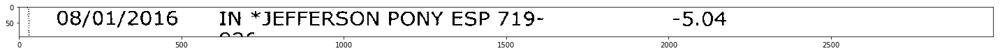

08/01/2016 IN *JEFFERSON PONY ESP 719- -5.04
[datetime.date(2016, 8, 1), -5.04, ' IN *JEFFERSON PONY ESP 719- ']


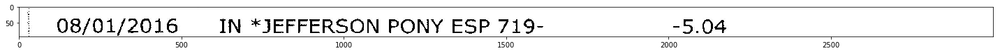

836
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '836']


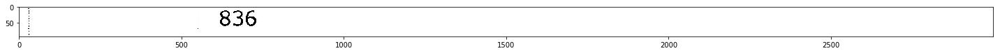

Ef ef ot eh at Fae FD FF be Fe EU EOE te ee fF > wt he UF

836
Adjusting Window
[None, 836.0, 'Ef ef ot eh at Fae FD FF be Fe EU EOE te ee fF > wt he UF\n']


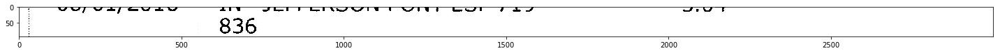


Amount was not detected, re-attempting by removing commas
[None, None, '']


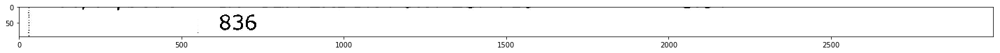

Image (46).jpg
07/22/2016 VZWRLSS*APOCC VISN 800- -107.54
[datetime.date(2016, 7, 22), -107.54, ' VZWRLSS*APOCC VISN 800- ']


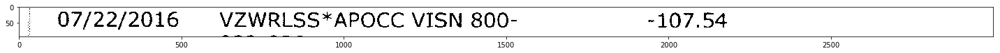

IL2-ULV
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'IL2-ULV']


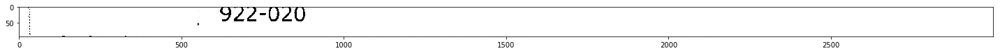

922-020
Adjusting Window
[None, -20.0, '922']


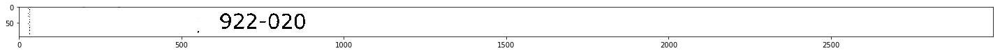

922-020
[None, -20.0, '922']


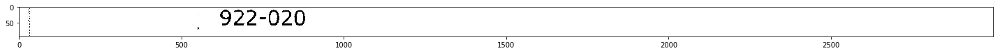

07/21/2016 AVON LAKE FOOD MAR AVON -2,65

se naires ~*~
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 7, 21), None, ' AVON LAKE FOOD MAR AVON -2,65\n\nse naires ~*~']


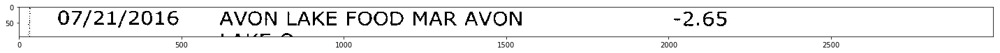

07/21/2016 AVON LAKE FOOD MAR AVON -2.65
[datetime.date(2016, 7, 21), -2.65, ' AVON LAKE FOOD MAR AVON ']


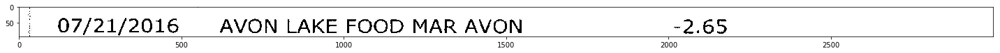

LAKE O
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'LAKE O']


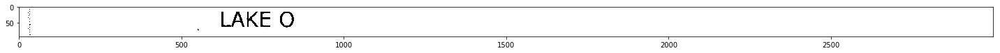

mm 2 fn ee Re ae ee eR Ne ES Geer CEN eZ ZULU A NA OPO NE aw tS ot

LAKE O
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'mm 2 fn ee Re ae ee eR Ne ES Geer CEN eZ ZULU A NA OPO NE aw tS ot\n\nLAKE O']


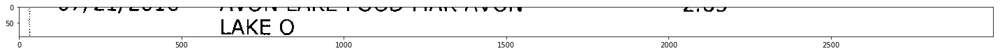

LAKE 0
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'LAKE 0']


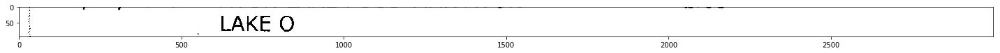

LAKE O
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'LAKE O']


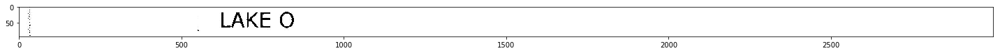


Amount was not detected, re-attempting by removing commas
[None, None, '']


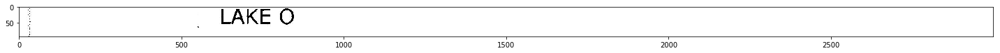

07/20/2016 VIENG ASIAN BISTRO 330-990- -26.96

™!, rye,
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 7, 20), None, ' VIENG ASIAN BISTRO 330-990- -26.96\n\n™!, rye,']


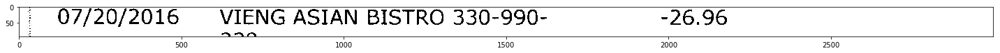

07/20/2016  VIENG ASIAN BISTRO 330-990- -26.96
[datetime.date(2016, 7, 20), -26.96, '  VIENG ASIAN BISTRO 330-990- ']


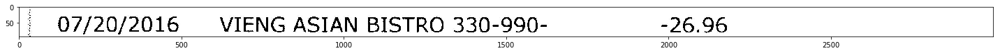

228
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '228']


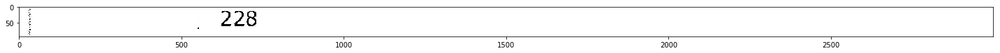

Ee EEe CEE BS Bee FO NN ee ee ee ee ee  wt et

- 228
Adjusting Window
[None, 228.0, 'Ee EEe CEE BS Bee FO NN ee ee ee ee ee  wt et\n\n-']


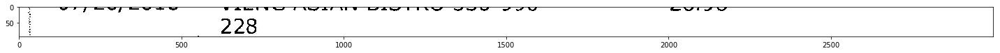

228
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '228']


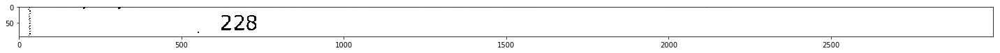

228
Amount was not detected, re-attempting by removing commas
[None, None, '228']


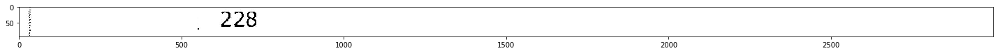

07/19/2016 SPEEDWAY 03528 327 AVON -10.00
[datetime.date(2016, 7, 19), -10.0, ' SPEEDWAY 03528 327 AVON ']


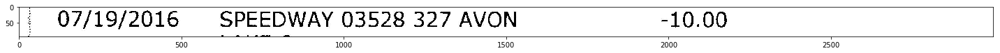

cO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'cO']


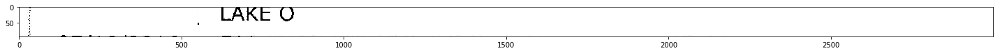

LAKE O
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'LAKE O']


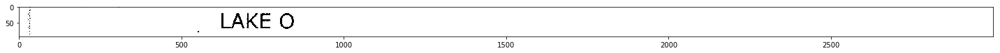


Amount was not detected, re-attempting by removing commas
[None, None, '']


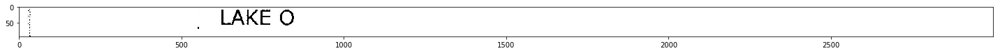

07/18/2016 508 AVON BELDON AVON LAKE -10.04
[datetime.date(2016, 7, 18), -10.04, ' 508 AVON BELDON AVON LAKE ']


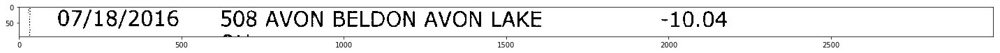

gam! £ 2 om Foe rh hUuthlhlUr  7s s os so on nm lil mes es a/e:ens
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'gam! £ 2 om Foe rh hUuthlhlUr  7s s os so on nm lil mes es a/e:ens']


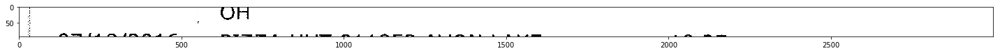

OH
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'OH']


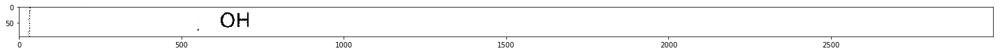


Amount was not detected, re-attempting by removing commas
[None, None, '']


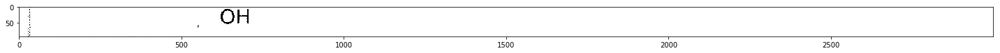

07/18/2016 PIZZA HUT 011853 AVON LAKE -18.27
[datetime.date(2016, 7, 18), -18.27, ' PIZZA HUT 011853 AVON LAKE ']


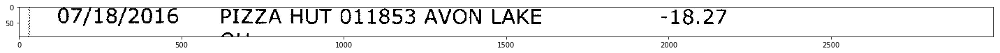

ee ee ee ee ae 2 a ee ed muesmmetiinwf awk eehUlUcreew elU Or TlhlUCUrrRlUcrlUC lr maesrnspsremenee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee ee ee ee ae 2 a ee ed muesmmetiinwf awk eehUlUcreew elU Or TlhlUCUrrRlUcrlUC lr maesrnspsremenee']


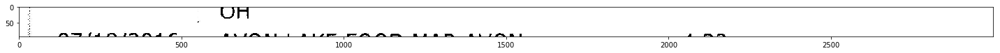

OH
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'OH']


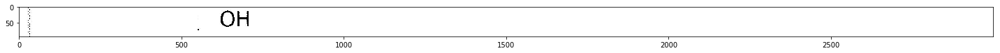


Amount was not detected, re-attempting by removing commas
[None, None, '']


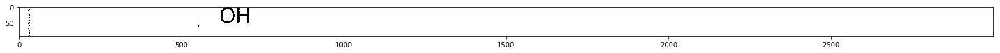

07/18/2016 AVON LAKE FOOD MAR AVON -4.33

1AtSl/Ss/r~ £“r
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 7, 18), None, ' AVON LAKE FOOD MAR AVON -4.33\n\n1AtSl/Ss/r~ £“r']


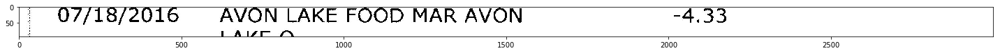

07/18/2016 AVON LAKE FOOD MAR AVON -4.33
[datetime.date(2016, 7, 18), -4.33, ' AVON LAKE FOOD MAR AVON ']


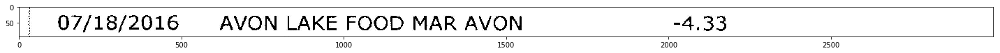


Amount was not detected, re-attempting by removing commas
[None, None, '']


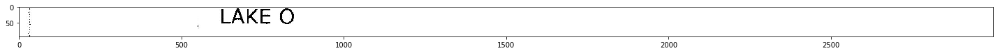

07/18/2016 AMAZON MKTPLACE PMTS -10.95

AR RAJ AF pn f _ ew
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 7, 18), None, ' AMAZON MKTPLACE PMTS -10.95\n\nAR RAJ AF pn f _ ew']


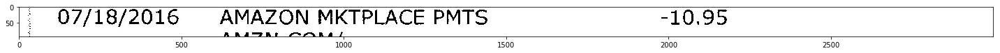

07/18/2016 AMAZON MKTPLACE PMTS -10.95
[datetime.date(2016, 7, 18), -10.95, ' AMAZON MKTPLACE PMTS ']


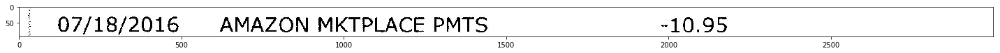

AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/']


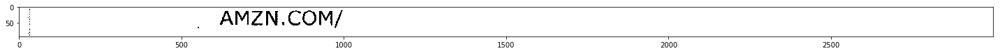

 &

i

See



. Se 1 a ee SS

AMZN.COM/

 SES 2

A Net Fee

Ss fF 5 5

i Set
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, ' &\n\ni\n\nSee\n\n\n\n. Se 1 a ee SS\n\nAMZN.COM/\n\n SES 2\n\nA Net Fee\n\nSs fF 5 5\n\ni Set']


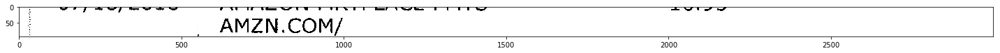

AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/']


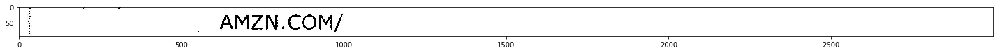

AMZN.COM/
Amount was not detected, re-attempting by removing commas
[None, None, 'AMZN.COM/']


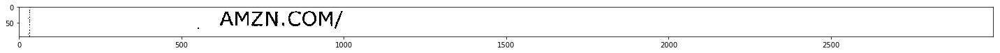

07/18/2016 VIENG ASIAN BISTRO 330-990- -25.92

ie: oe
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 7, 18), None, ' VIENG ASIAN BISTRO 330-990- -25.92\n\nie: oe']


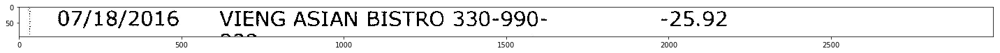

07/18/2016 VIENG ASIAN BISTRO 330-990- -25.92
[datetime.date(2016, 7, 18), -25.92, ' VIENG ASIAN BISTRO 330-990- ']


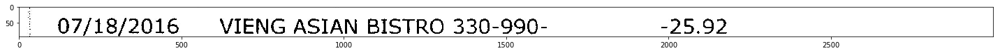

228
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '228']


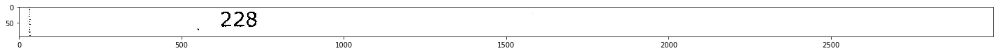

WSF f eG ea tN Wek BR Fw eb FEN NZ rN UM ae a/v et 4

228
Adjusting Window
[None, 228.0, 'WSF f eG ea tN Wek BR Fw eb FEN NZ rN UM ae a/v et 4\n']


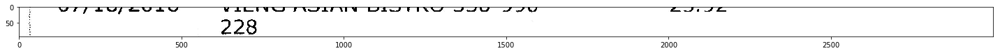


Amount was not detected, re-attempting by removing commas
[None, None, '']


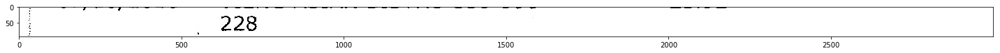

07/18/2016 AMAZON MKTPLACE PMTS -8.99
[datetime.date(2016, 7, 18), -8.99, ' AMAZON MKTPLACE PMTS ']


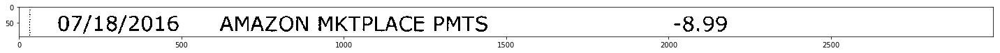

AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/']


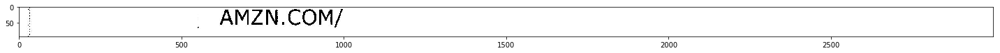

AMZN.COM/_

2 er
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/_\n\n2 er']


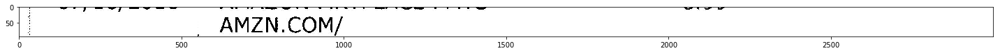

AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/']


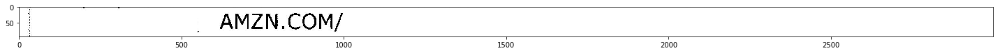


Amount was not detected, re-attempting by removing commas
[None, None, '']


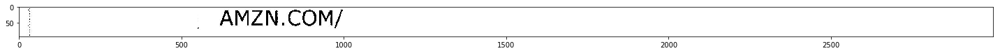

07/15/2016 AVON LAKE FOOD MAR AVON -2.65
[datetime.date(2016, 7, 15), -2.65, ' AVON LAKE FOOD MAR AVON ']


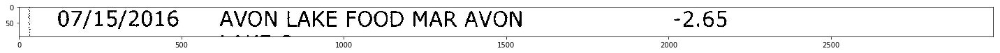


Amount was not detected, re-attempting by removing commas
[None, None, '']


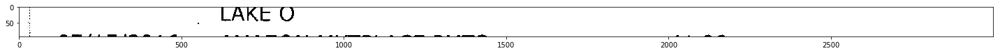

USfLo/ZUlo AMAZON MATPLACE PMIS “41.906

ARATZWAI S"C\RA /
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'USfLo/ZUlo AMAZON MATPLACE PMIS “41.906\n\nARATZWAI S-C\\RA /']


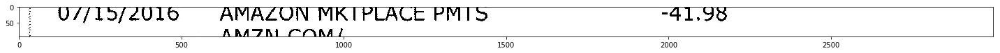

07/15/2016 ©AMAZON MKTPLACE PMTS -41.98
[datetime.date(2016, 7, 15), -41.98, ' ©AMAZON MKTPLACE PMTS ']


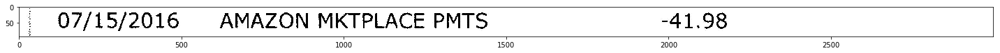

_ AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '_ AMZN.COM/']


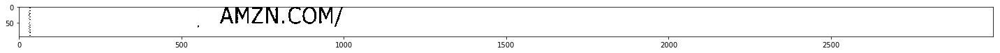

~ AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '~ AMZN.COM/']


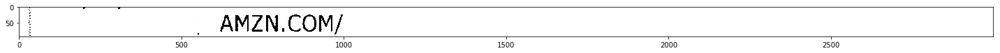

_ AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '_ AMZN.COM/']


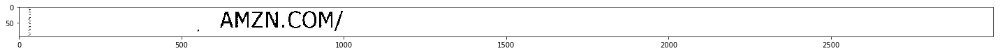


Amount was not detected, re-attempting by removing commas
[None, None, '']


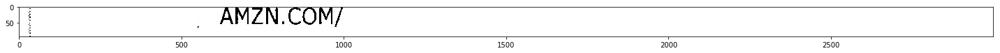

07/15/2016 SQC*ART PERKITNY . / CA -27.50
[datetime.date(2016, 7, 15), -27.5, ' SQC*ART PERKITNY . / CA ']


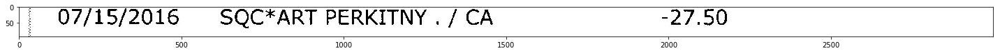

- mm ™) ££ os r fom Mm Oe mina “ae < cn oom 2|06lOUl a 7) i oe K ama a |lCll era C/K et
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '- mm ™) ££ os r fom Mm Oe mina “ae < cn oom 2|06lOUl a 7) i oe K ama a |lCll era C/K et']


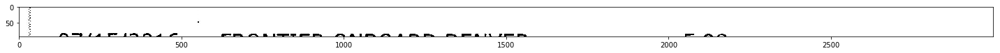


Amount was not detected, re-attempting by removing commas
[None, None, '']


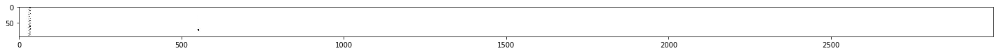

07/15/2016 FRONTIER ONBOARD DENVER -5.98
[datetime.date(2016, 7, 15), -5.98, ' FRONTIER ONBOARD DENVER ']


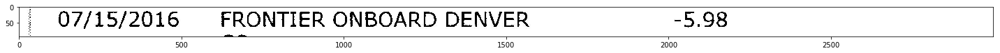


Amount was not detected, re-attempting by removing commas
[None, None, '']


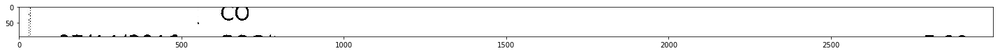

U//14/Z2U10 2; DsQC* 3.00
Adjusting Window
[None, 3.0, 'U//14/Z2U10 2; DsQC*']


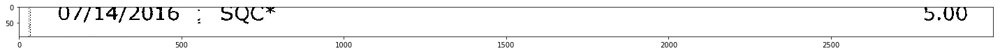

07/14/2016 ; SQC* 5.00
[datetime.date(2016, 7, 14), 5.0, ' ; SQC*']


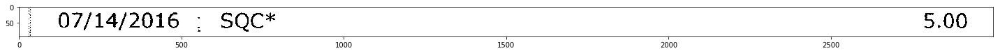

07/14/2016 ; SQC* 20.00
[datetime.date(2016, 7, 14), 20.0, ' ; SQC*']


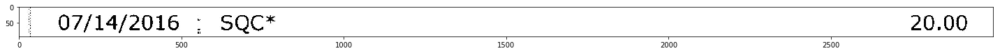

Me eo. ld li Cit
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Me eo. ld li Cit']


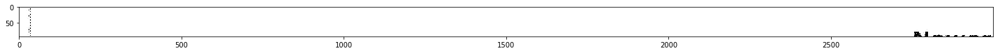

i Ses
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'i Ses']


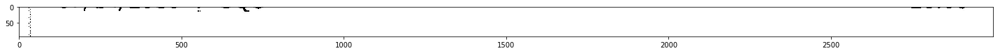


Amount was not detected, re-attempting by removing commas
[None, None, '']


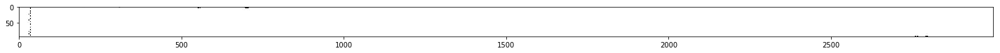

mwmewer
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'mwmewer']


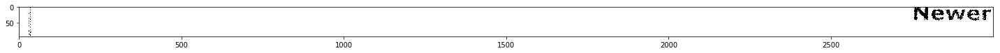

Newer
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Newer']


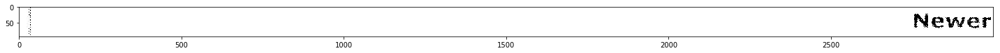

Newer
Amount was not detected, re-attempting by removing commas
[None, None, 'Newer']


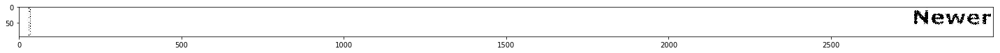

Image (47).jpg
07/13/2016 AVON LAKE FOOD MAR AVON -2.65
[datetime.date(2016, 7, 13), -2.65, ' AVON LAKE FOOD MAR AVON ']


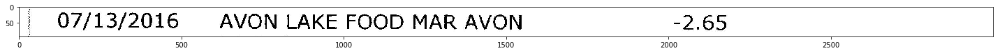


Amount was not detected, re-attempting by removing commas
[None, None, '']


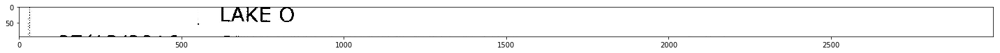

U/{15/2U16 OPECEUWAY 05526 32/ AVON -1.80

| AIlZr” fr
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'U/{15/2U16 OPECEUWAY 05526 32/ AVON -1.80\n\n| AIlZr” fr']


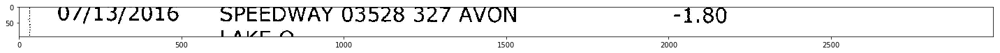

07/13/2016 SPEEDWAY 03528 327 AVON -1.80
[datetime.date(2016, 7, 13), -1.8, ' SPEEDWAY 03528 327 AVON ']


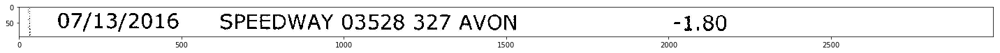


Amount was not detected, re-attempting by removing commas
[None, None, '']


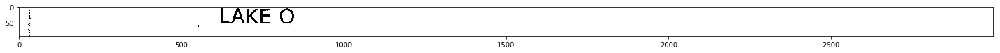

07/13/2016 SPEEDWAY 03528 327 AVON -1.68

| AWS «sr
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 7, 13), None, ' SPEEDWAY 03528 327 AVON -1.68\n\n| AWS «sr']


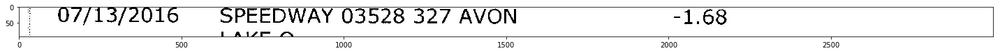

07/13/2016 SPEEDWAY 03528 327 AVON -1,68
, istead of . was detected, chainging
[datetime.date(2016, 7, 13), -1.68, ' SPEEDWAY 03528 327 AVON ']


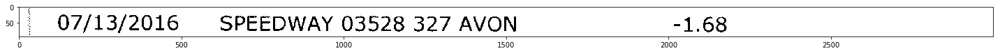


Amount was not detected, re-attempting by removing commas
[None, None, '']


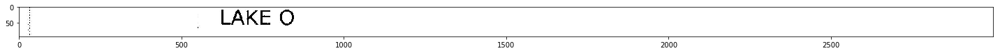

07/13/2016 SQC*ART PERKITNY ./ CA -60.00
[datetime.date(2016, 7, 13), -60.0, ' SQC*ART PERKITNY ./ CA ']


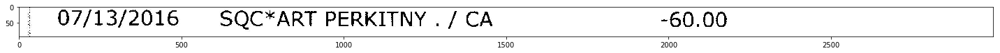


Amount was not detected, re-attempting by removing commas
[None, None, '']


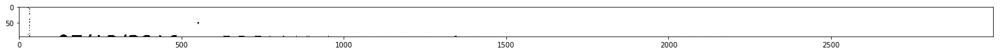

U//15/Z2016 PQOC*ART PERKITNY ./ CA -95.00
Adjusting Window
[None, -95.0, 'U//15/Z2016 PQOC*ART PERKITNY ./ CA ']


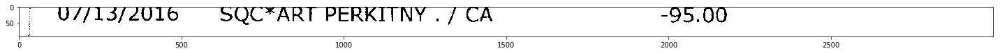

07/13/2016 SQC*ART PERKITNY . / CA -95.00
[datetime.date(2016, 7, 13), -95.0, ' SQC*ART PERKITNY . / CA ']


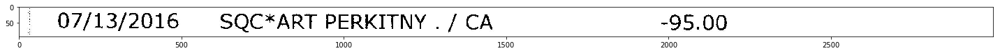


Amount was not detected, re-attempting by removing commas
[None, None, '']


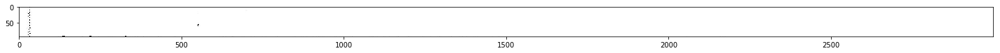

O//11/2016 NAME-CHEAP.COM NAME-C -13.75

yySsAasy Sc 7 rT
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'O//11/2016 NAME-CHEAP.COM NAME-C -13.75\n\nyySsAasy Sc 7 rT']


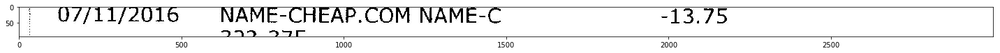

07/11/2016 NAME-CHEAP.COM NAME-C -13.75
[datetime.date(2016, 7, 11), -13.75, ' NAME-CHEAP.COM NAME-C ']


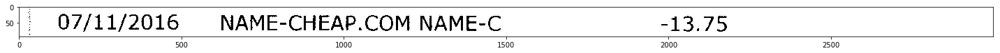

323-375-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '323-375-']


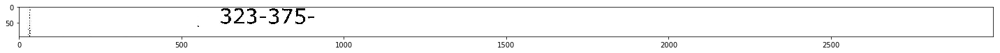

323-375-

eae a
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '323-375-\n\neae a']


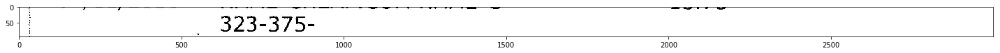

323-375-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '323-375-']


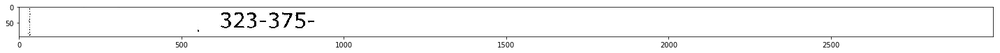

323-375-
Amount was not detected, re-attempting by removing commas
[None, None, '323-375-']


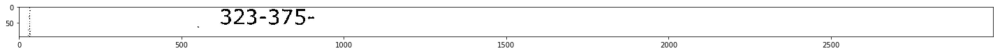

07/11/2016 | SAN MATEO SAN MATEO CA -15.01
[datetime.date(2016, 7, 11), -15.01, ' | SAN MATEO SAN MATEO CA ']


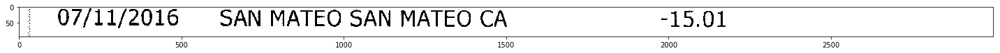

rows f44/;"% fA 4 fp” P ARP rn ea ts Af Oe PR Pe  OFS PT.UCUCUP™ URC m/e oe
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'rows f44/;-% fA 4 fp” P ARP rn ea ts Af Oe PR Pe  OFS PT.UCUCUP™ URC m/e oe']


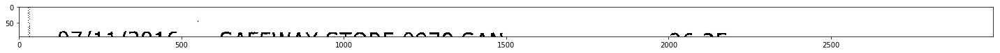


Amount was not detected, re-attempting by removing commas
[None, None, '']


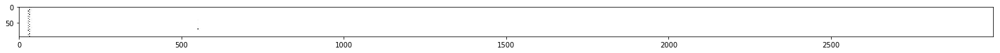

07/11/2016 SAFEWAY STORE 0970 SAN -26.35

aaa a
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 7, 11), None, ' SAFEWAY STORE 0970 SAN -26.35\n\naaa a']


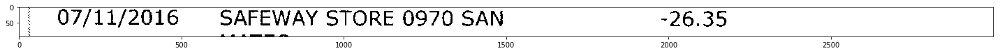

07/11/2016 | SAFEWAY STORE 0970 SAN -26.35
[datetime.date(2016, 7, 11), -26.35, ' | SAFEWAY STORE 0970 SAN ']


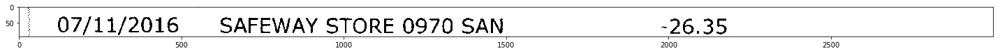

MATEO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MATEO']


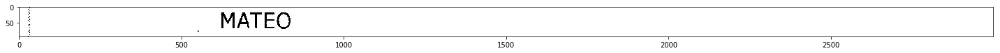

w T

f

os

ea Vt



ae F A ee WF

MATEO

woe Ce Fe MO

ww

wet FONE

*

aN a ww
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'w T\n\nf\n\nos\n\nea Vt\n\n\n\nae F A ee WF\n\nMATEO\n\nwoe Ce Fe MO\n\nww\n\nwet FONE\n\n*\n\naN a ww']


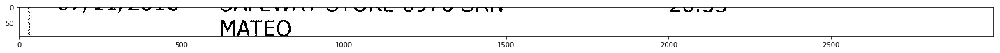

MATEO  } oe
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MATEO  } oe']


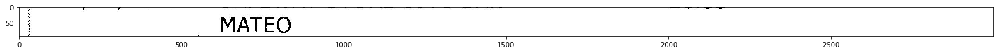

MATEO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MATEO']


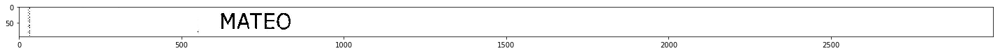


Amount was not detected, re-attempting by removing commas
[None, None, '']


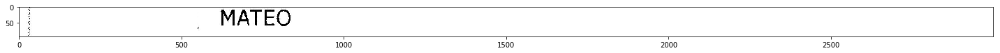

07/11/2016 DR. CRIMMY'S 517-579-3125 -36.25
[datetime.date(2016, 7, 11), -36.25, " DR. CRIMMY'S 517-579-3125 "]


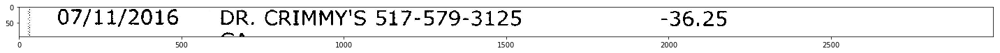

gpm); Fs 2

hom Mm 3» me

‘eet imi saat:
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'gpm); Fs 2\n\nhom Mm 3» me\n\n‘eet imi saat:']


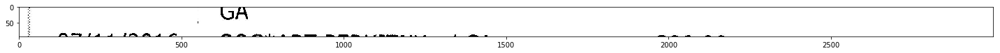

GA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'GA']


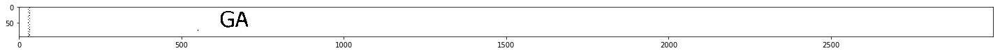


Amount was not detected, re-attempting by removing commas
[None, None, '']


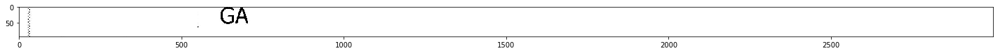

07/11/2016 SQC*ART PERKITNY ./ CA -390.00
[datetime.date(2016, 7, 11), -390.0, ' SQC*ART PERKITNY ./ CA ']


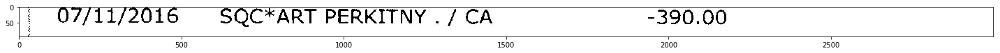

re)? i og gelUdSlC |, OF! 4A Of™ gm PRP Fe ARS PS Fs YS OPA ks sf gn nh ~~ ~~ mr
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 're)? i og gelUdSlC |, OF! 4A Of™ gm PRP Fe ARS PS Fs YS OPA ks sf gn nh -- -- mr']


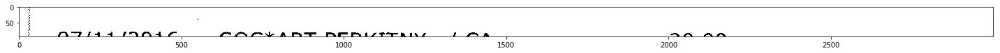


Amount was not detected, re-attempting by removing commas
[None, None, '']


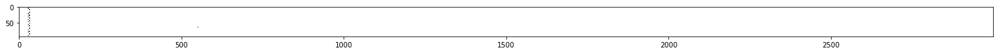

07/11/2016 SQC*ART PERKITNY ./ CA -20.00
[datetime.date(2016, 7, 11), -20.0, ' SQC*ART PERKITNY ./ CA ']


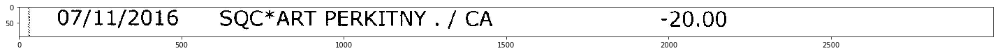

ee ee oe ee ee a a ee ge ms mei), 2 meee ome oe 8 eS tt
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee ee oe ee ee a a ee ge ms mei), 2 meee ome oe 8 eS tt']


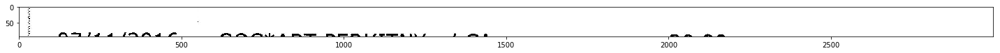


Amount was not detected, re-attempting by removing commas
[None, None, '']


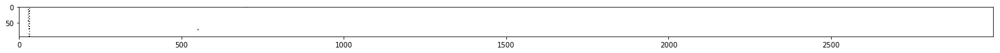

07/11/2016 SQC*ART PERKITNY ./ CA -20.00
[datetime.date(2016, 7, 11), -20.0, ' SQC*ART PERKITNY ./ CA ']


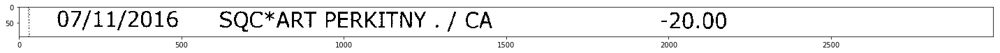

ae ates

Po
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ae ates\n\nPo']


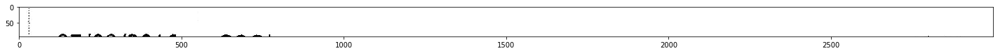


Amount was not detected, re-attempting by removing commas
[None, None, '']


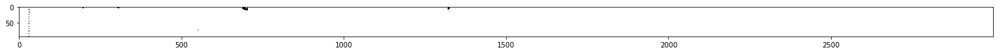

07/08/2016 . SQC* 18.00
[datetime.date(2016, 7, 8), 18.0, ' . SQC*']


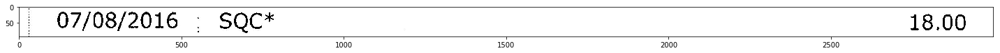

07/06/2016 SQC*ART PERKITNY . / CA -12.25
[datetime.date(2016, 7, 6), -12.25, ' SQC*ART PERKITNY . / CA ']


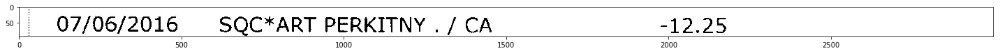


Amount was not detected, re-attempting by removing commas
[None, None, '']


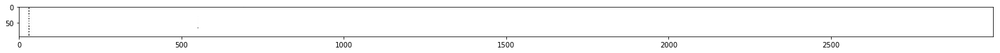

07/06/2016 | PENINSULA FAMILY YMCA 650- -32.00
[datetime.date(2016, 7, 6), -32.0, ' | PENINSULA FAMILY YMCA 650- ']


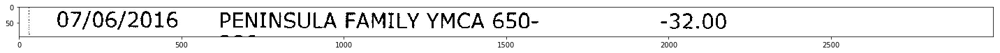


Amount was not detected, re-attempting by removing commas
[None, None, '']


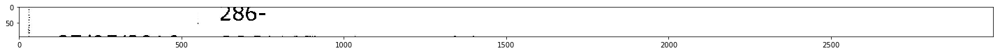

U//UD/LU16 DQOC*ART PERKITNY ./ CA -26.00
Adjusting Window
[None, -26.0, 'U//UD/LU16 DQOC*ART PERKITNY ./ CA ']


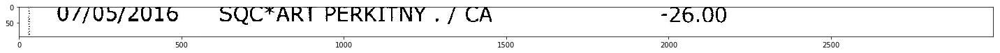

07/05/2016 SQC*ART PERKITNY ./ CA -26.00
[datetime.date(2016, 7, 5), -26.0, ' SQC*ART PERKITNY ./ CA ']


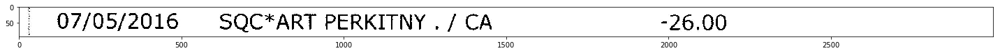


Amount was not detected, re-attempting by removing commas
[None, None, '']


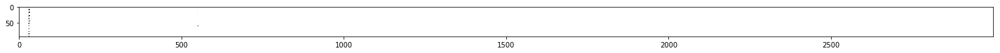

Image (48).jpg
U//UD/Z010 Amazon web services -13.16
[None, -13.16, 'U//UD/Z010 Amazon web services ']


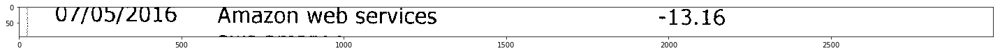

aW>s>.dailliaZonl

Qua ine /OnNsta re 1) ARRAN Se ON RRR Ob o™ UN A OUND lke f!hCUPOA et mm
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aW>s>.dailliaZonl\n\nQua ine /OnNsta re 1) ARRAN Se ON RRR Ob o™ UN A OUND lke f!hCUPOA et mm']


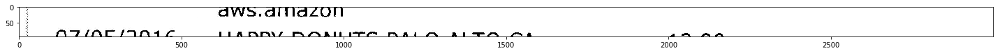

aws.amazon
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aws.amazon']


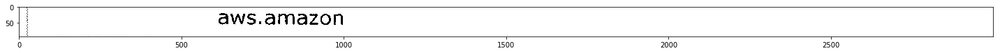

aws.amazon
Amount was not detected, re-attempting by removing commas
[None, None, 'aws.amazon']


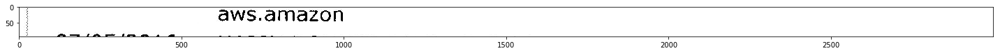

US/UD/ £0109 NAPPY DONUTS PALO ALTO CA -12.90
Adjusting Window
[None, -12.9, 'US/UD/ £0109 NAPPY DONUTS PALO ALTO CA ']


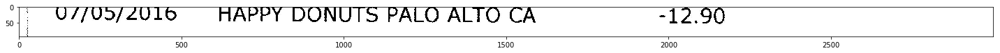

07/05/2016 HAPPY DONUTS PALO ALTO CA -12.90
[datetime.date(2016, 7, 5), -12.9, ' HAPPY DONUTS PALO ALTO CA ']


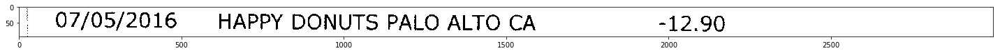


Amount was not detected, re-attempting by removing commas
[None, None, '']


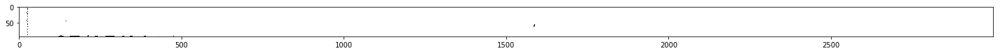

U//03/2016 SQC*ART PERKITNY . / CA -45.00
Adjusting Window
[None, -45.0, 'U//03/2016 SQC*ART PERKITNY . / CA ']


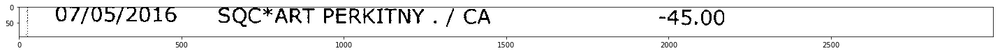

07/05/2016 SQC*ART PERKITNY . / CA -45.00
[datetime.date(2016, 7, 5), -45.0, ' SQC*ART PERKITNY . / CA ']


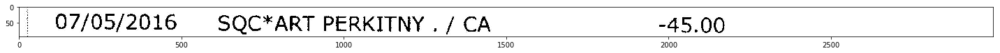


Amount was not detected, re-attempting by removing commas
[None, None, '']


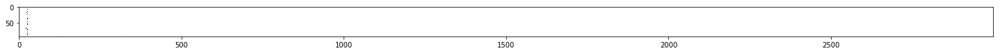

Q7/05/2016 SQC*ART PERKITNY . / CA -28.50
Adjusting Window
[None, -28.5, 'Q7/05/2016 SQC*ART PERKITNY . / CA ']


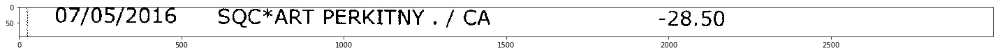

07/05/2016 SQC*ART PERKITNY . / CA -28.50
[datetime.date(2016, 7, 5), -28.5, ' SQC*ART PERKITNY . / CA ']


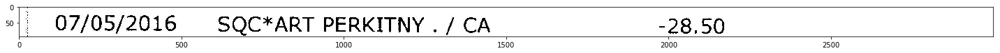


Amount was not detected, re-attempting by removing commas
[None, None, '']


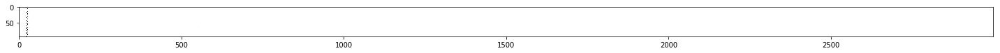

07/05/2016 SQC*ART PERKITNY ./ CA -1,100.00
Amount was not detected, re-attempting by removing commas
[datetime.date(2016, 7, 5), -1100.0, ' SQC*ART PERKITNY ./ CA -1,100.00']


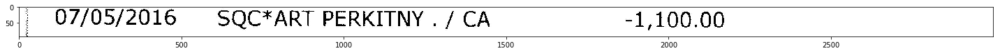

ee ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee ee']


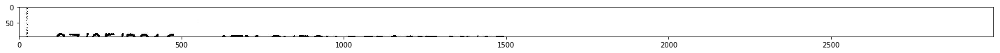


Amount was not detected, re-attempting by removing commas
[None, None, '']


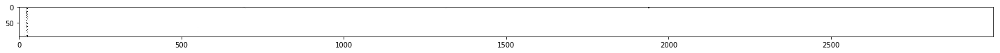

07/05/2016 ATM CHECK DEPOSIT 07/05 390.00
[datetime.date(2016, 7, 5), 390.0, ' ATM CHECK DEPOSIT 07/05']


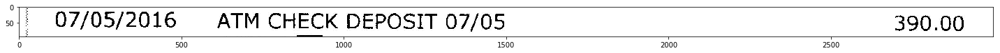


Amount was not detected, re-attempting by removing commas
[None, None, '']


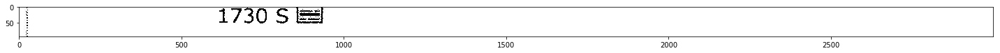


Amount was not detected, re-attempting by removing commas
[None, None, '']


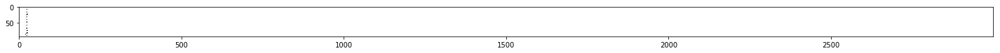


Amount was not detected, re-attempting by removing commas
[None, None, '']


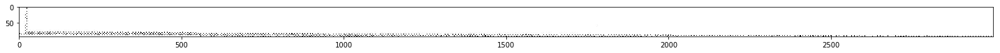


Amount was not detected, re-attempting by removing commas
[None, None, '']


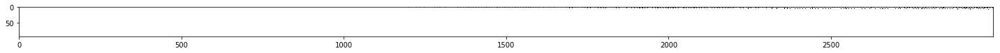


Amount was not detected, re-attempting by removing commas
[None, None, '']


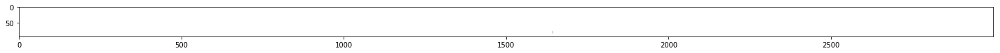


Amount was not detected, re-attempting by removing commas
[None, None, '']


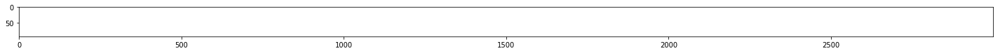


Amount was not detected, re-attempting by removing commas
[None, None, '']


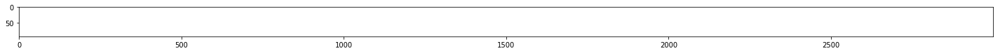


Amount was not detected, re-attempting by removing commas
[None, None, '']


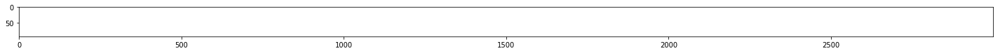


Amount was not detected, re-attempting by removing commas
[None, None, '']


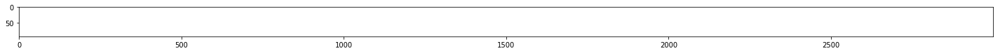


Amount was not detected, re-attempting by removing commas
[None, None, '']


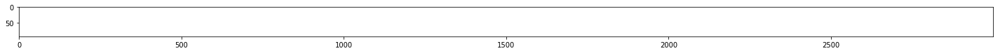


Amount was not detected, re-attempting by removing commas
[None, None, '']


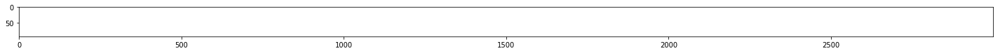


Amount was not detected, re-attempting by removing commas
[None, None, '']


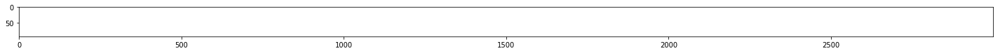


Amount was not detected, re-attempting by removing commas
[None, None, '']


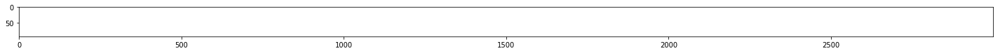


Amount was not detected, re-attempting by removing commas
[None, None, '']


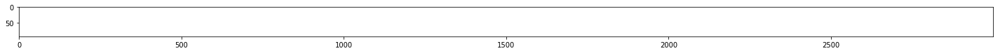


Amount was not detected, re-attempting by removing commas
[None, None, '']


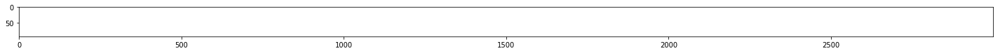


Amount was not detected, re-attempting by removing commas
[None, None, '']


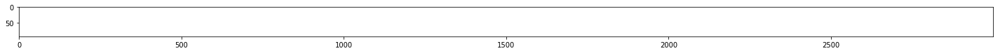


Amount was not detected, re-attempting by removing commas
[None, None, '']


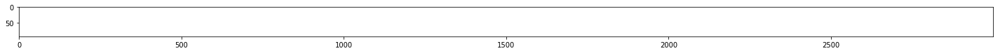


Amount was not detected, re-attempting by removing commas
[None, None, '']


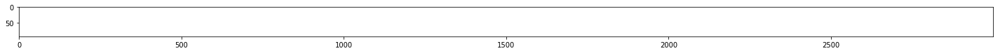


Amount was not detected, re-attempting by removing commas
[None, None, '']


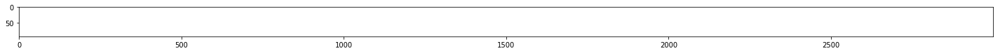

Image (49).jpg
12/28/2016 WINDY CITY SAN MATEO CA -34.41
[datetime.date(2016, 12, 28), -34.41, ' WINDY CITY SAN MATEO CA ']


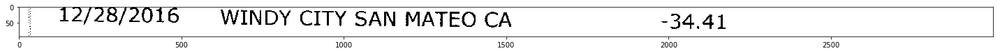

45h /A "93 AA 4a eligi ei: Sue a et ee a a
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '45h /A -93 AA 4a eligi ei: Sue a et ee a a']


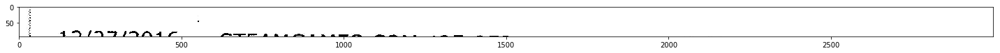


Amount was not detected, re-attempting by removing commas
[None, None, '']


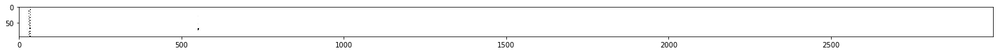

12/27/2016 STEAMGAMES.COM 425-952- -5.00
[datetime.date(2016, 12, 27), -5.0, ' STEAMGAMES.COM 425-952- ']


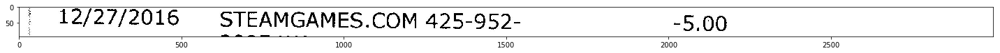

25509 WA

QZ ™|™|, Fy w 3 Fey OX SC Si ie ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '25509 WA\n\nQZ ™|™|, Fy w 3 Fey OX SC Si ie ee']


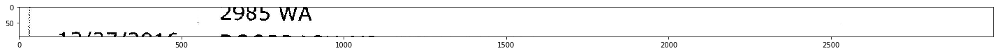

2985 WA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '2985 WA']


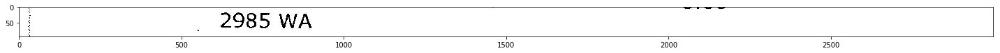

2985 WA
Amount was not detected, re-attempting by removing commas
[None, None, '2985 WA']


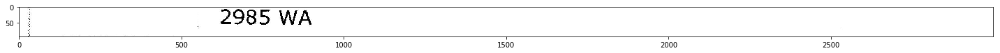

12/2//2016 DOORDASH-MR. PIZZA MA 650- -25.46

gm rs.
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '12/2//2016 DOORDASH-MR. PIZZA MA 650- -25.46\n\ngm rs.']


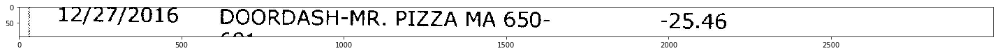

12/27/2016 DOORDASH-MR. PIZZA MA 650- -25 46
[datetime.date(2016, 12, 27), -25.46, ' DOORDASH-MR. PIZZA MA 650- ']


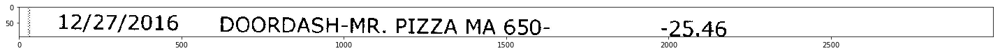

681-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '681-']


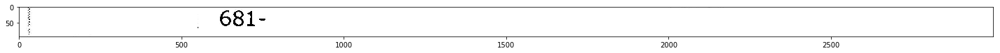

if

ee EN Pe

681-

TENG

& oe ef NL

UPN Ne

I NS

 ewe TU
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'if\n\nee EN Pe\n\n681-\n\nTENG\n\n& oe ef NL\n\nUPN Ne\n\nI NS\n\n ewe TU']


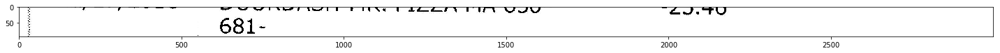

re EO GEESE erases ey eel Ne I PR owe ww et Fe

681-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 're EO GEESE erases ey eel Ne I PR owe ww et Fe\n\n681-']


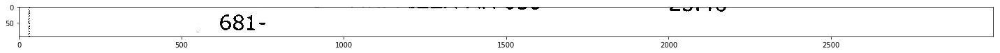

681-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '681-']


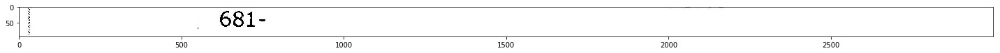

sume pine lh mma rate cre aes

681-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'sume pine lh mma rate cre aes\n\n681-']


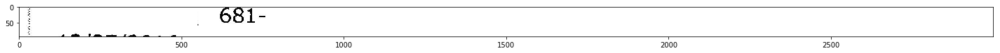

aN INTIS Ae
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aN INTIS Ae']


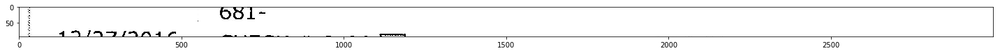

VU0OlL™
497/97 /9NAL Pmt imermy ofl tae Pe
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'VU0OlL™\n497/97 /9NAL Pmt imermy ofl tae Pe']


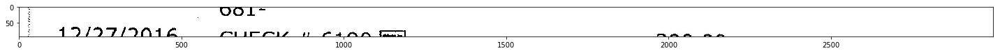

NAS

1O/DTIINAG PUcerv + CAN fee ARK NN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NAS\n\n1O/DTIINAG PUcerv + CAN fee ARK NN']


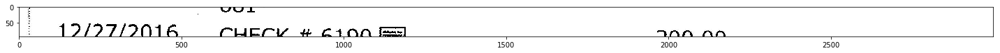

12/27/2016 | CHECK # G100 F£ “INN nN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 27), None, ' | CHECK # G100 F£ “INN nN']


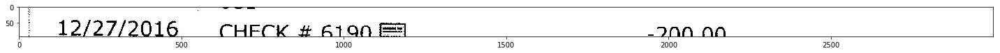

12/27/2016 CHECK #6190 -INN NN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 27), None, ' CHECK #6190 -INN NN']


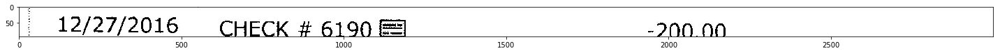

12/27/2016 CHECK # 6190 -200.00
[datetime.date(2016, 12, 27), -200.0, ' CHECK # 6190 ']


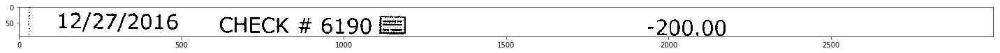

12/27/2016 WILLOW COVE GAS MENLO -§ 28
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 27), None, ' WILLOW COVE GAS MENLO -§ 28']


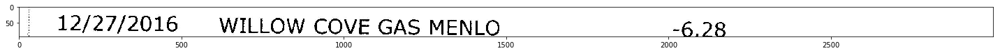

et BOOP Gee Net FO le we NF htt e42vVvuVU, VU

TO/2I7/0NN16 VAITL TOW COVE CAC mean roo
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'et BOOP Gee Net FO le we NF htt e42vVvuVU, VU\n\nTO/2I7/0NN16 VAITL TOW COVE CAC mean roo']


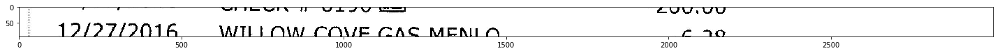

ee See See ee ee

12/27/2016 WT LOW COVE GAS MENIO _£ 92
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 27), None, 'ee See See ee ee\n\n WT LOW COVE GAS MENIO _£ 92']


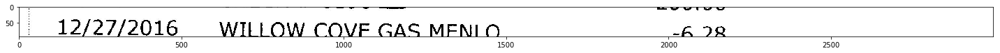

12/27/2016 WILLOW COVE GAS MENLO -§ 28
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 27), None, ' WILLOW COVE GAS MENLO -§ 28']


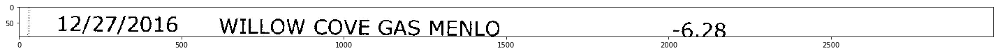

12/27/2016 WILLOW COVE GAS MENLO -6.28
[datetime.date(2016, 12, 27), -6.28, ' WILLOW COVE GAS MENLO ']


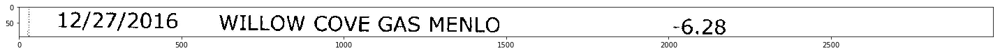

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


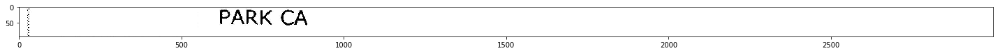


Amount was not detected, re-attempting by removing commas
[None, None, '']


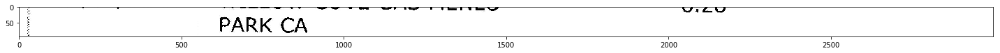

12/27/2016 WILLOW COVE GAS MENLO -6.78
[datetime.date(2016, 12, 27), -6.78, ' WILLOW COVE GAS MENLO ']


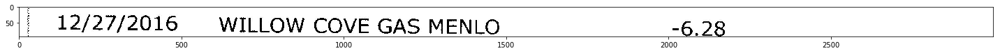

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


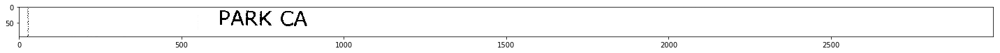

SF me Bee fe ee” OU

PARK CA

hw

bee

5 Pet WLS

Me eO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'SF me Bee fe ee” OU\n\nPARK CA\n\nhw\n\nbee\n\n5 Pet WLS\n\nMe eO']


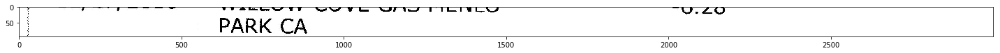

PARK CA _
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA _']


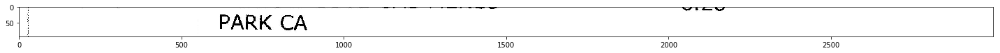

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


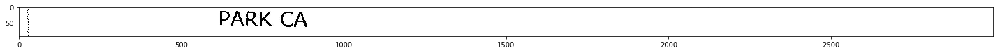

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


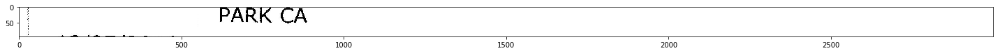

Lef/2//Z016 A&S 76 MENLO PARK CA -2.78
Adjusting Window
[None, -2.78, 'Lef/2//Z016 A&S 76 MENLO PARK CA ']


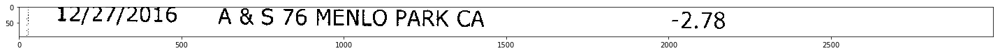

12/27/2016 A&S 76 MENLO PARK CA -)2 7/8
Adjusting Window
[datetime.date(2016, 12, 27), None, ' A&S 76 MENLO PARK CA -)2']


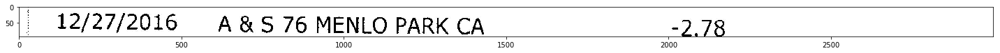

12/27/2016 A&S 76 MENLO PARK CA -2./8
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 27), None, ' A&S 76 MENLO PARK CA -2./8']


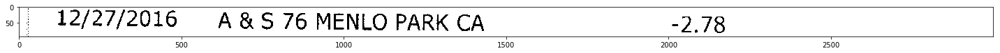

12/27/2016 A®&S 76 MENLO PARK CA -2.78
[datetime.date(2016, 12, 27), -2.78, ' A®&S 76 MENLO PARK CA ']


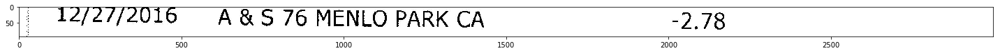

44m / a3 FT 4

 - meme ey
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '44m / a3 FT 4\n\n - meme ey']


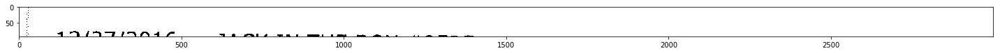


Amount was not detected, re-attempting by removing commas
[None, None, '']


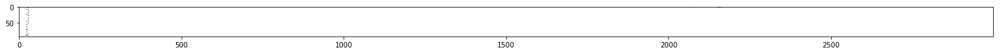

12/27/2016 JACK IN THE BOX #0525 -13.37
[datetime.date(2016, 12, 27), -13.37, ' JACK IN THE BOX #0525 ']


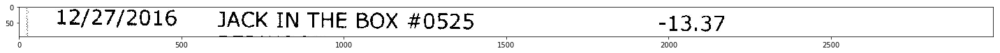

REDWOOD
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'REDWOOD']


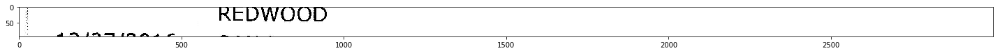

REDWOOD
Amount was not detected, re-attempting by removing commas
[None, None, 'REDWOOD']


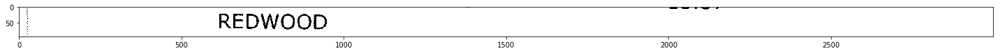

12/27/2016 SAN MATEO SAN MATEO CA -6.48
[datetime.date(2016, 12, 27), -6.48, ' SAN MATEO SAN MATEO CA ']


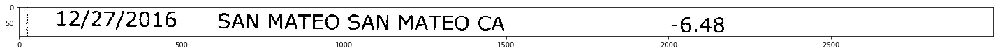


Amount was not detected, re-attempting by removing commas
[None, None, '']


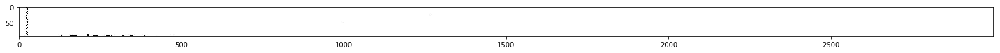

LZ/2/7/2V160 CHEVRON 0091081 EAST PALO -42.06
Adjusting Window
[None, -42.06, 'LZ/2/7/2V160 CHEVRON 0091081 EAST PALO ']


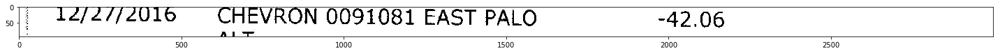

12/27/2016 CHEVRON 0091081 EAST PALO -42.06
[datetime.date(2016, 12, 27), -42.06, ' CHEVRON 0091081 EAST PALO ']


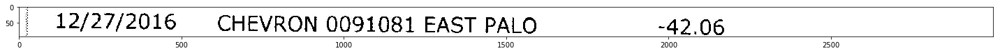

ALT
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ALT']


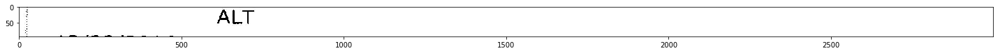

_ beef Nie 8

4%

Tae Ne
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '_ beef Nie 8\n\n4%\n\nTae Ne']


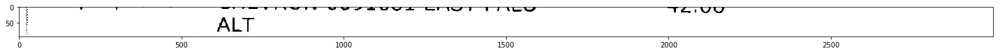

ALT
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ALT']


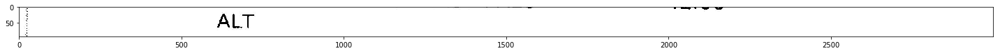

ALT
Amount was not detected, re-attempting by removing commas
[None, None, 'ALT']


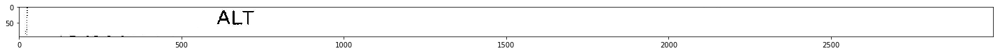

12/23/2016 WALGREENS STORE 191 E SAN -64.88

BRBLAA 
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 23), None, ' WALGREENS STORE 191 E SAN -64.88\n\nBRBLAA ']


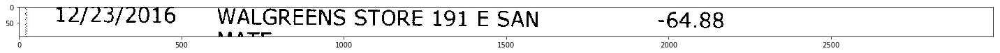

12/23/2016 ©WALGREENS STORE 191 E SAN -64.88
[datetime.date(2016, 12, 23), -64.88, ' ©WALGREENS STORE 191 E SAN ']


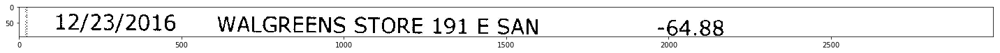

MATE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MATE']


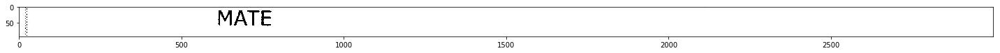

SEE Soa: a ee ON ee Re NN ee a ON VT. OOo

MATE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'SEE Soa: a ee ON ee Re NN ee a ON VT. OOo\n\nMATE']


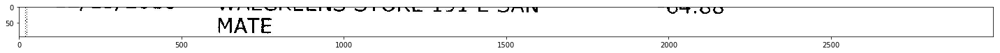

MATE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MATE']


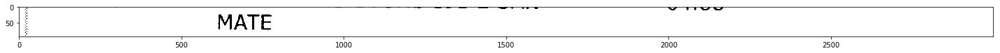

MATE
Amount was not detected, re-attempting by removing commas
[None, None, 'MATE']


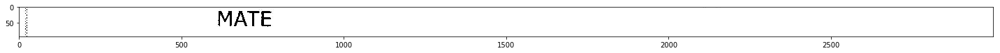

12/23/2016 7-ELEVEN SAN MATEO CA -2.99
[datetime.date(2016, 12, 23), -2.99, ' 7-ELEVEN SAN MATEO CA ']


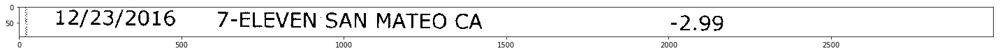

2 m™) Fem me Jom me 5
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '2 m™) Fem me Jom me 5']


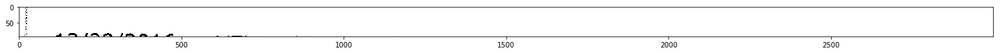


Amount was not detected, re-attempting by removing commas
[None, None, '']


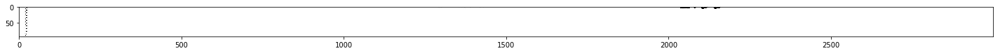

12/22/2016 VZWRLSS*APOCC VISN 800- -107.42
[datetime.date(2016, 12, 22), -107.42, ' VZWRLSS*APOCC VISN 800- ']


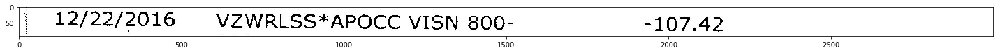

ia ae ee

922-Q20
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ia ae ee\n\n922-Q20']


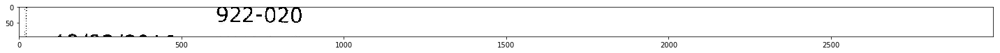

922-020
Adjusting Window
[None, -20.0, '922']


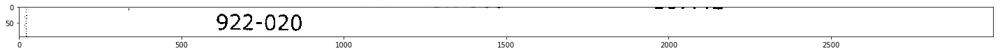

922-020
[None, -20.0, '922']


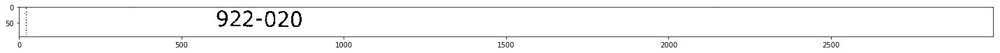

12/22/2016 HABIT-SAN MATEO #50 SAN -19.99
[datetime.date(2016, 12, 22), -19.99, ' HABIT-SAN MATEO #50 SAN ']


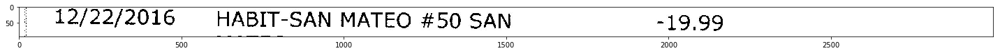

as m™) iF w™| om Fo mM El

TCO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'as m™) iF w™| om Fo mM El\n\nTCO']


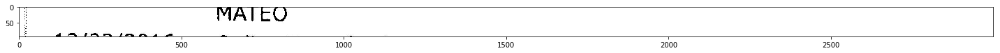

MATEO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MATEO']


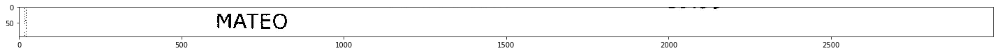


Amount was not detected, re-attempting by removing commas
[None, None, '']


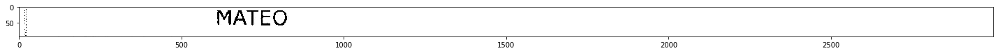

12/22/2016 Online Transfer from SAV ...03 200.00
[datetime.date(2016, 12, 22), 200.0, ' Online Transfer from SAV ...03']


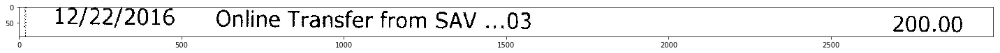

@™ fm we ftom Mm a OP
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '@™ fm we ftom Mm a OP']


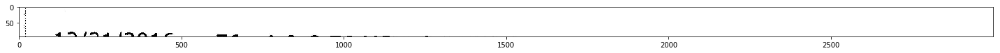

Bn _w SO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Bn _w SO']


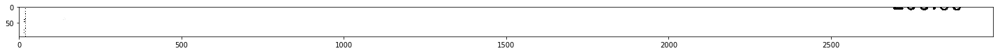


Amount was not detected, re-attempting by removing commas
[None, None, '']


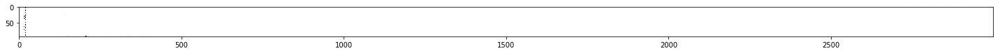

12/21/2016 76-A8&S 76 MENLO PARK CA -15.00
[datetime.date(2016, 12, 21), -15.0, ' 76-A8&S 76 MENLO PARK CA ']


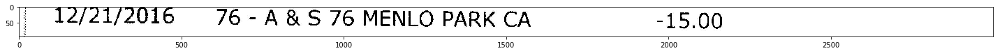


Amount was not detected, re-attempting by removing commas
[None, None, '']


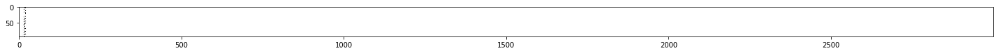

Image (5).jpg
05/08/2017 MICROSOFT *OFFICE 3 800- -7.55
[datetime.date(2017, 5, 8), -7.55, ' MICROSOFT *OFFICE 3 800- ']


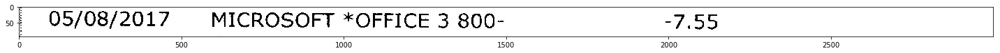

642-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '642-']


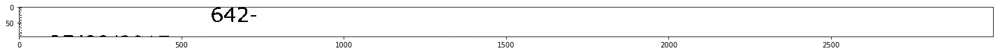

642-
Amount was not detected, re-attempting by removing commas
[None, None, '642-']


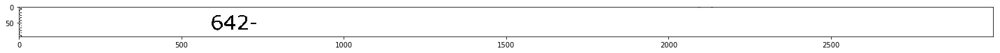

05/08/2017 BELMONT BP CHICAGO IL -4.61
[datetime.date(2017, 5, 8), -4.61, ' BELMONT BP CHICAGO IL ']


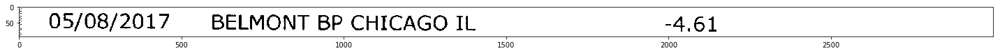


Amount was not detected, re-attempting by removing commas
[None, None, '']


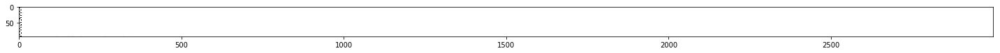

05/08/2017 BELMONT BP CHICAGO IL -6.69
[datetime.date(2017, 5, 8), -6.69, ' BELMONT BP CHICAGO IL ']


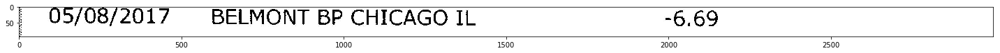

fe PF FPR I~ fai |

rps.

maaeav™ &8 e wpe re CO

ee ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'fe PF FPR I~ fai |\n\nrps.\n\nmaaeav™ &8 e wpe re CO\n\nee ee']


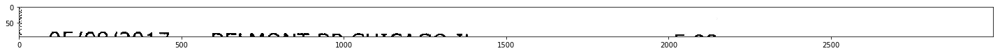


Amount was not detected, re-attempting by removing commas
[None, None, '']


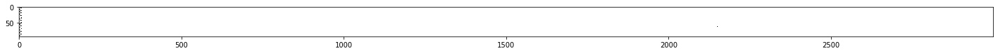

05/08/2017 BELMONT BP CHICAGO IL -5.92
[datetime.date(2017, 5, 8), -5.92, ' BELMONT BP CHICAGO IL ']


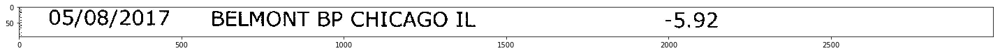

algae’: mes Sam lm alas
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'algae’: mes Sam lm alas']


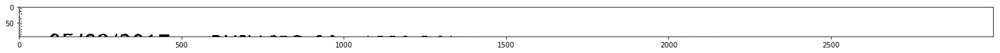


Amount was not detected, re-attempting by removing commas
[None, None, '']


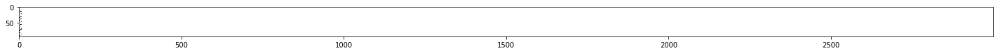

05/08/2017 PHILLIPS 66 - 1039 PORT -2.66
[datetime.date(2017, 5, 8), -2.66, ' PHILLIPS 66 - 1039 PORT ']


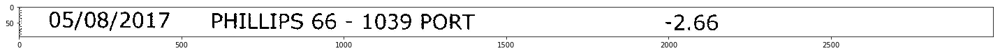

PORTER
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PORTER']


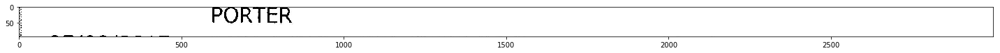

PORTER
Amount was not detected, re-attempting by removing commas
[None, None, 'PORTER']


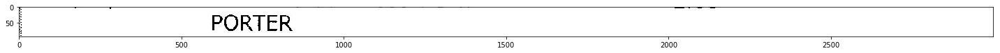

05/08/2017 PAPA RAY'S PIZZA CHICAGO IL -23.19
[datetime.date(2017, 5, 8), -23.19, " PAPA RAY'S PIZZA CHICAGO IL "]


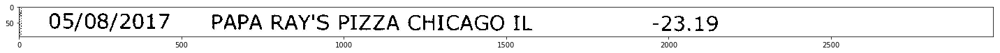


Amount was not detected, re-attempting by removing commas
[None, None, '']


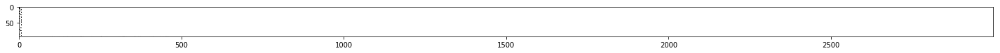

05/08/2017 EXPRESSVPN 310-6018492 DE -12.95
[datetime.date(2017, 5, 8), -12.95, ' EXPRESSVPN 310-6018492 DE ']


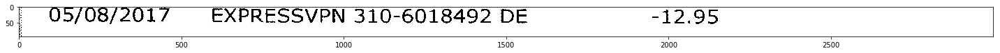

frre i nonlin nas

RAS™F*D.” AR AT A 1 Pr E™ URC ROA OOO .D.ClUCOC MIL OO OAR Ol!

s/s)
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'frre i nonlin nas\n\nRAS™F*D.” AR AT A 1 Pr E™ URC ROA OOO .D.ClUCOC MIL OO OAR Ol!\n\ns/s)']


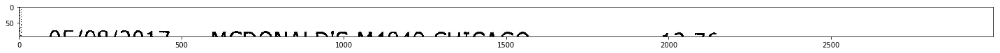


Amount was not detected, re-attempting by removing commas
[None, None, '']


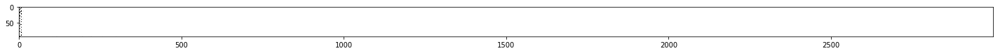

05/08/2017 MCDONALD'S M4849 CHICAGO -12.76
[datetime.date(2017, 5, 8), -12.76, " MCDONALD'S M4849 CHICAGO "]


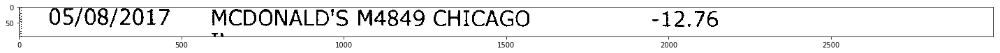

roe ont fot mat Le eae’ ee | a smMmRoATF§1™: ato. mM ™™ 2p aw mmm) iw ee hUrlUl Oe
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'roe ont fot mat Le eae’ ee | a smMmRoATF§1™: ato. mM ™™ 2p aw mmm) iw ee hUrlUl Oe']


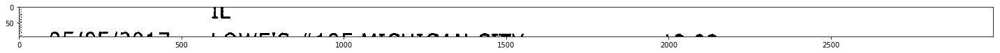

IL
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'IL']


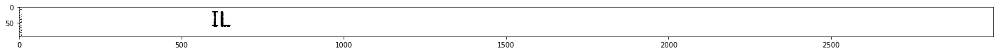

IL
Amount was not detected, re-attempting by removing commas
[None, None, 'IL']


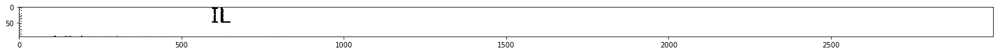

Q3/05/2017 LOWES #195 MICHIGAN CITY -13.93
Adjusting Window
[None, -13.93, 'Q3/05/2017 LOWES #195 MICHIGAN CITY ']


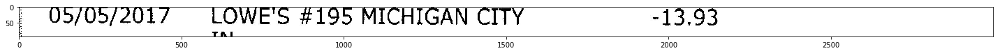

05/05/2017 LOWE'S #195 MICHIGAN CITY -13.93
[datetime.date(2017, 5, 5), -13.93, " LOWE'S #195 MICHIGAN CITY "]


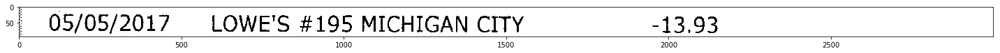

IN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'IN']


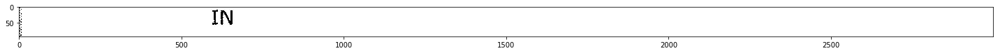

ge ee ge ae ta nee ey ae ee a ae eel ee eee lee OD ae Ft

IN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ge ee ge ae ta nee ey ae ee a ae eel ee eee lee OD ae Ft\n\nIN']


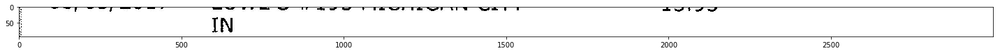

IN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'IN']


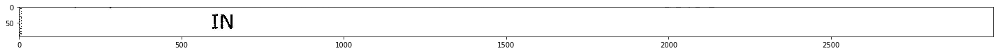

IN
Amount was not detected, re-attempting by removing commas
[None, None, 'IN']


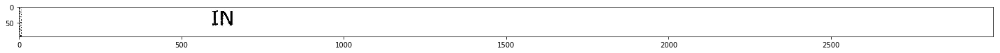

05/04/2017 BELMONT BP CHICAGO IL -4.72
[datetime.date(2017, 5, 4), -4.72, ' BELMONT BP CHICAGO IL ']


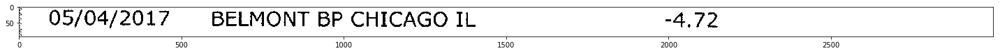

~~ F 2 oe

aS oe See ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '-- F 2 oe\n\naS oe See ee']


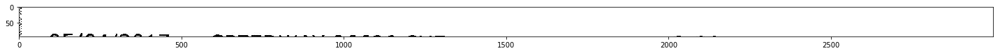


Amount was not detected, re-attempting by removing commas
[None, None, '']


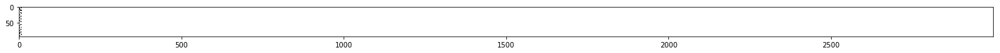

05/04/2017 SPEEDWAY 06686 CHE -2.66
[datetime.date(2017, 5, 4), -2.66, ' SPEEDWAY 06686 CHE ']


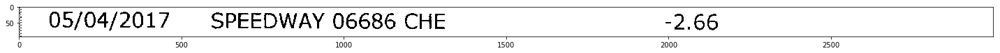

CHESTERTON
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CHESTERTON']


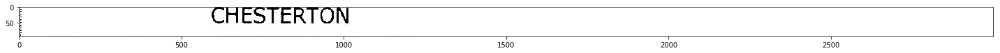

CHESTERTON
Amount was not detected, re-attempting by removing commas
[None, None, 'CHESTERTON']


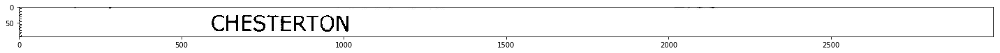

05/03/2017 SUNOCO 07851488 ELKHART -5.72
[datetime.date(2017, 5, 3), -5.72, ' SUNOCO 07851488 ELKHART ']


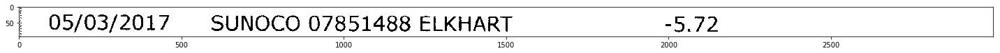

IN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'IN']


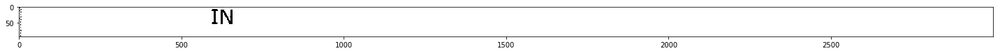

i Sens Senn  NO II RIOD SEE EEO EE OE

IN

as.rclcmc., *
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'i Sens Senn  NO II RIOD SEE EEO EE OE\n\nIN\n\nas.rclcmc., *']


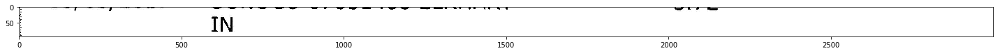

IN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'IN']


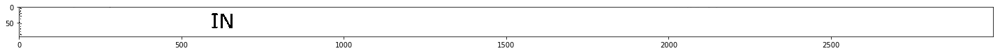

IN
Amount was not detected, re-attempting by removing commas
[None, None, 'IN']


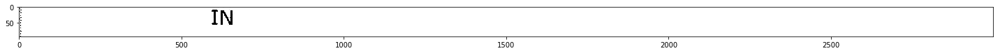

05/03/2017 Amazon web services -12.41
[datetime.date(2017, 5, 3), -12.41, ' Amazon web services ']


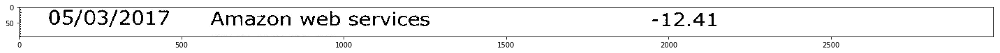

aWs.dimadazorn)

ee ee ee ia te es ae
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aWs.dimadazorn)\n\nee ee ee ia te es ae']


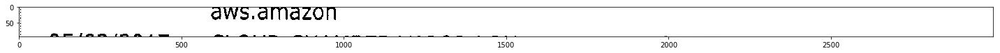

aws.amazon
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aws.amazon']


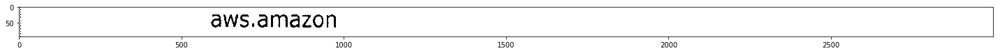

aws.amazon
Amount was not detected, re-attempting by removing commas
[None, None, 'aws.amazon']


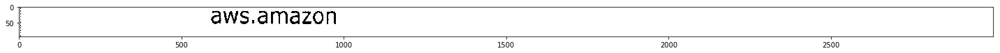

05/03/2017 CLOUD CHAMBER VAPOR LOU -21.35

®t sF”X BOO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 5, 3), None, ' CLOUD CHAMBER VAPOR LOU -21.35\n\n®t sF”X BOO']


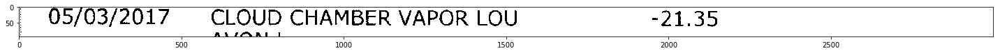

05/03/2017 CLOUD CHAMBER VAPOR LOU -21.35
[datetime.date(2017, 5, 3), -21.35, ' CLOUD CHAMBER VAPOR LOU ']


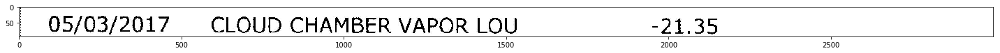

VON L
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'VON L']


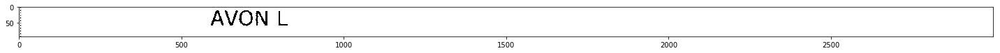

_ pa ss  eS Ne EO Pre Ew NEN ee ew NU a. he 4

AVON
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '_ pa ss  eS Ne EO Pre Ew NEN ee ew NU a. he 4\n\nAVON']


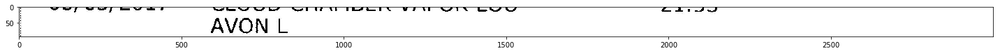


Amount was not detected, re-attempting by removing commas
[None, None, '']


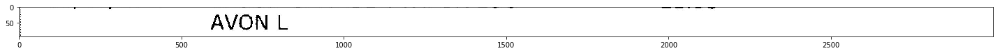

05/01/2017 Dropbox*JRPDJ4YQ4JGK -9.99
[datetime.date(2017, 5, 1), -9.99, ' Dropbox*JRPDJ4YQ4JGK ']


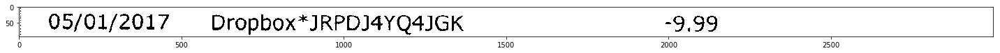

db.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'db.tt/cch']


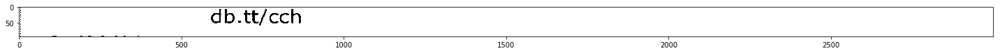

 ae ee ee oe

db. tt/cch |
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, ' ae ee ee oe\n\ndb. tt/cch |']


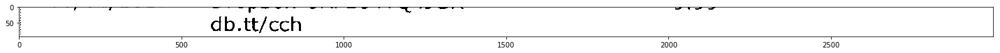

db.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'db.tt/cch']


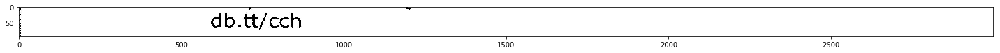

db.tt/cch
Amount was not detected, re-attempting by removing commas
[None, None, 'db.tt/cch']


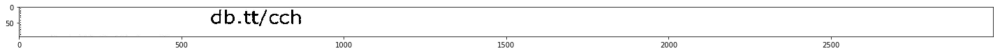

04/28/2017. HOMEGOODS 35894 DETROI -66.14
[datetime.date(2017, 4, 28), -66.14, '. HOMEGOODS 35894 DETROI ']


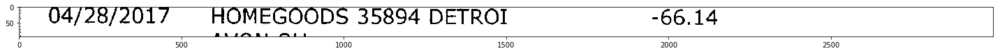

AVUN UF
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AVUN UF']


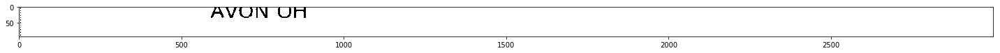

AVON OH
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AVON OH']


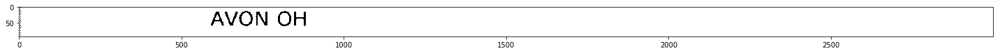

AVON OH
Amount was not detected, re-attempting by removing commas
[None, None, 'AVON OH']


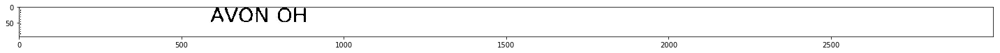

Image (50).jpg
12/21/2016 | AMAZON MKTPLACE PMTS -10.27
[datetime.date(2016, 12, 21), -10.27, ' | AMAZON MKTPLACE PMTS ']


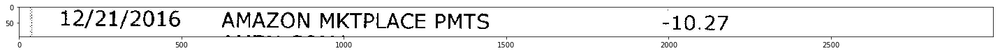

aw

mec

iii: ss

AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aw\n\nmec\n\niii: ss\n\nAMZN.COM/']


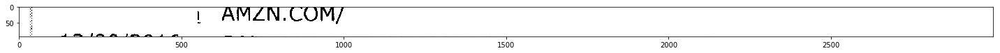

| AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| AMZN.COM/']


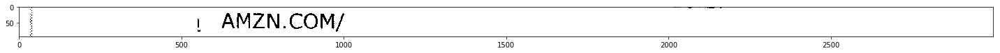


Amount was not detected, re-attempting by removing commas
[None, None, '']


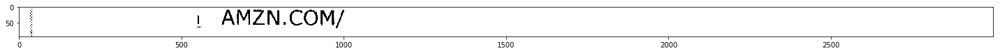

12/20/2016 SAN MATEO SAN MATEO CA -4.39
[datetime.date(2016, 12, 20), -4.39, ' SAN MATEO SAN MATEO CA ']


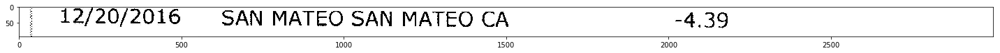

a

_

com™

gf~y F™!, ™ BD

cm

Se ee

pies gle ek hl nil
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'a\n\n_\n\ncom™\n\ngf~y F™!, ™ BD\n\ncm\n\nSe ee\n\npies gle ek hl nil']


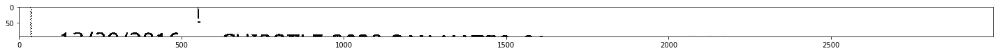


Amount was not detected, re-attempting by removing commas
[None, None, '']


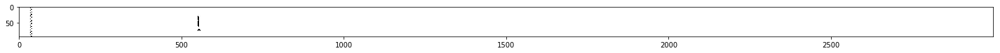

12/20/2016 CHIPOTLE 2028 SAN MATEO CA -10.11
[datetime.date(2016, 12, 20), -10.11, ' CHIPOTLE 2028 SAN MATEO CA ']


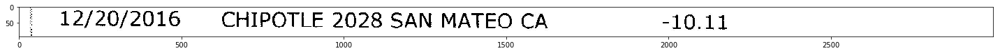

A ™| Fh, mM fi ome, Mm es
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'A ™| Fh, mM fi ome, Mm es']


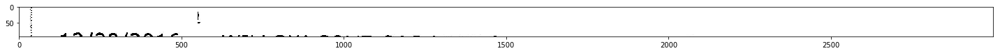


Amount was not detected, re-attempting by removing commas
[None, None, '']


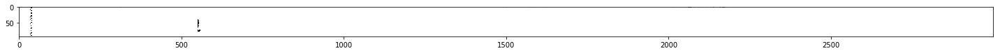

12/20/2016 WILLOW COVE GAS MENLO -15.00
[datetime.date(2016, 12, 20), -15.0, ' WILLOW COVE GAS MENLO ']


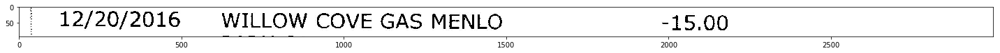

| PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| PARK CA']


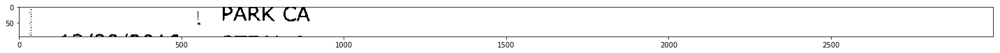

| PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, '| PARK CA']


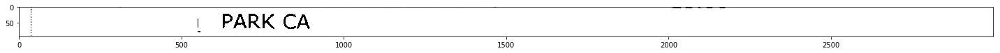

12/20/2016 §STEAMGAMES.COM42595229 -5.00
[datetime.date(2016, 12, 20), -5.0, ' §STEAMGAMES.COM42595229 ']


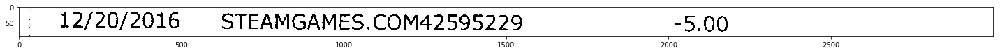

| 425-952
Adjusting Window
[None, None, '|']


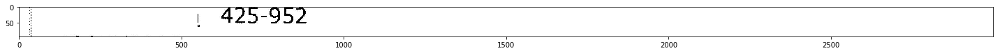

, 425-952 
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, ', 425-952 ']


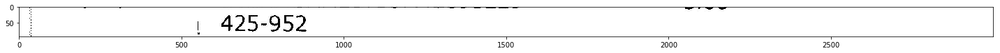

| 425-952
Adjusting Window
[None, None, '|']


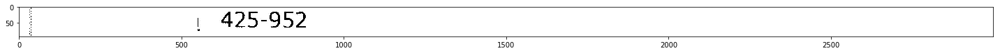

| 425-952
[None, None, '|']


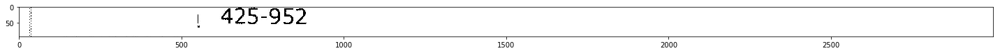

12/19/2016 USPS PO 05580401 380 H PALO -0.96
[datetime.date(2016, 12, 19), -0.96, ' USPS PO 05580401 380 H PALO ']


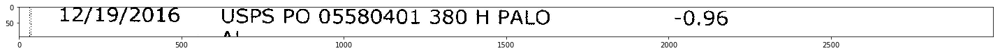

@q@ ™ fa fu 1A 4

RAT:

~~ oar

a a

re gms 2 ™

nn
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '@q@ ™ fa fu 1A 4\n\nRAT:\n\n-- oar\n\na a\n\nre gms 2 ™\n\nnn']


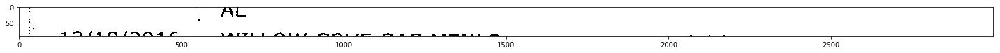


Amount was not detected, re-attempting by removing commas
[None, None, '']


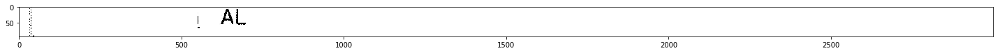

12/19/2016 WILLOW COVE GAS MENLO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 19), None, ' WILLOW COVE GAS MENLO']


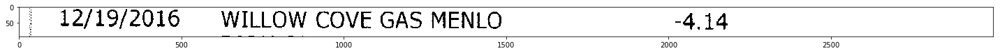

12/19/2016 WILLOW COVE GAS MENLO -414
[datetime.date(2016, 12, 19), -414.0, ' WILLOW COVE GAS MENLO ']


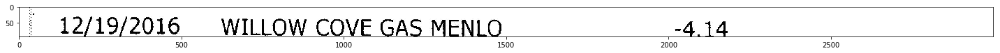

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


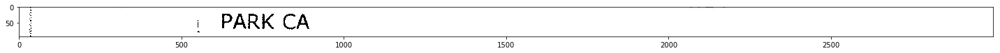

ae oe Mi oe Vier VY VR WAS OP ILINLA TT. LF

i; PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ae oe Mi oe Vier VY VR WAS OP ILINLA TT. LF\n\ni; PARK CA']


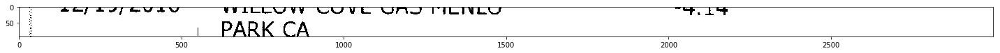

EE SE Ee 2 a a  A ee ee ee I Oe te mh F

| PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'EE SE Ee 2 a a  A ee ee ee I Oe te mh F\n\n| PARK CA']


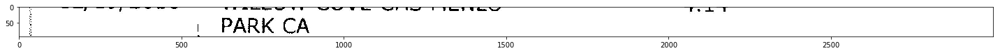

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


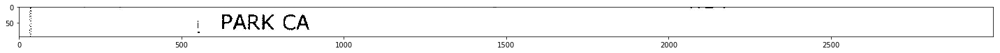

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


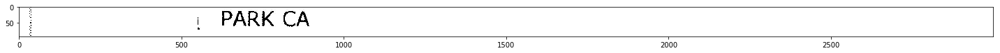

12/19/2016 WILLOW COVE GAS MENLO -3.63
[datetime.date(2016, 12, 19), -3.63, ' WILLOW COVE GAS MENLO ']


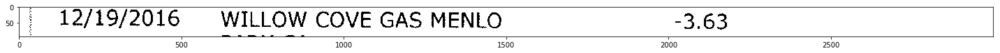

| FARKK CA

ar ee a ar a ee ee re
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| FARKK CA\n\nar ee a ar a ee ee re']


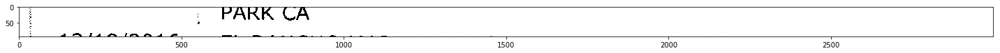

_ PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '_ PARK CA']


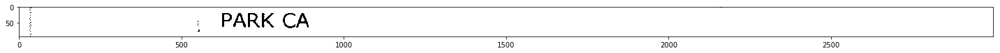

| PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| PARK CA']


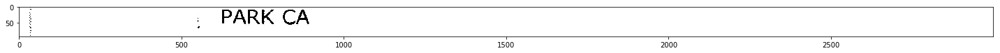

| PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, '| PARK CA']


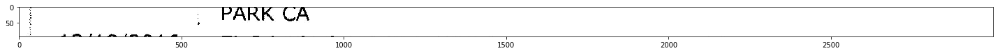

1Zf/is/ZUL0 CL RANCHO MARKE MENLO -27.26

NAMI STA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '1Zf/is/ZUL0 CL RANCHO MARKE MENLO -27.26\n\nNAMI STA']


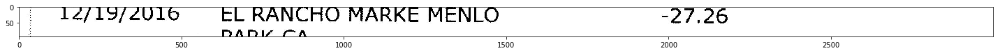

12/19/2016 EL RANCHO MARKE MENLO -27.26
[datetime.date(2016, 12, 19), -27.26, ' EL RANCHO MARKE MENLO ']


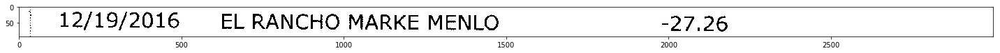

| PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| PARK CA']


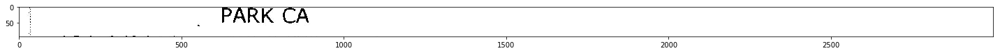

| PARK CA |
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| PARK CA |']


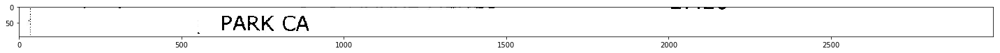

| PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| PARK CA']


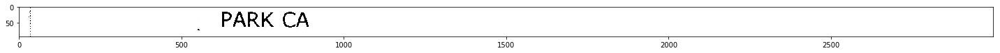

| PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, '| PARK CA']


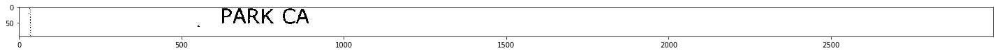

12/19/2016 IMR BATTERIES 713-781-9400 -4.35
[datetime.date(2016, 12, 19), -4.35, ' IMR BATTERIES 713-781-9400 ']


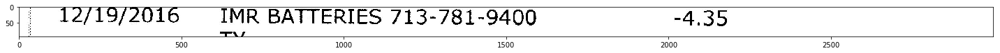

1A

qn /4amfians+o VrrmrrookA AR fof Arr RRNrm)orErnr @ahrTrmrama eel wei i.
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '1A\n\nqn /4amfians+o VrrmrrookA AR fof Arr RRNrm)orErnr @ahrTrmrama eel wei i.']


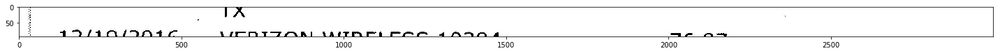


Amount was not detected, re-attempting by removing commas
[None, None, '']


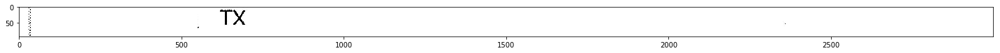

12/19/2016 VERIZON WIRELESS 10384 -76.87

PFN At OP™!.DUCOACH
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 19), None, ' VERIZON WIRELESS 10384 -76.87\n\nPFN At OP™!.DUCOACH']


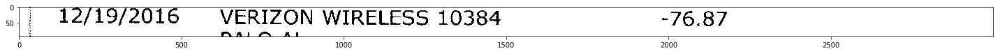

12/19/2016 VERIZON WIRELESS 10384 -76.87
[datetime.date(2016, 12, 19), -76.87, ' VERIZON WIRELESS 10384 ']


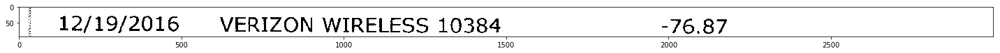

PALO AL
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PALO AL']


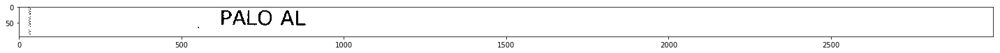

Te See SO ee 2 SS aw Ne oe SF ES Re Bee Freee Neel tel ele ee FN aN TF

PALO AL
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Te See SO ee 2 SS aw Ne oe SF ES Re Bee Freee Neel tel ele ee FN aN TF\n\nPALO AL']


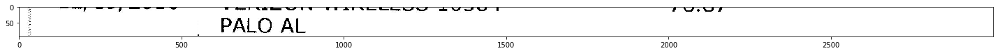

PALO AL
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PALO AL']


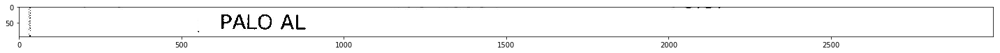

PALO AL
Amount was not detected, re-attempting by removing commas
[None, None, 'PALO AL']


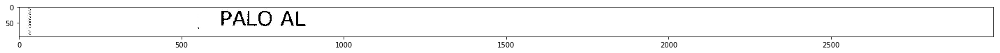

12/16/2016 WILLOW COVE GAS MENLO -3.99

eee we tee ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 16), None, ' WILLOW COVE GAS MENLO -3.99\n\neee we tee ee']


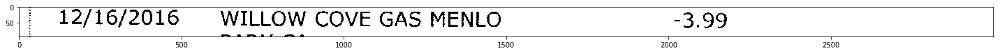

12/16/2016 WILLOW COVE GAS MENLO -3,99
, istead of . was detected, chainging
[datetime.date(2016, 12, 16), -3.99, ' WILLOW COVE GAS MENLO ']


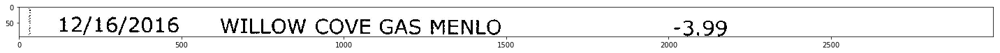

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


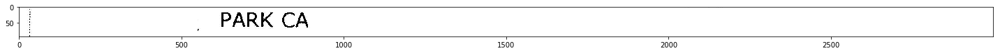

 a ee wre ew Eee ON rE NY dd

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, ' a ee wre ew Eee ON rE NY dd\n\nPARK CA']


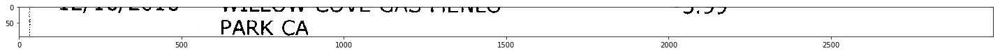

PARK CA |
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA |']


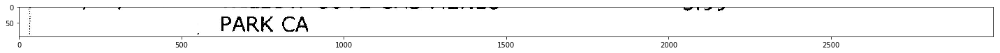

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


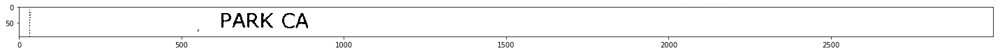

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


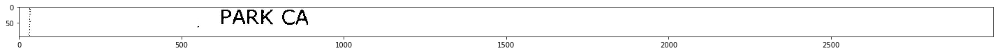

12/16/2016 SQ *CAKE CREATIONS BAKE -8.60
[datetime.date(2016, 12, 16), -8.6, ' SQ *CAKE CREATIONS BAKE ']


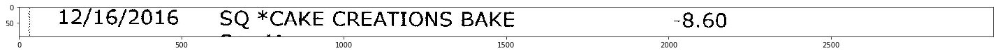

n Ma

rr ee oe ee ee ae ae - wn el lela li lke ele i tw)
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'n Ma\n\nrr ee oe ee ee ae ae - wn el lela li lke ele i tw)']


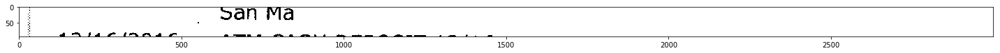

San Ma
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'San Ma']


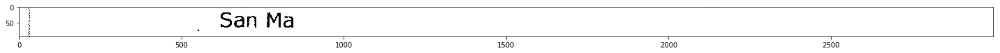

San Ma
Amount was not detected, re-attempting by removing commas
[None, None, 'San Ma']


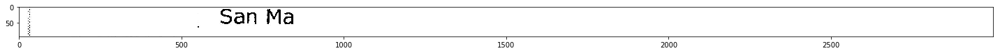

12/16/2016 ATM CASH DEPOSIT 12/16 200.00

™ «4 & me
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 16), None, ' ATM CASH DEPOSIT 12/16 200.00\n\n™ «4 & me']


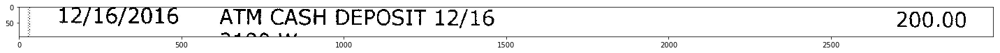

12/16/2016 © ATM CASH DEPOSIT 12/16 200.00
[datetime.date(2016, 12, 16), 200.0, ' © ATM CASH DEPOSIT 12/16']


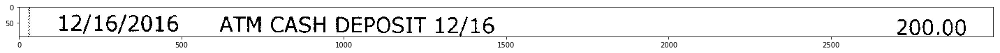

2180 W
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '2180 W']


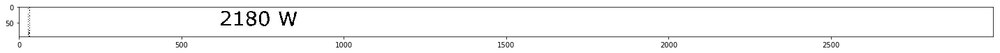

_oo

Ne Ne OE ee ee Ne ee

2180 W

Coaliened A

-_ 7

a2VV

WY
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '_oo\n\nNe Ne OE ee ee Ne ee\n\n2180 W\n\nCoaliened A\n\n-_ 7\n\na2VV\n\nWY']


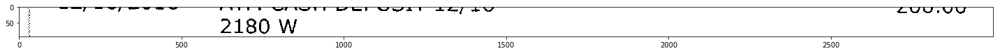

2180W 
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '2180W ']


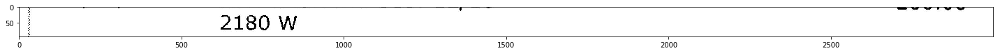

2180 W
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '2180 W']


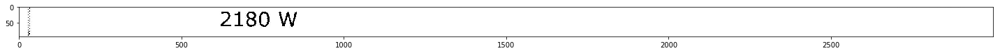

OW
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'OW']


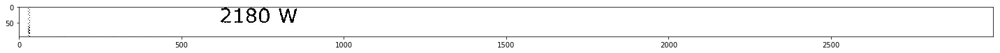

 ome Fs 2 we Form rm ull
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, ' ome Fs 2 we Form rm ull']


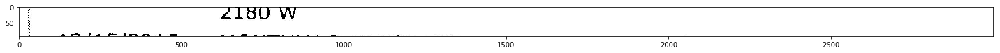

42£10VU VV

qn /4 OC (OKs fe RASA UTTE 82 MS PMA re eee oer py files gm mw:
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '42£10VU VV\n\nqn /4 OC (OKs fe RASA UTTE 82 MS PMA re eee oer py files gm mw:']


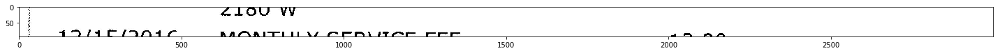

&eaAwvw FY

49/10 /9JNiCA NAAVAITLIT Y CODVTICO coe A nn
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '&eaAwvw FY\n\n49/10 /9JNiCA NAAVAITLIT Y CODVTICO coe A nn']


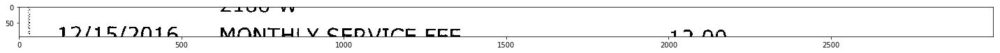

19/15/7016 MONTHIY CERVICE FEE _1onNn
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, ' MONTHIY CERVICE FEE _1onNn']


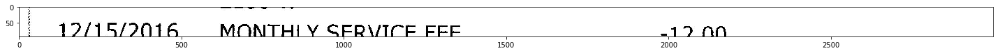

12/15/2016 MONTHLY SERVICE FFF -17 90
[datetime.date(2016, 12, 15), -17.9, ' MONTHLY SERVICE FFF ']


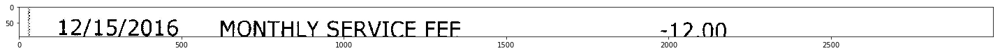

17/15/7016

SAN] MATEO SAN MATENQ CA

SS eS eee:
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '\n\nSAN] MATEO SAN MATENQ CA\n\nSS eS eee:']


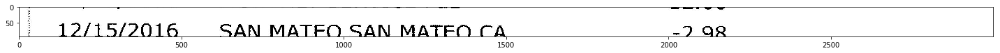

AGefjaiwj evil IMIS PPro) QOUNVING Foo TLZ.UU

 

q4~%y (4 0° JON 4 Of f™ ARE RA ATO CNUCUr™ UAC AlCl Kk EO OUW!:CPA mt. ca i
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AGefjaiwj evil IMIS PPro) QOUNVING Foo TLZ.UU\n\n \n\nq4~%y (4 0° JON 4 Of f™ ARE RA ATO CNUCUr™ UAC AlCl Kk EO OUW!:CPA mt. ca i']


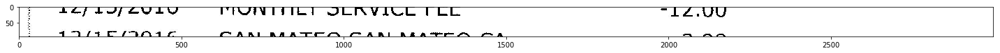

__ ee ee Spree ree rN Re Fl £2,.VUV

190/102 /J9n1 46 CARI AAATOC\ CARI AAATOLY CA y MoO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '__ ee ee Spree ree rN Re Fl £2,.VUV\n\n190/102 /J9n1 46 CARI AAATOC\\ CARI AAATOLY CA y MoO']


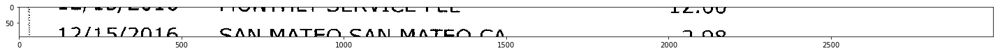

17/15/7016

SAN] MATEO CAN MATEN CA

__ oe FOO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '\n\nSAN] MATEO CAN MATEN CA\n\n__ oe FOO']


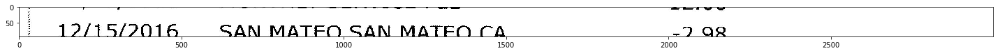

12/15/2016 SAN MATEO SAN MATEQ CA -) 98
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 15), None, ' SAN MATEO SAN MATEQ CA -) 98']


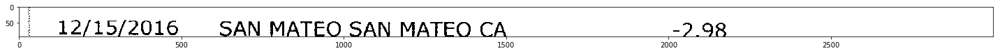

12/15/2016 SAN MATEO SAN MATEO CA -2.98
[datetime.date(2016, 12, 15), -2.98, ' SAN MATEO SAN MATEO CA ']


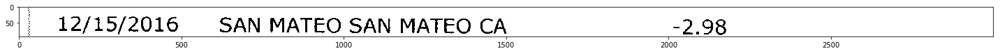


Amount was not detected, re-attempting by removing commas
[None, None, '']


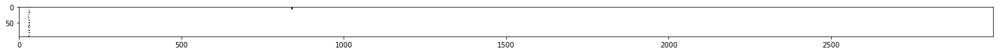

mS owe ee oe ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'mS owe ee oe ee']


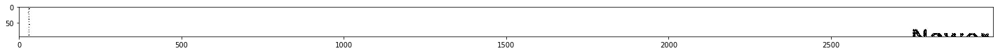


Amount was not detected, re-attempting by removing commas
[None, None, '']


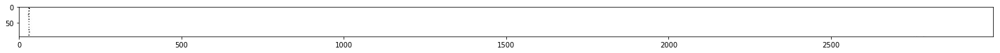

Image (51).jpg
12/15/2016 ATM WITHDRAWAL -200.00
[datetime.date(2016, 12, 15), -200.0, ' ATM WITHDRAWAL ']


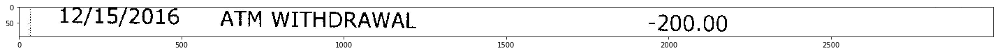

12/14/2016 EL RANCHO MARKE MENLO -10.20
[datetime.date(2016, 12, 14), -10.2, ' EL RANCHO MARKE MENLO ']


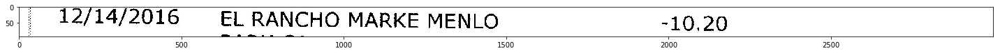

PAIR CA

~¢™s™ fe ™ (Or ss fo” pile <- m/: eee eee eee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PAIR CA\n\n~¢™s™ fe ™ (Or ss fo” pile <- m/: eee eee eee']


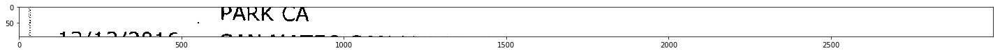

eS

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'eS\n\nPARK CA']


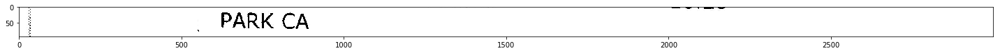

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


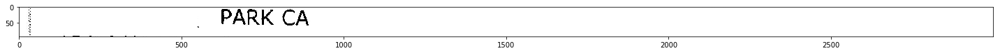

PARK CA

Qg ™ ff; ™ § -™ 2 ee Co
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA\n\nQg ™ ff; ™ § -™ 2 ee Co']


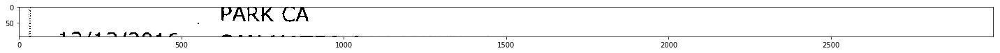

FARK CA

q4yny/1.9 /9n1 , ae. ee ee ee ee le et eel Oe ee eee ee ee ee eee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'FARK CA\n\nq4yny/1.9 /9n1 , ae. ee ee ee ee le et eel Oe ee eee ee ee ee eee']


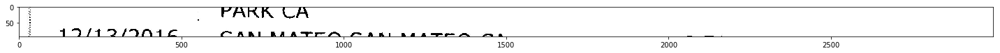

17) /12/9N16

POPAINEIN GAA
CARL AAATIOGC\N CARI AAATOOC\ CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '17) /12/9N16\n\nPOPAINEIN GAA\nCARL AAATIOGC\\N CARI AAATOOC\\ CA']


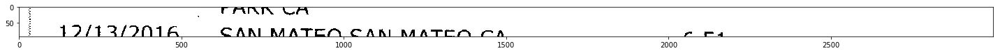

17/13/7016

SPN EN New 4

CAN MATEO CAN MATECN CA

ff C4
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '\n\nSPN EN New 4\n\nCAN MATEO CAN MATECN CA\n\nff C4']


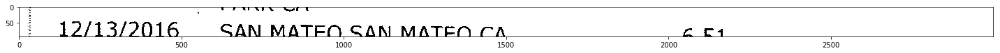

12/13/2016 © SAN MATEO SAN MATEO CA _& &4
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 13), None, ' © SAN MATEO SAN MATEO CA _& &4']


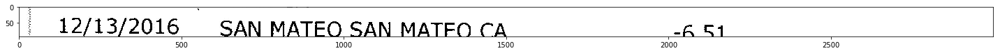

12/13/2016 © SAN MATEO SAN MATEO CA -§.51
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 13), None, ' © SAN MATEO SAN MATEO CA -§.51']


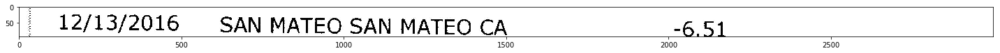

12/13/2016 | SAN MATEO SAN MATEO CA -6.51
[datetime.date(2016, 12, 13), -6.51, ' | SAN MATEO SAN MATEO CA ']


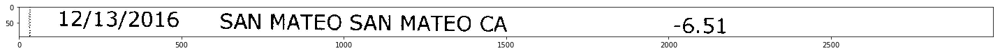


Amount was not detected, re-attempting by removing commas
[None, None, '']


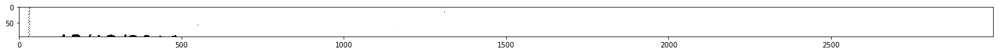

Lé/l3/ZQ0160 PANDA EXPRESS #1923 -10.05

Le LRT eT OPS
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Lé/l3/ZQ0160 PANDA EXPRESS #1923 -10.05\n\nLe LRT eT OPS']


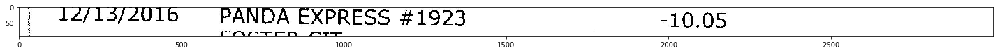

12/13/2016 PANDA EXPRESS #1923 -10.05
[datetime.date(2016, 12, 13), -10.05, ' PANDA EXPRESS #1923 ']


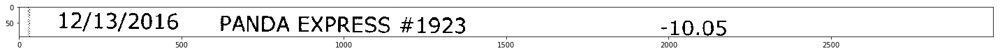

FOSTER CIT
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'FOSTER CIT']


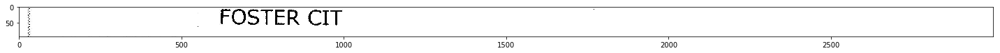

SF NS Se ee ee

FOSTER CIT

whe

VS
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'SF NS Se ee ee\n\nFOSTER CIT\n\nwhe\n\nVS']


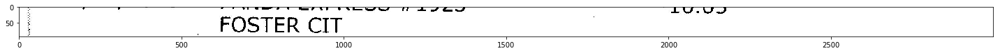

FOSTER CIT
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'FOSTER CIT']


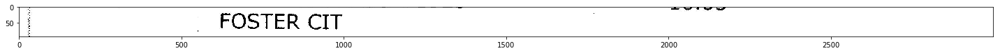

FOSTER CIT
Amount was not detected, re-attempting by removing commas
[None, None, 'FOSTER CIT']


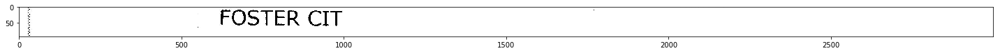

12/12/2016 SAN MATEO SAN MATEO CA -24.00
[datetime.date(2016, 12, 12), -24.0, ' SAN MATEO SAN MATEO CA ']


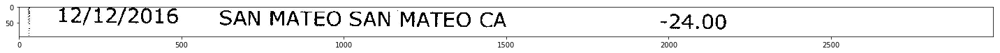

4~ny /43 @ Jaa ré~ meni ann rey ps ek hl kl lll lle,
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '4~ny /43 @ Jaa ré~ meni ann rey ps ek hl kl lll lle,']


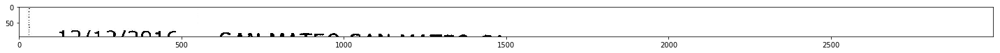


Amount was not detected, re-attempting by removing commas
[None, None, '']


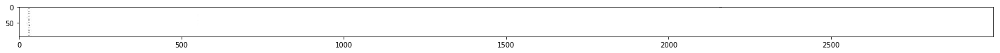

12/12/2016 SAN MATEO SAN MATEO CA -2.98
[datetime.date(2016, 12, 12), -2.98, ' SAN MATEO SAN MATEO CA ']


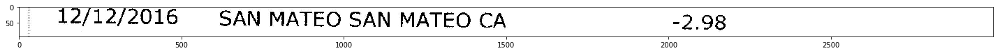

QA -™|, £4 ™|™ TF. Mm stl
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'QA -™|, £4 ™|™ TF. Mm stl']


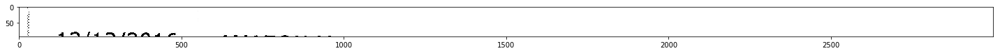


Amount was not detected, re-attempting by removing commas
[None, None, '']


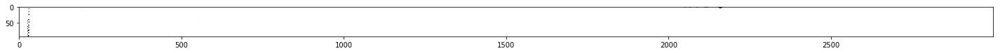

12/12/2016  AMAZON MKTPLACE PMTS -41.88
[datetime.date(2016, 12, 12), -41.88, '  AMAZON MKTPLACE PMTS ']


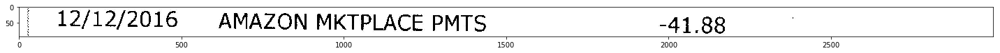


Amount was not detected, re-attempting by removing commas
[None, None, '']


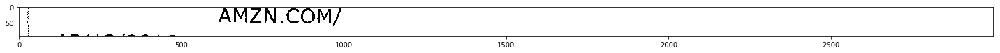

Lffic/ZUlO  SAFEWAY STORE 2719 Menlo P -22.86
Adjusting Window
[None, -22.86, 'Lffic/ZUlO  SAFEWAY STORE 2719 Menlo P ']


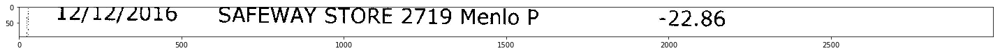

12/12/2016 |§ SAFEWAY STORE 2719 Menlo P -22.86
[datetime.date(2016, 12, 12), -22.86, ' |§ SAFEWAY STORE 2719 Menlo P ']


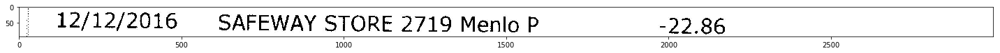


Amount was not detected, re-attempting by removing commas
[None, None, '']


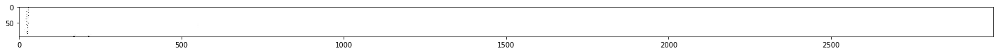

12/12/2016 PIZZA | HUT 11647 800-843- -32.01

a~am™ ~~
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 12), None, ' PIZZA | HUT 11647 800-843- -32.01\n\na-am™ --']


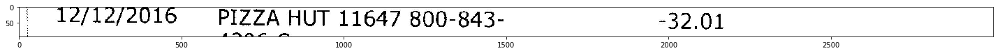

12/12/2016 PIZZA HUT 11647 800-843- ~-37 01
[datetime.date(2016, 12, 12), -37.01, ' PIZZA HUT 11647 800-843- ~']


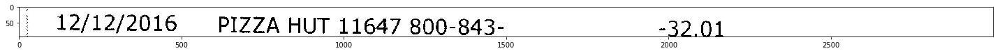

4306 C
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '4306 C']


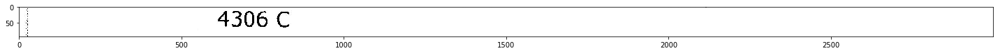

OE

OE

ae: eee ee

5 a G@ew Geet FOF TN OE

4306 C

am TE

Www Vil

WI eS

AVL
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'OE\n\nOE\n\nae: eee ee\n\n5 a G@ew Geet FOF TN OE\n\n4306 C\n\nam TE\n\nWww Vil\n\nWI eS\n\nAVL']


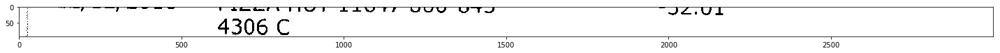

4306C“‘;‘;s -
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '4306C“‘;‘;s -']


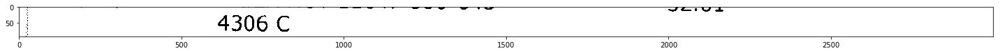

4306 C
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '4306 C']


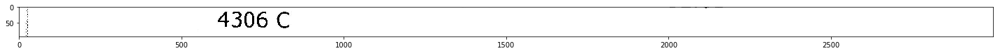


Amount was not detected, re-attempting by removing commas
[None, None, '']


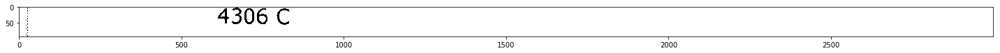

12/12/2016 G2A COM KRAKOW -10.20
[datetime.date(2016, 12, 12), -10.2, ' G2A COM KRAKOW ']


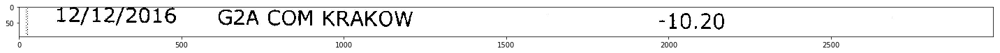

48H (AOI ana me enaewWe « wm asl sell llr lr /FthUh3T kL...
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '48H (AOI ana me enaewWe « wm asl sell llr lr /FthUh3T kL...']


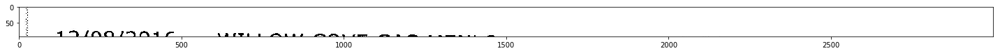


Amount was not detected, re-attempting by removing commas
[None, None, '']


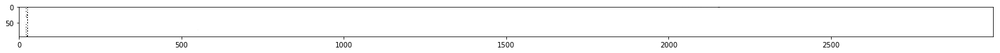

12/08/2016 WILLOW COVE GAS MENLO -6.34
[datetime.date(2016, 12, 8), -6.34, ' WILLOW COVE GAS MENLO ']


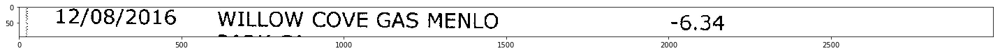

rFAKK CA

A ™™|), FPe_ rey Fe~ FP Oe ee ee ee Boe
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'rFAKK CA\n\nA ™™|), FPe_ rey Fe~ FP Oe ee ee ee Boe']


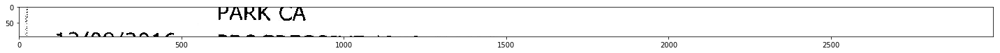

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


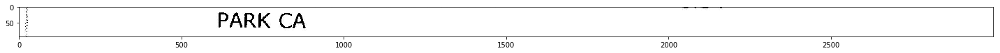

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


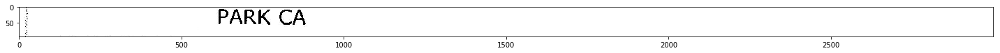

12/08/2016 PROGRESSIVE *INSURANC 152.00

7 a a a a a gt
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 8), None, ' PROGRESSIVE *INSURANC 152.00\n\n7 a a a a a gt']


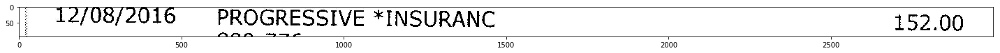

12/08/2016 PROGRESSIVE *INSURANC 1579 00
Adjusting Window
[datetime.date(2016, 12, 8), None, ' PROGRESSIVE *INSURANC']


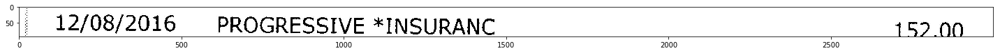

12/08/2016 PROGRESSIVE *INSURANC 152.00
[datetime.date(2016, 12, 8), 152.0, ' PROGRESSIVE *INSURANC']


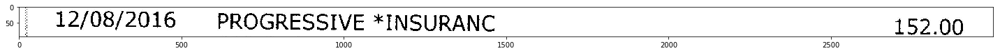

2 om OU me em oe mmr

800-776-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '2 om OU me em oe mmr\n\n800-776-']


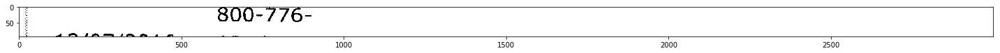

800-776-

wt Ba tt VIS
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '800-776-\n\nwt Ba tt VIS']


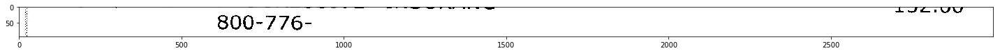

ee Se

800-776-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee Se\n\n800-776-']


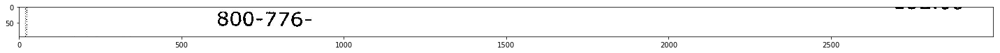

iti ai ee

800-776-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'iti ai ee\n\n800-776-']


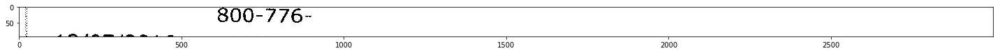

OUU-//0-

gy (ra Iiramra ~~ memminba
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'OUU-//0-\n\ngy (ra Iiramra -- memminba']


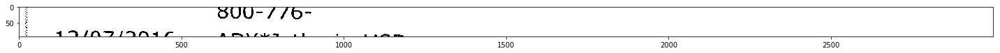

1490 /NnNT7/9NIL

OUYUT Ss SO7

ATTN & 1.244. we 1 et Ieee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '1490 /NnNT7/9NIL\n\nOUYUT Ss SO7\n\nATTN & 1.244. we 1 et Ieee']


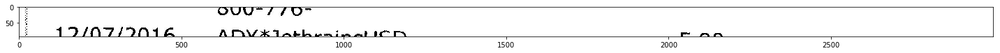

1D/N7F/ION16

Net ON

ANV*¥* latheaincl! ICM
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '1D/N7F/ION16\n\nNet ON\n\nANV*¥* latheaincl! ICM']


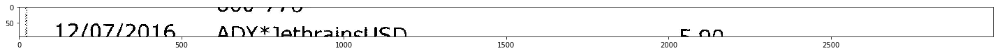

12/07/2016 ADY* lethraincl ISD _Can
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 12, 7), None, ' ADY* lethraincl ISD _Can']


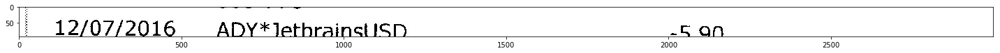

12/07/2016 ADY*JetbrainsUSD -5 90
[datetime.date(2016, 12, 7), -5.9, ' ADY*JetbrainsUSD ']


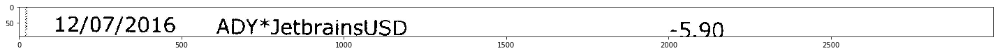

https ://www.j
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'https ://www.j']


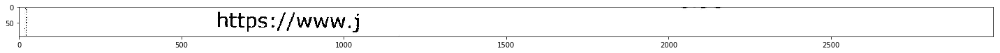

et

ue ©:

f

Ww

_

AL’ t Pe! OOo a

httos://www.i

“Ie FU
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'et\n\nue ©:\n\nf\n\nWw\n\n_\n\nAL’ t Pe! OOo a\n\nhttos://www.i\n\n“Ie FU']


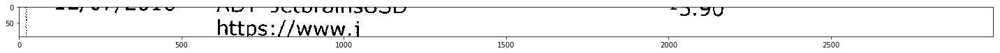

https: //wWww. Nj
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'https: //wWww. Nj']


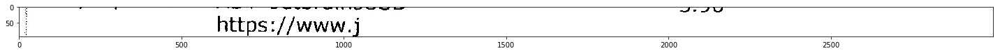

https ://www.j
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'https ://www.j']


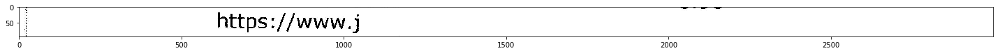

https ://www.j
Amount was not detected, re-attempting by removing commas
[None, None, 'https ://www.j']


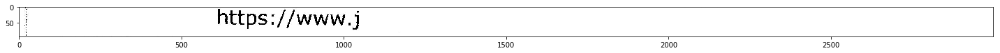

12/07/2016 CHIPOTLE 2028 SAN MATEO CA “1 3.0
[datetime.date(2016, 12, 7), 3.0, ' CHIPOTLE 2028 SAN MATEO CA “1']


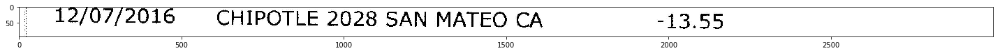

qg@yUlUdilrtN OST 4A Or

em)

te ot, -™ oes

a i a ic ae
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'qg@yUlUdilrtN OST 4A Or\n\nem)\n\nte ot, -™ oes\n\na i a ic ae']


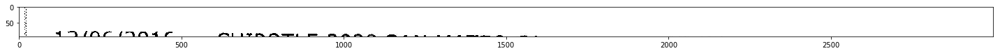


Amount was not detected, re-attempting by removing commas
[None, None, '']


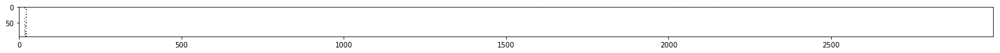

12/06/2016 CHIPOTLE 2028 SAN MATEO CA -13.55
[datetime.date(2016, 12, 6), -13.55, ' CHIPOTLE 2028 SAN MATEO CA ']


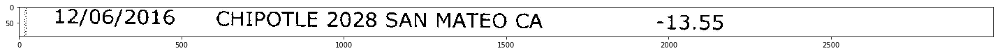

ee . ae a

tiom™ ~~ » »
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee . ae a\n\ntiom™ -- » »']


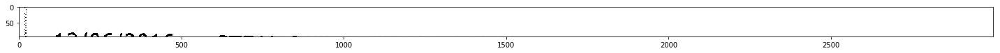


Amount was not detected, re-attempting by removing commas
[None, None, '']


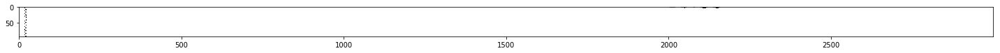

12/06/2016 STEAMGAMES.COM42595229 -5.00
[datetime.date(2016, 12, 6), -5.0, ' STEAMGAMES.COM42595229 ']


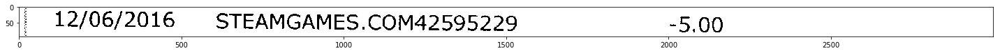

425-952
Adjusting Window
[None, -952.0, '425']


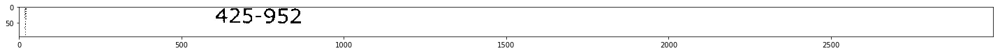

425-952 _
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '425-952 _']


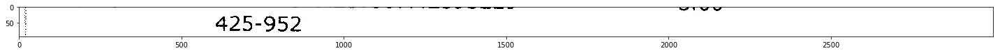

425-952
Adjusting Window
[None, -952.0, '425']


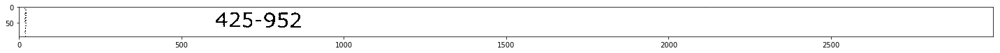

425-952
[None, -952.0, '425']


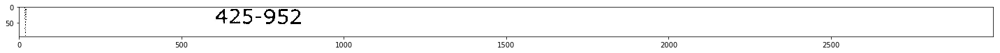

MS onc we oe me
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MS onc we oe me']


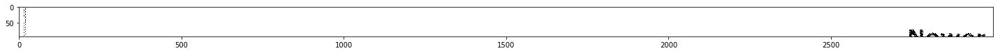


Amount was not detected, re-attempting by removing commas
[None, None, '']


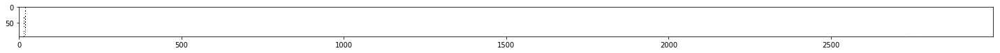

Image (52).jpg
11/22/2010 Oniine Transfer from SAV ...03
Amount was not detected, re-attempting by removing commas
[datetime.date(2010, 11, 22), None, ' Oniine Transfer from SAV ...03']


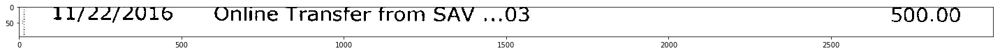

944/941 /9NniAfc Ci RM AARAISCLIGM, RAA MIAO AALPTAII CN t+Pfv\ Ar”
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '944/941 /9NniAfc Ci RM AARAISCLIGM, RAA MIAO AALPTAII CN t+Pfv\\ Ar”']


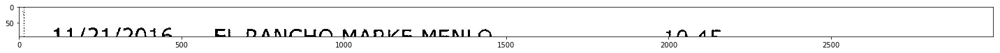


Amount was not detected, re-attempting by removing commas
[None, None, '']


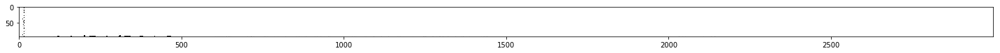

11/21/2016 EL RANCHO MARKE MENLO -10.45

MPA Mis ("MA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, ' EL RANCHO MARKE MENLO -10.45\n\nMPA Mis (-MA']


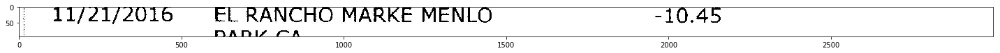

11/21/2016 EL RANCHO MARKE MENLO -10.45
[datetime.date(2016, 11, 21), -10.45, ' EL RANCHO MARKE MENLO ']


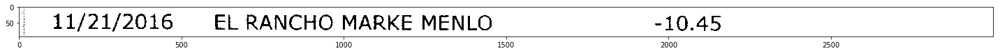

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


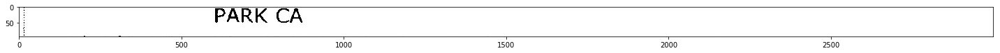

PARK CA

ae sommerne Teme  Seme! PEME
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA\n\nae sommerne Teme  Seme! PEME']


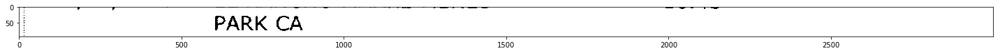

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


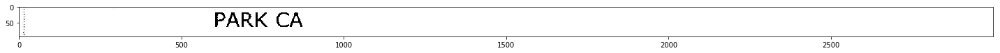

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


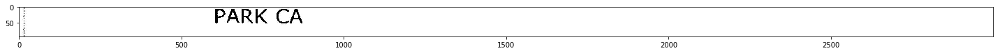

11/21/2016 EL RANCHO MARKE MENLO -5.19

PA rails (*™ A
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 11, 21), None, ' EL RANCHO MARKE MENLO -5.19\n\nPA rails (*™ A']


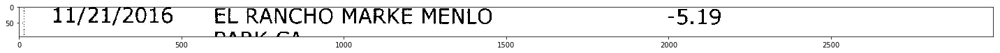

11/21/2016 EL RANCHO MARKE MENLO -5.19
[datetime.date(2016, 11, 21), -5.19, ' EL RANCHO MARKE MENLO ']


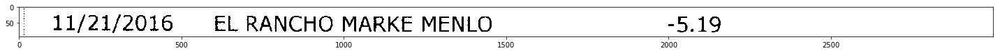

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


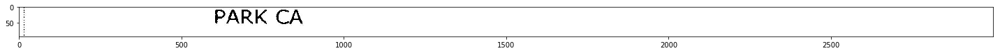

ee ee:

eee

Severe See

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee ee:\n\neee\n\nSevere See\n\nPARK CA']


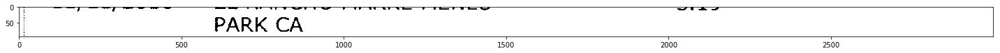

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


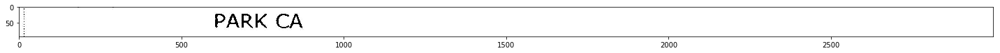

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


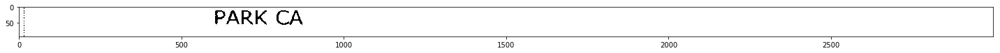

11/21/2016 USPS KIOSK 05580 2085 PALO -1.41
[datetime.date(2016, 11, 21), -1.41, ' USPS KIOSK 05580 2085 PALO ']


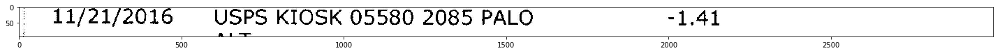

ALI

2 2» bem 2» Foe me ulm a aan nh lrklrrtlk ll mth elles a
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ALI\n\n2 2» bem 2» Foe me ulm a aan nh lrklrrtlk ll mth elles a']


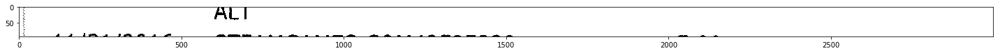

ALT
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ALT']


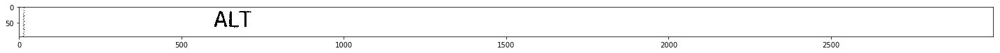

ALT
Amount was not detected, re-attempting by removing commas
[None, None, 'ALT']


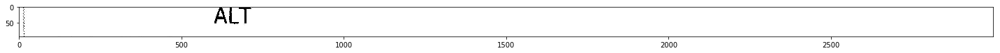

11/21/2016 STEAMGAMES.COM42595229 -5.00

a2ae-™e™e rm -seeoreES-~,
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 11, 21), None, ' STEAMGAMES.COM42595229 -5.00\n\na2ae-™e™e rm -seeoreES-~,']


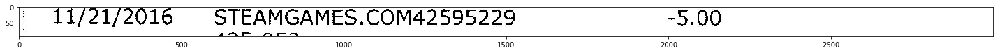

11/21/2016 STEAMGAMES.COM42595229 -5.00
[datetime.date(2016, 11, 21), -5.0, ' STEAMGAMES.COM42595229 ']


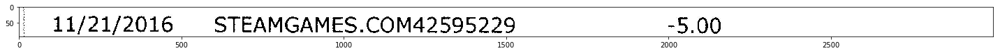

425-952
Adjusting Window
[None, -952.0, '425']


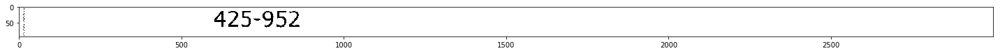

ee: a.  fp Sew fe F UE ee OD Ree ee Nee Ne ee ee ed ee Be we BO NS
f f

425- -952
Adjusting Window
[None, -952.0, 'ee: a.  fp Sew fe F UE ee OD Ree ee Nee Ne ee ee ed ee Be we BO NS\nf f\n\n425- ']


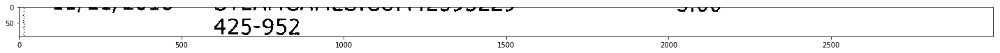

425-952,
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, -952.0, '425,']


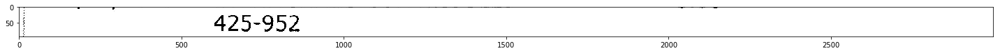

425-952
Adjusting Window
[None, -952.0, '425']


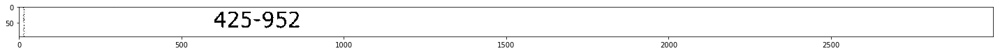

425-952
[None, -952.0, '425']


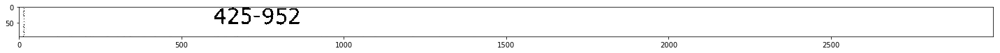

11/21/2016 HOMEDEPOT. COM 800-430- -1.77

 -F_ay
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 11, 21), None, ' HOMEDEPOT. COM 800-430- -1.77\n\n -F_ay']


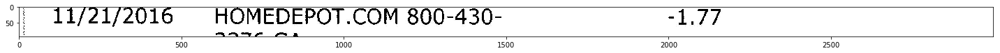

11/21/2016 ©HOMEDEPOT.COM 800-430- -1.77
[datetime.date(2016, 11, 21), -1.77, ' ©HOMEDEPOT.COM 800-430- ']


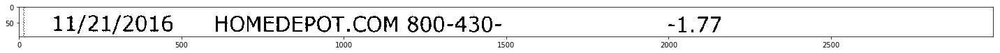

3376 GA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '3376 GA']


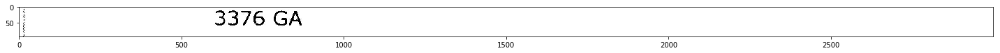

Oe EEE ES ee a_i ee Oe Eee Te ee _ amt

3376 GA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Oe EEE ES ee a_i ee Oe Eee Te ee _ amt\n\n3376 GA']


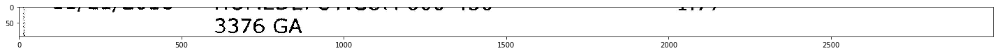

3376 GA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '3376 GA']


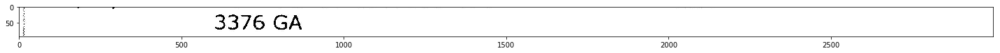

3376 GA
Amount was not detected, re-attempting by removing commas
[None, None, '3376 GA']


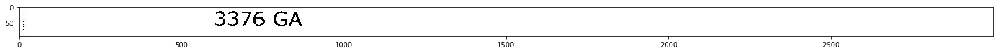

11/18/2016 AMAZON MKTPLACE PMTS -32.30
[datetime.date(2016, 11, 18), -32.3, ' AMAZON MKTPLACE PMTS ']


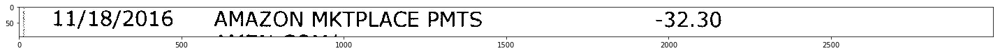

OM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'OM/']


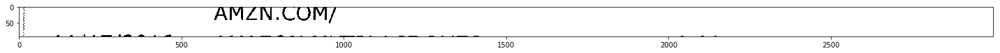

AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/']


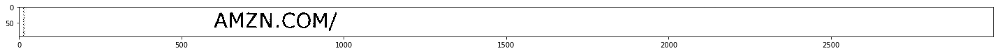

AMZN.COM/
Amount was not detected, re-attempting by removing commas
[None, None, 'AMZN.COM/']


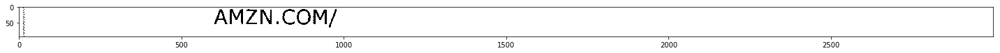

11/17/2016 ©AMAZON MKTPLACE PMTS -12.99
[datetime.date(2016, 11, 17), -12.99, ' ©AMAZON MKTPLACE PMTS ']


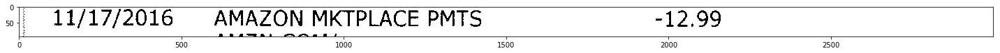

ee ee ee ee ee ee ee ol

AMIZIN,.COM/

BRaAas™ ARE" ™s 388 ue  ae OE oe ee

42 ~~, ear
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee ee ee ee ee ee ee ol\n\nAMIZIN,.COM/\n\nBRaAas™ ARE- ™s 388 ue  ae OE oe ee\n\n42 --, ear']


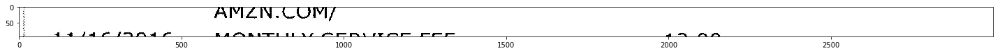

AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/']


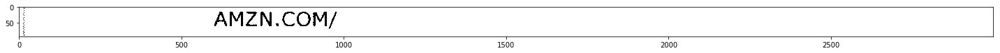

AMZN.COM/
Amount was not detected, re-attempting by removing commas
[None, None, 'AMZN.COM/']


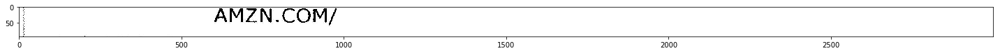

11/16/2016 MONTHLY SERVICE FEE -12.00
[datetime.date(2016, 11, 16), -12.0, ' MONTHLY SERVICE FEE ']


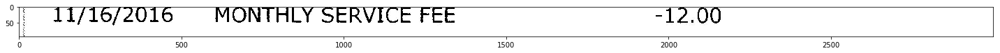

11/16/2016 EL RANCHO MARKE MENLO -11.72

m™:17 S™ sb
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 11, 16), None, ' EL RANCHO MARKE MENLO -11.72\n\nm™:17 S™ sb']


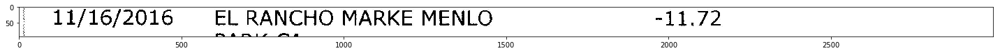

11/16/2016 EL RANCHO MARKE MENLO -11.72
[datetime.date(2016, 11, 16), -11.72, ' EL RANCHO MARKE MENLO ']


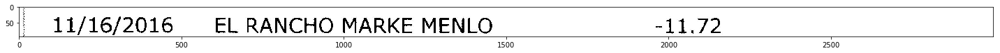

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


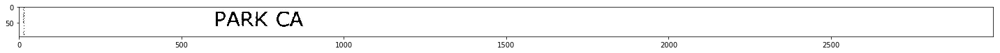

 eS ee OS et PN NE Sw ZF EE NEN Bee 8 Be FO Bee ah ee 8 fF oe

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, ' eS ee OS et PN NE Sw ZF EE NEN Bee 8 Be FO Bee ah ee 8 fF oe\n\nPARK CA']


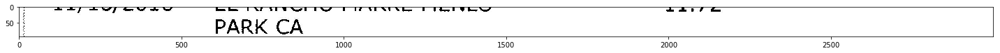

PARKCA ~ _
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARKCA ~ _']


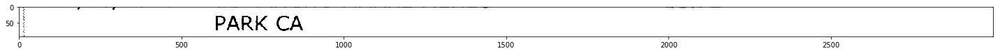

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


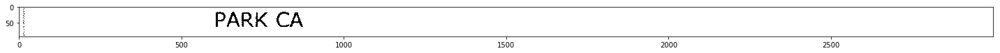

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


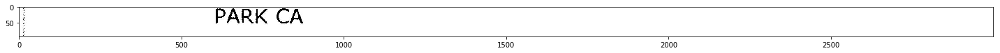

11/16/2016 Amazon.com AMZN.COM/BILL -43.77
[datetime.date(2016, 11, 16), -43.77, ' Amazon.com AMZN.COM/BILL ']


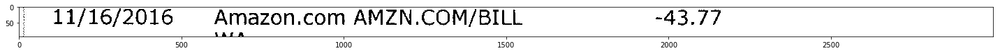

gg fe om ITT rT Aa om

VA

ARAAA “TF SCNA HE

RB Ai SS" TAD

AR Pr PAR OA Oe
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'gg fe om ITT rT Aa om\n\nVA\n\nARAAA “TF SCNA HE\n\nRB Ai SS- TAD\n\nAR Pr PAR OA Oe']


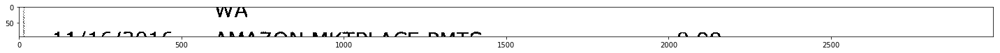


Amount was not detected, re-attempting by removing commas
[None, None, '']


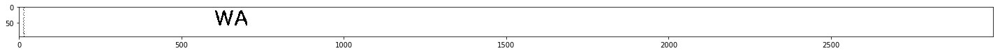

11/16/2016 AMAZON MKTPLACE PMTS

mzwpmsetefw™ #™ hb
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 11, 16), None, ' AMAZON MKTPLACE PMTS\n\nmzwpmsetefw™ #™ hb']


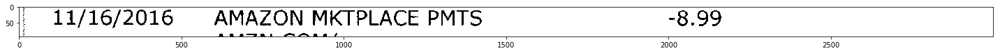

11/16/2016 AMAZON MKTPLACE PMTS -8.99
[datetime.date(2016, 11, 16), -8.99, ' AMAZON MKTPLACE PMTS ']


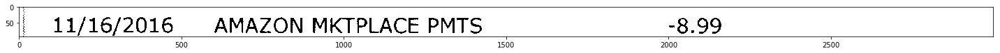

AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/']


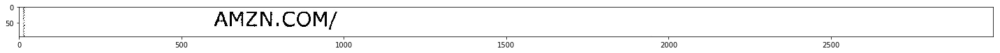

SP RE Nae ee EEUU NE

AMZN.COM/

FS et tee

to

wt ot
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'SP RE Nae ee EEUU NE\n\nAMZN.COM/\n\nFS et tee\n\nto\n\nwt ot']


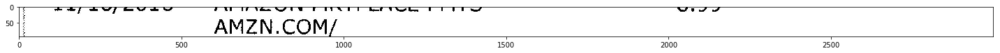

AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/']


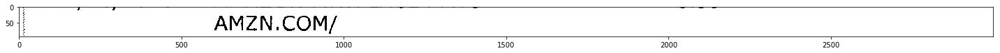

AMZN.COM/
Amount was not detected, re-attempting by removing commas
[None, None, 'AMZN.COM/']


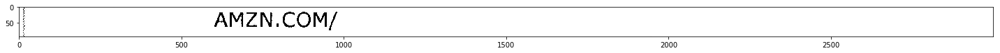

11/15/2016 DELTA RESTAURANT LOUNGE -16.96
[datetime.date(2016, 11, 15), -16.96, ' DELTA RESTAURANT LOUNGE ']


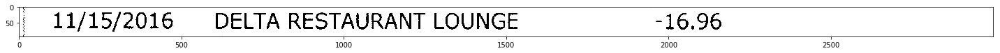

STOCKT
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'STOCKT']


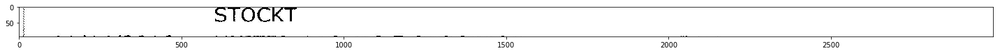

STOCKT 
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'STOCKT ']


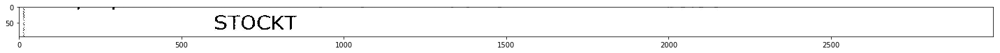

STOCKT
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'STOCKT']


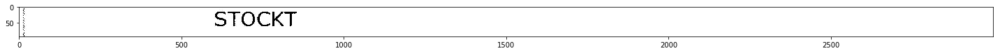

STOCKT
Amount was not detected, re-attempting by removing commas
[None, None, 'STOCKT']


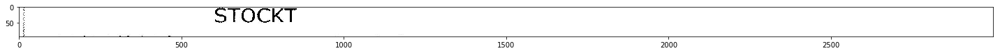

11/14/2016 UNITED PACIFIC 5 STOCKTON -3.04
[datetime.date(2016, 11, 14), -3.04, ' UNITED PACIFIC 5 STOCKTON ']


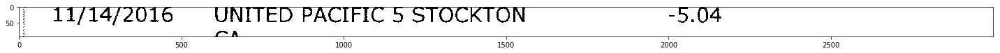

ee ee oe ee ee a ee al rN AL FP .1.s/f™ ATr™@ir™ 4 dio QO] OUP™ PC Oa on / _ re ey
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee ee oe ee ee a ee al rN AL FP .1.s/f™ ATr™@ir™ 4 dio QO] OUP™ PC Oa on / _ re ey']


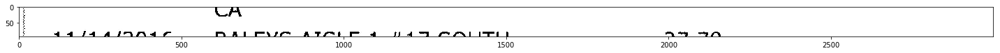


Amount was not detected, re-attempting by removing commas
[None, None, '']


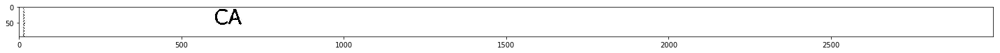

11/14/2016 RALEYS AISLE 1 #17 SOUTH -27.78
[datetime.date(2016, 11, 14), -27.78, ' RALEYS AISLE 1 #17 SOUTH ']


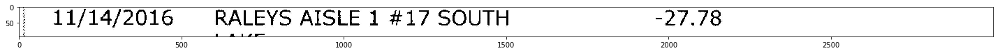


Amount was not detected, re-attempting by removing commas
[None, None, '']


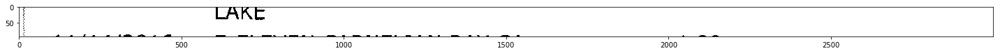

11/14/2010 /-CLEVEN CARNELIAN DAY CA -1.99
[datetime.date(2010, 11, 14), -1.99, ' /-CLEVEN CARNELIAN DAY CA ']


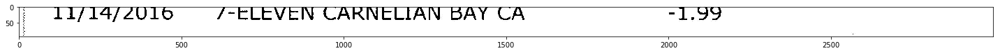


Amount was not detected, re-attempting by removing commas
[None, None, '']


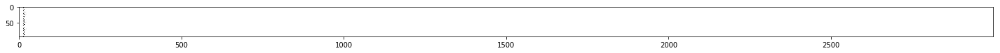

Image (53).jpg
11/14/2U1L0 ARCO #42557 CARSON CITY -2.84

AR fs
Amount was not detected, re-attempting by removing commas
[None, None, '11/14/2U1L0 ARCO #42557 CARSON CITY -2.84\n\nAR fs']


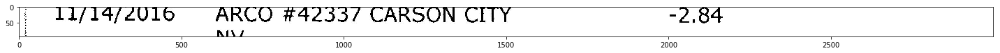

INV

 

44/4 Al/(DHNAL SA S*NZ TAL "PL IT” BOCA LIOR A 24anr-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'INV\n\n \n\n44/4 Al/(DHNAL SA S*NZ TAL -PL IT” BOCA LIOR A 24anr-']


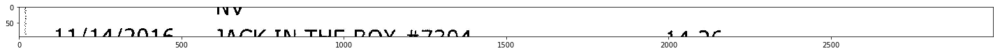


Amount was not detected, re-attempting by removing commas
[None, None, '']


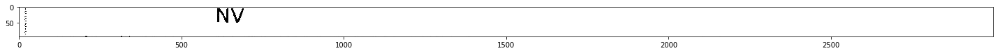

11/14/2016 JACK IN THE BOX #7304 -14.26

fm A ry f SNR E
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 11, 14), None, ' JACK IN THE BOX #7304 -14.26\n\nfm A ry f SNR E']


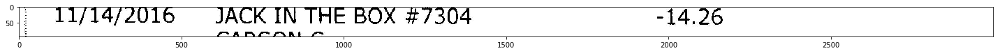

11/14/2016 JACK IN THE BOX #7304 -14.26
[datetime.date(2016, 11, 14), -14.26, ' JACK IN THE BOX #7304 ']


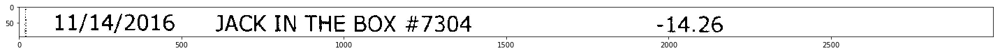

CARSON C
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CARSON C']


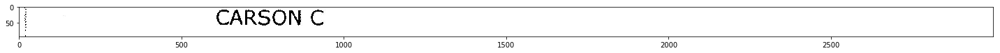

CARSON C _

aees
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CARSON C _\n\naees']


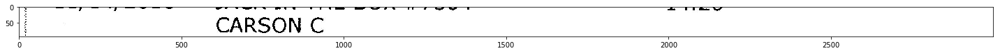

CARSON C
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CARSON C']


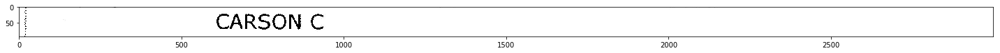

CARSON C
Amount was not detected, re-attempting by removing commas
[None, None, 'CARSON C']


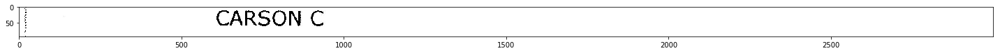

11/14/2016 ARCO PAYPOINT CAMERON -4,.53
Amount was not detected, re-attempting by removing commas
[datetime.date(2016, 11, 14), -4.53, ' ARCO PAYPOINT CAMERON -4,.53']


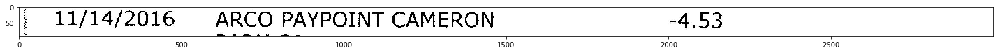

FARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'FARK CA']


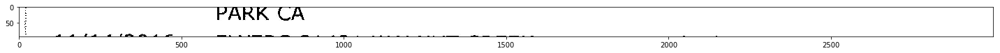

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


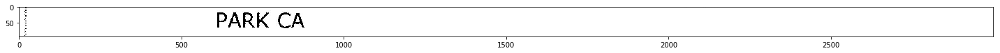

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


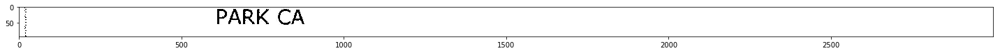

11/14/2016 FLYERS 31431 WALNUT CREEK -9.19
[datetime.date(2016, 11, 14), -9.19, ' FLYERS 31431 WALNUT CREEK ']


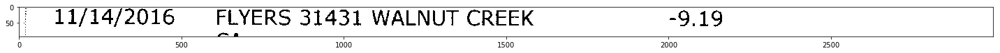

m Ulli etl el Td |! Of Uhl imi it ee a a
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'm Ulli etl el Td |! Of Uhl imi it ee a a']


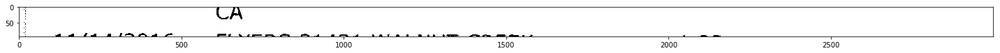

CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CA']


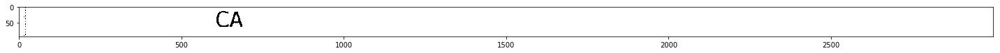


Amount was not detected, re-attempting by removing commas
[None, None, '']


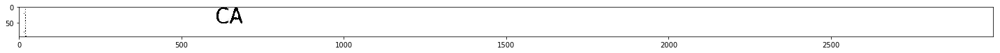

11/14/2016 FLYERS 31431 WALNUT CREEK -1.99
[datetime.date(2016, 11, 14), -1.99, ' FLYERS 31431 WALNUT CREEK ']


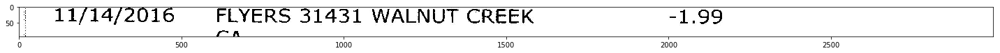

aq4s4a4gaIintrt 4 VAs AL PPE eae OP Oe POS Pr Ure lai TF Or
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aq4s4a4gaIintrt 4 VAs AL PPE eae OP Oe POS Pr Ure lai TF Or']


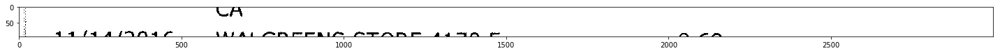


Amount was not detected, re-attempting by removing commas
[None, None, '']


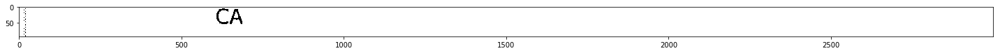

11/14/2016

WALGREENS STORE 4170 E

-8.69
[datetime.date(2016, 11, 14), -8.69, '\n\nWALGREENS STORE 4170 E\n\n']


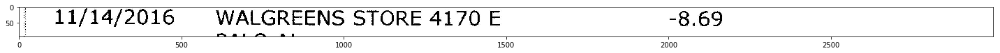

FALU AL

is #s f£ « 2 £m a-” i es ie
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'FALU AL\n\nis #s f£ « 2 £m a-” i es ie']


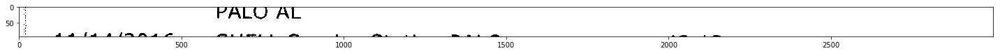

PALO AL
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PALO AL']


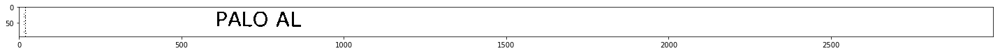

PALO AL
Amount was not detected, re-attempting by removing commas
[None, None, 'PALO AL']


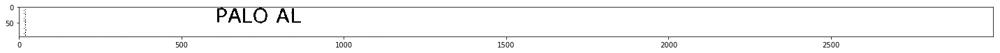

11/14/2016 SHELL Service Station PALO -42.13
[datetime.date(2016, 11, 14), -42.13, ' SHELL Service Station PALO ']


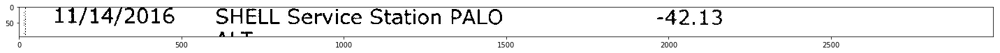

4g IRM IAM A

FAL!

Larpwa

PMULAT

F oe a Ue ca ce,

hn Arf™ AH

oan
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '4g IRM IAM A\n\nFAL!\n\nLarpwa\n\nPMULAT\n\nF oe a Ue ca ce,\n\nhn Arf™ AH\n\noan']


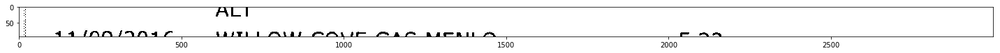

ALT
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ALT']


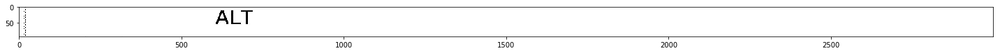


Amount was not detected, re-attempting by removing commas
[None, None, '']


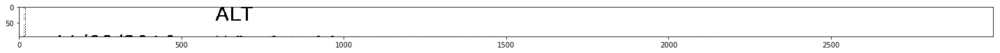

L1/U9/Z0UL6 WILLOW COVE GAS MENLO Ded

MA MIZ fra
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'L1/U9/Z0UL6 WILLOW COVE GAS MENLO Ded\n\nMA MIZ fra']


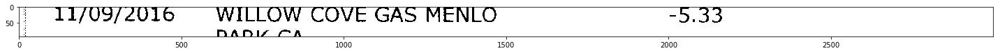

11/09/2016 WILLOW COVE GAS MENLO -5.33
[datetime.date(2016, 11, 9), -5.33, ' WILLOW COVE GAS MENLO ']


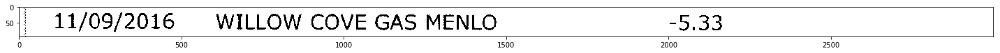

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


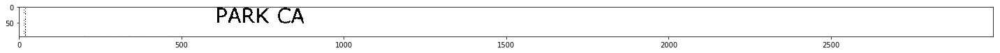

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


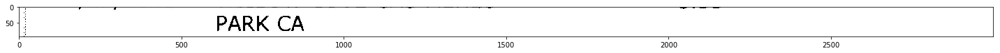

11/08/2016 SAN MATEO SAN MATEO CA -6.02
[datetime.date(2016, 11, 8), -6.02, ' SAN MATEO SAN MATEO CA ']


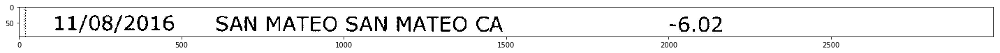


Amount was not detected, re-attempting by removing commas
[None, None, '']


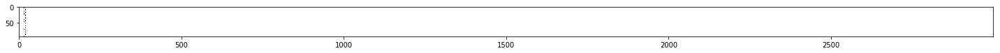

11/08/2016 SQ *CAKE CREATIONS BAKE -10.95
[datetime.date(2016, 11, 8), -10.95, ' SQ *CAKE CREATIONS BAKE ']


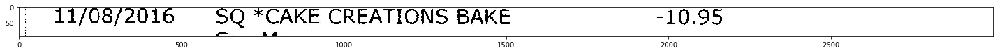

Pe ee oe eo ee on a a

oall Wid

To Oe ae cee ee ce ee

rm! P™np 6m ti fs mm

/{_m~,, wa
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Pe ee oe eo ee on a a\n\noall Wid\n\nTo Oe ae cee ee ce ee\n\nrm! P™np 6m ti fs mm\n\n/{_m~,, wa']


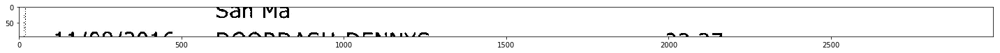

San Ma
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'San Ma']


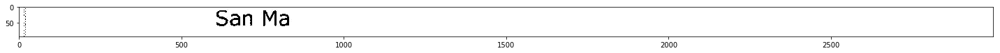


Amount was not detected, re-attempting by removing commas
[None, None, '']


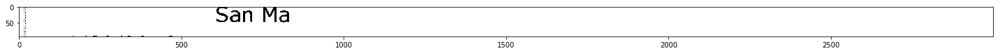

11/08/2016 DOORDASH-DENNYS -23.37

rVfrarrrfrarrn A C™LE S™SNAA f™
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 11, 8), None, ' DOORDASH-DENNYS -23.37\n\nrVfrarrrfrarrn A C™LE S™SNAA f™']


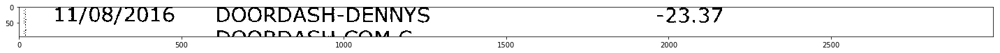

11/08/2016 DOORDASH-DENNYS -23.37
[datetime.date(2016, 11, 8), -23.37, ' DOORDASH-DENNYS ']


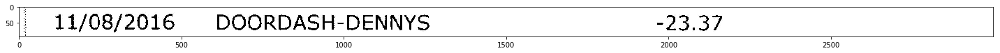

DOORDASH.COM C
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'DOORDASH.COM C']


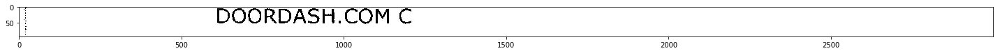

DOORDASH.COM C_
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'DOORDASH.COM C_']


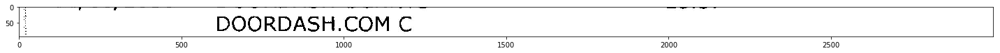

DOORDASH.COM C
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'DOORDASH.COM C']


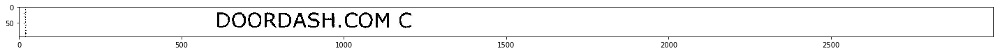

DOORDASH.COM C
Amount was not detected, re-attempting by removing commas
[None, None, 'DOORDASH.COM C']


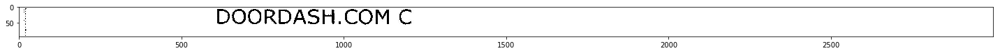

11/07/2016 ADY*JetbrainsUSD -5.90
[datetime.date(2016, 11, 7), -5.9, ' ADY*JetbrainsUSD ']


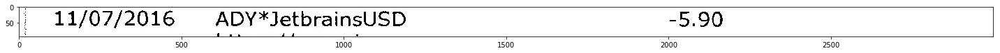

NCtps: /) WWW. J

_- mee ak ee ae ts: la
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NCtps: /) WWW. J\n\n_- mee ak ee ae ts: la']


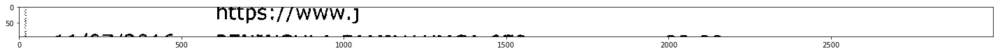

https://www.j
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'https://www.j']


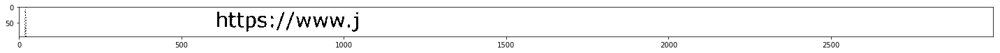

https://www.j
Amount was not detected, re-attempting by removing commas
[None, None, 'https://www.j']


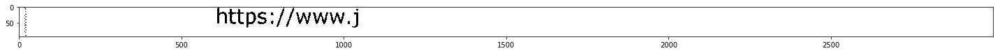

11/07/2016 PENINSULA FAMILY YMCA 650- -32.00
[datetime.date(2016, 11, 7), -32.0, ' PENINSULA FAMILY YMCA 650- ']


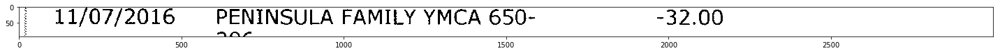

wit lad

ff. ™s J -™ ~ wt

200-7

pnp * fm )

mpaarans

mm mm 2 Pei

~~ a
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'wit lad\n\nff. ™s J -™ - wt\n\n200-7\n\npnp * fm )\n\nmpaarans\n\nmm mm 2 Pei\n\n-- a']


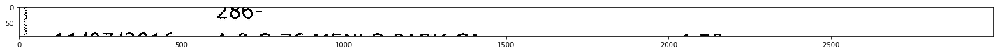

286-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '286-']


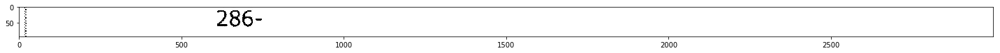

256-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '256-']


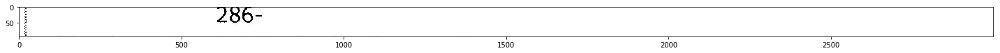

-

tS m™ ~s Jem mM

£00-

- oem ek

i a me be:

casi, me
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '-\n\ntS m™ ~s Jem mM\n\n£00-\n\n- oem ek\n\ni a me be:\n\ncasi, me']


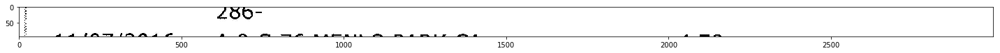

44 jHn7 /Anda Lf

£O0U0-

A OO 7" Feo” RAPTAEE SCA PARPIZ SA

I >
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '44 jHn7 /Anda Lf\n\n£O0U0-\n\nA OO 7- Feo” RAPTAEE SCA PARPIZ SA\n\nI >']


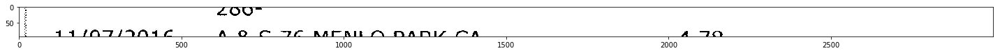

ew

41 /NT7T/INI1E A 8, C JK MENI C\Y DADDY CFA _A FQ
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ew\n\n41 /NT7T/INI1E A 8, C JK MENI C\\Y DADDY CFA _A FQ']


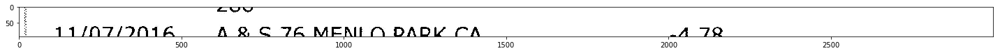

11/07/9016 A&® S J&A MENIQO DARK CA -A JR
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, ' A&® S J&A MENIQO DARK CA -A JR']


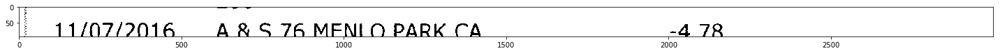

11/07/2016 A&S 76 MENLO PARK CA -4 78
[datetime.date(2016, 11, 7), -4.78, ' A&S 76 MENLO PARK CA ']


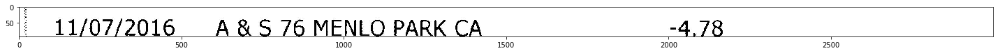


Amount was not detected, re-attempting by removing commas
[None, None, '']


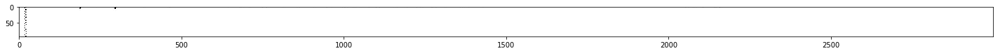

11/04/2016 Amazon web services -13.57
[datetime.date(2016, 11, 4), -13.57, ' Amazon web services ']


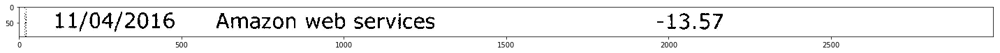

aws.amazon
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aws.amazon']


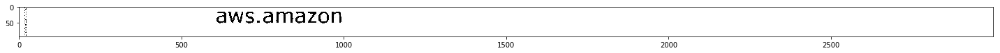

aws.amazon
Amount was not detected, re-attempting by removing commas
[None, None, 'aws.amazon']


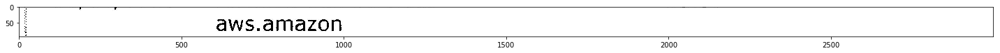

11/04/2016 Amazon.com AMZN.COM/BILL -19.60
[datetime.date(2016, 11, 4), -19.6, ' Amazon.com AMZN.COM/BILL ']


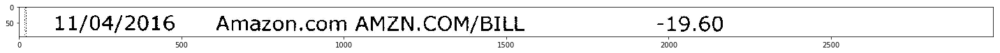


Amount was not detected, re-attempting by removing commas
[None, None, '']


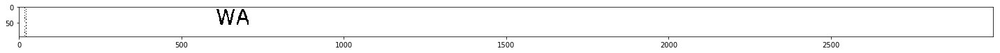

Image (54).jpg
UI/25/L£U1L16 76 -A&Sd /5 MENLO PARK CA -2./8
Amount was not detected, re-attempting by removing commas
[None, None, 'UI/25/L£U1L16 76 -A&Sd /5 MENLO PARK CA -2./8']


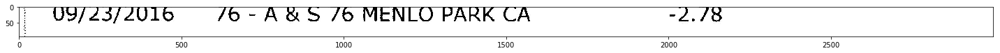

NOV /a97 /9n7AL VLsJFAAITOE COR ATASNSO SC UL ITOCOALONN q4fr7 Cr
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NOV /a97 /9n7AL VLsJFAAITOE COR ATASNSO SC UL ITOCOALONN q4fr7 Cr']


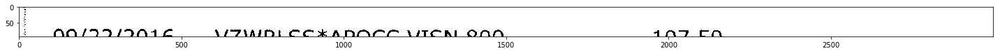


Amount was not detected, re-attempting by removing commas
[None, None, '']


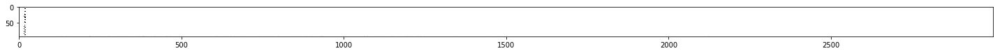

09/22/2016 VZWRLSS*APOCC VISN 800- -107.50

Lan, rare
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 9, 22), None, ' VZWRLSS*APOCC VISN 800- -107.50\n\nLan, rare']


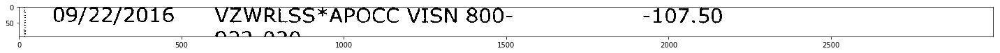

09/22/2016 VZWRLSS*APOCC VISN 800- -107.50
[datetime.date(2016, 9, 22), -107.5, ' VZWRLSS*APOCC VISN 800- ']


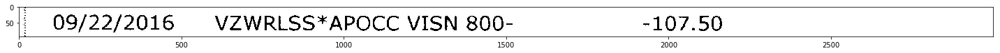

922-020
Adjusting Window
[None, -20.0, '922']


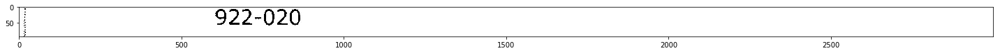

ce, SM a
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ce, SM a']


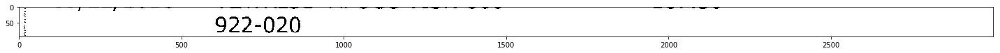

922-020
Adjusting Window
[None, -20.0, '922']


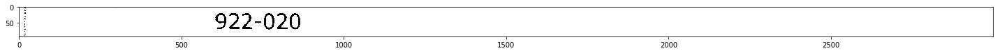

922-020
[None, -20.0, '922']


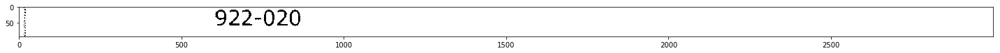

09/22/2016 AMAZON MKTPLACE PMTS -10.99

ai ie mg: as
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 9, 22), None, ' AMAZON MKTPLACE PMTS -10.99\n\nai ie mg: as']


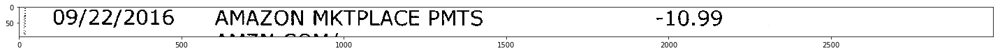

09/22/2016 AMAZON MKTPLACE PMTS -~10.99
[datetime.date(2016, 9, 22), -10.99, ' AMAZON MKTPLACE PMTS -~10.99']


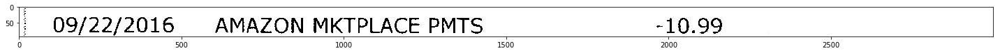

AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/']


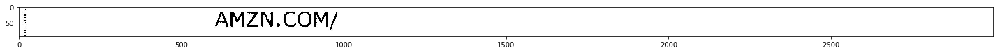

ete oN ee ee © RE ES Re GN BR Nt ee ll me Ew

AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ete oN ee ee © RE ES Re GN BR Nt ee ll me Ew\n\nAMZN.COM/']


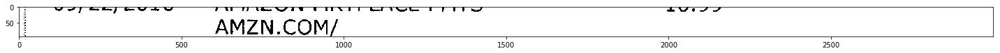

AMZN.COM/ it” 
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/ it” ']


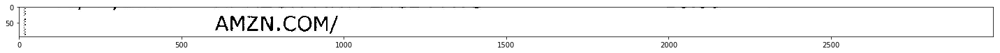

AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/']


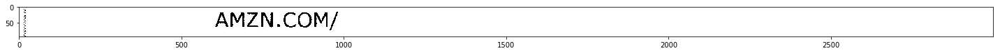

ZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ZN.COM/']


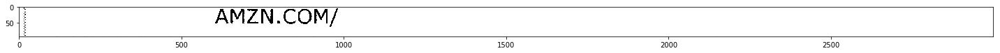

MI/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MI/']


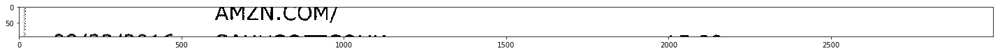

AMIEZIN,OCUPTY,

roy, (an soma ee Y cnet, Ge ee ee 0 al a ees ee ee on 2~rtr TT
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMIEZIN,OCUPTY,\n\nroy, (an soma ee Y cnet, Ge ee ee 0 al a ees ee ee on 2~rtr TT']


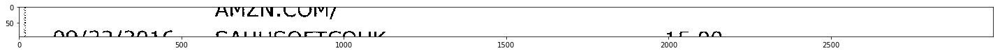

PNET TINNY

Na/avr,a /s/IDnWGaA CALILICHETCOLR I! Il co nny
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PNET TINNY\n\nNa/avr,a /s/IDnWGaA CALILICHETCOLR I! Il co nny']


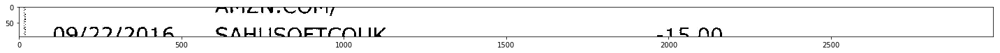

a a m fg

NG/PI/IOIEGE CSCAHIISOFTCOILIK -15 00
Adjusting Window
[None, -15.0, 'a a m fg\n\nNG/PI/IOIEGE CSCAHIISOFTCOILIK ']


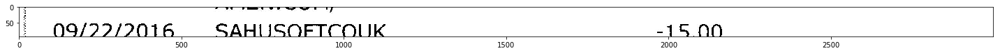

09/22/2016 SAHUSOFTCOUK ~15.00
[datetime.date(2016, 9, 22), -15.0, ' SAHUSOFTCOUK ~15.00']


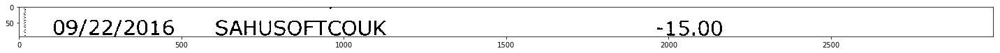

442088099260
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '442088099260']


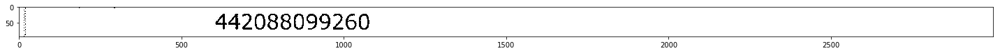

Wwf &GejfevVvsiv Se ee ee br

A40088099760
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Wwf &GejfevVvsiv Se ee ee br\n\nA40088099760']


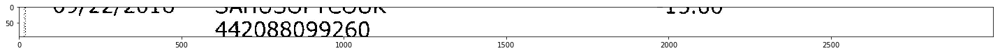

ae ES

442088099260 ©

a EO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ae ES\n\n442088099260 ©\n\na EO']


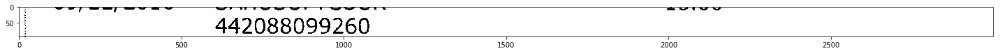

442088099260
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '442088099260']


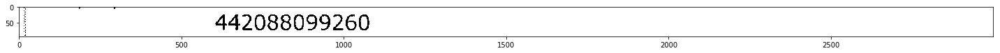

442088099260
Amount was not detected, re-attempting by removing commas
[None, None, '442088099260']


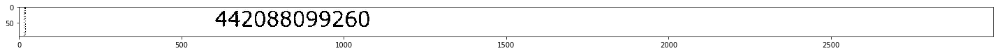

09/19/2016 SQ *CHARLES SANDMAN 877- -14.00
[datetime.date(2016, 9, 19), -14.0, ' SQ *CHARLES SANDMAN 877- ']


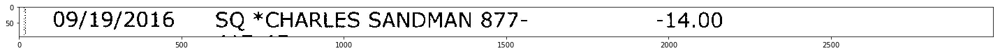

eee oe

L/-4)

mm mee cll ll

een: cil: mca: pes cdc cm kk
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'eee oe\n\nL/-4)\n\nmm mee cll ll\n\neen: cil: mca: pes cdc cm kk']


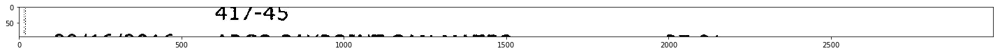

417-45
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '417-45']


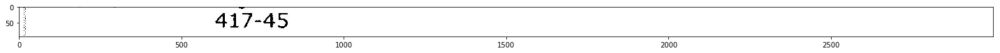

417-45
Amount was not detected, re-attempting by removing commas
[None, None, '417-45']


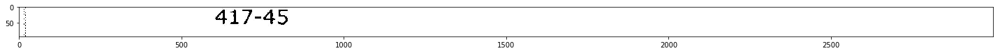

09/16/2016 ARCO PAYPOINT SAN MATEO -37.01
[datetime.date(2016, 9, 16), -37.01, ' ARCO PAYPOINT SAN MATEO ']


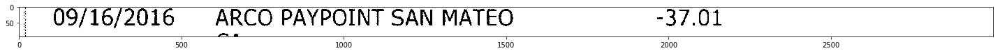

a a ee ee a a wm: penesztnoenan e ~e | UC6M™DhUcrhlUCUra lc Tlc rl klk eee hl Oe
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'a a ee ee a a wm: penesztnoenan e ~e | UC6M™DhUcrhlUCUra lc Tlc rl klk eee hl Oe']


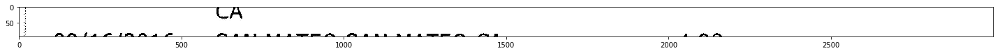

CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CA']


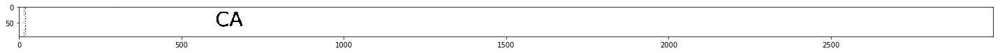


Amount was not detected, re-attempting by removing commas
[None, None, '']


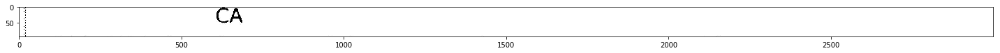

09/16/2016 SAN MATEO SAN MATEO CA -4.98
[datetime.date(2016, 9, 16), -4.98, ' SAN MATEO SAN MATEO CA ']


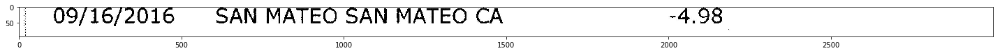

fram 44 fF" sr et

LarrTre

f™ LAT

fara t ron f™ Af" RAPTALE

rr

“
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'fram 44 fF- sr et\n\nLarrTre\n\nf™ LAT\n\nfara t ron f™ Af- RAPTALE\n\nrr\n\n“']


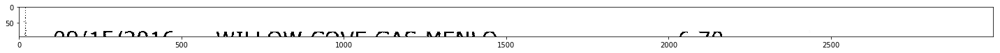


Amount was not detected, re-attempting by removing commas
[None, None, '']


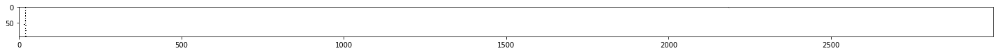

09/15/2016 WILLOW COVE GAS MENLO -6.70

™, Aris’ /7"(™ A
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 9, 15), None, ' WILLOW COVE GAS MENLO -6.70\n\n™, Aris’ /7-(™ A']


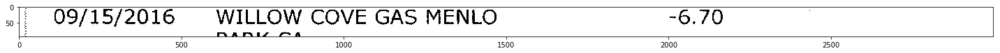

09/15/2016 WILLOW COVE GAS MENLO -6.70
[datetime.date(2016, 9, 15), -6.7, ' WILLOW COVE GAS MENLO ']


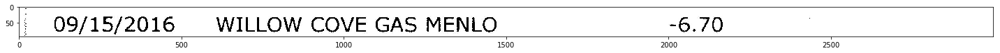

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


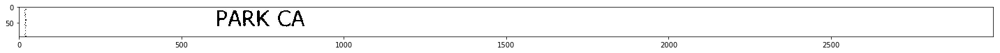



F

mee

 



PARK CA

 SS

*

tT

co,

7 oe
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '\n\nF\n\nmee\n\n \n\n\n\nPARK CA\n\n SS\n\n*\n\ntT\n\nco,\n\n7 oe']


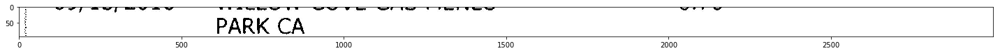

PARK CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PARK CA']


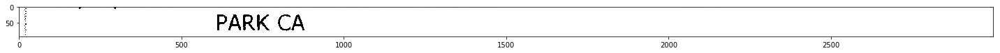

PARK CA
Amount was not detected, re-attempting by removing commas
[None, None, 'PARK CA']


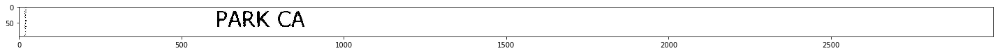

09/14/2016 7-ELEVEN SAN MATEO CA -3.48
[datetime.date(2016, 9, 14), -3.48, ' 7-ELEVEN SAN MATEO CA ']


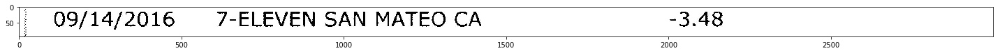


Amount was not detected, re-attempting by removing commas
[None, None, '']


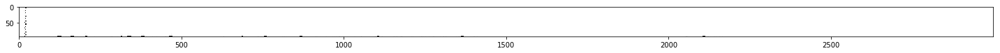

09/14/2016 A&S /6 MENLO PARK CA -4.97/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 9, 14), None, ' A&S /6 MENLO PARK CA -4.97/']


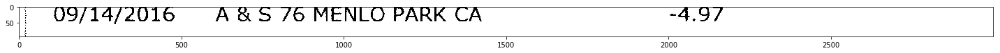

09/14/2016 A &S 76 MENLO PARK CA -4.97
[datetime.date(2016, 9, 14), -4.97, ' A &S 76 MENLO PARK CA ']


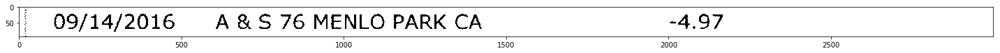


Amount was not detected, re-attempting by removing commas
[None, None, '']


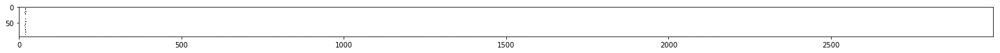

09/14/2016

IKEA EAST PALO ALTO E PALO

-8.15
[datetime.date(2016, 9, 14), -8.15, '\n\nIKEA EAST PALO ALTO E PALO\n\n']


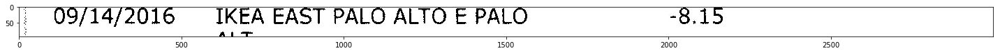

AL!

fri fs, 114 ™ IA 4 Of r™@™ ARE AA ASO SO hCUP™lUARKMCCUAL OUR AC AK TOE ee OW!UC SP ™ ~ é¢f 6
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AL!\n\nfri fs, 114 ™ IA 4 Of r™@™ ARE AA ASO SO hCUP™lUARKMCCUAL OUR AC AK TOE ee OW!UC SP ™ ~ é¢f 6']


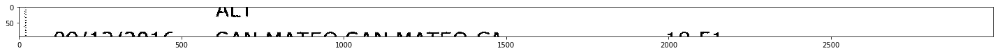

ALT
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ALT']


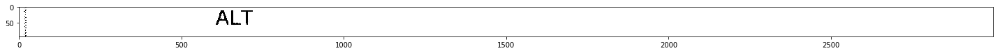


Amount was not detected, re-attempting by removing commas
[None, None, '']


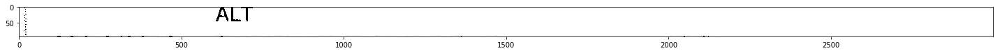

UP/1L2Z/ZVULG6 SAN MATEQ SAN MATEO CA “10.91
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'UP/1L2Z/ZVULG6 SAN MATEQ SAN MATEO CA “10.91']


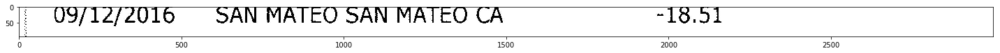

09/12/2016 §SAN MATEO SAN MATEO CA -18.51
[datetime.date(2016, 9, 12), -18.51, ' §SAN MATEO SAN MATEO CA ']


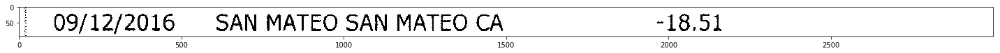


Amount was not detected, re-attempting by removing commas
[None, None, '']


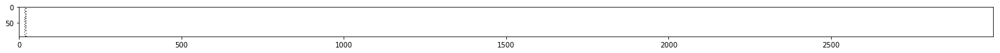

09/12/2016 SAN MATEO SAN MATEO CA -2.00
[datetime.date(2016, 9, 12), -2.0, ' SAN MATEO SAN MATEO CA ']


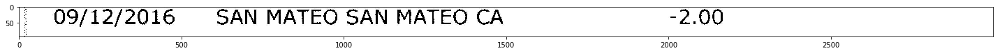

em 4 ot ™ ULL, rl

P st

rmirranif

Fr A I

f™~

_

 ge gfmnmh
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'em 4 ot ™ ULL, rl\n\nP st\n\nrmirranif\n\nFr A I\n\nf™~\n\n_\n\n ge gfmnmh']


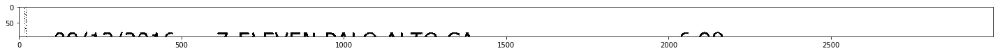


Amount was not detected, re-attempting by removing commas
[None, None, '']


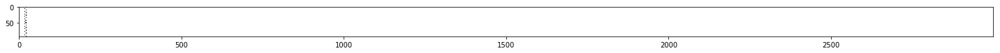

09/12/2016 7-ELEVEN PALO ALTO CA -6.98
[datetime.date(2016, 9, 12), -6.98, ' 7-ELEVEN PALO ALTO CA ']


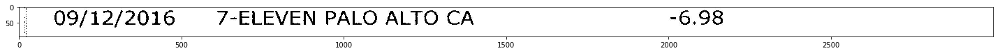

ee eee ee eee ee ee ee ea nmnana sais 7 pnpaperraqwisiioil oo ~/ og
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee eee ee eee ee ee ee ea nmnana sais 7 pnpaperraqwisiioil oo ~/ og']


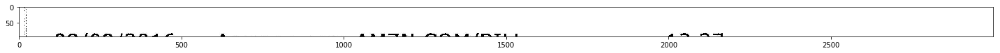


Amount was not detected, re-attempting by removing commas
[None, None, '']


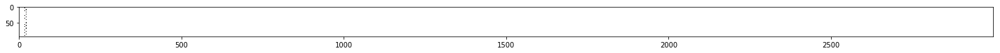

09/09/2016 Amazon.com AMZN.COM/BILL -12.27
[datetime.date(2016, 9, 9), -12.27, ' Amazon.com AMZN.COM/BILL ']


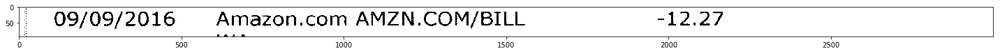

ae

a il aaa

gee ae et

ae ei a

a a a i a a ia

gu | Sk. Sa.

ae

joa: cae
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ae\n\na il aaa\n\ngee ae et\n\nae ei a\n\na a a i a a ia\n\ngu | Sk. Sa.\n\nae\n\njoa: cae']


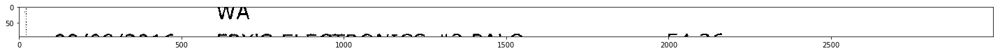

WA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'WA']


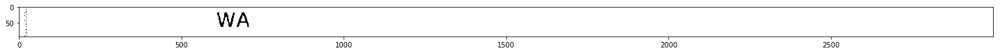


Amount was not detected, re-attempting by removing commas
[None, None, '']


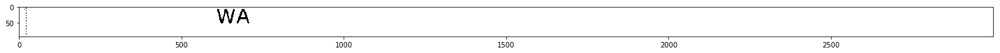

09/08/2016 ~~ FRY'S ELECTRONICS #3 PALO -54.36

Le ~~
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 9, 8), None, " -- FRY'S ELECTRONICS #3 PALO -54.36\n\nLe --"]


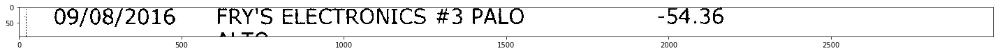

09/08/2016  FRY'S ELECTRONICS #3 PALO -54.36
[datetime.date(2016, 9, 8), -54.36, "  FRY'S ELECTRONICS #3 PALO "]


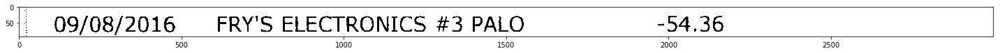

ALTO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ALTO']


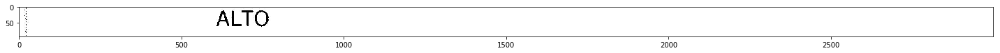

ALTO

a a Sa a SR Ne: ae SNe Se FS ee Tn ee, eee eee eS a ee UL Ul: UU lL _ ee oe
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ALTO\n\na a Sa a SR Ne: ae SNe Se FS ee Tn ee, eee eee eS a ee UL Ul: UU lL _ ee oe']


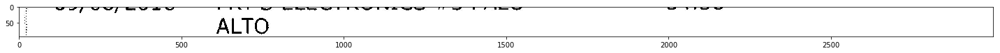

ALTO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ALTO']


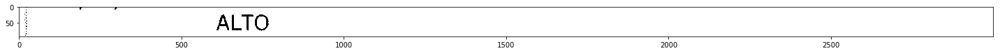

ALTO
Amount was not detected, re-attempting by removing commas
[None, None, 'ALTO']


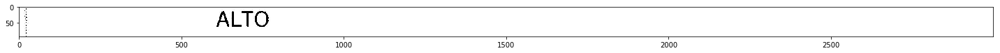

Image (55).jpg
08/29/2016 Dropbox*LL4JZY69BLK8 | -9.99
[datetime.date(2016, 8, 29), -9.99, ' Dropbox*LL4JZY69BLK8 | ']


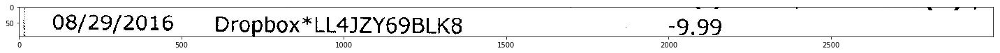

db.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'db.tt/cch']


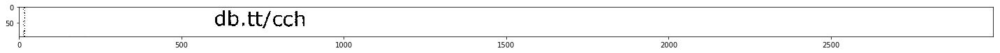

EEE ee ee See See ee el be FO

db.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'EEE ee ee See See ee el be FO\n\ndb.tt/cch']


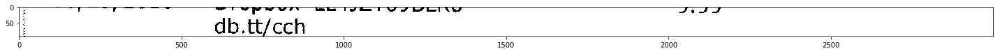

db.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'db.tt/cch']


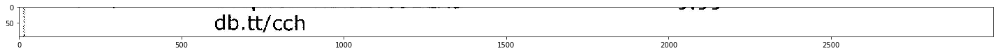

db.tt/cch
Amount was not detected, re-attempting by removing commas
[None, None, 'db.tt/cch']


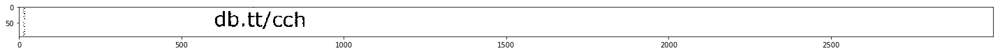

08/29/2016  SAN MATEO SAN MATEO CA -2.00
[datetime.date(2016, 8, 29), -2.0, '  SAN MATEO SAN MATEO CA ']


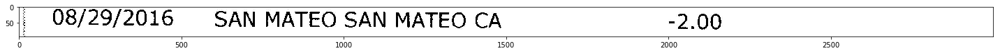

mr, FF wm FF i ome Mm CC
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'mr, FF wm FF i ome Mm CC']


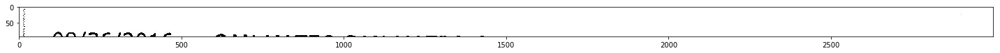


Amount was not detected, re-attempting by removing commas
[None, None, '']


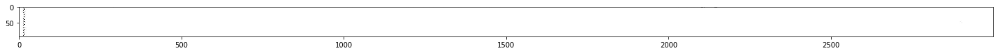

08/26/2016  SAN MATEO SAN MATEO CA -14.00
[datetime.date(2016, 8, 26), -14.0, '  SAN MATEO SAN MATEO CA ']


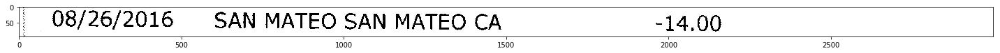

femme soem
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'femme soem']


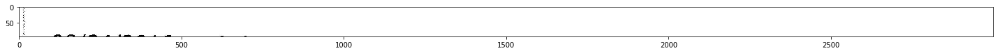

a 7s  a EERE EEE EEE OS I ad
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'a 7s  a EERE EEE EEE OS I ad']


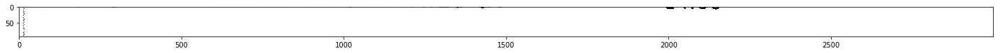


Amount was not detected, re-attempting by removing commas
[None, None, '']


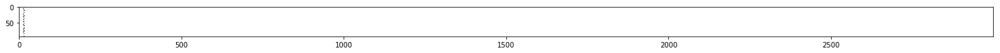

08/24/2016 Online Transfer to CHK ...5312 -20,000.00
Amount was not detected, re-attempting by removing commas
[datetime.date(2016, 8, 24), -20000.0, ' Online Transfer to CHK ...5312 -20,000.00']


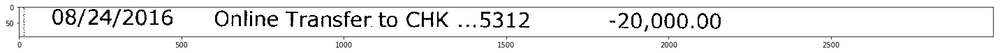

mi: aes ua ca ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'mi: aes ua ca ee']


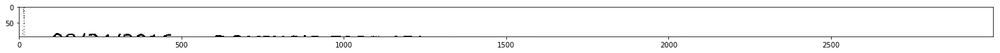


Amount was not detected, re-attempting by removing commas
[None, None, '']


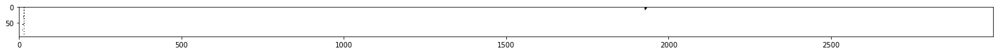

08/24/2016 DOMINO'S 7927 650-344-3030 -28.11
[datetime.date(2016, 8, 24), -28.11, " DOMINO'S 7927 650-344-3030 "]


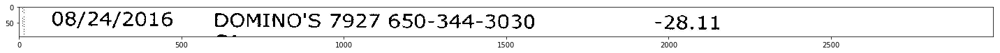


Amount was not detected, re-attempting by removing commas
[None, None, '']


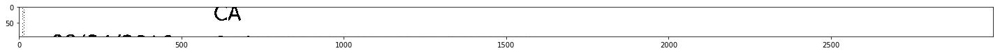

U6/24/LZU10 SEQUOIA-WUKSACHI GIFT 559- -3.51

“aa r
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'U6/24/LZU10 SEQUOIA-WUKSACHI GIFT 559- -3.51\n\n“aa r']


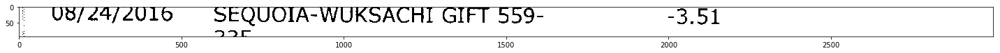

08/24/2016 §SEQUOIA-WUKSACHI GIFT 559- -3.51
[datetime.date(2016, 8, 24), -3.51, ' §SEQUOIA-WUKSACHI GIFT 559- ']


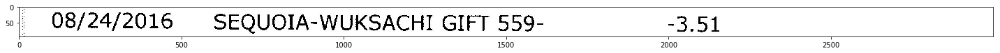

335-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '335-']


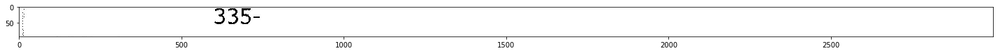


Amount was not detected, re-attempting by removing commas
[None, None, '']


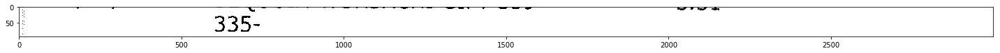

08/24/2016 © SEQUOIA- LODGEPOLE 559- -5.43
[datetime.date(2016, 8, 24), -5.43, ' © SEQUOIA- LODGEPOLE 559- ']


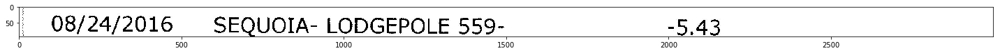

335-550
Adjusting Window
[None, -550.0, '335']


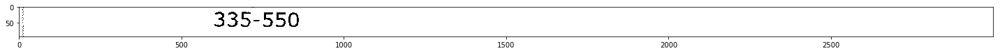

~~ ee ee mele, Oe ae crt inet eid Fe

335-550
Adjusting Window
[None, None, '-- ee ee mele, Oe ae crt inet eid Fe\n']


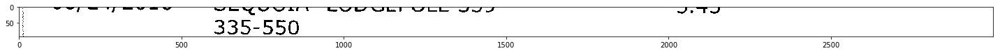

335-550
Adjusting Window
[None, -550.0, '335']


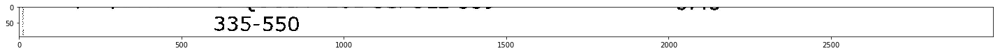

335-550
[None, -550.0, '335']


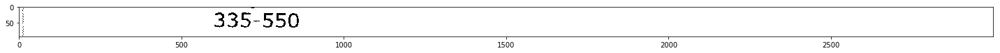

08/24/2016 SEQUOIA KINGS-LDGEPOL -22.00
[datetime.date(2016, 8, 24), -22.0, ' SEQUOIA KINGS-LDGEPOL ']


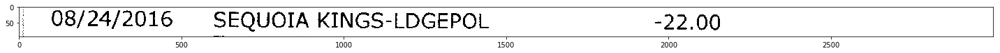

TAREE RI
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'TAREE RI']


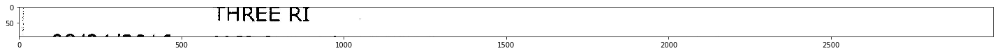

THREE RI
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'THREE RI']


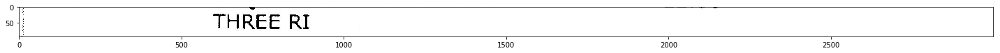

THREE RI
Amount was not detected, re-attempting by removing commas
[None, None, 'THREE RI']


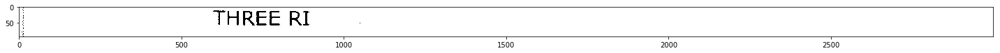

08/24/2016 MCDONALD'S F16313 -8.05

na wm™, Fe 2 Fe CO, On
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 8, 24), None, " MCDONALD'S F16313 -8.05\n\nna wm™, Fe 2 Fe CO, On"]


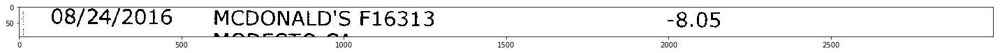

08/24/2016 MCDONALD'S F16313 -8.05
[datetime.date(2016, 8, 24), -8.05, " MCDONALD'S F16313 "]


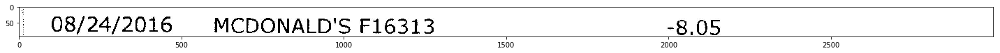

MODESTO CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MODESTO CA']


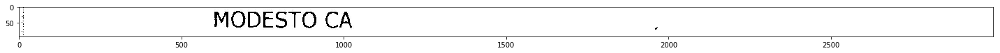

_

fo ff ee

ff Nw be ee EF

MODESTO CA

me Ne ee

we
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '_\n\nfo ff ee\n\nff Nw be ee EF\n\nMODESTO CA\n\nme Ne ee\n\nwe']


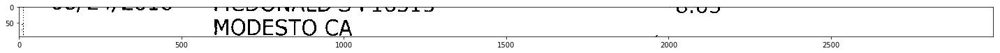

MODESTOCA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MODESTOCA']


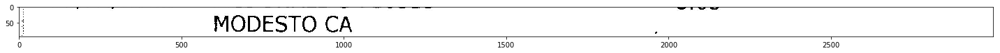

MODESTO CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MODESTO CA']


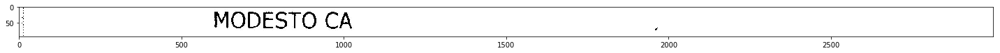

MODESTO CA
Amount was not detected, re-attempting by removing commas
[None, None, 'MODESTO CA']


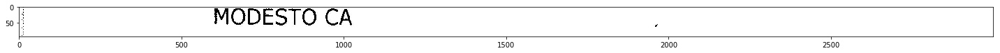

08/23/2016 THREE RIVER CHEVRON THREE -3.93

rm Ti1rT
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 8, 23), None, ' THREE RIVER CHEVRON THREE -3.93\n\nrm Ti1rT']


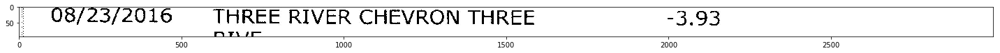

08/23/2016 THREE RIVER CHEVRON THREE -3.93
[datetime.date(2016, 8, 23), -3.93, ' THREE RIVER CHEVRON THREE ']


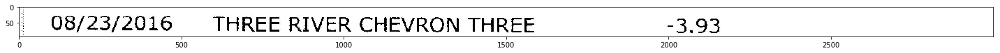

RIVE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'RIVE']


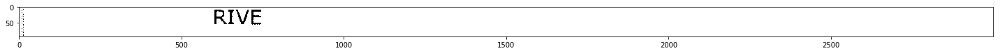

eh Fe  ee UE See ee SS 8 0 $f Gee Eee It
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'eh Fe  ee UE See ee SS 8 0 $f Gee Eee It']


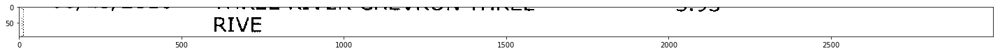

RIVE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'RIVE']


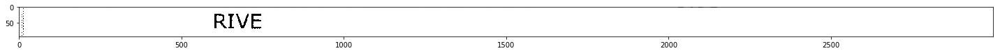

RIVE
Amount was not detected, re-attempting by removing commas
[None, None, 'RIVE']


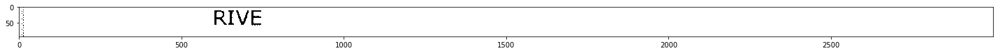

08/23/2016 ; RAYMOND JAMES & 19,884.84

ee ee ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 8, 23), None, ' ; RAYMOND JAMES & 19,884.84\n\nee ee ee']


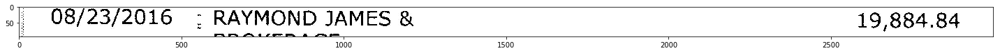

08/23/2016 - RAYMOND JAMES & 19,884.84
Amount was not detected, re-attempting by removing commas
[datetime.date(2016, 8, 23), 19884.84, ' - RAYMOND JAMES & 19,884.84']


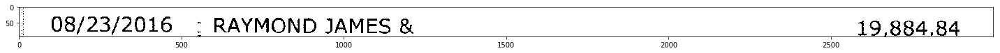

BROKERAGE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'BROKERAGE']


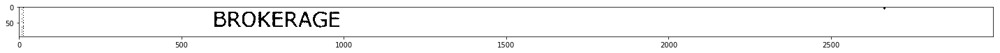

a ee | ee s FNS er EN rN AZ ,VUTIOT

~ BROKERAGE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'a ee | ee s FNS er EN rN AZ ,VUTIOT\n\n~ BROKERAGE']


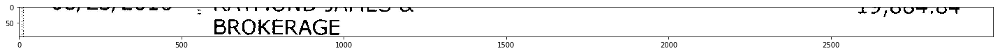

~ BROKERAGE |



  Fe
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '~ BROKERAGE |\n\n\n\n  Fe']


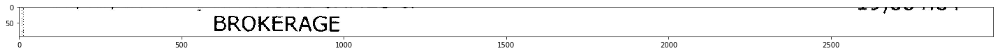

~ BROKERAGE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '~ BROKERAGE']


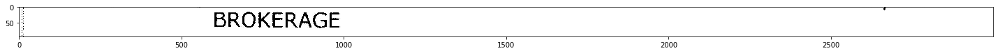

BROKERAGE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'BROKERAGE']


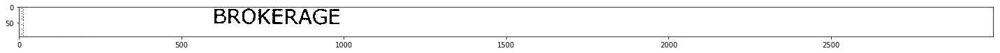

DROKCRAGE

ee ae BS
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'DROKCRAGE\n\nee ae BS']


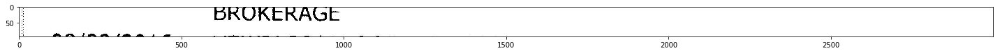

Lr 1taAanr 1A Ma

DAVUACKANOC

Ls Fer_aszremese P™ Mil 2 FM eM MR 1 te Mei ~ me Mm
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Lr 1taAanr 1A Ma\n\nDAVUACKANOC\n\nLs Fer_aszremese P™ Mil 2 FM eM MR 1 te Mei ~ me Mm']


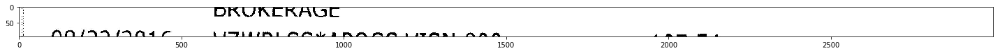

bMVINNYINLIANPA L

 

Nola ~7, /9Nn~As LITFUIT LE COCK ANISM LITToAL ANARN ans ma
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'bMVINNYINLIANPA L\n\n \n\nNola ~7, /9Nn~As LITFUIT LE COCK ANISM LITToAL ANARN ans ma']


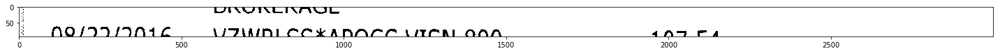

ORE: PMS: A _

NQ/99/9NI1G VIF\AIDI CCKADASS VTICN ONNH. 4Nn9 CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ORE: PMS: A _\n\nNQ/99/9NI1G VIF\\AIDI CCKADASS VTICN ONNH. 4Nn9 CA']


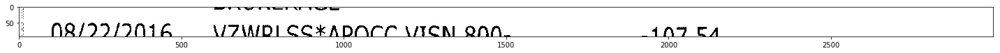

08/27/9016 VUJ\WRISSC*XADOCC VICN RO0- -1N7 CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, ' VUJ\\WRISSC*XADOCC VICN RO0- -1N7 CA']


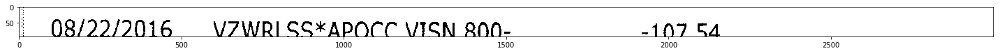

08/22/2016  VZWRLSS*APOCC VISN 800- -107.54
[datetime.date(2016, 8, 22), -107.54, '  VZWRLSS*APOCC VISN 800- ']


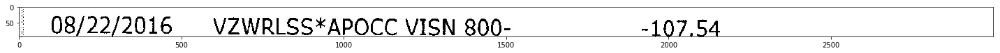

922-020
Adjusting Window
[None, -20.0, '922']


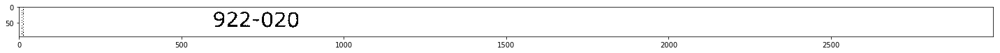

922-020

NN Oe ef won WV Ge VU Nb OPN NY NN VEIN OU  ts
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '922-020\n\nNN Oe ef won WV Ge VU Nb OPN NY NN VEIN OU  ts']


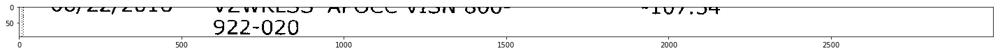

EE eee we ee 

922-020

 

ee ee ee _ a EO ee  et FS
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'EE eee we ee \n\n922-020\n\n \n\nee ee ee _ a EO ee  et FS']


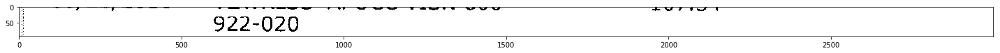

922-020
Adjusting Window
[None, -20.0, '922']


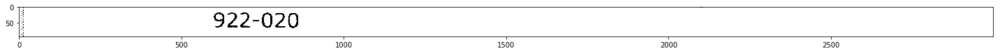

922-020
[None, -20.0, '922']


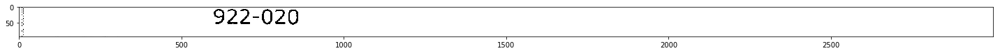

08/22/2016 CHIPOTLE 2028 SAN MATEO CA -9.01
[datetime.date(2016, 8, 22), -9.01, ' CHIPOTLE 2028 SAN MATEO CA ']


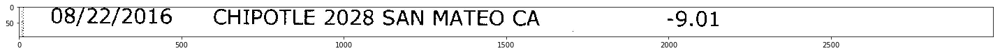

frit y fmm FF ™momr 6s a krE  rw |S Sew Pw ee eee fll kllmlCUlU eC ell
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'frit y fmm FF ™momr 6s a krE  rw |S Sew Pw ee eee fll kllmlCUlU eC ell']


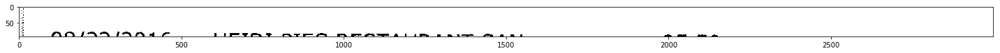


Amount was not detected, re-attempting by removing commas
[None, None, '']


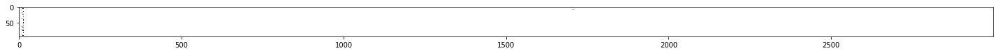

08/22/2016 HEIDI PIES RESTAURANT SAN -25.50
[datetime.date(2016, 8, 22), -25.5, ' HEIDI PIES RESTAURANT SAN ']


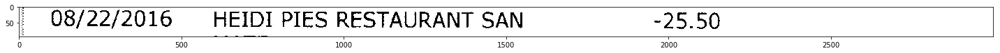


Amount was not detected, re-attempting by removing commas
[None, None, '']


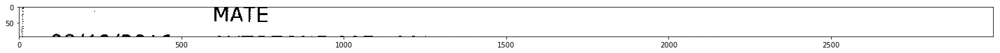

Vo/La/ZU10 AUIOZONE 2654 3650 5S SAN -6.86

RA ACT’
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Vo/La/ZU10 AUIOZONE 2654 3650 5S SAN -6.86\n\nRA ACT’']


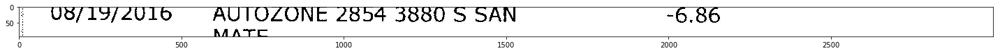

08/19/2016 AUTOZONE 2854 3880 S SAN -6.86
[datetime.date(2016, 8, 19), -6.86, ' AUTOZONE 2854 3880 S SAN ']


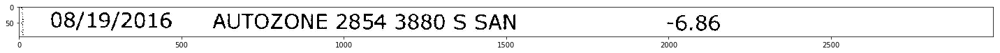

MATE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MATE']


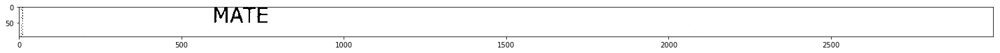

MATE
Amount was not detected, re-attempting by removing commas
[None, None, 'MATE']


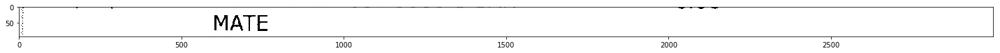

08/18/2016 SAFEWAY STORE 0970 SAN -27.22
[datetime.date(2016, 8, 18), -27.22, ' SAFEWAY STORE 0970 SAN ']


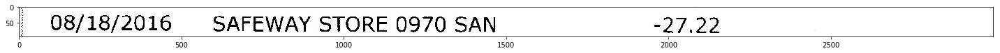


Amount was not detected, re-attempting by removing commas
[None, None, '']


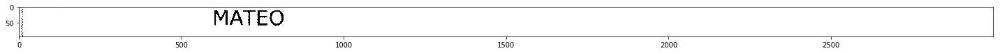

Image (56).jpg
Ud/1O0/2016 AIM CHECK DEPOSIT 03/10 1,4/5.00

ame mn m™m F_}
Amount was not detected, re-attempting by removing commas
[None, None, 'Ud/1O0/2016 AIM CHECK DEPOSIT 03/10 1,4/5.00\n\name mn m™m F_}']


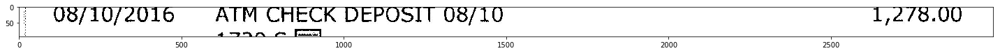

4/7 9OU O tess

fe oa TN PROTO 4 of Rinr™:1 a 7, Us e® PRE ST FS!OT "7 “7 A 1s 7™ -~™ ARI fm AAT anr so. rN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '4/7 9OU O tess\n\nfe oa TN PROTO 4 of Rinr™:1 a 7, Us e® PRE ST FS!OT -7 “7 A 1s 7™ -~™ ARI fm AAT anr so. rN']


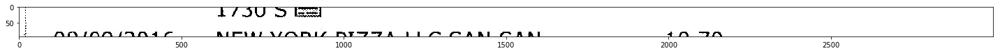

1730S
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '1730S']


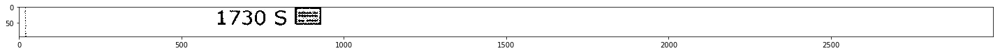

1/30 5 ES
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '1/30 5 ES']


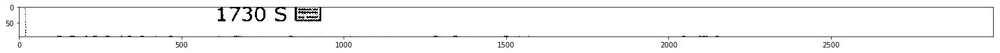

rue fe Frm TO rm tt oe

L/OU OO tee

Rminm™si ar ts em PFPRitsf? FT  "93 A

y y BRS

g -£&A mE

gor “| ~~
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'rue fe Frm TO rm tt oe\n\nL/OU OO tee\n\nRminm™si ar ts em PFPRitsf? FT  -93 A\n\ny y BRS\n\ng -£&A mE\n\ngor “| --']


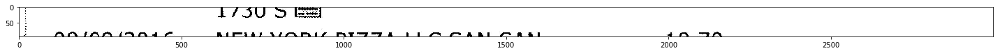

aL ANS wed Cel

 

L10O [HO /9XN+t AICTL\AIL VFA MTZITZTA ILI Mm CARAIL OC AASL “f\ “7L\
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aL ANS wed Cel\n\n \n\nL10O [HO /9XN+t AICTL\\AIL VFA MTZITZTA ILI Mm CARAIL OC AASL “f\\ “7L\\']


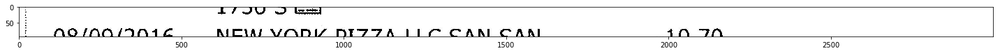

ae el NE Keer

NQINA/INIC NiC\A/ VOD DIVJAIIC CAN CAN ~10 7
Adjusting Window
[None, -10.7, 'ae el NE Keer\n\nNQINA/INIC NiC\\A/ VOD DIVJAIIC CAN CAN ~10 7']


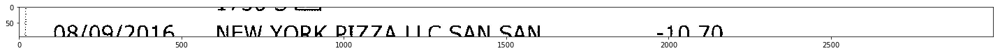

ONR/NO/IN1I6 NEW YORK PI7V7ZVAI1IC SAN SAN -10 70
Adjusting Window
[None, -10.7, 'ONR/NO/IN1I6 NEW YORK PI7V7ZVAI1IC SAN SAN ']


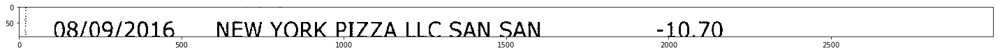

08/09/2016 NEW YORK PIZZA LLC SAN SAN -10.70
[datetime.date(2016, 8, 9), -10.7, ' NEW YORK PIZZA LLC SAN SAN ']


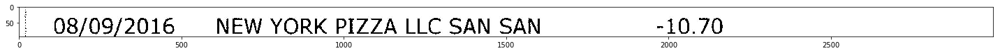

CAR
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CAR']


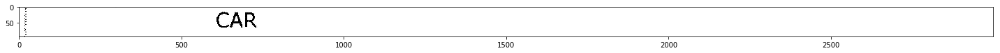

NANG NAG EARN BN 'Vnv¥ bE NWZENEN F £22. eh PUI BEN ae Ne ONY

CAR
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, "NANG NAG EARN BN 'Vnv¥ bE NWZENEN F £22. eh PUI BEN ae Ne ONY\n\nCAR"]


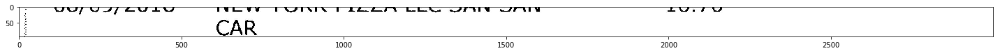


Amount was not detected, re-attempting by removing commas
[None, None, '']


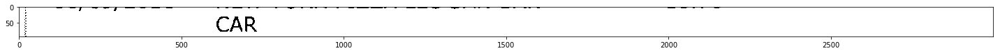

08/09/2016 SQC* 21.00
[datetime.date(2016, 8, 9), 21.0, ' SQC*']


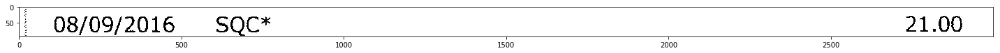

08/08/2016 DOORDASH.COM 650-681-9470 -31.19
[datetime.date(2016, 8, 8), -31.19, ' DOORDASH.COM 650-681-9470 ']


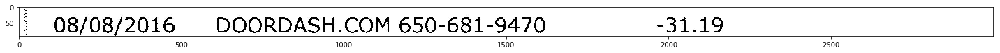

CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CA']


Mt NE Con el ote Ne Rat Ne Ne EON ee et et ee BN el et et ee EF ee 8 eke

CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Mt NE Con el ote Ne Rat Ne Ne EON ee et et ee BN el et et ee EF ee 8 eke\n\nCA']


CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CA']


CA
Amount was not detected, re-attempting by removing commas
[None, None, 'CA']


08/08/2016 SAFEWAY STORE 0970 SAN -85.09
[datetime.date(2016, 8, 8), -85.09, ' SAFEWAY STORE 0970 SAN ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


05/06/2016 IN-N-QUT BURGER #257 SAN -31.25

f™- AFA £S”
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 5, 6), None, ' IN-N-QUT BURGER #257 SAN -31.25\n\nf™- AFA £S”']


08/08/2016 IN-N-OUT BURGER #257 SAN -31.23
Adjusting Window
[None, -31.23, ' IN-N-OUT BURGER #257 SAN ']


08/08/2016 IN-N-OUT BURGER #257 SAN -31.23
[datetime.date(2016, 8, 8), -31.23, ' IN-N-OUT BURGER #257 SAN ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


Udo/U6/2ZU16 Onine transrer to SAV ...Us60 -2£,U0U,U0
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Udo/U6/2ZU16 Onine transrer to SAV ...Us60 -2£,U0U,U0']


08/08/2016 Online Transfer to SAV ...0380 -2,000.00
Amount was not detected, re-attempting by removing commas
[datetime.date(2016, 8, 8), -2000.0, ' Online Transfer to SAV ...0380 -2,000.00']



Amount was not detected, re-attempting by removing commas
[None, None, '']


08/08/2016 LOS MORENO TAQUERIA SAN -23.16

RAAT ORT
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 8, 8), None, ' LOS MORENO TAQUERIA SAN -23.16\n\nRAAT ORT']


08/08/2016 LOS MORENO TAQUERIA SAN -23.16
[datetime.date(2016, 8, 8), -23.16, ' LOS MORENO TAQUERIA SAN ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


08/08/2016 PENINSULA FAMILY YMCA 650- -32.00

“~~ ~OO ff”
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 8, 8), None, ' PENINSULA FAMILY YMCA 650- -32.00\n\n“-- -OO ff”']


08/08/2016 PENINSULA FAMILY YMCA 650- -32.00
[datetime.date(2016, 8, 8), -32.0, ' PENINSULA FAMILY YMCA 650- ']


286-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '286-']


fem Rowe: ames oe ee SEN Ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'fem Rowe: ames oe ee SEN Ee']


286-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '286-']


286-
Amount was not detected, re-attempting by removing commas
[None, None, '286-']


08/08/2016 ADY*JetbrainsUSD -5.90
[datetime.date(2016, 8, 8), -5.9, ' ADY*JetbrainsUSD ']


me rm OEM Me Uhl Om hl

NUCPs .//WWW.)J

eo a ge ly

am! 4a!
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'me rm OEM Me Uhl Om hl\n\nNUCPs .//WWW.)J\n\neo a ge ly\n\nam! 4a!']


https://www.j
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'https://www.j']


https://www.j
Amount was not detected, re-attempting by removing commas
[None, None, 'https://www.j']


08/08/2016 SQC* 42.4/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 8, 8), None, ' SQC* 42.4/']


08/08/2016 SQC* 42.47
[datetime.date(2016, 8, 8), 42.47, ' SQC*']


08/05/2016 DOORDASH.COM -34.13
[datetime.date(2016, 8, 5), -34.13, ' DOORDASH.COM ']


DOORDASH.COM CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'DOORDASH.COM CA']


a a

ee a ee Oe:

DOORDASH.COM CA

2:5
Adjusting Window
[None, None, 'a a\n\nee a ee Oe:\n\nDOORDASH.COM CA\n']


DOORDASH.COM CA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'DOORDASH.COM CA']


DOORDASH.COM CA
Amount was not detected, re-attempting by removing commas
[None, None, 'DOORDASH.COM CA']


08/04/2016 SQC*ART PERKITNY ./ CA -40.00
[datetime.date(2016, 8, 4), -40.0, ' SQC*ART PERKITNY ./ CA ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


08/04/2016 ATM CASH DEPOSIT 08/04 25.00

_arna rh h6f
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 8, 4), None, ' ATM CASH DEPOSIT 08/04 25.00\n\n_arna rh h6f']


08/04/2016 © ATM CASH DEPOSIT 08/04 25.00
[datetime.date(2016, 8, 4), 25.0, ' © ATM CASH DEPOSIT 08/04']



Amount was not detected, re-attempting by removing commas
[None, None, '']


08/04/2016 ATM CHECK DEPOSIT 08/04 2,880.82

 
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 8, 4), None, ' ATM CHECK DEPOSIT 08/04 2,880.82\n\n ']


08/04/2016 © ATM CHECK DEPOSIT 08/04 2,880.82
Amount was not detected, re-attempting by removing commas
[datetime.date(2016, 8, 4), 2880.82, ' © ATM CHECK DEPOSIT 08/04 2,880.82']


1730S
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '1730S']




 Ee eee



SESE Ee SS

1730 S |
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '\n\n Ee eee\n\n\n\nSESE Ee SS\n\n1730 S |']


1730S
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '1730S']


1730S
Amount was not detected, re-attempting by removing commas
[None, None, '1730S']


08/03/2016 SHAW'S BEACON SALINAS CA -12.50
[datetime.date(2016, 8, 3), -12.5, " SHAW'S BEACON SALINAS CA "]



Amount was not detected, re-attempting by removing commas
[None, None, '']


Newer
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Newer']


Bad vpesazee en
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Bad vpesazee en']


Ai error
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Ai error']


Newer
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Newer']


Newer
Amount was not detected, re-attempting by removing commas
[None, None, 'Newer']


Image (57).jpg
08/01/2016 APPLEWOOD GAS EXPRESS -29.96

a me 7. ote oo
Amount was not detected, re-attempting by removing commas
[datetime.date(2016, 8, 1), None, ' APPLEWOOD GAS EXPRESS -29.96\n\na me 7. ote oo']


GOLUEN ©

Pa ee ne ee eee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'GOLUEN ©\n\nPa ee ne ee eee']


GOLDEN C
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'GOLDEN C']


GOLDEN C
Amount was not detected, re-attempting by removing commas
[None, None, 'GOLDEN C']


08/01/2016 KUSKIE INT'L SVC & CAF -18.23

far fa fue Fs Ure
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 8, 1), None, " KUSKIE INT'L SVC & CAF -18.23\n\nfar fa fue Fs Ure"]


08/01/2016 KUSKIE INT'L SVC & CAF -18.23
[datetime.date(2016, 8, 1), -18.23, " KUSKIE INT'L SVC & CAF "]


CROOK C
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CROOK C']


ee ee eee ager eee A to Soe a US 6K  SE EE ee a ew! ee

CROOK C
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee ee eee ager eee A to Soe a US 6K  SE EE ee a ew! ee\n\nCROOK C']


CROOK C
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CROOK C']


CROOK C
Amount was not detected, re-attempting by removing commas
[None, None, 'CROOK C']


08/01/2016 § FIRSTMERIT BANK TRANSFER 350.00
[datetime.date(2016, 8, 1), 350.0, ' § FIRSTMERIT BANK TRANSFER']


07/29/2016 Dropbox*WSD349Y1Z65C -9.99
[datetime.date(2016, 7, 29), -9.99, ' Dropbox*WSD349Y1Z65C ']


a)0.0/Ccn

rf | Fam Fe ee Oe eee ee OO ee ee , gn ~ we ge a
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'a)0.0/Ccn\n\nrf | Fam Fe ee Oe eee ee OO ee ee , gn ~ we ge a']


db.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'db.tt/cch']


tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'tt/cch']


ao.tt/ccn

rf “ Fe peirem™ ew i i ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ao.tt/ccn\n\nrf “ Fe peirem™ ew i i ee']


UU. CUT!

fy7/aAO (ont? CDN TL" Kk ART CMT TATA tf [7A yA NA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'UU. CUT!\n\nfy7/aAO (ont? CDN TL- Kk ART CMT TATA tf [7A yA NA']


Met VN

ONT7/ZJAQA/IN1G CHC KADT DEDI-TTAIV / fn -~_279 1
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Met VN\n\nONT7/ZJAQA/IN1G CHC KADT DEDI-TTAIV / fn -~_279 1']


fee ee ee ee ESS ee! Se

O7/I9/7016 SOCXART PFRKTTNY /CA -29 11
Adjusting Window
[None, -29.11, 'fee ee ee ee ESS ee! Se\n\nO7/I9/7016 SOCXART PFRKTTNY /CA ']


07/29/2016 SOC*ART PERKITNY ./ CA -37.01
[datetime.date(2016, 7, 29), -37.01, ' SOC*ART PERKITNY ./ CA ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


07/28/2016 SHELL Service Station OMAHA -8.50
[datetime.date(2016, 7, 28), -8.5, ' SHELL Service Station OMAHA ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


07/28/2016 Amazon.com AMZN.COM/BILL -14.74
[datetime.date(2016, 7, 28), -14.74, ' Amazon.com AMZN.COM/BILL ']


VA

f/. ™) F yew? FO, OO Ct ee eS ee ee a ee ee aasan mS DP e ss Ae we, BD
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'VA\n\nf/. ™) F yew? FO, OO Ct ee eS ee ee a ee ee aasan mS DP e ss Ae we, BD']


WA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'WA']



Amount was not detected, re-attempting by removing commas
[None, None, '']


O//2/7/2016 CASEYS 2421 WASHINGTON -32.43

rarv),e tA T
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'O//2/7/2016 CASEYS 2421 WASHINGTON -32.43\n\nrarv),e tA T']


07/27/2016 CASEYS 2421 WASHINGTON -32.43
[datetime.date(2016, 7, 27), -32.43, ' CASEYS 2421 WASHINGTON ']


PELLA I
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PELLA I']


a - ae
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'a - ae']


PELLA I
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'PELLA I']


PELLA I
Amount was not detected, re-attempting by removing commas
[None, None, 'PELLA I']


07/27/2016 SHELL Service Station NEW -30.46
[datetime.date(2016, 7, 27), -30.46, ' SHELL Service Station NEW ']


LCONO

te f~  6," _ py |! OS CO rer ™ FR em PSR SPU lls mel U™hUcrhlUr lO ~{_  ™
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'LCONO\n\nte f~  6,- _ py |! OS CO rer ™ FR em PSR SPU lls mel U™hUcrhlUr lO ~{_  ™']


LENO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'LENO']


LENO
Amount was not detected, re-attempting by removing commas
[None, None, 'LENO']


07/27/2016 PROGRESSIVE *INSURANC -2,/34.82

QKhrry. a
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 7, 27), None, ' PROGRESSIVE *INSURANC -2,/34.82\n\nQKhrry. a']


07/27/2016 PROGRESSIVE *INSURANC -2,/734.82
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 7, 27), None, ' PROGRESSIVE *INSURANC -2,/734.82']


07/27/2016 PROGRESSIVE *INSURANC -2,734.82
Amount was not detected, re-attempting by removing commas
[datetime.date(2016, 7, 27), -2734.82, ' PROGRESSIVE *INSURANC -2,734.82']



Amount was not detected, re-attempting by removing commas
[None, None, '']


Us/f2//Z0106 Amazon.com AMZN.COM/DILL -14.19

VAIA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Us/f2//Z0106 Amazon.com AMZN.COM/DILL -14.19\n\nVAIA']


07/27/2016 Amazon.com AMZN.COM/BILL -14.19
[datetime.date(2016, 7, 27), -14.19, ' Amazon.com AMZN.COM/BILL ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


07/27/2016 Online Transfer from SAV ...03
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2016, 7, 27), None, ' Online Transfer from SAV ...03']


07/27/2016 Online Transfer from SAV ...03 250.00
[datetime.date(2016, 7, 27), 250.0, ' Online Transfer from SAV ...03']



Amount was not detected, re-attempting by removing commas
[None, None, '']


07/26/2016 G2A COM KRAKOW -3.42
[datetime.date(2016, 7, 26), -3.42, ' G2A COM KRAKOW ']


, to om WT at oon eee ee ae wr, &£- |  _ a ae , aa gam mag iy -, , rr ~~ fr rr. rm
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, ', to om WT at oon eee ee ae wr, &£- |  _ a ae , aa gam mag iy -, , rr -- fr rr. rm']



Amount was not detected, re-attempting by removing commas
[None, None, '']


07/26/2016 Online Transfer from SAV ...03 2,500.00
Amount was not detected, re-attempting by removing commas
[datetime.date(2016, 7, 26), 2500.0, ' Online Transfer from SAV ...03 2,500.00']


ee en ee ee eee ee gia gi

 

a a a ca
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee en ee ee eee ee gia gi\n\n \n\na a a ca']



Amount was not detected, re-attempting by removing commas
[None, None, '']


07/25/2016 SQC*ART PERKITNY ./ CA -14.00
[datetime.date(2016, 7, 25), -14.0, ' SQC*ART PERKITNY ./ CA ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


U// 25/2016 SQC*ART PERKITNY . / CA -14.00
Adjusting Window
[None, -14.0, 'U// 25/2016 SQC*ART PERKITNY . / CA ']


07/25/2016 SQC*ART PERKITNY . / CA -14.00
[datetime.date(2016, 7, 25), -14.0, ' SQC*ART PERKITNY . / CA ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


Al eee cee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Al eee cee']



Amount was not detected, re-attempting by removing commas
[None, None, '']


Image (6).jpg
04/28/2017 CLOUD CHAMBER VAPOR LOU -25.63
[datetime.date(2017, 4, 28), -25.63, ' CLOUD CHAMBER VAPOR LOU ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


04/25/2017 WENDY'S 11541 AVON OH -12.37
[datetime.date(2017, 4, 25), -12.37, " WENDY'S 11541 AVON OH "]


fri AIT rr TAF. 4A |S

2. rm AY we Ld,

‘- _ e ees e

st ae

ge

‘wes ae
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'fri AIT rr TAF. 4A |S\n\n2. rm AY we Ld,\n\n‘- _ e ees e\n\nst ae\n\nge\n\n‘wes ae']



Amount was not detected, re-attempting by removing commas
[None, None, '']


04/25/2017 ADOBE *PHOTOGPHY PLAN ~9.99

~~ ™~ ~~
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 4, 25), None, ' ADOBE *PHOTOGPHY PLAN -9.99\n\n-- ™- --']


04/25/2017 ADOBE *PHOTOGPHY PLAN -9,99
, istead of . was detected, chainging
[datetime.date(2017, 4, 25), -9.99, ' ADOBE *PHOTOGPHY PLAN ']


800-833-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '800-833-']


~~ if a ee ee ON ee Ne Bee ene SOP PN EN PEE Ul UA AIA

800-833-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '-- if a ee ee ON ee Ne Bee ene SOP PN EN PEE Ul UA AIA\n\n800-833-']


800-833-_
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '800-833-_']


800-833-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '800-833-']


800-833-
Amount was not detected, re-attempting by removing commas
[None, None, '800-833-']


04/25/2017  STEAMGAMES.COM42595229 -15.99

4a  AFA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 4, 25), None, '  STEAMGAMES.COM42595229 -15.99\n\n4a  AFA']


04/25/2017 STEAMGAMES.COM42595229 -15.99
[datetime.date(2017, 4, 25), -15.99, ' STEAMGAMES.COM42595229 ']


425-952
Adjusting Window
[None, -952.0, '425']


EE me eee ee ee ee ee ee a i ee Bee eI

425-952
Adjusting Window
[None, None, 'EE me eee ee ee ee ee ee a i ee Bee eI\n']


425-952
Adjusting Window
[None, -952.0, '425']


425-952
[None, -952.0, '425']


04/24/2017

CIRCLE K 5320 AVON OH

-7.58
[datetime.date(2017, 4, 24), -7.58, '\n\nCIRCLE K 5320 AVON OH\n\n']


ro ae fe oon, Ve ee A ao ee |  e we ee ee OK om (we Ge eK es eee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ro ae fe oon, Ve ee A ao ee |  e we ee ee OK om (we Ge eK es eee']



Amount was not detected, re-attempting by removing commas
[None, None, '']


04/24/2017 VZWRLSS*APOCC VISN 800- -103.42
[datetime.date(2017, 4, 24), -103.42, ' VZWRLSS*APOCC VISN 800- ']


aan: ames a eee

IZLZ-ULU
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aan: ames a eee\n\nIZLZ-ULU']


922-020
Adjusting Window
[None, -20.0, '922']


922-020
[None, -20.0, '922']


04/24/2017 STEAMGAMES.COM42595229 -9.99

azawm™ r ~ F ™~,
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 4, 24), None, ' STEAMGAMES.COM42595229 -9.99\n\nazawm™ r ~ F ™~,']


04/24/2017 STEAMGAMES.COM42595229 -9,99
, istead of . was detected, chainging
[datetime.date(2017, 4, 24), -9.99, ' STEAMGAMES.COM42595229 ']


425-952
Adjusting Window
[None, -952.0, '425']


Net Eee Ft Gee te et MF le te Se Ge Fitts aH

475-952?
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Net Eee Ft Gee te et MF le te Se Ge Fitts aH\n\n475-952?']


425-952,
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, -952.0, '425,']


425-952
Adjusting Window
[None, -952.0, '425']


425-952
[None, -952.0, '425']


04/24/2017 Online Transfer from SAV ...03 150.00
[datetime.date(2017, 4, 24), 150.0, ' Online Transfer from SAV ...03']


mearewm att ~~ s  oie
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'mearewm att -- s  oie']



Amount was not detected, re-attempting by removing commas
[None, None, '']


04/24/2017 Online Transfer from SAV ...03 250.00
[datetime.date(2017, 4, 24), 250.0, ' Online Transfer from SAV ...03']



Amount was not detected, re-attempting by removing commas
[None, None, '']


U4/21/201/ CLOUD CHAMBER VAPOR LOU -21.35

AN SJCRNAL ft
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'U4/21/201/ CLOUD CHAMBER VAPOR LOU -21.35\n\nAN SJCRNAL ft']


04/21/2017 CLOUD CHAMBER VAPOR LOU -21.35
[datetime.date(2017, 4, 21), -21.35, ' CLOUD CHAMBER VAPOR LOU ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


04/17/2017 MONTHLY SERVICE FEE -12.00
[datetime.date(2017, 4, 17), -12.0, ' MONTHLY SERVICE FEE ']


04/17/2017 CLOUD CHAMBER VAPOR LOU -10.65
[datetime.date(2017, 4, 17), -10.65, ' CLOUD CHAMBER VAPOR LOU ']


a  + ae Ce 2 pee Gas ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'a  + ae Ce 2 pee Gas ee']


AVON L
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AVON L']



Amount was not detected, re-attempting by removing commas
[None, None, '']


04/13/2017 CLOUD CHAMBER VAPOR LOU -39.41
[datetime.date(2017, 4, 13), -39.41, ' CLOUD CHAMBER VAPOR LOU ']


AVUN L

f% A £4 ™ IN TA 4 ARAA “F SNA BRALtLs™F Fst lUlklC Um eee lk Se
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AVUN L\n\nf% A £4 ™ IN TA 4 ARAA “F SNA BRALtLs™F Fst lUlklC Um eee lk Se']


VON L
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'VON L']



Amount was not detected, re-attempting by removing commas
[None, None, '']


U4/12/Z01/ AMAZON MKTPLACE PMTS -15.99

RRA™TAL S™ SRR A Sf
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'U4/12/Z01/ AMAZON MKTPLACE PMTS -15.99\n\nRRA™TAL S™ SRR A Sf']


04/12/2017  ©AMAZON MKTPLACE PMTS -15.99
[datetime.date(2017, 4, 12), -15.99, '  ©AMAZON MKTPLACE PMTS ']


AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/']


AMZN.COM/
Amount was not detected, re-attempting by removing commas
[None, None, 'AMZN.COM/']


04/11/2017 SPARKFUN ELECTRONICS -18.41
[datetime.date(2017, 4, 11), -18.41, ' SPARKFUN ELECTRONICS ']


NIWOT CO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NIWOT CO']


ee

ee

SFOS SNe ES eee ee ee eet

NIWOT CoO

SNe FO eh eet Oe

a We

_
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee\n\nee\n\nSFOS SNe ES eee ee ee eet\n\nNIWOT CoO\n\nSNe FO eh eet Oe\n\na We\n\n_']


NIWOT CO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'NIWOT CO']


NIWOT CO
Amount was not detected, re-attempting by removing commas
[None, None, 'NIWOT CO']


04/10/2017 AMAZON MKTPLACE PMTS -6.29
[datetime.date(2017, 4, 10), -6.29, ' AMAZON MKTPLACE PMTS ']


LN,COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'LN,COM/']


AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/']


AMZN.COM/
Amount was not detected, re-attempting by removing commas
[None, None, 'AMZN.COM/']


Image (7).jpg
03/10/2017 COUNTRY FAIR #48 ERIE PA -4,22
, istead of . was detected, chainging
[datetime.date(2017, 3, 10), -4.22, ' COUNTRY FAIR #48 ERIE PA ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


03/10/2017 AVON LAKE FOOD MAR AVON -3.08

, Atitiftre i ,™
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 3, 10), None, ' AVON LAKE FOOD MAR AVON -3.08\n\n, Atitiftre i ,™']


03/10/2017 AVON LAKE FOOD MAR AVON -3.08
[datetime.date(2017, 3, 10), -3.08, ' AVON LAKE FOOD MAR AVON ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


03/07/2017 CLOUD CHAMBER VAPOR LOU -67.08
[datetime.date(2017, 3, 7), -67.08, ' CLOUD CHAMBER VAPOR LOU ']


a re a ee ee

AVUN L
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'a re a ee ee\n\nAVUN L']


AVON L
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AVON L']



Amount was not detected, re-attempting by removing commas
[None, None, '']


03/07/2017 EXPRESSVPN 310-6018492 DE -12.95
[datetime.date(2017, 3, 7), -12.95, ' EXPRESSVPN 310-6018492 DE ']


Lr_ mA tre AON st |

/-s- ,rF*, #3; #8

Tmo

A424 Kw as
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Lr_ mA tre AON st |\n\n/-s- ,rF*, #3; #8\n\nTmo\n\nA424 Kw as']



Amount was not detected, re-attempting by removing commas
[None, None, '']


03/06/2017

JetBrains Americas IN 165-0577

-5.90
[datetime.date(2017, 3, 6), -5.9, '\n\nJetBrains Americas IN 165-0577\n\n']


Fo a Oe at a ee on Oe | m “™ 02 £3) mt om Elum hull a «am a ae eh, _ ~~
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Fo a Oe at a ee on Oe | m “™ 02 £3) mt om Elum hull a «am a ae eh, _ --']



Amount was not detected, re-attempting by removing commas
[None, None, '']


03/06/2017 DOMINO'S 2171 440-933-3099 -33.45
[datetime.date(2017, 3, 6), -33.45, " DOMINO'S 2171 440-933-3099 "]


ee

ees

ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee\n\nees\n\nee']


OH
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'OH']



Amount was not detected, re-attempting by removing commas
[None, None, '']


03/06/2017 Amazon web services -11.76
[datetime.date(2017, 3, 6), -11.76, ' Amazon web services ']


| ee a

on

AWS.aMAZON
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '| ee a\n\non\n\nAWS.aMAZON']


aws.amazon
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aws.amazon']


aws.amazon
Amount was not detected, re-attempting by removing commas
[None, None, 'aws.amazon']


03/03/2017 Amazon.com AMZN.COM/BILL -26.99
[datetime.date(2017, 3, 3), -26.99, ' Amazon.com AMZN.COM/BILL ']


mr m™ ££ Mm

smo™:™F A 

VA

g™~tnaseet om

i i i

nes

i a ae

ao /
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'mr m™ ££ Mm\n\nsmo™:™F A \n\nVA\n\ng™~tnaseet om\n\ni i i\n\nnes\n\ni a ae\n\nao /']



Amount was not detected, re-attempting by removing commas
[None, None, '']


03/01/2017 LOWE'S #2770 AVON OH -1.58
[datetime.date(2017, 3, 1), -1.58, " LOWE'S #2770 AVON OH "]


(
(
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '(\n(']



Amount was not detected, re-attempting by removing commas
[None, None, '']


02/28/2017 Dropbox*T6DPZIXC6VQ5 -9.99
[datetime.date(2017, 2, 28), -9.99, ' Dropbox*T6DPZIXC6VQ5 ']


db.tt/

cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'db.tt/\n\ncch']


BR

db. tt/cch |
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'BR\n\ndb. tt/cch |']


db.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'db.tt/cch']


db.tt/cch
Amount was not detected, re-attempting by removing commas
[None, None, 'db.tt/cch']


O2Z/28/2017 SPEEDWAY 03528 327 AVON -1.91

| ARSE fNX
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'O2Z/28/2017 SPEEDWAY 03528 327 AVON -1.91\n\n| ARSE fNX']


02/28/2017 SPEEDWAY 03528 327 AVON -1.91
[datetime.date(2017, 2, 28), -1.91, ' SPEEDWAY 03528 327 AVON ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


02/27/2017 CLOUD CHAMBER VAPOR LOU -26.63

Rti#rtreFeRo BE
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 2, 27), None, ' CLOUD CHAMBER VAPOR LOU -26.63\n\nRti#rtreFeRo BE']


02/27/2017 CLOUD CHAMBER VAPOR LOU -26.63
[datetime.date(2017, 2, 27), -26.63, ' CLOUD CHAMBER VAPOR LOU ']


AVON L
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AVON L']


s SE eee Ne Net FOG RS 8 ee ee FO WF SF eT EO Ree Ge WI 8 ed ew

AVON L
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 's SE eee Ne Net FOG RS 8 ee ee FO WF SF eT EO Ree Ge WI 8 ed ew\n\nAVON L']


AVONL oe
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AVONL oe']


AVON L
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AVON L']



Amount was not detected, re-attempting by removing commas
[None, None, '']


02/24/2017 LOWE'S #2770 AVON OH -2.77
[datetime.date(2017, 2, 24), -2.77, " LOWE'S #2770 AVON OH "]


Lr IimaAairarria

ff" TAPrrrrrniial AAS

farar a ~~ "F, ALS SrA I

rg
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Lr IimaAairarria\n\nff- TAPrrrrrniial AAS\n\nfarar a -- -F, ALS SrA I\n\nrg']



Amount was not detected, re-attempting by removing commas
[None, None, '']


02/24/2017 SPEEDWAY 03528 327 AVON -2.86

, ARrktre f™
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 2, 24), None, ' SPEEDWAY 03528 327 AVON -2.86\n\n, ARrktre f™']


02/24/2017 SPEEDWAY 03528 327 AVON -2.86
[datetime.date(2017, 2, 24), -2.86, ' SPEEDWAY 03528 327 AVON ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


02/23/2017 SPEEDWAY 03528 327 AVON -2,86
, istead of . was detected, chainging
[datetime.date(2017, 2, 23), -2.86, ' SPEEDWAY 03528 327 AVON ']


EO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'EO']



Amount was not detected, re-attempting by removing commas
[None, None, '']


02/23/2017 BEARDEN'S ROCKY RIVER OH -8.60
[datetime.date(2017, 2, 23), -8.6, " BEARDEN'S ROCKY RIVER OH "]



Amount was not detected, re-attempting by removing commas
[None, None, '']


Image (8).jpg
04/10/2017 AMAZON MKTPLACE PMTS -17.99
[datetime.date(2017, 4, 10), -17.99, ' AMAZON MKTPLACE PMTS ']


AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/']


AMZN.COM/ sits
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/ sits']


AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/']


OM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'OM/']


er ee

OM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'er ee\n\nOM/']


AMZN.CUM/

PY A 1A MN IRA Ss em gm Pol Pr yan in ae
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.CUM/\n\nPY A 1A MN IRA Ss em gm Pol Pr yan in ae']


FAPICIN UT

 

NA /AN/9N17 Dr elie Tem eel Lee er CAV ny aren wR
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'FAPICIN UT\n\n \n\nNA /AN/9N17 Dr elie Tem eel Lee er CAV ny aren wR']


OE Eee OS et a, Ee

04/10/9017 Online Trancfar frarm CA\/ Nn 4Cn nN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'OE Eee OS et a, Ee\n\n Online Trancfar frarm CA\\/ Nn 4Cn nN']


04/10/2017 Online Transfer from SAV 92 150N nn
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 4, 10), None, ' Online Transfer from SAV 92 150N nn']


04/10/2017 Online Transfer from SAV ...03 150.00
[datetime.date(2017, 4, 10), 150.0, ' Online Transfer from SAV ...03']



Amount was not detected, re-attempting by removing commas
[None, None, '']


04/07/2017 EXPRESSVPN 310-6018492 DE -12.95
[datetime.date(2017, 4, 7), -12.95, ' EXPRESSVPN 310-6018492 DE ']


rr ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'rr ee']



Amount was not detected, re-attempting by removing commas
[None, None, '']


04/06/2017 JetBrains Americas IN 165-0577 -5.90
[datetime.date(2017, 4, 6), -5.9, ' JetBrains Americas IN 165-0577 ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


04/U0/Z01/ Amazon Video On Dema -3.99

ARATWAL S°SCNAA /
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '04/U0/Z01/ Amazon Video On Dema -3.99\n\nARATWAL S°SCNAA /']


04/06/2017 Amazon Video On Dema | -3.99
[datetime.date(2017, 4, 6), -3.99, ' Amazon Video On Dema | ']


ZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ZN.COM/']


AMZN.COM/ i sit*s”
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/ i sit*s”']


AMZN.COM/
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AMZN.COM/']


AMZN.COM/
Amount was not detected, re-attempting by removing commas
[None, None, 'AMZN.COM/']


04/05/2017 CLOUD CHAMBER VAPOR LOU -26.63
[datetime.date(2017, 4, 5), -26.63, ' CLOUD CHAMBER VAPOR LOU ']


mM a ff Fratrm™ ™ 1 ™! ww me ee te ee ee eee ee eee ow lc oe
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'mM a ff Fratrm™ ™ 1 ™! ww me ee te ee ee eee ee eee ow lc oe']


AVON L
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AVON L']



Amount was not detected, re-attempting by removing commas
[None, None, '']


04/04/2017 MICROSOFT *STORE -7.55

nRar™ Fuaws 5 Tee ~~
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 4, 4), None, ' MICROSOFT *STORE -7.55\n\nnRar™ Fuaws 5 Tee --']


04/04/2017 §MICROSOFT *STORE -7,55
, istead of . was detected, chainging
[datetime.date(2017, 4, 4), -7.55, ' §MICROSOFT *STORE ']


MSBILL.INFO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MSBILL.INFO']


a et TO Ne et

MSBILL. INFO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'a et TO Ne et\n\nMSBILL. INFO']


MSBILL.INFO 
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MSBILL.INFO ']


MSBILL.INFO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'MSBILL.INFO']


MSBILL.INFO
Amount was not detected, re-attempting by removing commas
[None, None, 'MSBILL.INFO']


04/04/2017 SPEEDWAY 03528 327 AVON -2.87

1 ALJ ~*~
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 4, 4), None, ' SPEEDWAY 03528 327 AVON -2.87\n\n1 ALJ ~*~']


04/04/2017 SPEEDWAY 03528 327 AVON -2.87
[datetime.date(2017, 4, 4), -2.87, ' SPEEDWAY 03528 327 AVON ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


04/03/2017 Amazon web services -12.72
[datetime.date(2017, 4, 3), -12.72, ' Amazon web services ']


AWS. dalldaZon

ff» A TF ™ IER rR US - ee eC ca ce ees Gee:
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AWS. dalldaZon\n\nff» A TF ™ IER rR US - ee eC ca ce ees Gee:']


aws.amazon
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aws.amazon']


aws.amazon
Amount was not detected, re-attempting by removing commas
[None, None, 'aws.amazon']


04/03/2017 VIENG ASIAN BISTRO -54.68

PART CURE ALS rm Srli
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 4, 3), None, ' VIENG ASIAN BISTRO -54.68\n\nPART CURE ALS rm Srli']


04/03/2017 VIENG ASIAN BISTRO -54.68
[datetime.date(2017, 4, 3), -54.68, ' VIENG ASIAN BISTRO ']


WESTLAKE OH
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'WESTLAKE OH']


WESTLAKE OH
Amount was not detected, re-attempting by removing commas
[None, None, 'WESTLAKE OH']


04/03/2017 STEAMGAMES.COM42595229 -29,99
, istead of . was detected, chainging
[datetime.date(2017, 4, 3), -29.99, ' STEAMGAMES.COM42595229 ']


425-952
Adjusting Window
[None, -952.0, '425']


_

me

 Vw

wee Fee FE Ne UE

425-952

5 Ree ee ee eZ ee a ed ed Ge hee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '_\n\nme\n\n Vw\n\nwee Fee FE Ne UE\n\n425-952\n\n5 Ree ee ee eZ ee a ed ed Ge hee']


425-9520
Adjusting Window
[None, -9520.0, '425']


425-952
[None, -952.0, '425']


03/31/2017 CLOUD CHAMBER VAPOR LOU -21.30
[datetime.date(2017, 3, 31), -21.3, ' CLOUD CHAMBER VAPOR LOU ']


mm fom Ae ie me as
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'mm fom Ae ie me as']


AVON L
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AVON L']



Amount was not detected, re-attempting by removing commas
[None, None, '']


03/29/2017 Dropbox*G7YDH5B4GS96 -9.99
[datetime.date(2017, 3, 29), -9.99, ' Dropbox*G7YDH5B4GS96 ']


abd.tt/ccn

Faw Fe ™|e | FJ o™|, FF. UU  ae a aes ie a a mee me ce ee
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'abd.tt/ccn\n\nFaw Fe ™|e | FJ o™|, FF. UU  ae a aes ie a a mee me ce ee']


db.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'db.tt/cch']


db.tt/cch
Amount was not detected, re-attempting by removing commas
[None, None, 'db.tt/cch']


03/29/2017 WWW.VISTAPRINT.COM 866- -20.97

mr ~*~ ar se”
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 3, 29), None, ' WWW.VISTAPRINT.COM 866- -20.97\n\nmr ~*~ ar se”']


03/29/2017 WWW.VISTAPRINT.COM 866- -20.97
[datetime.date(2017, 3, 29), -20.97, ' WWW.VISTAPRINT.COM 866- ']


8593406
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '8593406']


8503406 (tett~‘i‘:t;*s
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '8503406 (tett~‘i‘:t;*s']


8593406
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '8593406']


8593406
Amount was not detected, re-attempting by removing commas
[None, None, '8593406']


03/27/2017 Amazon.com AMZN.COM/BILL -23.43
[datetime.date(2017, 3, 27), -23.43, ' Amazon.com AMZN.COM/BILL ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


Us/2Z//Z£017 ACE 63 AVON LAKE AVON LAKE -7.97
Adjusting Window
[None, -7.97, 'Us/2Z//Z£017 ACE 63 AVON LAKE AVON LAKE ']


03/27/2017 ACE 63 AVON LAKE AVON LAKE -7.97
[datetime.date(2017, 3, 27), -7.97, ' ACE 63 AVON LAKE AVON LAKE ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


Image (9).jpg
03/27/2017 ADOBE *PHOTOGPHY PLAN -9.99
[datetime.date(2017, 3, 27), -9.99, ' ADOBE *PHOTOGPHY PLAN ']


800-833-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '800-833-']


800-833- its
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '800-833- its']


800-833-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '800-833-']


800-833-
Amount was not detected, re-attempting by removing commas
[None, None, '800-833-']


03/22/2017 VZWRLSS*APOCC VISN 800- -71.14

F a, Waite, Wats EY a, Gham, “ a
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 3, 22), None, ' VZWRLSS*APOCC VISN 800- -71.14\n\nF a, Waite, Wats EY a, Gham, “ a']


03/22/2017 VZWRLSS*APOCC VISN 800- -71.14
[datetime.date(2017, 3, 22), -71.14, ' VZWRLSS*APOCC VISN 800- ']


922-020
Adjusting Window
[None, -20.0, '922']



Amount was not detected, re-attempting by removing commas
[None, None, '']


03/22/2017 LOWE'S #2770 AVON OH -2.04
[datetime.date(2017, 3, 22), -2.04, " LOWE'S #2770 AVON OH "]



Amount was not detected, re-attempting by removing commas
[None, None, '']


03/22/2017 MARATHON PETRO FREMONT IN -2.02
[datetime.date(2017, 3, 22), -2.02, ' MARATHON PETRO FREMONT IN ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


Usfez/Z2U17/ WENDYS NILES MI -14.60
Adjusting Window
[None, -14.6, 'Usfez/Z2U17/ WENDYS NILES MI ']


03/22/2017 WENDYS NILES MI -14.60
[datetime.date(2017, 3, 22), -14.6, ' WENDYS NILES MI ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


05/20/2017 SANGHA PETROLEUM -2.77

fm Pe ewe se Se CSA) UP A
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, ' SANGHA PETROLEUM -2.77\n\nfm Pe ewe se Se CSA) UP A']


03/20/2017 SANGHA PETROLEUM -2./7
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 3, 20), None, ' SANGHA PETROLEUM -2./7']


03/20/2017 SANGHA PETROLEUM -2.77
[datetime.date(2017, 3, 20), -2.77, ' SANGHA PETROLEUM ']


CHESTERION IN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CHESTERION IN']


CHESTERTON IN
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'CHESTERTON IN']


CHESTERTON IN
Amount was not detected, re-attempting by removing commas
[None, None, 'CHESTERTON IN']


03/20/2017 Online Transfer from SAV ...03 350.00
[datetime.date(2017, 3, 20), 350.0, ' Online Transfer from SAV ...03']


aie: ice come:

7
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aie: ice come:\n\n7']



Amount was not detected, re-attempting by removing commas
[None, None, '']


03/16/2017 STEAMGAMES.COM42595229 -29.93
[datetime.date(2017, 3, 16), -29.93, ' STEAMGAMES.COM42595229 ']


425-952
Adjusting Window
[None, -952.0, '425']


425-952 ™
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '425-952 ™']


425-952
Adjusting Window
[None, -952.0, '425']


425-952
[None, -952.0, '425']


03/15/2017 MONTHLY SERVICE FEE -12.00
[datetime.date(2017, 3, 15), -12.0, ' MONTHLY SERVICE FEE ']


03/13/2017 Wal-Mart Store AVON OH -8.49
[datetime.date(2017, 3, 13), -8.49, ' Wal-Mart Store AVON OH ']


mt wm | 2» we fom we tle
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'mt wm | 2» we fom we tle']



Amount was not detected, re-attempting by removing commas
[None, None, '']


03/13/2017 AVON LAKE FOOD MAR AVON -1.91
[datetime.date(2017, 3, 13), -1.91, ' AVON LAKE FOOD MAR AVON ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


UYsflsf/Z0l/ CLOUD CHAMBER VAPOR LOU -26.63

AXONAL I
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'UYsflsf/Z0l/ CLOUD CHAMBER VAPOR LOU -26.63\n\nAXONAL I']


03/13/2017 CLOUD CHAMBER VAPOR LOU -26.63
[datetime.date(2017, 3, 13), -26.63, ' CLOUD CHAMBER VAPOR LOU ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


Us/15/201/ PEEK N PEAK CLYMER NY -10.00
Adjusting Window
[None, -10.0, 'Us/15/201/ PEEK N PEAK CLYMER NY ']


03/13/2017 PEEK N PEAK CLYMER NY -10.00
[datetime.date(2017, 3, 13), -10.0, ' PEEK N PEAK CLYMER NY ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


03/13/2017 PEEK N PEAK CLYMER NY -10.00
[datetime.date(2017, 3, 13), -10.0, ' PEEK N PEAK CLYMER NY ']


ee ee ee mies: Wee CK SER lie OO ee Sw ec se
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ee ee ee mies: Wee CK SER lie OO ee Sw ec se']



Amount was not detected, re-attempting by removing commas
[None, None, '']


03/13/2017 PEEK N PEAK CLYMER NY -15.00
[datetime.date(2017, 3, 13), -15.0, ' PEEK N PEAK CLYMER NY ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


03/13/2017 PEEK N PEAK CLYMER NY -49.00
[datetime.date(2017, 3, 13), -49.0, ' PEEK N PEAK CLYMER NY ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


Image.jpg
09/25/2017 ADOBE *PHOTOGPHY PLAN -9.99
[datetime.date(2017, 9, 25), -9.99, ' ADOBE *PHOTOGPHY PLAN ']


a a ce ac

800-833-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'a a ce ac\n\n800-833-']


800-833-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '800-833-']


800-833-
Amount was not detected, re-attempting by removing commas
[None, None, '800-833-']


09/25/2017 Transfer to CHK XXXXX5312 -11.28
[datetime.date(2017, 9, 25), -11.28, ' Transfer to CHK XXXXX5312 ']


09/18/2017 MONTHLY SERVICE FEE -12.00
[datetime.date(2017, 9, 18), -12.0, ' MONTHLY SERVICE FEE ']


09/06/2017 JetBrains Americas IN 165-0577 -4.70
[datetime.date(2017, 9, 6), -4.7, ' JetBrains Americas IN 165-0577 ']


a
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'a']



Amount was not detected, re-attempting by removing commas
[None, None, '']


09/05/2017 EXPRESSVPN 310-6018492 DE -12.95
[datetime.date(2017, 9, 5), -12.95, ' EXPRESSVPN 310-6018492 DE ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


U9/05/201/7 Amazon web services -4.89
Adjusting Window
[None, -4.89, 'U9/05/201/7 Amazon web services ']


09/05/2017 Amazon web services -4,89
, istead of . was detected, chainging
[datetime.date(2017, 9, 5), -4.89, ' Amazon web services ']


aws.amazon
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aws.amazon']


RR aaa ULE ee ee Oe ee ee as

aws.amazon
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'RR aaa ULE ee ee Oe ee ee as\n\naws.amazon']


aws.amazon
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'aws.amazon']


aws.amazon
Amount was not detected, re-attempting by removing commas
[None, None, 'aws.amazon']


09/05/2017 RIO COFFEE AVON LAKE OH -1.79
[datetime.date(2017, 9, 5), -1.79, ' RIO COFFEE AVON LAKE OH ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


UI/YI/Z01/ FINE BELLA A SALON AND -32.00

AL ICRA OOM
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'UI/YI/Z01/ FINE BELLA A SALON AND -32.00\n\nAL ICRA OOM']


09/05/2017 FINE BELLA A SALON AND -32.00
[datetime.date(2017, 9, 5), -32.0, ' FINE BELLA A SALON AND ']


AVON LA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AVON LA']


Barn me | Rimdenennnonoes © Wemaage UR ar Meme eet ARS Arr GARE | RAREEDIrercchecreniece: See Sess SAS AEE Se oe eee

AVON LA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Barn me | Rimdenennnonoes © Wemaage UR ar Meme eet ARS Arr GARE | RAREEDIrercchecreniece: See Sess SAS AEE Se oe eee\n\nAVON LA']


AVON LA
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'AVON LA']


AVON LA
Amount was not detected, re-attempting by removing commas
[None, None, 'AVON LA']


09/05/2017 Online Transfer from SAV ...03 34.00
[datetime.date(2017, 9, 5), 34.0, ' Online Transfer from SAV ...03']


fraty fma Iara P™ a r m~ mae
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'fraty fma Iara P™ a r m~ mae']



Amount was not detected, re-attempting by removing commas
[None, None, '']


09/01/2017 Online Transfer from SAV ...03 50.00
[datetime.date(2017, 9, 1), 50.0, ' Online Transfer from SAV ...03']


Lfr_OOY [amin nrna  om, gg eb @Wi7e™ epevrwsr a si 2 ws
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'Lfr_OOY [amin nrna  om, gg eb @Wi7e™ epevrwsr a si 2 ws']



Amount was not detected, re-attempting by removing commas
[None, None, '']


08/29/2017 Dropbox*JK6IKX17ZWT4 | -9.99
[datetime.date(2017, 8, 29), -9.99, ' Dropbox*JK6IKX17ZWT4 | ']


ct/ccn

fe Fa Foe Fw Te. MK DU ie ai et es et a
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'ct/ccn\n\nfe Fa Foe Fw Te. MK DU ie ai et es et a']


db.tt/cch
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'db.tt/cch']


db.tt/cch
Amount was not detected, re-attempting by removing commas
[None, None, 'db.tt/cch']


08/25/2017 ADOBE *PHOTOGPHY PLAN -9,99

Lr hULK; TO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[datetime.date(2017, 8, 25), None, ' ADOBE *PHOTOGPHY PLAN -9,99\n\nLr hULK; TO']


08/25/2017 ADOBE *PHOTOGPHY PLAN -9,.99
Amount was not detected, re-attempting by removing commas
[datetime.date(2017, 8, 25), -9.99, ' ADOBE *PHOTOGPHY PLAN -9,.99']


800-833-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '800-833-']


_

om

eee

tite eiiies

CO ee

800-833-



Nee

bat SEO
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '_\n\nom\n\neee\n\ntite eiiies\n\nCO ee\n\n800-833-\n\n\n\nNee\n\nbat SEO']


800-833-
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, '800-833-']


800-833-
Amount was not detected, re-attempting by removing commas
[None, None, '800-833-']


08/22/2017 VZWRLSS*APOCC VISN 800- -104.47
[datetime.date(2017, 8, 22), -104.47, ' VZWRLSS*APOCC VISN 800- ']


IL2- VLU
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'IL2- VLU']


922-020
Adjusting Window
[None, -20.0, '922']


922-020
[None, -20.0, '922']


08/21/2017 SQC*LOUIS BARRIS ./ CA -9.00
[datetime.date(2017, 8, 21), -9.0, ' SQC*LOUIS BARRIS ./ CA ']


mn rm tm 2

Som ~® 2» 
Amount was not detected, re-attempting by removing commas
Adjusting Window
[None, None, 'mn rm tm 2\n\nSom ~® 2» ']



Amount was not detected, re-attempting by removing commas
[None, None, '']


08/21/2017 Online Transfer from SAV ...03 50.00
[datetime.date(2017, 8, 21), 50.0, ' Online Transfer from SAV ...03']



Amount was not detected, re-attempting by removing commas
[None, None, '']


U6/16/201/ SQC*LOUIS BARRIS ./ CA -9.00
Adjusting Window
[None, -9.0, 'U6/16/201/ SQC*LOUIS BARRIS ./ CA ']


08/18/2017 SQC*LOUIS BARRIS ./ CA -9.00
[datetime.date(2017, 8, 18), -9.0, ' SQC*LOUIS BARRIS ./ CA ']



Amount was not detected, re-attempting by removing commas
[None, None, '']



Amount was not detected, re-attempting by removing commas
[None, None, '']


In [539]:
directory = "Chase"
df = pd.DataFrame()

start_px = 0
px = 92

chase_df = pd.DataFrame(columns=['Date','Amount','Memo'])

for filename in os.listdir(directory):
    if filename.endswith('.jpg'):      
        print("{}".format(filename))
        image = cv2.imread('{}/{}'.format(directory,filename))
    
        left = image[1715:4400, 600:1150]
        right = image[1715:4400, 1550:4000]
        image = np.concatenate((left, right), axis=1)
        
        df = pd.DataFrame(columns=['Date','Amount','Memo'])
        
        window =[start_px, start_px+px]
        row=0

        memo_list= []    
        date_list = []
        
        while(window[1]<=image.shape[1::-1][1]):                
            row_image = image[window[0]:window[1], 0:-1]
            
            row_list = []
            
            text = pytesseract.image_to_string(row_image)
            text = convertAmount(text)
            
            print(text)
            
            date = re.search("([0-9]{2}\/[0-9]{2}\/[0-9]{4})", text)
            bad_date = False
            if date is not None:
                try:
                    converted_date = datetime.datetime.strptime(date.group(1),'%m/%d/%Y').date()
                except:
                    converted_date = None
                if converted_date is not None:
                    date_list.append(converted_date)
                    if not does_date_make_sense(date_list):
                        converted_date = None
                        bad_date=True
                row_list.append(converted_date)
                text = text.replace(date.group(1),"")
            else:
                row_list.append(None)
            
            regex = "([-~\s]{1}\d+.\d+)$"

            if "~~" in text:
                text = text.replace("~","-")
            if "\"" in text:    
                text = text.replace("\"","-")

            amount = text.replace('~','-')
            amount = re.search(regex, amount)
            if amount is None:
                print("Amount was not detected, re-attempting by removing commas")
                amount = text.replace(',','')
                amount = re.search(regex, amount)

            if amount is not None:
                amount_converted = amount.group(1)
                try:
                    if count_digits(amount_converted)<=3 and "," in amount_converted:
                        print(", istead of . was detected, chainging")
                        amount_converted = amount_converted.replace(",",".")
                    if " " in amount_converted.lstrip():
                        amount_converted = amount_converted.replace(" ",".")
                    amount_converted = float(amount_converted)
                except:
                    amount_converted = None
                row_list.append(amount_converted)
                text = text.replace(amount.group(1),"")
            else:
                row_list.append(None)
            
            row_list.append(text)
            memo_list.append(text)
            
            if (((row_list[1]!="" and (row_list[0] is None and row_list[2]!="")) or (row_list[0] is not None and row_list[1] is None)) and (not test_repeat(memo_list))) or bad_date: 
                print("Adjusting Window")
                if adjusting_window:
                    window = [x + 11 for x in window]
                else:
                    adjusting_window = True
                    window = [x - 24 for x in window]
                
            else:
                adjusting_window = False 
                window = [x + px for x in window]    
                df.loc[row] = row_list
                row+=1
            
            print(row_list)    
            plt.figure(figsize=(25,25))
            plt.imshow(row_image)
            plt.show() 

            
        chase_df = pd.concat([df,chase_df])
        
        
chase_df = chase_df.reset_index().drop(columns="index")
# chase_df["Amount"] = chase_df[~chase_df["Amount"].isnull()][~chase_df["Date"].isnull()]

In [541]:
chase_df[~chase_df["Amount"].isnull()][~chase_df["Date"].isnull()].sort_values("Date", ascending=False).to_csv("chase_savings.csv")

C:\Users\Art Perkitny\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


In [546]:
chase_df[~chase_df["Amount"].isnull()][~chase_df["Date"].isnull()].shape[0]

C:\Users\Art Perkitny\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  """Entry point for launching an IPython kernel.


591

In [ ]:
chase_df[~chase_df["Amount"].isnull()][~chase_df["Date"].isnull()].sort_values("Date", ascending=False).to_csv("chase_savings.csv")

In [531]:
regex = "([-~\s]{1}\d+.\d+)$"

if "~~" in text:
    text = text.replace("~","-")
if "\"" in text:    
    text = text.replace("\"","-")
                 
amount = text.replace('~','-')
amount = re.search(regex, amount)
if amount is None:
    print("Amount was not detected, re-attempting by removing commas")
    amount = text.replace(',','')
    amount = re.search(regex, amount)
    
if amount is not None:
    amount_converted = amount.group(1)
    try:
        if count_digits(amount_converted)<=3 and "," in amount_converted:
            print(", istead of . was detected, chainging")
            amount_converted = amount_converted.replace(",",".")
        if " " in amount_converted:
            amount_converted = amount_converted.replace(" ",".")
        amount_converted = float(amount_converted)
    except:
        amount_converted = None
#     row_list.append(amount_converted)
    text = text.replace(amount.group(1),"")
    print(amount_converted)
else:
#     row_list.append(None)
    print(None)

-4.35


In [419]:
present = datetime.date.today()
x=present - datetime.date(2018, 12, 1)

In [425]:
x<datetime.timedelta(32)

True

In [426]:
x=datetime.date(2018, 12, 1)- present

In [428]:
abs(x)

datetime.timedelta(14)

In [432]:
datetime.date(2017, 7, 8)

datetime.date(2017, 7, 8)

In [433]:
date_list

[datetime.date(2017, 2, 22),
 datetime.date(2017, 2, 22),
 datetime.date(2017, 2, 22),
 datetime.date(2017, 2, 22),
 datetime.date(2017, 2, 21),
 datetime.date(2017, 2, 21),
 datetime.date(2017, 2, 21),
 datetime.date(2017, 2, 17),
 datetime.date(2017, 2, 17),
 datetime.date(2017, 2, 17),
 datetime.date(2017, 2, 15),
 datetime.date(2017, 2, 14),
 datetime.date(2017, 2, 13),
 datetime.date(2017, 2, 13),
 datetime.date(2017, 2, 13),
 datetime.date(2017, 2, 13),
 datetime.date(2017, 2, 9),
 datetime.date(2017, 7, 8)]

In [440]:
print(does_date_make_sense(date_list))

False


In [437]:
date_list[-1]-date_list[-2]<datetime.timedelta(32)

False

In [438]:
date_list[-2]-date_list[-3]<datetime.timedelta(32)

True

In [537]:
does_date_make_sense([datetime.date(2016, 8, 1), datetime.date(2016, 7, 29),datetime.date(7016, 7, 29)])

False